# R-CNN Implementations

In this section, we implement the R-CNN and Fast R-CNN neural network models to perform object detection on our McDonald's food items dataset. We decided to implement a vanilla R-CNN first to serve as a baseline and the Fast R-CNN as an improvement on it.

The `Code: Initialize Environment` section immediately below will mount the necessary GDrive directory and download all the necessary source code and datasets. It is necessary to run this section to run code in succeeding sections.

## Code: Initialize Environment

### Import libraries

In [1]:
# Required libraries
import traceback
import os
import time
import json
import requests

### Initialize GDrive

Since logs and model weights will be large, it will be stored in a shared Google Drive folder on NUS SoC's Google Workspace domain.

In [2]:
# Name of the shared GDrive directory
PRJ_DIRNAME = 'cs5242_project/'

# Path on colab instance that My Drive will be mounted to
LOCAL_GDRIVE_MNTPATH = '/.gdrive/'
LOCAL_GDRIVE_PRJ_MNTPATH = LOCAL_GDRIVE_MNTPATH + 'MyDrive/' + PRJ_DIRNAME

# Path in content to the shared directory
PRJ_ROOT_DIRPATH = '/content/' + PRJ_DIRNAME

In [3]:
from google.colab import drive

# Note that the entire drive will be mounted to LOCAL_GDRIVE_MNTPATH, not just the shared directory
# LOCAL_GDRIVE_MNTPATH is not /content just so it won't be too easy for colab to accidentally tamper with other files 
# https://stackoverflow.com/questions/53183525/google-colab-how-can-i-mount-a-particular-folder-instead-of-mounting-root-folde
drive.mount(LOCAL_GDRIVE_MNTPATH)

# Only give /content access to the shared project directory.
!ln -s $LOCAL_GDRIVE_PRJ_MNTPATH '/content/'

Mounted at /.gdrive/


In [4]:
# Path to the data directory
DATA_DIRPATH = PRJ_ROOT_DIRPATH + 'data/'

# Path to the pre-collected data
PRECOL_DATA_DIRPATH = DATA_DIRPATH + 'precollected/'

# Path to the raw and filtered files/directories during scraping
RAW1_LINKS_FILEPATH = DATA_DIRPATH + 'raw1_links.txt'
RAW1_DATA_DIRPATH = DATA_DIRPATH + 'raw1/'
FILTERED1_DATA_DIRPATH = DATA_DIRPATH + 'filtered1/'

RAW2_LINKS_FILEPATH = DATA_DIRPATH + 'raw2_links.txt'
RAW2_DATA_DIRPATH = DATA_DIRPATH + 'raw2/'
FILTERED2_DATA_DIRPATH = DATA_DIRPATH + 'filtered2/'

RAW3_LINKS_FILEPATH = DATA_DIRPATH + 'raw3_links.txt'
RAW3_DATA_DIRPATH = DATA_DIRPATH + 'raw3/'
FILTERED3_DATA_DIRPATH = DATA_DIRPATH + 'filtered3/'

RAW4_LINKS_FILEPATH = DATA_DIRPATH + 'raw4_links.txt'
RAW4_DATA_DIRPATH = DATA_DIRPATH + 'raw4/'
FILTERED4_DATA_DIRPATH = DATA_DIRPATH + 'filtered4/'

INPUT_DATA_DIRPATH = DATA_DIRPATH + 'input/'
BBOX_DATA_DIRPATH = DATA_DIRPATH + 'labelled_inputs/'

# For handling processed data
PROCESSED_DATA_DIRPATH = DATA_DIRPATH + 'processed/'
PROCESSED_IMG_DATA_DIRPATH = PROCESSED_DATA_DIRPATH + 'images/'
PROCESSED_ANNOT_FILEPATH = PROCESSED_DATA_DIRPATH + 'df2.csv'

### Clone the code repository and download the dataset

In [5]:
# Clone repository
CODE_TEMP = './_temp'

!git clone -b main --single-branch https://github.com/Genisis2/nus_cs5242_project.git $CODE_TEMP

# Explode it in the workspace and remove temp
!mv -f $CODE_TEMP/* . && mv -f $CODE_TEMP/.* .
!rm -rf $CODE_TEMP

# Install requirements
!pip install -r requirements.txt

Cloning into './_temp'...
remote: Enumerating objects: 250, done.
remote: Counting objects: 100% (93/93), done.
remote: Compressing objects: 100% (75/75), done.
remote: Total 250 (delta 37), reused 49 (delta 18), pack-reused 157
Receiving objects: 100% (250/250), 35.18 MiB | 17.25 MiB/s, done.
Resolving deltas: 100% (126/126), done.
mv: cannot move './_temp/.' to './.': Device or resource busy
mv: cannot move './_temp/..' to './..': Device or resource busy
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 54 kB 2.6 MB/s 
     |████████████████████████████████| 529 kB 52.5 MB/s 
     |████████████████████████████████| 237 kB 74.6 MB/s 
     |████████████████████████████████| 78 kB 6.9 MB/s 
     |████████████████████████████████| 58 kB 6.1 MB/s 
     |████████████████████████████████| 1.6 MB 54.7 MB/s 
     |████████████████████████████████| 175 kB 71.7 MB/s 
     |████████████████████████████████| 

In [6]:
MCD_DATASET_SRC_ZIP = PRJ_ROOT_DIRPATH + 'mcdondalds_food_items_dataset.zip'
MCD_DATASET_DST_ZIP = '/content/mcdondalds_food_items_dataset.zip'
MCD_DATASET_DIRPATH = '/content/mcdondalds_food_items_dataset/'
MCD_DATASET_IMAGES_DIRPATH = os.path.join(MCD_DATASET_DIRPATH, 'images/') 
MCD_DATASET_CSV_FPATH = os.path.join(MCD_DATASET_DIRPATH, 'df2.csv')

# Download and extract dataset
!cp $MCD_DATASET_SRC_ZIP $MCD_DATASET_DST_ZIP
!unzip 'mcdondalds_food_items_dataset.zip' -d $MCD_DATASET_DIRPATH

Archive:  mcdondalds_food_items_dataset.zip
   creating: /content/mcdondalds_food_items_dataset/images/
  inflating: /content/mcdondalds_food_items_dataset/images/001.jpg  
  inflating: /content/mcdondalds_food_items_dataset/images/067.JPG  
  inflating: /content/mcdondalds_food_items_dataset/images/081203-134216.jpg  
  inflating: /content/mcdondalds_food_items_dataset/images/10128483542.jpg  
  inflating: /content/mcdondalds_food_items_dataset/images/1060040027_0000000675_5.jpg  
  inflating: /content/mcdondalds_food_items_dataset/images/1060586881_0000049050_1.jpg  
  inflating: /content/mcdondalds_food_items_dataset/images/11151724.JPG_type=w773.jpg  
  inflating: /content/mcdondalds_food_items_dataset/images/12790b52.jpg  
  inflating: /content/mcdondalds_food_items_dataset/images/130831-17lunch.jpg  
  inflating: /content/mcdondalds_food_items_dataset/images/13158234033_5f2e124485_z.jpg_resize=640_2C426_ssl=1.jpg  
  inflating: /content/mcdondalds_food_items_dataset/images/147756

Both our R-CNN and Fast R-CNN models use the Pytorch pre-trained ResNet50 model as our feature extractor.

In vanilla R-CNN, we take the output of the last average pooling layer of the feature extractor, flatten it, and feed it to two fully connected layers. We then feed the output of the fully connected layers to sibling classifier and regressor output layers. Details on the specific number of nodes can be found in the image below.



## Data Pre-Processing

### ImageNet Normalization

For both our vanilla R-CNN and fast R-CNN implementations, we will be using a pre-trained ResNet50 network as our feature extrator.

As such, we normalized our dataset's mean and standard deviation to ImageNet dataset's mean and standard deviation.

### Selective Search

For both vanilla R-CNN and Fast R-CNN, we use the selective search algorithm to generate region proposals for each image. We collect a maximum of 2000 region proposals for each image. For each region proposal, we select only ones that neither too small nor too large. A proposal is too small if its area is less than 5% of the source image area. It is too large if its area exceeds the source image area. 

For the training dataset, we additionally calculate an intersection-over-union (IoU) score of each proposal against the bounding boxes we have defined in our dataset. We determine positive matches as having an IoU score matching or greater than 0.3. A proposal with a score less than 0.3 but is contained inside of a bounding box is considered neutral and is discarded. A proposal with a score less than 0.3 and is significantly outside of any bounding box is considered a background.


#### Gathering Region Proposals

Using our original image sizes, `cv2`'s selective search algorithm could take several seconds to a minute depending on the image. With 3550 images in our dataset, this would take too much time to process.

We resolved the issue by downscaling our images before passing it to the selective search algorithm. Each image can now be processed on average 2 seconds as seen in the logs of the code section below.

#### Code: Running Selective Search

Selective search algorithm takes around 2 hours of processing on our dataset of 3550 images.

We will run the processing and save it first before continuing further.

In [ ]:
import v_rcnn.dataset as ds

train_ds, test_ds = ds.create_train_test_dataset(MCD_DATASET_IMAGES_DIRPATH, MCD_DATASET_CSV_FPATH)

========== Processing 2840 files for R-CNN dataset start ==========

Processed 1/2840 file trucos_7.png. Time elapsed: 2.8780241169999954

Processed 2/2840 file mcd1.jpg. Time elapsed: 2.165770610999971

Processed 3/2840 file 20221010_013344.... Time elapsed: 2.0107686100000137

Processed 4/2840 file 20221010_015745.... Time elapsed: 2.3002608099999975

Processed 5/2840 file 6740568711_b07d.... Time elapsed: 1.9806049590000043

Processed 6/2840 file 4547299794_f4ba.... Time elapsed: 1.6035060759999737

Processed 7/2840 file 20221010_015106.... Time elapsed: 1.8269047139999657

Processed 8/2840 file SydneyVegan2_4..... Time elapsed: 1.6482209680000324

Processed 9/2840 file P1250167.jpg. Time elapsed: 1.978869197999984

Processed 10/2840 file IMG_8927_2.png. Time elapsed: 1.8229383729999995

Processed 11/2840 file mcds_1.png. Time elapsed: 1.725356125000019

Processed 12/2840 file o08000450139001.... Time elapsed: 1.4895791050000184

Processed 13/2840 file 20221010_012119.... Time elapsed: 2.081605515000035

Processed 14/2840 file 20221010_015136.... Time elapsed: 1.7200582469999972

Processed 15/2840 file 8609a104f8d25a0.... Time elapsed: 1.9732529130000103

Processed 16/2840 file IMG_20111006_4_.... Time elapsed: 1.9430401209999673

Processed 17/2840 file b4ae4_000496889.... Time elapsed: 2.1133602990000213

Processed 18/2840 file 13158234033_5f2.... Time elapsed: 2.6299113360000206

Processed 19/2840 file 7d8d2c2d93.jpg_.... Time elapsed: 1.623046517999967

Processed 20/2840 file 5a945fbb.jpg. Time elapsed: 1.581622306999975

Processed 21/2840 file 20221010_013812.... Time elapsed: 1.9315602219999732

Processed 22/2840 file 8770926711_0.pn.... Time elapsed: 1.7702735869999628

Processed 23/2840 file 7d8d2c2d93.jpg_.... Time elapsed: 1.6832320330000243

Processed 24/2840 file sonderborg-denm.... Time elapsed: 1.6461791590000416

Processed 25/2840 file 20130822-8268-T.... Time elapsed: 1.6553965420000054

Processed 26/2840 file DSC05731_3.png. Time elapsed: 1.7545555910000417

Processed 27/2840 file ger4_6.png. Time elapsed: 2.371871709000004

Processed 28/2840 file 20221010_014720.... Time elapsed: 1.6891123959999845

Processed 29/2840 file C_IUY1nV0AA3B7t.... Time elapsed: 2.0077720119999753

Processed 30/2840 file meshi-6_6.png. Time elapsed: 1.4336382559999947

Processed 31/2840 file IMG_20221010_17.... Time elapsed: 1.715838319999989

Processed 32/2840 file tumblr_mr143lc1.... Time elapsed: 1.803916805999961

Processed 33/2840 file McDonalds-Price.... Time elapsed: 1.76176239199998

Processed 34/2840 file texas3_3.png. Time elapsed: 1.9835448860000042

Processed 35/2840 file o06400480145326.... Time elapsed: 1.8483104519999642

Processed 36/2840 file 20221010_015804.... Time elapsed: 1.79489852100005

Processed 37/2840 file 20150214131911_.... Time elapsed: 1.8832989709999879

Processed 38/2840 file 20221010_012946.... Time elapsed: 1.9543905550000318

Processed 39/2840 file u_bf1a2f7b0da7a.... Time elapsed: 2.093210096000007

Processed 40/2840 file _scode=mtistory.... Time elapsed: 2.130968165000013

Processed 41/2840 file 20221010_013349.... Time elapsed: 2.0715246130000082

Processed 42/2840 file 20221010_014006.... Time elapsed: 2.083216704999984

Processed 43/2840 file 20221010_013641.... Time elapsed: 1.9701534939999874

Processed 44/2840 file Funny-Yelp-McDo.... Time elapsed: 1.7062677910000161

Processed 45/2840 file 8DC54955-77C5-4.... Time elapsed: 2.055817300000001

Processed 46/2840 file IMG_20221010_17.... Time elapsed: 1.776759774000027

Processed 47/2840 file 20221010_014006.... Time elapsed: 2.2158506860000102

Processed 48/2840 file 640x640_rect_12.... Time elapsed: 3.2680882759999577

Processed 49/2840 file 20221010_013557.... Time elapsed: 2.338569303999975

Processed 50/2840 file 20221010_012624.... Time elapsed: 1.8772600430000352

Processed 51/2840 file 20221010_014356.... Time elapsed: 2.1008637190000172

Processed 52/2840 file IMG_20151002_13.... Time elapsed: 1.801602962000004

Processed 53/2840 file 20221010_020035.... Time elapsed: 1.975428801000021

Processed 54/2840 file mcds_5.png. Time elapsed: 1.7751682699999947

Processed 55/2840 file 20221010_012434.... Time elapsed: 2.1152386040000124

Processed 56/2840 file 4547299794_f4ba.... Time elapsed: 1.5579516239999975

Processed 57/2840 file Image2637_8.png. Time elapsed: 2.1938863220000258

Processed 58/2840 file IMG_7575_5.png. Time elapsed: 2.3399387170000523

Processed 59/2840 file 001_5.png. Time elapsed: 1.9421299579999527

Processed 60/2840 file mcdonald-s_3.pn.... Time elapsed: 1.8902733699999885

Processed 61/2840 file KF05XG-3-min-sc.... Time elapsed: 2.0379810090000205

Processed 62/2840 file 20221010_012743.... Time elapsed: 1.9682079389999672

Processed 63/2840 file IMG_20221010_17.... Time elapsed: 1.6940014460000157

Processed 64/2840 file 640x640_rect_24.... Time elapsed: 1.9093860459999519

Processed 65/2840 file 640x640_rect_31.... Time elapsed: 1.835257750999972

Processed 66/2840 file 20221010_013812.... Time elapsed: 1.9657567809999819

Processed 67/2840 file 20221010_014406.... Time elapsed: 1.8708162120000225

Processed 68/2840 file 20221010_014720.... Time elapsed: 1.7197430159999954

Processed 69/2840 file C_IUY1nV0AA3B7t.... Time elapsed: 2.184418867999966

Processed 70/2840 file 20221010_020352.... Time elapsed: 2.2018853289999925

Processed 71/2840 file IMG_20221010_17.... Time elapsed: 1.850049203000026

Processed 72/2840 file 7904599e1ed3946.... Time elapsed: 2.234229751999976

Processed 73/2840 file 11151724.JPG_ty.... Time elapsed: 1.7380171129999553

Processed 74/2840 file 067_7.png. Time elapsed: 2.047435292999978

Processed 75/2840 file 20221010_012434.... Time elapsed: 2.1025375909999866

Processed 76/2840 file 20221010_020031.... Time elapsed: 2.408856797999988

Processed 77/2840 file IMG_20221010_17.... Time elapsed: 2.670589212999971

Processed 78/2840 file 20221010_015238.... Time elapsed: 2.343549837000012

Processed 79/2840 file 5240167998_9737.... Time elapsed: 2.037000923999983

Processed 80/2840 file 20221010_013615.... Time elapsed: 2.005282382999951

Processed 81/2840 file IMG_20221010_17.... Time elapsed: 1.6176557339999817

Processed 82/2840 file 3fdf8d5933a1dce.... Time elapsed: 1.8993102409999665

Processed 83/2840 file 20221010_013803.... Time elapsed: 2.114671917999999

Processed 84/2840 file 20221010_012113.... Time elapsed: 2.0757286670000212

Processed 85/2840 file IMG_8358_2.png. Time elapsed: 1.7602736200000209

Processed 86/2840 file 20221010_015115.... Time elapsed: 2.1681532989999823

Processed 87/2840 file 20191209123323_.... Time elapsed: 2.000826251000035

Processed 88/2840 file f910e8d6343382a.... Time elapsed: 2.210486092999986

Processed 89/2840 file 20221010_015249.... Time elapsed: 1.9533793080000805

Processed 90/2840 file 20221010_014455.... Time elapsed: 1.6776379140000017

Processed 91/2840 file o10800810146035.... Time elapsed: 1.902817880999919

Processed 92/2840 file f910e8d6343382a.... Time elapsed: 2.5964833890000136

Processed 93/2840 file mcdonalds_2.png. Time elapsed: 1.9022349309999527

Processed 94/2840 file 20120901-6065-T.... Time elapsed: 1.9010714989999542

Processed 95/2840 file 20221010_015351.... Time elapsed: 2.460401047000005

Processed 96/2840 file o10800810146604.... Time elapsed: 2.442708486000015

Processed 97/2840 file 20221010_015458.... Time elapsed: 2.438921894000032

Processed 98/2840 file 20221010_014514.... Time elapsed: 3.363156258999993

Processed 99/2840 file 20221010_013706.... Time elapsed: 2.910071707000043

Processed 100/2840 file 20221010_012105.... Time elapsed: 1.93623776000004

Processed 101/2840 file 5a89cd6ad030721.... Time elapsed: 2.0544564179999725

Processed 102/2840 file 6284913978_d0c5.... Time elapsed: 2.307673060999946

Processed 103/2840 file Funny-Yelp-McDo.... Time elapsed: 2.798639261000062

Processed 104/2840 file 728bc68e3da6b5..... Time elapsed: 2.1515986459999112

Processed 105/2840 file 640x640_rect_12.... Time elapsed: 1.8189473469999484

Processed 106/2840 file Funny-Yelp-McDo.... Time elapsed: 1.8670720269999492

Processed 107/2840 file mcdonaldsfb_142.... Time elapsed: 1.3322453209999594

Processed 108/2840 file 20221010_015300.... Time elapsed: 1.6130081960000098

Processed 109/2840 file 20221010_015249.... Time elapsed: 1.9154388519999657

Processed 110/2840 file 20221010_012058.... Time elapsed: 2.015326961000028

Processed 111/2840 file caption.jpg. Time elapsed: 1.8462875239999903

Processed 112/2840 file 8322896092_4f56.... Time elapsed: 2.1476602860000185

Processed 113/2840 file McDonalds-cost-.... Time elapsed: 2.3312393900000643

Processed 114/2840 file DSC09297_7.png. Time elapsed: 1.7096108990000403

Processed 115/2840 file 308a1_000385070.... Time elapsed: 1.5146684520000235

Processed 116/2840 file 20120901-6065-T.... Time elapsed: 1.743587429999934

Processed 117/2840 file 20221010_013651.... Time elapsed: 2.0907821629999717

Processed 118/2840 file o06400480119862.... Time elapsed: 1.8222883779999393

Processed 119/2840 file 1060040027_0000.... Time elapsed: 1.88814939100007

Processed 120/2840 file o32641840146894.... Time elapsed: 1.6870199649999904

Processed 121/2840 file 5a89cd6ad030721.... Time elapsed: 2.483233915000028

Processed 122/2840 file eb3062c628d4e30.... Time elapsed: 1.5898833469999545

Processed 123/2840 file 20221010_012923.... Time elapsed: 2.4009920159999183

Processed 124/2840 file 13158234033_5f2.... Time elapsed: 1.9145376170000645

Processed 125/2840 file 20221010_015752.... Time elapsed: 2.1626529320000145

Processed 126/2840 file 20221010_013819.... Time elapsed: 1.6059120620000158

Processed 127/2840 file img_4773.jpg_w=.... Time elapsed: 2.0590815619999603

Processed 128/2840 file 4127094141_7e1f.... Time elapsed: 1.9576514849999285

Processed 129/2840 file 20221010_013641.... Time elapsed: 2.115968753000061

Processed 130/2840 file _scode=mtistory.... Time elapsed: 2.051835690999951

Processed 131/2840 file 20221010_013058.... Time elapsed: 2.442527584000004

Processed 132/2840 file 226B2F3A595E20C.... Time elapsed: 2.908587646000001

Processed 133/2840 file 20221010_015300.... Time elapsed: 1.967962707999959

Processed 134/2840 file 20221010_013819.... Time elapsed: 1.573965459999954

Processed 135/2840 file 067_0.png. Time elapsed: 2.2291111079999837

Processed 136/2840 file 20221010_015400.... Time elapsed: 1.9004588930000637

Processed 137/2840 file f0022708_557eb9.... Time elapsed: 1.698771228000055

Processed 138/2840 file caption_3.png. Time elapsed: 1.7706568679999464

Processed 139/2840 file o10800810146604.... Time elapsed: 2.05571488399994

Processed 140/2840 file o06400480140379.... Time elapsed: 2.1016379129999905

Processed 141/2840 file 20221010_014728.... Time elapsed: 1.9261144289999947

Processed 142/2840 file 20221010_012722.... Time elapsed: 2.0609741250000297

Processed 143/2840 file mcdonalds-hawai.... Time elapsed: 1.8745433849999245

Processed 144/2840 file f0022708_557eb9.... Time elapsed: 1.6932792090000248

Processed 145/2840 file deluxe_quarter_.... Time elapsed: 2.062006645999986

Processed 146/2840 file mcdonald-s-in-m.... Time elapsed: 1.397943711000039

Processed 147/2840 file 20221010_014614.... Time elapsed: 1.9721207670000922

Processed 148/2840 file 20221010_020324.... Time elapsed: 2.2177105910000137

Processed 149/2840 file IMG_20221010_17.... Time elapsed: 1.8321669719999818

Processed 150/2840 file 7904599e1ed3946.... Time elapsed: 1.978324624000038

Processed 151/2840 file 226B2F3A595E20C.... Time elapsed: 2.1316116469999997

Processed 152/2840 file 20221010_012624.... Time elapsed: 1.964276924999922

Processed 153/2840 file 20221010_012722.... Time elapsed: 1.9941544340000519

Processed 154/2840 file 20221010_013812.... Time elapsed: 2.023523217999923

Processed 155/2840 file mcdonalds.jpg. Time elapsed: 1.9295304120000765

Processed 156/2840 file 20221010_013050.... Time elapsed: 1.9130138609999676

Processed 157/2840 file 20101208_155826.... Time elapsed: 2.092485141999987

Processed 158/2840 file 20221010_015106.... Time elapsed: 1.8488395000000537

Processed 159/2840 file mc-donald-s_1.p.... Time elapsed: 1.8819487769999341

Processed 160/2840 file 8516899477_1d24.... Time elapsed: 2.0962349769999946

Processed 161/2840 file 6CCA4B09-7BFF-4.... Time elapsed: 3.2880364259999624

Processed 162/2840 file 20221010_012450.... Time elapsed: 2.756907735000027

Processed 163/2840 file Ebi_1.png. Time elapsed: 1.9214187649999985

Processed 164/2840 file 20221010_012942.... Time elapsed: 2.0563108630000215

Processed 165/2840 file o06400480122835.... Time elapsed: 1.9187086299999692

Processed 166/2840 file 20221010_015254.... Time elapsed: 2.212128914999994

Processed 167/2840 file meshi-6_3.png. Time elapsed: 1.4161777360000087

Processed 168/2840 file o10800810148067.... Time elapsed: 1.9969988500000682

Processed 169/2840 file 2711665_3.png. Time elapsed: 1.4301252449999993

Processed 170/2840 file 20221010_015045.... Time elapsed: 1.3313731449999295

Processed 171/2840 file 20221010_012923.... Time elapsed: 1.9701097750000827

Processed 172/2840 file 11151724.JPG_ty.... Time elapsed: 1.6751955940000016

Processed 173/2840 file 640x640_rect_31.... Time elapsed: 2.008828746000063

Processed 174/2840 file o06400480140379.... Time elapsed: 2.2461482260000594

Processed 175/2840 file FX6DKF-2-scaled.... Time elapsed: 1.9568968729998915

Processed 176/2840 file eb3062c628d4e30.... Time elapsed: 1.4446367000000464

Processed 177/2840 file 20221010_014451.... Time elapsed: 2.0248588939999763

Processed 178/2840 file 20221010_012942.... Time elapsed: 1.9671438870000202

Processed 179/2840 file IMG_20221010_17.... Time elapsed: 1.9811441150000064

Processed 180/2840 file 20221010_013302.... Time elapsed: 2.0636733369999547

Processed 181/2840 file 8DC54955-77C5-4.... Time elapsed: 1.9987636949999796

Processed 182/2840 file image68_0.png. Time elapsed: 2.2304536049999797

Processed 183/2840 file 1477569231383-l.... Time elapsed: 2.1025299489999725

Processed 184/2840 file 2412393751D3D47.... Time elapsed: 1.9049013289999266

Processed 185/2840 file 130831-17lunch_.... Time elapsed: 1.8340247349999572

Processed 186/2840 file 20221010_014619.... Time elapsed: 1.8310845269999163

Processed 187/2840 file 20221010_020148.... Time elapsed: 2.0398829939999814

Processed 188/2840 file _scode=mtistory.... Time elapsed: 1.2672152189999224

Processed 189/2840 file 20221010_015106.... Time elapsed: 1.7743214500000022

Processed 190/2840 file d27bf7b05380179.... Time elapsed: 3.0676659959999597

Processed 191/2840 file tumblr_na46m4SQ.... Time elapsed: 2.9497819090000803

Processed 192/2840 file tumblr_na46m4SQ.... Time elapsed: 2.0821386830000392

Processed 193/2840 file 20221010_015752.... Time elapsed: 2.160656724999967

Processed 194/2840 file 21362291_101554.... Time elapsed: 1.9674810149999757

Processed 195/2840 file 640x640_rect_83.... Time elapsed: 1.9123618590000433

Processed 196/2840 file IMG_20180604_12.... Time elapsed: 1.9556440000000066

Processed 197/2840 file 90d32fac_3.png. Time elapsed: 1.8289113050000196

Processed 198/2840 file 20221010_014614.... Time elapsed: 2.082461986999988

Processed 199/2840 file 20221010_014411.... Time elapsed: 1.4845131329999504

Processed 200/2840 file 20221010_015804.... Time elapsed: 1.7174884800000427

Processed 201/2840 file DSC_0881-1024x5.... Time elapsed: 1.4781944190000331

Processed 202/2840 file 20221010_012438.... Time elapsed: 2.047373357999959

Processed 203/2840 file 20221010_012614.... Time elapsed: 1.9212819900000113

Processed 204/2840 file d27bf7b05380179.... Time elapsed: 2.3728606690000333

Processed 205/2840 file 20221010_020330.... Time elapsed: 1.782896198000003

Processed 206/2840 file IMG_20150812_11.... Time elapsed: 2.1628312250001045

Processed 207/2840 file 067_6.png. Time elapsed: 2.0210543919999964

Processed 208/2840 file 20221010_013610.... Time elapsed: 1.7395608199999515

Processed 209/2840 file menu_245_sum640.... Time elapsed: 2.09677724900007

Processed 210/2840 file IMG_8927.JPG. Time elapsed: 1.7879630909999378

Processed 211/2840 file 20130822-8268-T.... Time elapsed: 1.626000150999971

Processed 212/2840 file IMG_20221010_17.... Time elapsed: 1.8922566480000569

Processed 213/2840 file 20221010_013417.... Time elapsed: 1.8674739539999337

Processed 214/2840 file 20221010_013103.... Time elapsed: 1.9447706139999354

Processed 215/2840 file 20221010_015342.... Time elapsed: 1.8251945859999523

Processed 216/2840 file 20221010_012738.... Time elapsed: 2.0153320089999625

Processed 217/2840 file IMG_3126-1024x7.... Time elapsed: 1.9464770280000039

Processed 218/2840 file 20190423191956_.... Time elapsed: 1.5916841450000447

Processed 219/2840 file 8367698902_7cf4.... Time elapsed: 1.8974847550000504

Processed 220/2840 file IMG_20221010_17.... Time elapsed: 3.1955894950000356

Processed 221/2840 file IMG_4247_6.png. Time elapsed: 3.349684920999948

Processed 222/2840 file u_bf1a2f7b0da7a.... Time elapsed: 2.001878681999983

Processed 223/2840 file 20221010_014601.... Time elapsed: 1.9583352659999491

Processed 224/2840 file mcdonald-s_4.pn.... Time elapsed: 1.7827808139999206

Processed 225/2840 file 20221010_014038.... Time elapsed: 1.5766897720000088

Processed 226/2840 file 20221010_012052.... Time elapsed: 2.0361057889999756

Processed 227/2840 file IMG_8927_8.png. Time elapsed: 1.8701639419999765

Processed 228/2840 file 2505722226_60d4.... Time elapsed: 1.9946512139999868

Processed 229/2840 file 130831-17lunch_.... Time elapsed: 1.9414170940000304

Processed 230/2840 file _scode=mtistory.... Time elapsed: 2.105374582999957

Processed 231/2840 file IMG_7867s_8.png. Time elapsed: 1.9482348039999806

Processed 232/2840 file tumblr_na46m4SQ.... Time elapsed: 1.9101235839999617

Processed 233/2840 file 4547299794_f4ba.... Time elapsed: 1.6258446200000662

Processed 234/2840 file o06400480140379.... Time elapsed: 2.0385673700000098

Processed 235/2840 file 9992E74B5A857A6.... Time elapsed: 1.5526859950000471

Processed 236/2840 file 20221010_013615.... Time elapsed: 1.9619009199999482

Processed 237/2840 file 20221010_015300.... Time elapsed: 1.6471085700000003

Processed 238/2840 file 20221010_013344.... Time elapsed: 1.9483361100000138

Processed 239/2840 file cameringo_20170.... Time elapsed: 1.9178115260000368

Processed 240/2840 file 20221010_012119.... Time elapsed: 1.9969305440000653

Processed 241/2840 file f0022708_557eb9.... Time elapsed: 1.6879190880000579

Processed 242/2840 file 640x640_rect_91.... Time elapsed: 2.028214848999937

Processed 243/2840 file SydneyVegan2_0..... Time elapsed: 1.776678684999979

Processed 244/2840 file 10128483542_7.p.... Time elapsed: 1.9248767289999478

Processed 245/2840 file IMG_20221010_17.... Time elapsed: 1.6505176289999781

Processed 246/2840 file 20190904173819_.... Time elapsed: 1.9489233570000124

Processed 247/2840 file 20221010_020343.... Time elapsed: 1.7728095200000098

Processed 248/2840 file 6284913978_d0c5.... Time elapsed: 1.8533519469999646

Processed 249/2840 file 4547299794_f4ba.... Time elapsed: 2.4670976290000226

Processed 250/2840 file 6200585984_e5c0.... Time elapsed: 2.93791463499997

Processed 251/2840 file 20221010_013651.... Time elapsed: 2.2731248469999628

Processed 252/2840 file 20221010_014820.... Time elapsed: 1.9250698740000871

Processed 253/2840 file 20221010_012630.... Time elapsed: 2.0084605329999476

Processed 254/2840 file 5a89cd6ad030721.... Time elapsed: 2.0429336240000566

Processed 255/2840 file fbd50258fca92e1.... Time elapsed: 2.078276996999989

Processed 256/2840 file 20221010_014006.... Time elapsed: 2.0298750590000054

Processed 257/2840 file 728bc68e3da6b5..... Time elapsed: 1.8757855200000222

Processed 258/2840 file 3fc0c69c8e46741.... Time elapsed: 1.963391774999991

Processed 259/2840 file IMG_20221010_17.... Time elapsed: 1.9714397120000058

Processed 260/2840 file mcdonald-s-cbo-.... Time elapsed: 1.6226155000000517

Processed 261/2840 file 20221010_015442.... Time elapsed: 1.9402316550000478

Processed 262/2840 file 20221010_013803.... Time elapsed: 2.199778361999961

Processed 263/2840 file 20221010_012105.... Time elapsed: 1.9282809620000307

Processed 264/2840 file 20221010_012052.... Time elapsed: 2.0720955850000564

Processed 265/2840 file deluxe_quarter_.... Time elapsed: 2.135879791000093

Processed 266/2840 file 527007250_90252.... Time elapsed: 1.7333879080000543

Processed 267/2840 file 7d8d2c2d93.jpg_.... Time elapsed: 1.6587403230000746

Processed 268/2840 file caption_1.png. Time elapsed: 1.929305721999981

Processed 269/2840 file original.jpg_16.... Time elapsed: 2.032785673000035

Processed 270/2840 file 8367698902_7cf4.... Time elapsed: 1.8212514260000034

Processed 271/2840 file 2009-12-22_17-3.... Time elapsed: 2.1613379129998975

Processed 272/2840 file mcdonald-s_6.pn.... Time elapsed: 1.8948267060000035

Processed 273/2840 file 20221010_014626.... Time elapsed: 1.7382195040000852

Processed 274/2840 file 640x640_rect_91.... Time elapsed: 2.022537674000091

Processed 275/2840 file slproImg_201807.... Time elapsed: 2.073311914000101

Processed 276/2840 file Ebi_4.png. Time elapsed: 1.813519068000005

Processed 277/2840 file 640x640_rect_12.... Time elapsed: 2.4438724289999527

Processed 278/2840 file o06400480117249.... Time elapsed: 3.109666602999937

Processed 279/2840 file 20221010_012738.... Time elapsed: 2.141547912999954

Processed 280/2840 file 640x640_rect_12.... Time elapsed: 1.7945511039999928

Processed 281/2840 file 20170713_114712.... Time elapsed: 1.9597454880000669

Processed 282/2840 file 20221010_014416.... Time elapsed: 1.6333234169999287

Processed 283/2840 file 7904599e1ed3946.... Time elapsed: 2.180414832999986

Processed 284/2840 file P1250167_2.png. Time elapsed: 2.0485318979999647

Processed 285/2840 file 20221010_014733.... Time elapsed: 1.8961193359999697

Processed 286/2840 file 215C69375543939.... Time elapsed: 1.302814159000036

Processed 287/2840 file 2412393751D3D47.... Time elapsed: 1.9349413300000151

Processed 288/2840 file 7bb82_000429609.... Time elapsed: 1.9496171709999999

Processed 289/2840 file img_4780.jpg_w=.... Time elapsed: 1.9492433589999791

Processed 290/2840 file 20221010_020347.... Time elapsed: 1.9946710649999204

Processed 291/2840 file 20221010_014442.... Time elapsed: 1.6471512870000424

Processed 292/2840 file 20221010_014442.... Time elapsed: 1.6666402170000083

Processed 293/2840 file 20221010_014436.... Time elapsed: 1.8742048550000163

Processed 294/2840 file 27yis3Wg6I3aUkV.... Time elapsed: 2.1369716609999614

Processed 295/2840 file 20221010_020154.... Time elapsed: 1.7802176760000066

Processed 296/2840 file FX6DKF-2-scaled.... Time elapsed: 1.9887172060000466

Processed 297/2840 file 20221010_015238.... Time elapsed: 1.9363976600000115

Processed 298/2840 file 20140602_053955.... Time elapsed: 2.0345243069999697

Processed 299/2840 file 308a1_000385070.... Time elapsed: 1.531520913999998

Processed 300/2840 file IMG_20221010_17.... Time elapsed: 1.7329867210000884

Processed 301/2840 file Ebi_3.png. Time elapsed: 1.9774565249999796

Processed 302/2840 file 20221010_014626.... Time elapsed: 1.6301352130000168

Processed 303/2840 file o10800810146604.... Time elapsed: 2.1485213639999756

Processed 304/2840 file IMG_0906_8.png. Time elapsed: 2.262196222000057

Processed 305/2840 file FastFoodStrike-.... Time elapsed: 1.880156536999948

Processed 306/2840 file 20221010_012607.... Time elapsed: 2.126410581000073

Processed 307/2840 file menu_245_sum640.... Time elapsed: 3.130248531999996

Processed 308/2840 file 20221010_015458.... Time elapsed: 2.5617384690000335

Processed 309/2840 file 20221010_015249.... Time elapsed: 1.9469442619999882

Processed 310/2840 file 27yis3Wg6I3aUkV.... Time elapsed: 2.175661031000004

Processed 311/2840 file 12790b52_5.png. Time elapsed: 1.9321247230000154

Processed 312/2840 file stumbleon141112.... Time elapsed: 1.55362466400004

Processed 313/2840 file 20221010_013615.... Time elapsed: 2.110929210999984

Processed 314/2840 file 5240167998_9737.... Time elapsed: 2.0574264570000196

Processed 315/2840 file kaliningrad-rus.... Time elapsed: 1.7873003449999487

Processed 316/2840 file IMG_20221010_17.... Time elapsed: 1.6598548850000725

Processed 317/2840 file GZ9cEkZ_1.png. Time elapsed: 2.11164002299995

Processed 318/2840 file 5d04f50d57b8bIM.... Time elapsed: 1.7763408849999678

Processed 319/2840 file 3fc0c69c8e46741.... Time elapsed: 1.8434517960000676

Processed 320/2840 file IMG_4247_8.png. Time elapsed: 2.7946726999999782

Processed 321/2840 file 9921CB425E7C283.... Time elapsed: 1.9302013969999052

Processed 322/2840 file P1700323_m.jpg. Time elapsed: 1.9719687749999366

Processed 323/2840 file 20221010_015745.... Time elapsed: 2.1887416859999576

Processed 324/2840 file 20221010_013647.... Time elapsed: 2.034393960999978

Processed 325/2840 file 20221010_020330.... Time elapsed: 1.6910337499999741

Processed 326/2840 file 27yis3Wg6I3aUkV.... Time elapsed: 2.147549068000103

Processed 327/2840 file 5240167998_9737.... Time elapsed: 2.007751305999932

Processed 328/2840 file IMG_20221010_17.... Time elapsed: 2.143137561000003

Processed 329/2840 file mcdonaldsfb_142.... Time elapsed: 1.2507512710000128

Processed 330/2840 file 8609a104f8d25a0.... Time elapsed: 1.927337929000032

Processed 331/2840 file 20221010_020352.... Time elapsed: 2.1473112969999875

Processed 332/2840 file 5a89cd6ad030721.... Time elapsed: 2.1783909750000703

Processed 333/2840 file o10800810146604.... Time elapsed: 2.188602660000015

Processed 334/2840 file 1477569231383-l.... Time elapsed: 2.270226546999993

Processed 335/2840 file 20221010_013819.... Time elapsed: 2.266682195000044

Processed 336/2840 file 6587dc34238e7f6.... Time elapsed: 3.289066433999892

Processed 337/2840 file 20221010_020330.... Time elapsed: 1.756621548999874

Processed 338/2840 file 20221010_013349.... Time elapsed: 2.3047389179998845

Processed 339/2840 file 640x640_rect_31.... Time elapsed: 1.9791620299999977

Processed 340/2840 file 20110304-01_1.p.... Time elapsed: 2.0555978019999657

Processed 341/2840 file 20170713_114712.... Time elapsed: 2.0574887020000006

Processed 342/2840 file IMG_3825_6.png. Time elapsed: 1.96081654600016

Processed 343/2840 file mcdonalds-main_.... Time elapsed: 1.4461256120000598

Processed 344/2840 file c0000272_5be18e.... Time elapsed: 1.8142456089999541

Processed 345/2840 file 20221010_013615.... Time elapsed: 2.1709523659999377

Processed 346/2840 file IMG_9758_3.png. Time elapsed: 2.066081173000157

Processed 347/2840 file o10800810148203.... Time elapsed: 1.9127916880001976

Processed 348/2840 file 20221010_015120.... Time elapsed: 1.2257888260000982

Processed 349/2840 file 20221010_015024.... Time elapsed: 1.9686462580000352

Processed 350/2840 file 20221010_014733.... Time elapsed: 2.0934981640000387

Processed 351/2840 file 20221010_014401.... Time elapsed: 2.1019761949999065

Processed 352/2840 file 20221010_020035.... Time elapsed: 1.9764783430000534

Processed 353/2840 file IMG_7575_1.png. Time elapsed: 2.382076942999902

Processed 354/2840 file 640x640_rect_31.... Time elapsed: 1.8783770029999687

Processed 355/2840 file 20221010_015001.... Time elapsed: 1.826045608999948

Processed 356/2840 file 3771747152_39fe.... Time elapsed: 1.9390242849999595

Processed 357/2840 file 3fc0c69c8e46741.... Time elapsed: 1.8400920060000772

Processed 358/2840 file d0db8bc8.jpg. Time elapsed: 1.8069099150000056

Processed 359/2840 file C_IUY1nV0AA3B7t.... Time elapsed: 2.2168465849999848

Processed 360/2840 file 8322896092_4f56.... Time elapsed: 2.0921414440001627

Processed 361/2840 file f910e8d6343382a.... Time elapsed: 2.1396093560001646

Processed 362/2840 file 20221010_013951.... Time elapsed: 1.9017323089999536

Processed 363/2840 file 20221010_015045.... Time elapsed: 2.1109385199999906

Processed 364/2840 file 20221010_012722.... Time elapsed: 3.011999629999991

Processed 365/2840 file 20221010_014451.... Time elapsed: 1.9478210900001613

Processed 366/2840 file 20221010_014356.... Time elapsed: 1.9107965890000287

Processed 367/2840 file 20221010_015249.... Time elapsed: 1.9792090599999028

Processed 368/2840 file happy-bocth_img.... Time elapsed: 1.8168196459998853

Processed 369/2840 file IMG_20221010_17.... Time elapsed: 2.006664326000191

Processed 370/2840 file 20221010_013956.... Time elapsed: 1.8317129940000996

Processed 371/2840 file 11151724.JPG_ty.... Time elapsed: 1.7897262849999152

Processed 372/2840 file 20221010_015351.... Time elapsed: 1.932133924000027

Processed 373/2840 file 20221010_013647.... Time elapsed: 2.0257995639999535

Processed 374/2840 file 4127094141_7e1f.... Time elapsed: 1.9519353050000063

Processed 375/2840 file 92d1a6e7904a81a.... Time elapsed: 1.978680329000099

Processed 376/2840 file 88d_2.png. Time elapsed: 1.7756219679999958

Processed 377/2840 file 20130822-8268-T.... Time elapsed: 1.6042907030000606

Processed 378/2840 file DSC09297_5.png. Time elapsed: 1.6556683429998884

Processed 379/2840 file 20221010_014455.... Time elapsed: 1.668236572000069

Processed 380/2840 file IMG_20221010_17.... Time elapsed: 1.9826185869999335

Processed 381/2840 file 92d1a6e7904a81a.... Time elapsed: 1.8241972570001508

Processed 382/2840 file mcdonalds-order.... Time elapsed: 1.7968327339999632

Processed 383/2840 file 2009-12-22_17-3.... Time elapsed: 2.3817122079999535

Processed 384/2840 file 20221010_020251.... Time elapsed: 1.620833403000006

Processed 385/2840 file ebi-filet-o-mcd.... Time elapsed: 1.6472865949999687

Processed 386/2840 file original.jpg_16.... Time elapsed: 2.06865494900012

Processed 387/2840 file d0db8bc8_2.png. Time elapsed: 1.8677779360000386

Processed 388/2840 file c0000272_5be18e.... Time elapsed: 1.957874345999926

Processed 389/2840 file 6200585984_e5c0.... Time elapsed: 1.8424593950001054

Processed 390/2840 file 20221010_014626.... Time elapsed: 1.6814392040000712

Processed 391/2840 file IMG_20221010_17.... Time elapsed: 1.7620754319998468

Processed 392/2840 file 640x640_rect_94.... Time elapsed: 2.342821947000175

Processed 393/2840 file 640x640_rect_58.... Time elapsed: 3.2235393989999466

Processed 394/2840 file o06400480140379.... Time elapsed: 2.415168605999952

Processed 395/2840 file 20221010_013557.... Time elapsed: 1.9486846530001003

Processed 396/2840 file IMG_7575_7.png. Time elapsed: 2.308286258999942

Processed 397/2840 file 20221010_014609.... Time elapsed: 1.7310061230000429

Processed 398/2840 file Mogumogunews_15.... Time elapsed: 1.8389210779998848

Processed 399/2840 file d27bf7b05380179.... Time elapsed: 2.3322895619999144

Processed 400/2840 file 640x640_rect_12.... Time elapsed: 1.8670023499998933

Processed 401/2840 file 640x640_rect_13.... Time elapsed: 2.0316969240000162

Processed 402/2840 file 20221010_013706.... Time elapsed: 1.7710229760000402

Processed 403/2840 file 20221010_015752.... Time elapsed: 2.1624809079999068

Processed 404/2840 file 20221010_014820.... Time elapsed: 2.038986578000049

Processed 405/2840 file 20221010_013657.... Time elapsed: 1.867867072999843

Processed 406/2840 file b4ae4_000496889.... Time elapsed: 1.4482380490001105

Processed 407/2840 file 20221010_013050.... Time elapsed: 1.95010210800001

Processed 408/2840 file 3007827701_c3ba.... Time elapsed: 1.8198441019999336

Processed 409/2840 file 20221010_013605.... Time elapsed: 1.8390959539999585

Processed 410/2840 file IMG_4787_1.png. Time elapsed: 1.9356758689998514

Processed 411/2840 file CLuF6LGUwAAiFLe.... Time elapsed: 2.0716155620000336

Processed 412/2840 file 7234277000_2492.... Time elapsed: 2.108105945000034

Processed 413/2840 file 640x640_rect_12.... Time elapsed: 1.5233571769999799

Processed 414/2840 file mcdonalds_5.png. Time elapsed: 1.9165500850001536

Processed 415/2840 file IMG_20221010_17.... Time elapsed: 1.9570572929999344

Processed 416/2840 file o06400480117249.... Time elapsed: 2.1140193249998447

Processed 417/2840 file 20221010_014442.... Time elapsed: 1.6889898079998602

Processed 418/2840 file 5037754c4e8f4a5.... Time elapsed: 1.7687744639999892

Processed 419/2840 file o06400480119862.... Time elapsed: 1.9887162480001734

Processed 420/2840 file 823560-mcdonald.... Time elapsed: 2.544875454000021

Processed 421/2840 file 20221010_014710.... Time elapsed: 2.6406514360000983

Processed 422/2840 file 20130822-8268-T.... Time elapsed: 2.114529599999969

Processed 423/2840 file 20221010_014614.... Time elapsed: 2.0363943080001263

Processed 424/2840 file 20221010_015120.... Time elapsed: 1.2064290599998913

Processed 425/2840 file 20221010_012058.... Time elapsed: 1.954650550999986

Processed 426/2840 file o32641840146894.... Time elapsed: 1.5115046309999798

Processed 427/2840 file o06400480117249.... Time elapsed: 2.092913895000038

Processed 428/2840 file 20170713_114712.... Time elapsed: 2.39828711999985

Processed 429/2840 file DDiafwWXgAEVHrl.... Time elapsed: 2.2631404169999314

Processed 430/2840 file IMG_20221010_17.... Time elapsed: 2.233670564000022

Processed 431/2840 file IMG_7867s_1.png. Time elapsed: 2.1522127810001166

Processed 432/2840 file 640x640_rect_31.... Time elapsed: 2.0472526050000397

Processed 433/2840 file 20221010_012732.... Time elapsed: 2.0019482750001316

Processed 434/2840 file 20221010_013812.... Time elapsed: 2.011597529000028

Processed 435/2840 file o08000450139001.... Time elapsed: 1.4226065689999814

Processed 436/2840 file menu_245_sum640.... Time elapsed: 1.835374772999785

Processed 437/2840 file 20221010_015115.... Time elapsed: 2.0573327810000137

Processed 438/2840 file mcdonalds_6.png. Time elapsed: 2.10255587499978

Processed 439/2840 file IMG_4247_2.png. Time elapsed: 2.631842628999948

Processed 440/2840 file IMG_20221010_17.... Time elapsed: 2.007651499000076

Processed 441/2840 file 6284913978_d0c5.... Time elapsed: 1.8290145589999156

Processed 442/2840 file 8516899477_1d24.... Time elapsed: 2.10326527899997

Processed 443/2840 file 20221010_013651.... Time elapsed: 2.0714927689998603

Processed 444/2840 file 5P1DI8_5.png. Time elapsed: 1.825062730000127

Processed 445/2840 file 6740568711_b07d.... Time elapsed: 2.0757510379999076

Processed 446/2840 file df825627_7.png. Time elapsed: 1.9766187959999115

Processed 447/2840 file o32641840146894.... Time elapsed: 1.6288934720000725

Processed 448/2840 file Ebi_5.png. Time elapsed: 2.576162347000036

Processed 449/2840 file 20180718_162553.... Time elapsed: 3.5788229160000355

Processed 450/2840 file DSC_0881-1024x5.... Time elapsed: 1.3723475269998744

Processed 451/2840 file 20221010_014614.... Time elapsed: 2.0536581700000625

Processed 452/2840 file 20221010_015106.... Time elapsed: 1.8236080750000383

Processed 453/2840 file 20221010_020347.... Time elapsed: 1.9936140649999743

Processed 454/2840 file 20221010_015458.... Time elapsed: 1.987260888000037

Processed 455/2840 file SydneyVegan2_2..... Time elapsed: 1.8458333470000525

Processed 456/2840 file 20221010_015740.... Time elapsed: 1.9703727850001087

Processed 457/2840 file 067_1.png. Time elapsed: 1.9887064899999132

Processed 458/2840 file IMG_9758_4.png. Time elapsed: 1.886799339999925

Processed 459/2840 file deluxe_quarter_.... Time elapsed: 2.228453825000088

Processed 460/2840 file 20221010_014038.... Time elapsed: 1.5972505629999887

Processed 461/2840 file 20221010_013651.... Time elapsed: 2.047640623999996

Processed 462/2840 file o10800810148067.... Time elapsed: 1.9536568940000052

Processed 463/2840 file IMG_7867s_0.png. Time elapsed: 1.86667394899996

Processed 464/2840 file DSCN8102_4.png. Time elapsed: 1.8558214519998728

Processed 465/2840 file comida+gina_0.p.... Time elapsed: 1.9868196309998893

Processed 466/2840 file o06400480147845.... Time elapsed: 2.0217723640000713

Processed 467/2840 file 3771747152_39fe.... Time elapsed: 1.8807493719998547

Processed 468/2840 file 20221010_020233.... Time elapsed: 2.1503389659999357

Processed 469/2840 file o08000450139001.... Time elapsed: 1.5203693850000946

Processed 470/2840 file sonderborg-denm.... Time elapsed: 1.7117721029999302

Processed 471/2840 file IMG_20221010_17.... Time elapsed: 1.9108447339999657

Processed 472/2840 file 20221010_015740.... Time elapsed: 1.916242155999953

Processed 473/2840 file 20221010_014626.... Time elapsed: 1.651576562999935

Processed 474/2840 file 88d_0.png. Time elapsed: 1.7456646929999806

Processed 475/2840 file cameringo_20170.... Time elapsed: 1.9054366850000406

Processed 476/2840 file 20221010_015001.... Time elapsed: 1.9418571200001224

Processed 477/2840 file 20221010_014446.... Time elapsed: 2.4081118189999415

Processed 478/2840 file 20221010_015120.... Time elapsed: 1.9761715940001068

Processed 479/2840 file 20221010_012936.... Time elapsed: 2.5234062109998376

Processed 480/2840 file 640x640_rect_94.... Time elapsed: 1.8624740539999038

Processed 481/2840 file 20221010_013557.... Time elapsed: 1.8781428070001311

Processed 482/2840 file 20221010_014720.... Time elapsed: 1.6187235639999926

Processed 483/2840 file p2.jpg. Time elapsed: 1.9964229729998806

Processed 484/2840 file p_20140114_1617.... Time elapsed: 1.8986561740000525

Processed 485/2840 file mcd1_8.png. Time elapsed: 2.2350334000000203

Processed 486/2840 file 20221010_020244.... Time elapsed: 1.446764562999988

Processed 487/2840 file 4127094141_7e1f.... Time elapsed: 1.8548827259999143

Processed 488/2840 file 226B2F3A595E20C.... Time elapsed: 1.783954284000174

Processed 489/2840 file 20101208_155826.... Time elapsed: 1.957522440000048

Processed 490/2840 file 640x640_rect_14.... Time elapsed: 1.985154706000003

Processed 491/2840 file 3fdf8d5933a1dce.... Time elapsed: 1.8813592300000437

Processed 492/2840 file 20221010_014436.... Time elapsed: 1.9103894900001706

Processed 493/2840 file 20190904173819_.... Time elapsed: 2.1178411449998293

Processed 494/2840 file DSC09297_6.png. Time elapsed: 1.7278267030001189

Processed 495/2840 file IMG_0640_7.png. Time elapsed: 1.99397285200007

Processed 496/2840 file l_7.png. Time elapsed: 2.0882371260001946

Processed 497/2840 file 7234277000_2492.... Time elapsed: 1.8526793930000167

Processed 498/2840 file 20221010_015111.... Time elapsed: 2.1296709530001863

Processed 499/2840 file 13158234033_5f2.... Time elapsed: 1.831391697999834

Processed 500/2840 file DSC_0881-1024x5.... Time elapsed: 1.6411440030001359

Processed 501/2840 file tumblr_mr143lc1.... Time elapsed: 1.7466482820000238

Processed 502/2840 file 20221010_013803.... Time elapsed: 2.059866530999898

Processed 503/2840 file 5037754c4e8f4a5.... Time elapsed: 1.775062743000035

Processed 504/2840 file mc_d_4.png. Time elapsed: 1.80194856099979

Processed 505/2840 file kaliningrad-rus.... Time elapsed: 1.7339982200001032

Processed 506/2840 file 640x640_rect_12.... Time elapsed: 1.5998334639998575

Processed 507/2840 file kaliningrad-rus.... Time elapsed: 2.516005318999987

Processed 508/2840 file 2009-12-22_17-3.... Time elapsed: 3.2099609440001586

Processed 509/2840 file o32641840146894.... Time elapsed: 1.5985632580000129

Processed 510/2840 file 20070119153816_.... Time elapsed: 1.9650635100001637

Processed 511/2840 file 081203-134216_2.... Time elapsed: 1.9721015650000027

Processed 512/2840 file 20221010_013302.... Time elapsed: 2.0159054759999435

Processed 513/2840 file P2060594-thumb-.... Time elapsed: 1.9418704769998385

Processed 514/2840 file 20221010_015045.... Time elapsed: 1.39832305799996

Processed 515/2840 file 20221010_013108.... Time elapsed: 1.8478411609999057

Processed 516/2840 file 527007250_90252.... Time elapsed: 1.7301187119999213

Processed 517/2840 file 20221010_015740.... Time elapsed: 1.8545371309999155

Processed 518/2840 file u_bf1a2f7b0da7a.... Time elapsed: 2.002002498000138

Processed 519/2840 file 20221010_012113.... Time elapsed: 2.0079691140001614

Processed 520/2840 file image68_8.png. Time elapsed: 2.1752957779999633

Processed 521/2840 file IMG_20180604_12.... Time elapsed: 1.9680083079999804

Processed 522/2840 file s_gunpla_file11.... Time elapsed: 1.4464009529999657

Processed 523/2840 file 20221010_012456.... Time elapsed: 2.1819856940001046

Processed 524/2840 file 20221010_012445.... Time elapsed: 2.174731718999965

Processed 525/2840 file 20221010_012923.... Time elapsed: 1.981486718000042

Processed 526/2840 file 20221010_020233.... Time elapsed: 2.1907329230000414

Processed 527/2840 file 20221010_020233.... Time elapsed: 2.1893506719998186

Processed 528/2840 file 640x640_rect_31.... Time elapsed: 1.862023001000125

Processed 529/2840 file 20221010_013651.... Time elapsed: 2.122674477999908

Processed 530/2840 file 6284913978_d0c5.... Time elapsed: 1.8024106840000513

Processed 531/2840 file 640x640_rect_12.... Time elapsed: 1.553902680999954

Processed 532/2840 file 20221010_015442.... Time elapsed: 1.9480602479998197

Processed 533/2840 file img_4773.jpg_w=.... Time elapsed: 2.006882153000106

Processed 534/2840 file 20170713_114712.... Time elapsed: 1.9004749559999254

Processed 535/2840 file KF05XG-3-min-sc.... Time elapsed: 2.0245055300001695

Processed 536/2840 file 5P1DI8_4.png. Time elapsed: 2.4207896859998073

Processed 537/2840 file mc_d_7.png. Time elapsed: 3.149431745000129

Processed 538/2840 file IMG_20111006_4_.... Time elapsed: 2.01049191900006

Processed 539/2840 file 20221010_015308.... Time elapsed: 1.457136311999875

Processed 540/2840 file 20221010_014720.... Time elapsed: 1.6694850480000696

Processed 541/2840 file IMG_20221010_17.... Time elapsed: 1.6977750409998862

Processed 542/2840 file mcdonalds_3.png. Time elapsed: 1.858902473000171

Processed 543/2840 file 823560-mcdonald.... Time elapsed: 2.118020337999951

Processed 544/2840 file img_4773.jpg_w=.... Time elapsed: 2.103310577000002

Processed 545/2840 file c0276033_6051db.... Time elapsed: 1.8841708649999873

Processed 546/2840 file IMG_20221010_17.... Time elapsed: 1.9444140429998242

Processed 547/2840 file IMG_20111006_4_.... Time elapsed: 1.9447678340000039

Processed 548/2840 file 20221010_013651.... Time elapsed: 2.173589808000088

Processed 549/2840 file 20221010_020040.... Time elapsed: 2.272306664000098

Processed 550/2840 file 20221010_013610.... Time elapsed: 1.8388976530000036

Processed 551/2840 file 20221010_014455.... Time elapsed: 1.7101204929999767

Processed 552/2840 file 20221010_012113.... Time elapsed: 2.064914861999796

Processed 553/2840 file IMG_4787_7.png. Time elapsed: 1.9994888740000079

Processed 554/2840 file b4ae4_000496889.... Time elapsed: 1.3991844009999568

Processed 555/2840 file o06400480117249.... Time elapsed: 1.825732237000011

Processed 556/2840 file 067_4.png. Time elapsed: 1.9181652370000393

Processed 557/2840 file s_gunpla_file11.... Time elapsed: 1.3516197550000015

Processed 558/2840 file 20221010_013951.... Time elapsed: 1.8755143610001141

Processed 559/2840 file 4547299794_f4ba.... Time elapsed: 1.4853111259999423

Processed 560/2840 file o06400480145326.... Time elapsed: 2.100209943999971

Processed 561/2840 file 20221010_015001.... Time elapsed: 1.9011846859998514

Processed 562/2840 file 43bd53f91e.jpg_.... Time elapsed: 1.902033739999979

Processed 563/2840 file 20191209123323_.... Time elapsed: 1.984254686999975

Processed 564/2840 file 20221010_013956.... Time elapsed: 1.9135263230000419

Processed 565/2840 file 20221010_012722.... Time elapsed: 2.0483378299998094

Processed 566/2840 file 20221010_015355.... Time elapsed: 3.1442063899999084

Processed 567/2840 file 20221010_012942.... Time elapsed: 2.629199516999961

Processed 568/2840 file trucos_1.png. Time elapsed: 1.5654332760000216

Processed 569/2840 file IMG_20221010_17.... Time elapsed: 2.0003823960000773

Processed 570/2840 file slproImg_201807.... Time elapsed: 2.096839759999966

Processed 571/2840 file 2412393751D3D47.... Time elapsed: 1.9617492429999857

Processed 572/2840 file o06400480122835.... Time elapsed: 1.9179278809999687

Processed 573/2840 file p1.jpg_ct=d346f.... Time elapsed: 1.9804173420000097

Processed 574/2840 file o06400480147845.... Time elapsed: 1.9639122730000054

Processed 575/2840 file mcdonaldsfb_142.... Time elapsed: 1.299245386999928

Processed 576/2840 file 20221010_014451.... Time elapsed: 1.9528013720000672

Processed 577/2840 file 9921CB425E7C283.... Time elapsed: 1.9626334810000117

Processed 578/2840 file IMG_8927_7.png. Time elapsed: 1.8143256680000377

Processed 579/2840 file IMG_2267_1.png. Time elapsed: 1.8922884319999866

Processed 580/2840 file 20150214131911_.... Time elapsed: 1.8765281399998912

Processed 581/2840 file 20190423191956_.... Time elapsed: 1.4899166420000256

Processed 582/2840 file 20221010_020200.... Time elapsed: 1.5755260840001029

Processed 583/2840 file 20221010_012607.... Time elapsed: 1.846789680000029

Processed 584/2840 file df825627.jpg. Time elapsed: 1.9481706950000444

Processed 585/2840 file 8DC54955-77C5-4.... Time elapsed: 2.016082226000208

Processed 586/2840 file 20221010_012113.... Time elapsed: 2.014126310000165

Processed 587/2840 file 215C69375543939.... Time elapsed: 1.2684996359998877

Processed 588/2840 file df825627_2.png. Time elapsed: 1.9320281080001678

Processed 589/2840 file 20221010_013610.... Time elapsed: 1.7925859340000443

Processed 590/2840 file 20221010_015745.... Time elapsed: 2.237164226999994

Processed 591/2840 file McDonalds-cost-.... Time elapsed: 2.1654683589999877

Processed 592/2840 file IMG_8927_0.png. Time elapsed: 1.823923607000097

Processed 593/2840 file locomoco-5619_5.... Time elapsed: 2.0688235059999442

Processed 594/2840 file 20221010_014416.... Time elapsed: 1.6956937380000454

Processed 595/2840 file 20221010_014038.... Time elapsed: 1.8987950670000373

Processed 596/2840 file 20221010_013647.... Time elapsed: 3.1582403790000626

Processed 597/2840 file 640x640_rect_13.... Time elapsed: 2.288350195000021

Processed 598/2840 file 640x640_rect_58.... Time elapsed: 1.8046004830000584

Processed 599/2840 file tumblr_na46m4SQ.... Time elapsed: 1.8866405680000753

Processed 600/2840 file 20221010_012743.... Time elapsed: 1.9133512369999153

Processed 601/2840 file 5a89cd6ad030721.... Time elapsed: 1.949735271999998

Processed 602/2840 file comida+gina_8.p.... Time elapsed: 1.9800246109998625

Processed 603/2840 file 20221010_013956.... Time elapsed: 1.943209109999998

Processed 604/2840 file 20221010_013114.... Time elapsed: 1.9172224879998794

Processed 605/2840 file ebi-filet-o-mcd.... Time elapsed: 1.6444636070000342

Processed 606/2840 file 6CCA4B09-7BFF-4.... Time elapsed: 1.9138606189999336

Processed 607/2840 file CLuF6LGUwAAiFLe.... Time elapsed: 2.1042912030000025

Processed 608/2840 file 20221010_020200.... Time elapsed: 1.5589640410000811

Processed 609/2840 file 7234277000_2492.... Time elapsed: 1.9727288340000086

Processed 610/2840 file 3771747152_39fe.... Time elapsed: 1.7100974989998576

Processed 611/2840 file 20221010_012607.... Time elapsed: 1.960270249000132

Processed 612/2840 file f910e8d6343382a.... Time elapsed: 1.9726597690000744

Processed 613/2840 file DDiafwWXgAEVHrl.... Time elapsed: 2.0416654680000192

Processed 614/2840 file 527007250_90252.... Time elapsed: 1.6785357369999474

Processed 615/2840 file ebi-filet-o-mcd.... Time elapsed: 1.5829524830000992

Processed 616/2840 file 20221010_013956.... Time elapsed: 1.88159378499995

Processed 617/2840 file 90d32fac_8.png. Time elapsed: 1.8467767380000168

Processed 618/2840 file IMG_20111006_4_.... Time elapsed: 1.895687541999905

Processed 619/2840 file 7bb82_000429609.... Time elapsed: 1.9736218069999723

Processed 620/2840 file slproImg_201807.... Time elapsed: 2.004133144999969

Processed 621/2840 file 20221010_013758.... Time elapsed: 1.9799102889999176

Processed 622/2840 file 20221010_015513.... Time elapsed: 1.7694693640000878

Processed 623/2840 file 20221010_015804.... Time elapsed: 1.8516391130001466

Processed 624/2840 file locomoco-5619_4.... Time elapsed: 2.100912583000081

Processed 625/2840 file 11151724.JPG_ty.... Time elapsed: 3.0002901689999817

Processed 626/2840 file 640x640_rect_91.... Time elapsed: 2.5333830820000003

Processed 627/2840 file tumblr_olfg9g7o.... Time elapsed: 1.9168466129999615

Processed 628/2840 file mcd1_0.png. Time elapsed: 2.0506958640000903

Processed 629/2840 file o10800703143407.... Time elapsed: 1.673027716999968

Processed 630/2840 file 20221010_014733.... Time elapsed: 1.9518328829999518

Processed 631/2840 file 28210592700_fe8.... Time elapsed: 1.8908806980000463

Processed 632/2840 file 20221010_012738.... Time elapsed: 2.0228700999998637

Processed 633/2840 file 20221010_013344.... Time elapsed: 1.880994347000069

Processed 634/2840 file 20221010_012450.... Time elapsed: 2.2462506470001244

Processed 635/2840 file f910e8d6343382a.... Time elapsed: 2.1941920320000463

Processed 636/2840 file tumblr_mr143lc1.... Time elapsed: 1.80165045800004

Processed 637/2840 file o10800703143407.... Time elapsed: 1.7447174250000899

Processed 638/2840 file tumblr_mr143lc1.... Time elapsed: 1.778549023000096

Processed 639/2840 file 20221010_013349.... Time elapsed: 2.160155695000185

Processed 640/2840 file img_5d4c2c951c0.... Time elapsed: 1.4235068089999459

Processed 641/2840 file 20221010_014614.... Time elapsed: 2.139920654999969

Processed 642/2840 file Mogumogunews_15.... Time elapsed: 1.8554954589999397

Processed 643/2840 file 20221010_015442.... Time elapsed: 1.9582584289998977

Processed 644/2840 file 20221010_013557.... Time elapsed: 1.9419652459998815

Processed 645/2840 file mcd1_4.png. Time elapsed: 1.8779284340000686

Processed 646/2840 file IMG_20221010_17.... Time elapsed: 1.8218743130000803

Processed 647/2840 file 7d8d2c2d93.jpg_.... Time elapsed: 1.672961125000029

Processed 648/2840 file 88d_5.png. Time elapsed: 1.7133889179999642

Processed 649/2840 file 20221010_012950.... Time elapsed: 1.8913758950000101

Processed 650/2840 file KF05XG-3-min-sc.... Time elapsed: 2.071967799999811

Processed 651/2840 file 3fdf8d5933a1dce.... Time elapsed: 1.8378289089998816

Processed 652/2840 file 20221010_014451.... Time elapsed: 1.9565528769999219

Processed 653/2840 file o06400480147845.... Time elapsed: 2.296843086999843

Processed 654/2840 file o08000450139001.... Time elapsed: 2.250911975000008

Processed 655/2840 file FastFoodStrike-.... Time elapsed: 2.4100912050000716

Processed 656/2840 file original.jpg_16.... Time elapsed: 2.062589725999942

Processed 657/2840 file 20221010_013619.... Time elapsed: 2.1210800060000565

Processed 658/2840 file 20221010_012942.... Time elapsed: 1.9800974570000562

Processed 659/2840 file mc-donald-s_3.p.... Time elapsed: 1.9187930049999977

Processed 660/2840 file 001_6.png. Time elapsed: 2.2114199380000628

Processed 661/2840 file IMG_20221010_17.... Time elapsed: 1.8751591419998022

Processed 662/2840 file 8DC54955-77C5-4.... Time elapsed: 2.113540827999941

Processed 663/2840 file 20221010_013108.... Time elapsed: 1.8256160309999814

Processed 664/2840 file 5c923d39dd08610.... Time elapsed: 2.082949519999829

Processed 665/2840 file 5d04f50d57b8bIM.... Time elapsed: 1.8817227649999495

Processed 666/2840 file 5037754c4e8f4a5.... Time elapsed: 1.744973403000131

Processed 667/2840 file 20221010_014015.... Time elapsed: 1.6332679690001441

Processed 668/2840 file _scode=mtistory.... Time elapsed: 1.2791318489998957

Processed 669/2840 file IMG_20221010_17.... Time elapsed: 1.9132839310000236

Processed 670/2840 file 20221010_013758.... Time elapsed: 1.9922789429999739

Processed 671/2840 file 20221010_013058.... Time elapsed: 1.8795643549999568

Processed 672/2840 file 6284913978_d0c5.... Time elapsed: 1.8425286280000819

Processed 673/2840 file tumblr_olfg9g7o.... Time elapsed: 2.0220103799999833

Processed 674/2840 file IMG_20221010_17.... Time elapsed: 2.05913241799999

Processed 675/2840 file 20221010_012607.... Time elapsed: 1.9566269580000153

Processed 676/2840 file 5c923d39dd08610.... Time elapsed: 2.1564714029998413

Processed 677/2840 file 20221010_014401.... Time elapsed: 2.18804219499998

Processed 678/2840 file 20180718_162553.... Time elapsed: 2.305576799000164

Processed 679/2840 file o06400480147845.... Time elapsed: 2.0001311220000844

Processed 680/2840 file 2505722226_60d4.... Time elapsed: 2.0209183409999696

Processed 681/2840 file Funny-Yelp-McDo.... Time elapsed: 1.8049969889998465

Processed 682/2840 file l_5.png. Time elapsed: 3.1279277390001425

Processed 683/2840 file p1.jpg_ct=8b51f.... Time elapsed: 2.454665087999956

Processed 684/2840 file o06400480117249.... Time elapsed: 2.074049237999816

Processed 685/2840 file 20170713_114712.... Time elapsed: 1.9632108949999747

Processed 686/2840 file 001_1.png. Time elapsed: 2.245999974000142

Processed 687/2840 file 20221010_014514.... Time elapsed: 1.9963358429999971

Processed 688/2840 file FX6DKF-2-scaled.... Time elapsed: 2.040814730999955

Processed 689/2840 file 20221010_012445.... Time elapsed: 2.200527215999955

Processed 690/2840 file o10800810148067.... Time elapsed: 2.062854430000016

Processed 691/2840 file 20221010_014401.... Time elapsed: 2.1158881419999034

Processed 692/2840 file 640x640_rect_12.... Time elapsed: 1.9897962219999954

Processed 693/2840 file 20221010_015238.... Time elapsed: 1.9654943200000616

Processed 694/2840 file P1250167_3.png. Time elapsed: 1.9410129880000113

Processed 695/2840 file IMG_2267_8.png. Time elapsed: 1.982887914999992

Processed 696/2840 file cameringo_20170.... Time elapsed: 1.9786344450001252

Processed 697/2840 file 20221010_014514.... Time elapsed: 1.9686050759999034

Processed 698/2840 file 20170713_114712.... Time elapsed: 1.9419731469999988

Processed 699/2840 file 20101208_155826.... Time elapsed: 2.1541864020000503

Processed 700/2840 file 20221010_015001.... Time elapsed: 1.944183983999892

Processed 701/2840 file mcdonaldsfb_142.... Time elapsed: 1.3561484179999752

Processed 702/2840 file 20221010_013610.... Time elapsed: 1.8330719370001134

Processed 703/2840 file mcdonalds-main_.... Time elapsed: 1.4701960429999872

Processed 704/2840 file 20221010_013605.... Time elapsed: 1.8598656819999633

Processed 705/2840 file 20221010_014401.... Time elapsed: 2.1130818320000344

Processed 706/2840 file 20221010_012113.... Time elapsed: 1.983124810000163

Processed 707/2840 file 20190904173819_.... Time elapsed: 2.1407902340001783

Processed 708/2840 file d0db8bc8_1.png. Time elapsed: 1.8103873620000286

Processed 709/2840 file 1477569231383-l.... Time elapsed: 2.3940157639999597

Processed 710/2840 file Ebi_6.png. Time elapsed: 3.088608325999985

Processed 711/2840 file 20221010_015752.... Time elapsed: 2.5647507230000883

Processed 712/2840 file texas3_0.png. Time elapsed: 2.0294148430000405

Processed 713/2840 file 20221010_020031.... Time elapsed: 1.9845593239999744

Processed 714/2840 file 20221010_012445.... Time elapsed: 2.10330048600008

Processed 715/2840 file 20221010_013657.... Time elapsed: 1.8264273180000146

Processed 716/2840 file comida+gina_1.p.... Time elapsed: 1.9690116960000523

Processed 717/2840 file 20221010_013557.... Time elapsed: 1.879793895000148

Processed 718/2840 file 37.jpg. Time elapsed: 1.7590972279999733

Processed 719/2840 file 20221010_012119.... Time elapsed: 2.0817161829997985

Processed 720/2840 file IMG_9799_4.png. Time elapsed: 1.8722937249999632

Processed 721/2840 file 20180718_162553.... Time elapsed: 2.279461819999824

Processed 722/2840 file l_3.png. Time elapsed: 1.9988712780000242

Processed 723/2840 file o08000600128615.... Time elapsed: 1.9006012509998982

Processed 724/2840 file 6740568711_b07d.... Time elapsed: 2.0318627260000994

Processed 725/2840 file 20221010_014514.... Time elapsed: 1.9280941059998895

Processed 726/2840 file 20221010_012936.... Time elapsed: 1.9035509340001227

Processed 727/2840 file 20140602_053955.... Time elapsed: 1.916615155000045

Processed 728/2840 file 20221010_014728.... Time elapsed: 1.9342060479998509

Processed 729/2840 file 823560-mcdonald.... Time elapsed: 2.1535626449999654

Processed 730/2840 file 3fc0c69c8e46741.... Time elapsed: 1.9265138529999604

Processed 731/2840 file 5d04f50d57b8bIM.... Time elapsed: 1.8449740200001088

Processed 732/2840 file IMG_9758_0.png. Time elapsed: 2.0639393240001027

Processed 733/2840 file 20070119153816_.... Time elapsed: 1.91240480700003

Processed 734/2840 file 20221010_012728.... Time elapsed: 1.9612430530000893

Processed 735/2840 file 20221010_020141.... Time elapsed: 2.0507859840001856

Processed 736/2840 file 20221010_013114.... Time elapsed: 2.1956352610000067

Processed 737/2840 file 20221010_014609.... Time elapsed: 2.6973941810001634

Processed 738/2840 file 20221010_020228.... Time elapsed: 4.046174889999975

Processed 739/2840 file 640x640_rect_13.... Time elapsed: 2.4688838039999155

Processed 740/2840 file Menu_2BDu_2BPet.... Time elapsed: 2.0801174220000576

Processed 741/2840 file 20221010_020228.... Time elapsed: 1.9602448509999704

Processed 742/2840 file 2711665_6.png. Time elapsed: 1.4991057219999675

Processed 743/2840 file 20190113202814b.... Time elapsed: 1.47464808299992

Processed 744/2840 file Image2637_3.png. Time elapsed: 2.069453041000088

Processed 745/2840 file o06400480147845.... Time elapsed: 2.0545018029999937

Processed 746/2840 file 6740568711_b07d.... Time elapsed: 2.0376064170000063

Processed 747/2840 file 20221010_020200.... Time elapsed: 1.6151803079999354

Processed 748/2840 file DSC09297_4.png. Time elapsed: 1.6347368399999596

Processed 749/2840 file 7904599e1ed3946.... Time elapsed: 2.194224919000135

Processed 750/2840 file 6740568711_b07d.... Time elapsed: 1.9408213059998616

Processed 751/2840 file 20221010_012058.... Time elapsed: 2.033883713000023

Processed 752/2840 file 20221010_020233.... Time elapsed: 2.1576599400000305

Processed 753/2840 file 20221010_012946.... Time elapsed: 1.9173721740000929

Processed 754/2840 file 20221010_013417.... Time elapsed: 1.9123870559999432

Processed 755/2840 file 21362291_101554.... Time elapsed: 1.8917612350001036

Processed 756/2840 file 20170604174834_.... Time elapsed: 2.0450820809999186

Processed 757/2840 file 640x640_rect_58.... Time elapsed: 2.025054123000018

Processed 758/2840 file P_20190418_1246.... Time elapsed: 1.4241647849999026

Processed 759/2840 file 20221010_014442.... Time elapsed: 1.6766910819999339

Processed 760/2840 file 1477569231383-l.... Time elapsed: 2.061380520000057

Processed 761/2840 file mc_d_5.png. Time elapsed: 1.9238625079999565

Processed 762/2840 file 640x640_rect_14.... Time elapsed: 1.9676288289999775

Processed 763/2840 file p1.jpg_ct=d346f.... Time elapsed: 2.0373790559999634

Processed 764/2840 file 20120901-6065-T.... Time elapsed: 1.7733674059998066

Processed 765/2840 file 20221010_015249.... Time elapsed: 2.1295793599999797

Processed 766/2840 file 20221010_013605.... Time elapsed: 2.816343111000151

Processed 767/2840 file 20221010_012052.... Time elapsed: 2.708438374000025

Processed 768/2840 file 20221010_013641.... Time elapsed: 1.9135949650001294

Processed 769/2840 file 20221010_015024.... Time elapsed: 2.0495648529999926

Processed 770/2840 file 8367698902_7cf4.... Time elapsed: 1.9068668879999677

Processed 771/2840 file 849ed66c_4.png. Time elapsed: 1.8769671530001233

Processed 772/2840 file 20190904173819_.... Time elapsed: 2.0843039720000434

Processed 773/2840 file 11151724.JPG_ty.... Time elapsed: 1.6688459450001574

Processed 774/2840 file 20221010_013103.... Time elapsed: 1.9267195830000219

Processed 775/2840 file df825627_6.png. Time elapsed: 1.9763843430000634

Processed 776/2840 file 3fdf8d5933a1dce.... Time elapsed: 1.7269441949999873

Processed 777/2840 file 20221010_014411.... Time elapsed: 1.5346464379999816

Processed 778/2840 file 20221010_015406.... Time elapsed: 1.8177717510000093

Processed 779/2840 file f910e8d6343382a.... Time elapsed: 2.212645964999865

Processed 780/2840 file McDonalds-cost-.... Time elapsed: 2.3468418059999294

Processed 781/2840 file 20221010_015745.... Time elapsed: 2.237531246000117

Processed 782/2840 file 20221010_014015.... Time elapsed: 1.6453393029999006

Processed 783/2840 file 20221010_015442.... Time elapsed: 1.9245469079999111

Processed 784/2840 file 7bb82_000429609.... Time elapsed: 2.156852224999966

Processed 785/2840 file 20221010_020141.... Time elapsed: 2.127281218999997

Processed 786/2840 file 20120901-6065-T.... Time elapsed: 1.7827546850001

Processed 787/2840 file 8770926711_1.pn.... Time elapsed: 1.7570664919999217

Processed 788/2840 file 20221010_020352.... Time elapsed: 2.0948619789999157

Processed 789/2840 file u_bf1a2f7b0da7a.... Time elapsed: 1.9204192990000593

Processed 790/2840 file 5c923d39dd08610.... Time elapsed: 2.413268799999969

Processed 791/2840 file 20221010_015531.... Time elapsed: 1.581394636999903

Processed 792/2840 file 20221010_013758.... Time elapsed: 1.9299216130000332

Processed 793/2840 file 20221010_020135.... Time elapsed: 1.9464314550000381

Processed 794/2840 file mc-donald-s_5.p.... Time elapsed: 2.881279351999865

Processed 795/2840 file o08000600128615.... Time elapsed: 2.541577727999993

Processed 796/2840 file 20221010_014601.... Time elapsed: 1.9367838590001156

Processed 797/2840 file 20221010_015308.... Time elapsed: 1.6385817790001056

Processed 798/2840 file 20221010_015254.... Time elapsed: 2.1728315189998284

Processed 799/2840 file 20221010_013619.... Time elapsed: 2.1798884699999235

Processed 800/2840 file mc_d.jpg. Time elapsed: 2.0377976209999815

Processed 801/2840 file 20221010_014451.... Time elapsed: 2.0751648600000863

Processed 802/2840 file 20221010_012618.... Time elapsed: 2.0257206930000393

Processed 803/2840 file 7bb82_000429609.... Time elapsed: 2.1247407399998792

Processed 804/2840 file 20180718_162553.... Time elapsed: 2.301037386999951

Processed 805/2840 file 20221010_014006.... Time elapsed: 2.0705400750000535

Processed 806/2840 file mcdonaldsfb_142.... Time elapsed: 1.336360730000024

Processed 807/2840 file 43bd53f91e.jpg_.... Time elapsed: 1.9388608379999823

Processed 808/2840 file 20221010_012728.... Time elapsed: 1.8227420759999404

Processed 809/2840 file 20221010_015041.... Time elapsed: 1.2635909200000697

Processed 810/2840 file caption_5.png. Time elapsed: 1.8023476549999486

Processed 811/2840 file 20221010_014446.... Time elapsed: 1.8622248879999006

Processed 812/2840 file FX6DKF-2-scaled.... Time elapsed: 2.0337627970000085

Processed 813/2840 file o06400480117249.... Time elapsed: 1.9318552219999674

Processed 814/2840 file mcdonaldsburger.... Time elapsed: 1.8499061009999878

Processed 815/2840 file trucos.png. Time elapsed: 1.5973450910000793

Processed 816/2840 file 20221010_015745.... Time elapsed: 2.2721753159999025

Processed 817/2840 file 9921CB425E7C283.... Time elapsed: 1.9787533450000865

Processed 818/2840 file 20221010_012936.... Time elapsed: 1.9606443610000497

Processed 819/2840 file img_7324.jpg_re.... Time elapsed: 1.9590743179999208

Processed 820/2840 file 20190423191956_.... Time elapsed: 1.5108754789998784

Processed 821/2840 file 1477569231383-l.... Time elapsed: 1.969878238000092

Processed 822/2840 file mcdonalds-order.... Time elapsed: 1.9526131089999126

Processed 823/2840 file 20221010_013647.... Time elapsed: 3.182544491000044

Processed 824/2840 file 37_1.png. Time elapsed: 2.2000539410000783

Processed 825/2840 file mcdonalds-order.... Time elapsed: 1.8879668340000535

Processed 826/2840 file 2009-12-22_17-3.... Time elapsed: 2.190536942000108

Processed 827/2840 file 20221010_015249.... Time elapsed: 1.9986676020000687

Processed 828/2840 file 20221010_020154.... Time elapsed: 1.6560582320000776

Processed 829/2840 file Menu_2BDu_2BPet.... Time elapsed: 1.9656199440000819

Processed 830/2840 file o08000600128615.... Time elapsed: 1.8694449839999834

Processed 831/2840 file 7d8d2c2d93.jpg_.... Time elapsed: 1.6521148229999199

Processed 832/2840 file 9992E74B5A857A6.... Time elapsed: 1.6202860869998403

Processed 833/2840 file 20221010_013812.... Time elapsed: 1.967668058999834

Processed 834/2840 file 20221010_015513.... Time elapsed: 1.7395879289999812

Processed 835/2840 file 3007827701_c3ba.... Time elapsed: 1.678560870000183

Processed 836/2840 file 4547299794_f4ba.... Time elapsed: 1.6209234099999321

Processed 837/2840 file 20221010_015342.... Time elapsed: 1.8990675979998741

Processed 838/2840 file IMG_0640_2.png. Time elapsed: 1.9930673090000255

Processed 839/2840 file 20070119153816_.... Time elapsed: 1.8578695169999264

Processed 840/2840 file 20140828-03_4.p.... Time elapsed: 1.8234393129998807

Processed 841/2840 file rawImage_8.png. Time elapsed: 1.6855361980001362

Processed 842/2840 file 20221010_012456.... Time elapsed: 2.1560465729999123

Processed 843/2840 file 20221010_015045.... Time elapsed: 1.3948402609998993

Processed 844/2840 file 20221010_012624.... Time elapsed: 1.8992591549999815

Processed 845/2840 file 20221010_020347.... Time elapsed: 1.938870573000031

Processed 846/2840 file _scode=mtistory.... Time elapsed: 1.9562695640001948

Processed 847/2840 file P_20190418_1246.... Time elapsed: 1.384421939999811

Processed 848/2840 file 20221010_012119.... Time elapsed: 1.9744925840000178

Processed 849/2840 file 20191209123323_.... Time elapsed: 1.9053885499999978

Processed 850/2840 file 20221010_015745.... Time elapsed: 2.2506892639999023

Processed 851/2840 file 20221010_013605.... Time elapsed: 1.787793603999944

Processed 852/2840 file 20221010_015019.... Time elapsed: 2.5438876789999085

Processed 853/2840 file 20221010_014401.... Time elapsed: 3.490854960999968

Processed 854/2840 file p_20140114_1617.... Time elapsed: 1.991159866000089

Processed 855/2840 file 20221010_013819.... Time elapsed: 1.6261494850000418

Processed 856/2840 file 20221010_013610.... Time elapsed: 1.7667415840001013

Processed 857/2840 file 21362291_101554.... Time elapsed: 1.9539722989998154

Processed 858/2840 file o08000600124403.... Time elapsed: 2.0071688269999868

Processed 859/2840 file original.jpg_16.... Time elapsed: 2.089404223999736

Processed 860/2840 file IMG_20221010_17.... Time elapsed: 1.8679984989998957

Processed 861/2840 file texas3_4.png. Time elapsed: 1.9064193539998087

Processed 862/2840 file IMG_3825_7.png. Time elapsed: 1.9724324300000262

Processed 863/2840 file 20221010_020251.... Time elapsed: 1.636414016999879

Processed 864/2840 file 5a89cd6ad030721.... Time elapsed: 1.9013876849999178

Processed 865/2840 file IMG_20221010_17.... Time elapsed: 1.9865329090002888

Processed 866/2840 file 20170604174834_.... Time elapsed: 2.0364242159998867

Processed 867/2840 file stumbleon141112.... Time elapsed: 1.514647497000169

Processed 868/2840 file 640x640_rect_24.... Time elapsed: 1.804743099999996

Processed 869/2840 file 20221010_012936.... Time elapsed: 1.9855904740002188

Processed 870/2840 file IMG_20221010_17.... Time elapsed: 1.8646585129999949

Processed 871/2840 file IMG_20221010_17.... Time elapsed: 1.8744133469999724

Processed 872/2840 file 92d1a6e7904a81a.... Time elapsed: 2.1219726740000624

Processed 873/2840 file 20221010_020035.... Time elapsed: 2.114912231999824

Processed 874/2840 file 20221010_012936.... Time elapsed: 1.9658022319999873

Processed 875/2840 file 640x640_rect_31.... Time elapsed: 2.0014562659998774

Processed 876/2840 file happy-bocth_img.... Time elapsed: 1.9526051630000438

Processed 877/2840 file IMG_9758_2.png. Time elapsed: 2.0923261749999256

Processed 878/2840 file mcdonalds-hawai.... Time elapsed: 1.8183887830000458

Processed 879/2840 file SydneyVegan2.jp.... Time elapsed: 1.7908605459997489

Processed 880/2840 file IMG_20111006_4_.... Time elapsed: 1.8955338860000666

Processed 881/2840 file 20221010_013706.... Time elapsed: 1.766678968999713

Processed 882/2840 file o10800810148067.... Time elapsed: 2.119514979000087

Processed 883/2840 file 20140828-03.jpg. Time elapsed: 1.920074483999997

Processed 884/2840 file 20221010_013657.... Time elapsed: 2.5683732709999276

Processed 885/2840 file 20221010_012732.... Time elapsed: 3.009052700000211

Processed 886/2840 file 27yis3Wg6I3aUkV.... Time elapsed: 2.147760117999951

Processed 887/2840 file happy-bocth_img.... Time elapsed: 1.9746337569999923

Processed 888/2840 file 9921CB425E7C283.... Time elapsed: 1.8941617740001675

Processed 889/2840 file 5319259124_1d18.... Time elapsed: 1.9579657929998575

Processed 890/2840 file IMG_20221010_17.... Time elapsed: 1.886230050999984

Processed 891/2840 file IMG_20150812_11.... Time elapsed: 1.8756879540001137

Processed 892/2840 file 20221010_012923.... Time elapsed: 1.9313415399997211

Processed 893/2840 file 3fc0c69c8e46741.... Time elapsed: 2.028814006000175

Processed 894/2840 file p2_1.png. Time elapsed: 2.052318199000183

Processed 895/2840 file caption_4.png. Time elapsed: 1.7652933790000134

Processed 896/2840 file 20221010_015115.... Time elapsed: 2.0468125899997176

Processed 897/2840 file 823560-mcdonald.... Time elapsed: 2.039471562000017

Processed 898/2840 file o06400480122835.... Time elapsed: 2.0065536120000615

Processed 899/2840 file 20221010_014455.... Time elapsed: 1.7357469939997827

Processed 900/2840 file 001.jpg. Time elapsed: 2.2095258049998847

Processed 901/2840 file 20221010_015756.... Time elapsed: 1.5103071839998847

Processed 902/2840 file 849ed66c_8.png. Time elapsed: 2.1199591559998225

Processed 903/2840 file happy-bocth_img.... Time elapsed: 1.9491214499998932

Processed 904/2840 file _scode=mtistory.... Time elapsed: 1.2334685999999238

Processed 905/2840 file 226B2F3A595E20C.... Time elapsed: 1.931335773000228

Processed 906/2840 file 4127094141_7e1f.... Time elapsed: 2.011829263999971

Processed 907/2840 file df825627_1.png. Time elapsed: 1.9514699260003

Processed 908/2840 file 081203-134216_4.... Time elapsed: 1.8469899750002696

Processed 909/2840 file 20221010_014514.... Time elapsed: 1.9623364180001772

Processed 910/2840 file 8516899477_1d24.... Time elapsed: 2.0330145719999564

Processed 911/2840 file p1.jpg_ct=8b51f.... Time elapsed: 2.0057151500000145

Processed 912/2840 file 20190904173819_.... Time elapsed: 2.342924447999849

Processed 913/2840 file 20221010_012732.... Time elapsed: 3.3638295599998855

Processed 914/2840 file 640x640_rect_65.... Time elapsed: 2.38426648199993

Processed 915/2840 file 20221010_013657.... Time elapsed: 1.7921230629999627

Processed 916/2840 file 20221010_012722.... Time elapsed: 2.0687760920000073

Processed 917/2840 file ebi-filet-o-mcd.... Time elapsed: 1.6779611960000693

Processed 918/2840 file mcds_0.png. Time elapsed: 1.8088836090000768

Processed 919/2840 file slproImg_201807.... Time elapsed: 2.12980154700017

Processed 920/2840 file o10800810146035.... Time elapsed: 1.9952675039999122

Processed 921/2840 file o06400480122835.... Time elapsed: 1.9840892669999448

Processed 922/2840 file 20221010_015300.... Time elapsed: 1.7032230539998636

Processed 923/2840 file c0276033_6051db.... Time elapsed: 1.9222005020001234

Processed 924/2840 file IMG_20221010_17.... Time elapsed: 1.7882512520000091

Processed 925/2840 file 20221010_015804.... Time elapsed: 1.7899311520000083

Processed 926/2840 file 20221010_013344.... Time elapsed: 1.9184028529998614

Processed 927/2840 file o32641840146894.... Time elapsed: 1.592964307999864

Processed 928/2840 file 849ed66c_3.png. Time elapsed: 2.036131215000296

Processed 929/2840 file 20221010_012630.... Time elapsed: 2.135309887999938

Processed 930/2840 file 20221010_013108.... Time elapsed: 1.8584854289997566

Processed 931/2840 file 226B2F3A595E20C.... Time elapsed: 1.948280934000195

Processed 932/2840 file o06400480122835.... Time elapsed: 2.009443409999676

Processed 933/2840 file 8DC54955-77C5-4.... Time elapsed: 2.195654072000252

Processed 934/2840 file 20221010_015507.... Time elapsed: 2.0615323520000857

Processed 935/2840 file 640x640_rect_65.... Time elapsed: 2.061257315000148

Processed 936/2840 file 20221010_020135.... Time elapsed: 1.8965170299998135

Processed 937/2840 file 20221010_015041.... Time elapsed: 1.2664904839998599

Processed 938/2840 file 2009-12-22_17-3.... Time elapsed: 2.2269651679998788

Processed 939/2840 file kaliningrad-rus.... Time elapsed: 1.893438364999838

Processed 940/2840 file 20221010_013647.... Time elapsed: 1.9968447850001212

Processed 941/2840 file IMG_0640_8.png. Time elapsed: 2.614196596000056

Processed 942/2840 file 1861843D50BEB07.... Time elapsed: 2.851289870999608

Processed 943/2840 file 2009-12-22_17-3.... Time elapsed: 2.418052319999788

Processed 944/2840 file 20221010_013114.... Time elapsed: 1.986525642000288

Processed 945/2840 file o06400480145326.... Time elapsed: 2.1296844129997226

Processed 946/2840 file 20221010_020233.... Time elapsed: 2.1829100640002252

Processed 947/2840 file rawImage_1.png. Time elapsed: 1.7332172609999361

Processed 948/2840 file 20221010_014455.... Time elapsed: 1.6347014130001298

Processed 949/2840 file 20221010_012119.... Time elapsed: 2.060913778000213

Processed 950/2840 file original.jpg_16.... Time elapsed: 1.9915924599999926

Processed 951/2840 file IMG_20221010_17.... Time elapsed: 1.742275090000021

Processed 952/2840 file 640x640_rect_13.... Time elapsed: 2.099101195000003

Processed 953/2840 file 13158234033_5f2.... Time elapsed: 1.8627730940002039

Processed 954/2840 file o10800810146604.... Time elapsed: 2.1934803160002048

Processed 955/2840 file 20221010_020352.... Time elapsed: 2.1284665569996832

Processed 956/2840 file 20221010_015249.... Time elapsed: 1.9940487809999468

Processed 957/2840 file meshi-6.jpg. Time elapsed: 1.4368991999999707

Processed 958/2840 file 20221010_020228.... Time elapsed: 1.9516590329999417

Processed 959/2840 file IMG_20221010_17.... Time elapsed: 1.6469145570004002

Processed 960/2840 file 20221010_015300.... Time elapsed: 1.7102513260001615

Processed 961/2840 file P2060594-thumb-.... Time elapsed: 1.9790845259999514

Processed 962/2840 file 20221010_014820.... Time elapsed: 1.9379219289999128

Processed 963/2840 file 20221010_015024.... Time elapsed: 2.0937069409997093

Processed 964/2840 file 4547299794_f4ba.... Time elapsed: 1.6221373690000291

Processed 965/2840 file IMG_8358_6.png. Time elapsed: 1.8165233230001832

Processed 966/2840 file 6CCA4B09-7BFF-4.... Time elapsed: 2.073693048000223

Processed 967/2840 file 224E274E58A1C46.... Time elapsed: 1.8548150379997423

Processed 968/2840 file mcds_3.png. Time elapsed: 1.7138373279999541

Processed 969/2840 file 20221010_020244.... Time elapsed: 1.459744677999879

Processed 970/2840 file p_20140114_1617.... Time elapsed: 1.898285417000352

Processed 971/2840 file 20140602_053955.... Time elapsed: 2.096574301000146

Processed 972/2840 file 823560-mcdonald.... Time elapsed: 3.3800493499998083

Processed 973/2840 file IMG_20151002_13.... Time elapsed: 2.302389116000086

Processed 974/2840 file 20221010_013758.... Time elapsed: 1.9641272469998512

Processed 975/2840 file DSC05731_4.png. Time elapsed: 1.6782812860001286

Processed 976/2840 file 37_0.png. Time elapsed: 1.7063713009997628

Processed 977/2840 file 20221010_013819.... Time elapsed: 1.5900442980000662

Processed 978/2840 file GZ9cEkZ_6.png. Time elapsed: 2.0245932699999685

Processed 979/2840 file 3007827701_c3ba.... Time elapsed: 1.7700344550003138

Processed 980/2840 file menu_245_sum640.... Time elapsed: 2.045156784000028

Processed 981/2840 file 20221010_015342.... Time elapsed: 1.8577811750001274

Processed 982/2840 file s_gunpla_file11.... Time elapsed: 1.4706743030001235

Processed 983/2840 file 20221010_012456.... Time elapsed: 2.162042231000214

Processed 984/2840 file 20221010_015106.... Time elapsed: 1.871303700000226

Processed 985/2840 file 224E274E58A1C46.... Time elapsed: 1.8281133280001995

Processed 986/2840 file u_bf1a2f7b0da7a.... Time elapsed: 2.0740785510001842

Processed 987/2840 file b4ae4_000496889.... Time elapsed: 1.435495183999592

Processed 988/2840 file 20221010_015001.... Time elapsed: 1.9250908400003937

Processed 989/2840 file o06400480147845.... Time elapsed: 2.0477845440000237

Processed 990/2840 file 20221010_013108.... Time elapsed: 1.8761960609999733

Processed 991/2840 file 20221010_020239.... Time elapsed: 1.989074103999883

Processed 992/2840 file dscf4731_6.png. Time elapsed: 1.9483343749998312

Processed 993/2840 file c0276033_6051db.... Time elapsed: 1.792213675000312

Processed 994/2840 file 20221010_020045.... Time elapsed: 1.6569982679998247

Processed 995/2840 file 20221010_015120.... Time elapsed: 1.2064648059999854

Processed 996/2840 file img_4780.jpg_w=.... Time elapsed: 1.9387089120000383

Processed 997/2840 file IMG_4787_4.png. Time elapsed: 1.8954058730000725

Processed 998/2840 file 20140828-03_7.p.... Time elapsed: 1.9258793660001174

Processed 999/2840 file 20221010_015019.... Time elapsed: 2.050189324999792

Processed 1000/2840 file image68.jpg. Time elapsed: 2.2122218389999944

Processed 1001/2840 file 20221010_015355.... Time elapsed: 2.6267192129998875

Processed 1002/2840 file IMG_20221010_17.... Time elapsed: 2.8358837549999407

Processed 1003/2840 file 20221010_012923.... Time elapsed: 2.1311682119999205

Processed 1004/2840 file CLuF6LGUwAAiFLe.... Time elapsed: 2.154422267999962

Processed 1005/2840 file FastFoodStrike-.... Time elapsed: 1.834898236999834

Processed 1006/2840 file blogger-image-4.... Time elapsed: 1.8883304329997372

Processed 1007/2840 file 20221010_013819.... Time elapsed: 1.614987107000161

Processed 1008/2840 file 20221010_012743.... Time elapsed: 1.9989293769999676

Processed 1009/2840 file mcdonald-s_5.pn.... Time elapsed: 1.8147286769999482

Processed 1010/2840 file d27bf7b05380179.... Time elapsed: 2.3354257699998016

Processed 1011/2840 file o06400480122835.... Time elapsed: 1.9479880159997265

Processed 1012/2840 file DSC_0881-1024x5.... Time elapsed: 1.4585778619998564

Processed 1013/2840 file 20221010_013956.... Time elapsed: 1.8645059469999978

Processed 1014/2840 file 20221010_014710.... Time elapsed: 1.6551573340002506

Processed 1015/2840 file mcdonaldsburger.... Time elapsed: 1.9313867470000332

Processed 1016/2840 file IMG_3825_3.png. Time elapsed: 1.9414031530000102

Processed 1017/2840 file IMG_20221010_17.... Time elapsed: 2.0102335500000663

Processed 1018/2840 file DSC_0881-1024x5.... Time elapsed: 1.4900353230000292

Processed 1019/2840 file 130831-17lunch_.... Time elapsed: 1.7654076409999107

Processed 1020/2840 file IMG_9799_3.png. Time elapsed: 1.9991506470000786

Processed 1021/2840 file trucos_8.png. Time elapsed: 1.6574888630002533

Processed 1022/2840 file 20221010_012936.... Time elapsed: 1.9435281179999038

Processed 1023/2840 file 20221010_013103.... Time elapsed: 1.9411744630001522

Processed 1024/2840 file IMG_20221010_17.... Time elapsed: 1.8294534669998939

Processed 1025/2840 file DSC05731_8.png. Time elapsed: 1.8842269570000099

Processed 1026/2840 file GZ9cEkZ_3.png. Time elapsed: 1.9571309560001282

Processed 1027/2840 file 20110304-01.jpg. Time elapsed: 2.053747503000068

Processed 1028/2840 file 20221010_012618.... Time elapsed: 2.036350588000005

Processed 1029/2840 file 20221010_020200.... Time elapsed: 1.5508637210000416

Processed 1030/2840 file 527007250_90252.... Time elapsed: 1.7099168059999101

Processed 1031/2840 file 6587dc34238e7f6.... Time elapsed: 3.1349468749999687

Processed 1032/2840 file 20221010_012630.... Time elapsed: 2.748994817000039

Processed 1033/2840 file 20221010_013417.... Time elapsed: 1.812309814999935

Processed 1034/2840 file 640x640_rect_12.... Time elapsed: 1.8891625890000796

Processed 1035/2840 file 6587dc34238e7f6.... Time elapsed: 2.0057001999998647

Processed 1036/2840 file 20221010_015136.... Time elapsed: 1.6046125859998028

Processed 1037/2840 file 20170604174834..... Time elapsed: 2.0816384390000167

Processed 1038/2840 file ger4_8.png. Time elapsed: 2.127170367999952

Processed 1039/2840 file IMG_20221010_17.... Time elapsed: 1.8726374270004271

Processed 1040/2840 file 9921CB425E7C283.... Time elapsed: 1.955920345999857

Processed 1041/2840 file rawImage_2.png. Time elapsed: 1.6589578250000159

Processed 1042/2840 file 20221010_012728.... Time elapsed: 1.9122347450002053

Processed 1043/2840 file 20221010_012950.... Time elapsed: 1.947335342000315

Processed 1044/2840 file 28210592700_fe8.... Time elapsed: 1.8955899659999886

Processed 1045/2840 file 5a945fbb_8.png. Time elapsed: 1.8199537420000524

Processed 1046/2840 file 20221010_014416.... Time elapsed: 2.0524590240002

Processed 1047/2840 file P1250167_5.png. Time elapsed: 2.5648374859997602

Processed 1048/2840 file 20221010_013334.... Time elapsed: 2.712104658000044

Processed 1049/2840 file IMG_20221010_17.... Time elapsed: 2.1351857890003885

Processed 1050/2840 file 20221010_015507.... Time elapsed: 2.0371816130000298

Processed 1051/2840 file 20221010_020239.... Time elapsed: 1.8857917620002809

Processed 1052/2840 file IMG_20151002_13.... Time elapsed: 1.5672431429998142

Processed 1053/2840 file P1700323_m_0.pn.... Time elapsed: 1.9931264179999744

Processed 1054/2840 file DDiafwWXgAEVHrl.... Time elapsed: 2.023126981000132

Processed 1055/2840 file 20221010_015442.... Time elapsed: 1.943373901999621

Processed 1056/2840 file 20221010_012456.... Time elapsed: 2.3713102229999095

Processed 1057/2840 file 20221010_015111.... Time elapsed: 2.1895292030003475

Processed 1058/2840 file mcdonald-s-in-m.... Time elapsed: 1.7901269979997778

Processed 1059/2840 file 20221010_015024.... Time elapsed: 3.402368215000024

Processed 1060/2840 file IMG_7867s_7.png. Time elapsed: 2.1551125910000337

Processed 1061/2840 file 20221010_015249.... Time elapsed: 1.9377284769998369

Processed 1062/2840 file 7234277000_2492.... Time elapsed: 1.990861963000043

Processed 1063/2840 file 20221010_012119.... Time elapsed: 2.0486618699997052

Processed 1064/2840 file GZ9cEkZ_5.png. Time elapsed: 1.9970793300003606

Processed 1065/2840 file 20221010_015442.... Time elapsed: 1.9777602630001638

Processed 1066/2840 file caption_2.png. Time elapsed: 1.8903926090001733

Processed 1067/2840 file 20221010_012722.... Time elapsed: 1.974105530000088

Processed 1068/2840 file stumbleon141112.... Time elapsed: 1.5822915519997878

Processed 1069/2840 file 20221010_015804.... Time elapsed: 1.8029449559999193

Processed 1070/2840 file texas3_8.png. Time elapsed: 2.1169051449996914

Processed 1071/2840 file 20221010_014455.... Time elapsed: 1.7490486859996963

Processed 1072/2840 file McDonalds-cost-.... Time elapsed: 2.376396463999754

Processed 1073/2840 file 20221010_012445.... Time elapsed: 2.235605335999935

Processed 1074/2840 file 20221010_013417.... Time elapsed: 1.883627814999727

Processed 1075/2840 file 9921CB425E7C283.... Time elapsed: 1.8510782650000692

Processed 1076/2840 file comida+gina_6.p.... Time elapsed: 2.0190840830000525

Processed 1077/2840 file f910e8d6343382a.... Time elapsed: 1.9572076370000104

Processed 1078/2840 file 20221010_014720.... Time elapsed: 1.6494254449999062

Processed 1079/2840 file DDiafwWXgAEVHrl.... Time elapsed: 2.1361948779999693

Processed 1080/2840 file 067_3.png. Time elapsed: 2.0006718760000695

Processed 1081/2840 file Menu_2BDu_2BPet.... Time elapsed: 2.0157373709998865

Processed 1082/2840 file 20221010_015740.... Time elapsed: 1.9548013319999882

Processed 1083/2840 file 20221010_014406.... Time elapsed: 1.9334930420000092

Processed 1084/2840 file o10800810148203.... Time elapsed: 1.9678278290002709

Processed 1085/2840 file 20221010_014436.... Time elapsed: 1.8572489440002755

Processed 1086/2840 file 20221010_013417.... Time elapsed: 2.573466291999921

Processed 1087/2840 file 20221010_012743.... Time elapsed: 3.136820782000086

Processed 1088/2840 file 10128483542.jpg. Time elapsed: 1.9601838279995718

Processed 1089/2840 file 640x640_rect_58.... Time elapsed: 2.014739390000159

Processed 1090/2840 file img_5d4c2c951c0.... Time elapsed: 1.4916687189997901

Processed 1091/2840 file 215C69375543939.... Time elapsed: 1.3674573359999158

Processed 1092/2840 file DSC09297_3.png. Time elapsed: 1.6873365999999805

Processed 1093/2840 file o12000900140699.... Time elapsed: 1.9825456559997292

Processed 1094/2840 file 20221010_013641.... Time elapsed: 1.9245155850003357

Processed 1095/2840 file c0000272_5be18e.... Time elapsed: 2.016605923000043

Processed 1096/2840 file DSCN8102_1.png. Time elapsed: 2.1305712819998917

Processed 1097/2840 file 20221010_015308.... Time elapsed: 1.5858161870000913

Processed 1098/2840 file 20221010_015756.... Time elapsed: 1.5732031330003338

Processed 1099/2840 file P1250167_4.png. Time elapsed: 1.8773769310000716

Processed 1100/2840 file p2_4.png. Time elapsed: 1.9199960569999348

Processed 1101/2840 file fc2_2013-01-16_.... Time elapsed: 1.5781947850000506

Processed 1102/2840 file comida+gina_3.p.... Time elapsed: 1.9643026039998404

Processed 1103/2840 file 5a945fbb_4.png. Time elapsed: 1.4779117419998329

Processed 1104/2840 file f910e8d6343382a.... Time elapsed: 2.2054464289999487

Processed 1105/2840 file 7bb82_000429609.... Time elapsed: 1.8608383900000263

Processed 1106/2840 file o32641840146894.... Time elapsed: 1.5687499739997293

Processed 1107/2840 file d0db8bc8_7.png. Time elapsed: 1.8414191209999444

Processed 1108/2840 file 20221010_013826.... Time elapsed: 1.9861341290002201

Processed 1109/2840 file mcdonalds-hawai.... Time elapsed: 1.827985683999941

Processed 1110/2840 file 20221010_013050.... Time elapsed: 1.9083435600000485

Processed 1111/2840 file l_2.png. Time elapsed: 2.1070982480000566

Processed 1112/2840 file 20221010_013344.... Time elapsed: 1.9720621259998552

Processed 1113/2840 file SydneyVegan2_5..... Time elapsed: 1.7922811039998123

Processed 1114/2840 file 20221010_015136.... Time elapsed: 1.5707889650002471

Processed 1115/2840 file 20221010_014820.... Time elapsed: 1.93424473999994

Processed 1116/2840 file 8516899477_1d24.... Time elapsed: 2.7835504810000202

Processed 1117/2840 file 20221010_013615.... Time elapsed: 2.9427804440001637

Processed 1118/2840 file 5240167998_9737.... Time elapsed: 2.0590441510003075

Processed 1119/2840 file 20221010_014416.... Time elapsed: 1.6288955850000093

Processed 1120/2840 file c0000272_5be18e.... Time elapsed: 1.8849459039997782

Processed 1121/2840 file mcdonaldsburger.... Time elapsed: 1.761039878000247

Processed 1122/2840 file IMG_20221010_17.... Time elapsed: 1.9240389399997184

Processed 1123/2840 file 224E274E58A1C46.... Time elapsed: 1.9008741429997826

Processed 1124/2840 file trucos_4.png. Time elapsed: 1.4753834729999653

Processed 1125/2840 file sonderborg-denm.... Time elapsed: 1.7370261699998082

Processed 1126/2840 file 7234277000_2492.... Time elapsed: 2.100893324000026

Processed 1127/2840 file 20221010_014442.... Time elapsed: 1.7329700669997692

Processed 1128/2840 file 20221010_013956.... Time elapsed: 1.9121553170002699

Processed 1129/2840 file 20221010_020324.... Time elapsed: 2.268449359999977

Processed 1130/2840 file 9992E74B5A857A6.... Time elapsed: 1.6951390530002755

Processed 1131/2840 file 20190113202814b.... Time elapsed: 1.4362349560001348

Processed 1132/2840 file 6587dc34238e7f6.... Time elapsed: 1.9391366260001632

Processed 1133/2840 file 20221010_020052.... Time elapsed: 1.7891046790000473

Processed 1134/2840 file 20221010_014436.... Time elapsed: 1.9089406220000456

Processed 1135/2840 file 20221010_020031.... Time elapsed: 1.9876493779997872

Processed 1136/2840 file P2060594-thumb-.... Time elapsed: 1.905456060999768

Processed 1137/2840 file 1477569231383-l.... Time elapsed: 2.087185183999736

Processed 1138/2840 file IMG_20221010_17.... Time elapsed: 1.7935502589998578

Processed 1139/2840 file IMG_4787_5.png. Time elapsed: 1.9852356559999862

Processed 1140/2840 file 20221010_015507.... Time elapsed: 2.0260308590000022

Processed 1141/2840 file 20170329_120739.... Time elapsed: 1.9541755959999136

Processed 1142/2840 file 640x640_rect_12.... Time elapsed: 1.902291299999888

Processed 1143/2840 file 20140828-03_6.p.... Time elapsed: 1.9368314139996983

Processed 1144/2840 file 28210592700_fe8.... Time elapsed: 1.9302929400000721

Processed 1145/2840 file 28210592700_fe8.... Time elapsed: 2.7152681409997967

Processed 1146/2840 file o10800810146035.... Time elapsed: 2.928270359999715

Processed 1147/2840 file 20221010_015400.... Time elapsed: 1.568521084999702

Processed 1148/2840 file 6284913978_d0c5.... Time elapsed: 1.8701158039998518

Processed 1149/2840 file 88d_4.png. Time elapsed: 1.6205125670003326

Processed 1150/2840 file _scode=mtistory.... Time elapsed: 1.2068873460002578

Processed 1151/2840 file mcdonald-s_2.pn.... Time elapsed: 1.9358840230001988

Processed 1152/2840 file 5319259124_1d18.... Time elapsed: 1.829880981000315

Processed 1153/2840 file 20221010_012950.... Time elapsed: 1.962104454999917

Processed 1154/2840 file Mogumogunews_15.... Time elapsed: 1.8510603950003315

Processed 1155/2840 file IMG_7867s.jpeg. Time elapsed: 1.8959925169997405

Processed 1156/2840 file 20221010_015351.... Time elapsed: 1.934289037000326

Processed 1157/2840 file p2_7.png. Time elapsed: 2.03453083300019

Processed 1158/2840 file deluxe_quarter_.... Time elapsed: 2.098148852000122

Processed 1159/2840 file ger4_1.png. Time elapsed: 2.1824435799999264

Processed 1160/2840 file 20221010_020324.... Time elapsed: 2.2442786530000376

Processed 1161/2840 file 067_5.png. Time elapsed: 2.0200494059999983

Processed 1162/2840 file o12000900140973.... Time elapsed: 1.7550365020001664

Processed 1163/2840 file 640x640_rect_14.... Time elapsed: 1.9576216020000174

Processed 1164/2840 file 20110304-01_4.p.... Time elapsed: 1.9027726790000088

Processed 1165/2840 file DSC_0881-1024x5.... Time elapsed: 1.5472388309999587

Processed 1166/2840 file Menu_2BDu_2BPet.... Time elapsed: 2.064308885999708

Processed 1167/2840 file 20221010_013951.... Time elapsed: 1.989743272999931

Processed 1168/2840 file o10800810148067.... Time elapsed: 2.0359936810000363

Processed 1169/2840 file 20110304-01_3.p.... Time elapsed: 1.94938014499985

Processed 1170/2840 file 20221010_015019.... Time elapsed: 2.1492931580000914

Processed 1171/2840 file trucos_5.png. Time elapsed: 1.594629963999978

Processed 1172/2840 file 20221010_013651.... Time elapsed: 2.09024409299991

Processed 1173/2840 file 20221010_020233.... Time elapsed: 2.918177192999792

Processed 1174/2840 file 1060040027_0000.... Time elapsed: 3.1441060189999916

Processed 1175/2840 file 20221010_020200.... Time elapsed: 1.5712112490000436

Processed 1176/2840 file 7bb82_000429609.... Time elapsed: 2.012663380000049

Processed 1177/2840 file 5240167998_9737.... Time elapsed: 2.1149758319998

Processed 1178/2840 file caption_0.png. Time elapsed: 1.861108382999646

Processed 1179/2840 file 5a89cd6ad030721.... Time elapsed: 1.985236949999944

Processed 1180/2840 file 20221010_014038.... Time elapsed: 1.6381762730002265

Processed 1181/2840 file mcdonaldsfb_142.... Time elapsed: 1.362208763000126

Processed 1182/2840 file 728bc68e3da6b5..... Time elapsed: 1.992559748000076

Processed 1183/2840 file menu_245_sum640.... Time elapsed: 2.0100528749999285

Processed 1184/2840 file img_7324.jpg_re.... Time elapsed: 1.858892960999583

Processed 1185/2840 file tumblr_olfg9g7o.... Time elapsed: 1.9497146250000696

Processed 1186/2840 file 20221010_013050.... Time elapsed: 1.8419041879997167

Processed 1187/2840 file 640x640_rect_12.... Time elapsed: 1.5399529740002436

Processed 1188/2840 file 20221010_012113.... Time elapsed: 2.010154875000353

Processed 1189/2840 file 849ed66c_1.png. Time elapsed: 2.0129501860001255

Processed 1190/2840 file s_gunpla_file11.... Time elapsed: 1.4776472590001504

Processed 1191/2840 file IMG_4247_4.png. Time elapsed: 2.550374943999941

Processed 1192/2840 file 5a945fbb_3.png. Time elapsed: 1.5709116419998281

Processed 1193/2840 file 20221010_012624.... Time elapsed: 1.8848062689999097

Processed 1194/2840 file 20170329_120739.... Time elapsed: 1.9113164690002122

Processed 1195/2840 file 20221010_015045.... Time elapsed: 1.4429377050000767

Processed 1196/2840 file sonderborg-denm.... Time elapsed: 1.841819489000045

Processed 1197/2840 file c0276033_6051db.... Time elapsed: 1.8979637929996898

Processed 1198/2840 file 20221010_020141.... Time elapsed: 2.102277769000011

Processed 1199/2840 file 20221010_012732.... Time elapsed: 1.9265023660000224

Processed 1200/2840 file 20221010_020343.... Time elapsed: 1.7662174540000706

Processed 1201/2840 file 8516899477_1d24.... Time elapsed: 2.0060348799997882

Processed 1202/2840 file 3fc0c69c8e46741.... Time elapsed: 2.259893698000269

Processed 1203/2840 file P2060594-thumb-.... Time elapsed: 2.896634162999817

Processed 1204/2840 file 20221010_012450.... Time elapsed: 2.571509844999582

Processed 1205/2840 file img_7324.jpg_re.... Time elapsed: 1.8692395499997474

Processed 1206/2840 file img_5d4c2c951c0.... Time elapsed: 1.5171090710000499

Processed 1207/2840 file 20070119153816_.... Time elapsed: 1.981861925999965

Processed 1208/2840 file 8367698902_7cf4.... Time elapsed: 1.895120906000102

Processed 1209/2840 file locomoco-5619_6.... Time elapsed: 2.096940214999904

Processed 1210/2840 file 92d1a6e7904a81a.... Time elapsed: 1.9445049290002316

Processed 1211/2840 file mc-donald-s.jpg. Time elapsed: 1.9303738450003038

Processed 1212/2840 file 20221010_013826.... Time elapsed: 1.8312010990002818

Processed 1213/2840 file 20221010_014601.... Time elapsed: 2.028932475000147

Processed 1214/2840 file Funny-Yelp-McDo.... Time elapsed: 1.7441014979999636

Processed 1215/2840 file fc2_2013-01-16_.... Time elapsed: 1.5484898219997376

Processed 1216/2840 file 640x640_rect_13.... Time elapsed: 1.9129108689999157

Processed 1217/2840 file 1060040027_0000.... Time elapsed: 2.0850763160001407

Processed 1218/2840 file 5a89cd6ad030721.... Time elapsed: 2.0427284659999714

Processed 1219/2840 file Image2637_4.png. Time elapsed: 1.899004411000078

Processed 1220/2840 file 20221010_015442.... Time elapsed: 1.9332583049999812

Processed 1221/2840 file IMG_9799_7.png. Time elapsed: 2.0643659190000108

Processed 1222/2840 file 20191209123323..... Time elapsed: 1.9984165079999912

Processed 1223/2840 file 20221010_014451.... Time elapsed: 2.0323146890000316

Processed 1224/2840 file 20190113202814b.... Time elapsed: 1.4967376650001825

Processed 1225/2840 file 20221010_013108.... Time elapsed: 2.0572074459996657

Processed 1226/2840 file 20221010_015513.... Time elapsed: 1.8315003230000002

Processed 1227/2840 file IMG_8358_8.png. Time elapsed: 1.9058679419999862

Processed 1228/2840 file Image2637_2.png. Time elapsed: 2.070398531999672

Processed 1229/2840 file crispy-mcbacon-.... Time elapsed: 1.5735049039999467

Processed 1230/2840 file 20221010_014609.... Time elapsed: 1.6779505370000152

Processed 1231/2840 file 8770926711_3.pn.... Time elapsed: 2.1037066629996843

Processed 1232/2840 file menu_245_sum640.... Time elapsed: 3.2593708220001645

Processed 1233/2840 file o08000600128615.... Time elapsed: 2.199100964000081

Processed 1234/2840 file KF05XG-3-min-sc.... Time elapsed: 2.1076594169999225

Processed 1235/2840 file 640x640_rect_24.... Time elapsed: 1.946202353999979

Processed 1236/2840 file 20221010_020135.... Time elapsed: 1.8834150249999766

Processed 1237/2840 file locomoco-5619_3.... Time elapsed: 2.065966279999884

Processed 1238/2840 file 8770926711_8.pn.... Time elapsed: 1.834693851999873

Processed 1239/2840 file 640x640_rect_91.... Time elapsed: 2.0596146240000053

Processed 1240/2840 file 20221010_013647.... Time elapsed: 2.0659416990001773

Processed 1241/2840 file 20221010_013641.... Time elapsed: 1.9706590790001428

Processed 1242/2840 file 224E274E58A1C46.... Time elapsed: 2.0383590900000854

Processed 1243/2840 file blogger-image-4.... Time elapsed: 1.7214017090000198

Processed 1244/2840 file 20221010_013951.... Time elapsed: 1.9802425819998462

Processed 1245/2840 file IMG_20180604_12.... Time elapsed: 1.8557240840000304

Processed 1246/2840 file df825627_4.png. Time elapsed: 1.8724765790002493

Processed 1247/2840 file 20221010_015111.... Time elapsed: 2.032825410999976

Processed 1248/2840 file p1.jpg_ct=8b51f.... Time elapsed: 2.019101196000065

Processed 1249/2840 file o10800703143407.... Time elapsed: 1.5989507270001013

Processed 1250/2840 file 20221010_020040.... Time elapsed: 2.2713051680002536

Processed 1251/2840 file 20221010_015041.... Time elapsed: 1.274328271000286

Processed 1252/2840 file 20221010_015300.... Time elapsed: 1.6871478769999158

Processed 1253/2840 file 20221010_012438.... Time elapsed: 2.1287802420001753

Processed 1254/2840 file d27bf7b05380179.... Time elapsed: 2.3791573739999876

Processed 1255/2840 file tumblr_na46m4SQ.... Time elapsed: 1.9845683329999702

Processed 1256/2840 file 10128483542_6.p.... Time elapsed: 1.9230834380000488

Processed 1257/2840 file 21362291_101554.... Time elapsed: 2.109006587999829

Processed 1258/2840 file 20221010_015001.... Time elapsed: 1.9525582770002075

Processed 1259/2840 file 20221010_014038.... Time elapsed: 1.657176717999846

Processed 1260/2840 file 20140828-03_1.p.... Time elapsed: 2.6878925199998775

Processed 1261/2840 file slproImg_201807.... Time elapsed: 3.1265898339997875

Processed 1262/2840 file IMG_3825.jpg. Time elapsed: 1.9433997649998673

Processed 1263/2840 file o10800810146035.... Time elapsed: 1.8422660659998655

Processed 1264/2840 file 20221010_013641.... Time elapsed: 2.0382540679997874

Processed 1265/2840 file o06400480147845.... Time elapsed: 2.062759088999883

Processed 1266/2840 file 1861843D50BEB07.... Time elapsed: 1.7994316560002517

Processed 1267/2840 file IMG_0640_6.png. Time elapsed: 2.018678214999909

Processed 1268/2840 file 20221010_014446.... Time elapsed: 1.9827232319998984

Processed 1269/2840 file Ebi_2.png. Time elapsed: 1.98205015800022

Processed 1270/2840 file IMG_0906_4.png. Time elapsed: 1.8826936860000387

Processed 1271/2840 file fbd50258fca92e1.... Time elapsed: 2.0454030549999516

Processed 1272/2840 file 20221010_015531.... Time elapsed: 1.6184657029998561

Processed 1273/2840 file 20221010_015024.... Time elapsed: 2.098137487999793

Processed 1274/2840 file IMG_8358_5.png. Time elapsed: 1.8313563699998667

Processed 1275/2840 file 20221010_020347.... Time elapsed: 2.019221732999995

Processed 1276/2840 file 20190423191956_.... Time elapsed: 1.502033639000274

Processed 1277/2840 file 20221010_013344.... Time elapsed: 1.9984215519998543

Processed 1278/2840 file sonderborg-denm.... Time elapsed: 1.7167313800000557

Processed 1279/2840 file o08000450139001.... Time elapsed: 1.5527872650000063

Processed 1280/2840 file 2412393751D3D47.... Time elapsed: 1.9864635640001325

Processed 1281/2840 file 20221010_015024.... Time elapsed: 2.089983165999911

Processed 1282/2840 file 20221010_014356.... Time elapsed: 1.9400352789998578

Processed 1283/2840 file o10800810146035.... Time elapsed: 1.9739829089999148

Processed 1284/2840 file blogger-image-4.... Time elapsed: 1.882341249000092

Processed 1285/2840 file 20221010_014406.... Time elapsed: 1.8937054039997747

Processed 1286/2840 file 20190423191956_.... Time elapsed: 1.5355790210001032

Processed 1287/2840 file 20221010_013334.... Time elapsed: 1.7964335120000214

Processed 1288/2840 file 20221010_014406.... Time elapsed: 1.8259825320001255

Processed 1289/2840 file 20190113202814b.... Time elapsed: 2.0886365900000783

Processed 1290/2840 file 20221010_013619.... Time elapsed: 3.3350157720001334

Processed 1291/2840 file 20221010_014455.... Time elapsed: 1.7375987489999716

Processed 1292/2840 file 43bd53f91e.jpg_.... Time elapsed: 1.9624588669998957

Processed 1293/2840 file IMG_8927_3.png. Time elapsed: 1.761686200999975

Processed 1294/2840 file 20190113202814b.... Time elapsed: 1.5204598739996982

Processed 1295/2840 file mcdonald-s-in-m.... Time elapsed: 1.4405023930003154

Processed 1296/2840 file 3fdf8d5933a1dce.... Time elapsed: 1.867381764000129

Processed 1297/2840 file IMG_20151002_13.... Time elapsed: 1.6489322570000695

Processed 1298/2840 file 20221010_014436.... Time elapsed: 1.9447620810001354

Processed 1299/2840 file meshi-6_8.png. Time elapsed: 1.4940312670000822

Processed 1300/2840 file 20221010_013956.... Time elapsed: 1.8736849990000337

Processed 1301/2840 file l.jpg. Time elapsed: 2.0508509319997756

Processed 1302/2840 file 20221010_015041.... Time elapsed: 1.2243809680003324

Processed 1303/2840 file img_7324.jpg_re.... Time elapsed: 1.9115551159998176

Processed 1304/2840 file 640x640_rect_79.... Time elapsed: 1.8690740150000238

Processed 1305/2840 file IMG_9799_2.png. Time elapsed: 2.027265578999959

Processed 1306/2840 file 20221010_013058.... Time elapsed: 1.921591332999924

Processed 1307/2840 file p1.jpg_ct=8b51f.... Time elapsed: 1.993708845999663

Processed 1308/2840 file 20221010_013826.... Time elapsed: 1.816925559000083

Processed 1309/2840 file crispy-mcbacon-.... Time elapsed: 1.5719318239998756

Processed 1310/2840 file 130831-17lunch_.... Time elapsed: 1.8238434599998072

Processed 1311/2840 file tumblr_olfg9g7o.... Time elapsed: 2.010186219999923

Processed 1312/2840 file P_20190418_1246.... Time elapsed: 1.3210329650000858

Processed 1313/2840 file 20221010_020148.... Time elapsed: 2.1024376440000196

Processed 1314/2840 file b4ae4_000496889.... Time elapsed: 1.4234267130000262

Processed 1315/2840 file s_gunpla_file11.... Time elapsed: 1.4174296300002425

Processed 1316/2840 file IMG_3126-1024x7.... Time elapsed: 1.9964986380000482

Processed 1317/2840 file 2412393751D3D47.... Time elapsed: 1.8476435930001571

Processed 1318/2840 file DDiafwWXgAEVHrl.... Time elapsed: 1.990674587000285

Processed 1319/2840 file p2_0.png. Time elapsed: 2.0190320940000674

Processed 1320/2840 file 20221010_014626.... Time elapsed: 2.183705936000024

Processed 1321/2840 file 9992E74B5A857A6.... Time elapsed: 2.6463526140000795

Processed 1322/2840 file P1700323_m_3.pn.... Time elapsed: 2.3211807799998496

Processed 1323/2840 file 20221010_015120.... Time elapsed: 1.2460983780001698

Processed 1324/2840 file 640x640_rect_13.... Time elapsed: 2.0436507499998697

Processed 1325/2840 file 20221010_020148.... Time elapsed: 2.0994742099996984

Processed 1326/2840 file 20221010_020035.... Time elapsed: 1.985755098000027

Processed 1327/2840 file Funny-Yelp-McDo.... Time elapsed: 1.7548799890000737

Processed 1328/2840 file o08000450139001.... Time elapsed: 1.5721255460002794

Processed 1329/2840 file trucos_6.png. Time elapsed: 1.576921043999846

Processed 1330/2840 file 20221010_012743.... Time elapsed: 1.9179037290000451

Processed 1331/2840 file f910e8d6343382a.... Time elapsed: 2.172372371000165

Processed 1332/2840 file 20221010_020040.... Time elapsed: 2.2683915890002027

Processed 1333/2840 file Image2637_0.png. Time elapsed: 2.0686884360002296

Processed 1334/2840 file DSCN8102_3.png. Time elapsed: 2.0336547350002547

Processed 1335/2840 file 20221010_013619.... Time elapsed: 2.216472821000025

Processed 1336/2840 file stumbleon141112.... Time elapsed: 1.621943101999932

Processed 1337/2840 file 1861843D50BEB07.... Time elapsed: 1.782992362999721

Processed 1338/2840 file 20221010_012936.... Time elapsed: 2.0720864360000633

Processed 1339/2840 file 20221010_015342.... Time elapsed: 1.8370264440000028

Processed 1340/2840 file 20221010_015019.... Time elapsed: 2.0725814309998896

Processed 1341/2840 file mcdonalds_7.png. Time elapsed: 1.960210348000146

Processed 1342/2840 file 20221010_012450.... Time elapsed: 2.1862921779998032

Processed 1343/2840 file 20221010_020347.... Time elapsed: 1.9415817970002536

Processed 1344/2840 file 20221010_013615.... Time elapsed: 2.0807003310001164

Processed 1345/2840 file IMG_2267.JPG. Time elapsed: 1.9344791020002958

Processed 1346/2840 file 20221010_012105.... Time elapsed: 1.961219551999875

Processed 1347/2840 file 20190113202814b.... Time elapsed: 1.5075552030002655

Processed 1348/2840 file 130831-17lunch..... Time elapsed: 2.1968441290000555

Processed 1349/2840 file FX6DKF-2-scaled.... Time elapsed: 3.065642604000004

Processed 1350/2840 file mcd1_7.png. Time elapsed: 2.3686596739999004

Processed 1351/2840 file 20221010_020343.... Time elapsed: 1.782666402000359

Processed 1352/2840 file 5a945fbb_7.png. Time elapsed: 1.6379610650001268

Processed 1353/2840 file 20221010_012052.... Time elapsed: 2.1886271480002506

Processed 1354/2840 file IMG_20221010_17.... Time elapsed: 1.9141230709997217

Processed 1355/2840 file 20221010_013058.... Time elapsed: 1.9937985440001285

Processed 1356/2840 file 20221010_013758.... Time elapsed: 2.2203041470002063

Processed 1357/2840 file 20221010_015136.... Time elapsed: 1.8889758380000785

Processed 1358/2840 file 640x640_rect_24.... Time elapsed: 3.0405653529996925

Processed 1359/2840 file 20221010_020148.... Time elapsed: 3.5979595769999833

Processed 1360/2840 file caption_6.png. Time elapsed: 2.0770820850002565

Processed 1361/2840 file 20221010_012445.... Time elapsed: 2.2371012219996373

Processed 1362/2840 file 20221010_020239.... Time elapsed: 1.8177373239996086

Processed 1363/2840 file 8516899477_1d24.... Time elapsed: 1.9914342440001747

Processed 1364/2840 file IMG_9758_8.png. Time elapsed: 2.1434549150003477

Processed 1365/2840 file 20221010_020141.... Time elapsed: 2.052721643000041

Processed 1366/2840 file b4ae4_000496889.... Time elapsed: 1.5293396649999522

Processed 1367/2840 file 20221010_014356.... Time elapsed: 1.9839413209997474

Processed 1368/2840 file 20221010_013103.... Time elapsed: 1.9583724109998002

Processed 1369/2840 file 20221010_012434.... Time elapsed: 2.082199467999999

Processed 1370/2840 file o10800810146035.... Time elapsed: 1.91227102799985

Processed 1371/2840 file P1700323_m_1.pn.... Time elapsed: 1.9686962200003109

Processed 1372/2840 file 081203-134216.j.... Time elapsed: 2.0268494469996767

Processed 1373/2840 file 527007250_90252.... Time elapsed: 1.70590167499995

Processed 1374/2840 file happy-bocth_img.... Time elapsed: 2.133179585000107

Processed 1375/2840 file DSCN8102_7.png. Time elapsed: 3.323310797999966

Processed 1376/2840 file 20221010_014619.... Time elapsed: 2.2360616259998096

Processed 1377/2840 file f910e8d6343382a.... Time elapsed: 2.2929797389997475

Processed 1378/2840 file 20221010_012618.... Time elapsed: 2.0509651649999796

Processed 1379/2840 file 21362291_101554.... Time elapsed: 2.055841572999725

Processed 1380/2840 file P2060594-thumb-.... Time elapsed: 1.9448370160002924

Processed 1381/2840 file 20221010_012942.... Time elapsed: 2.1344719219996477

Processed 1382/2840 file b4ae4_000496889.... Time elapsed: 1.52331532900007

Processed 1383/2840 file 8609a104f8d25a0.... Time elapsed: 1.9593765409999833

Processed 1384/2840 file IMG_20221010_17.... Time elapsed: 1.8586535260001256

Processed 1385/2840 file DSC09297_1.png. Time elapsed: 1.7735427160000654

Processed 1386/2840 file mcdonald-s-in-m.... Time elapsed: 1.4129761019999023

Processed 1387/2840 file 20221010_013657.... Time elapsed: 1.8698791299998447

Processed 1388/2840 file 20130822-8268-T.... Time elapsed: 1.674649097999918

Processed 1389/2840 file IMG_20221010_17.... Time elapsed: 1.963159227000233

Processed 1390/2840 file 849ed66c_6.png. Time elapsed: 2.146264172999963

Processed 1391/2840 file IMG_0906_3.png. Time elapsed: 2.048902408000231

Processed 1392/2840 file 20221010_020251.... Time elapsed: 1.6375425440000981

Processed 1393/2840 file 20221010_015308.... Time elapsed: 1.5477002059997176

Processed 1394/2840 file 5d04f50d57b8bIM.... Time elapsed: 1.8728654350002216

Processed 1395/2840 file o12000900140699.... Time elapsed: 2.0768810049999047

Processed 1396/2840 file 5P1DI8_7.png. Time elapsed: 1.8333325329999752

Processed 1397/2840 file IMG_3126-1024x7.... Time elapsed: 1.9992470450001747

Processed 1398/2840 file 6587dc34238e7f6.... Time elapsed: 1.8896282330001668

Processed 1399/2840 file img_7324.jpg_re.... Time elapsed: 1.941076336000151

Processed 1400/2840 file 20221010_012946.... Time elapsed: 1.9782024559999627

Processed 1401/2840 file p_20140114_1617.... Time elapsed: 1.8925883900001281

Processed 1402/2840 file 20221010_020148.... Time elapsed: 2.000662985999952

Processed 1403/2840 file 5270996809_0014.... Time elapsed: 1.7907198570001128

Processed 1404/2840 file 640x640_rect_79.... Time elapsed: 2.0012844869997934

Processed 1405/2840 file dscf4731_3.png. Time elapsed: 1.9186093530001926

Processed 1406/2840 file KF05XG-3-min-sc.... Time elapsed: 2.105462957999862

Processed 1407/2840 file mcdonald-s-cbo-.... Time elapsed: 1.8336870420002924

Processed 1408/2840 file IMG_20221010_17.... Time elapsed: 3.0166087559996413

Processed 1409/2840 file 20221010_015115.... Time elapsed: 2.73597264

Processed 1410/2840 file 20221010_014626.... Time elapsed: 1.5872199189998355

Processed 1411/2840 file 20221010_014356.... Time elapsed: 1.944585920999998

Processed 1412/2840 file 20221010_012728.... Time elapsed: 1.8390369039998404

Processed 1413/2840 file 20221010_015342.... Time elapsed: 1.8885464690001754

Processed 1414/2840 file fc2_2013-01-16_.... Time elapsed: 1.4931493670001146

Processed 1415/2840 file 20221010_013803.... Time elapsed: 2.019704315999661

Processed 1416/2840 file 308a1_000385070.... Time elapsed: 1.4723335890003

Processed 1417/2840 file image68_4.png. Time elapsed: 2.054557207000016

Processed 1418/2840 file 20221010_020148.... Time elapsed: 1.9637727529998301

Processed 1419/2840 file 20221010_015406.... Time elapsed: 1.8703049329997157

Processed 1420/2840 file o06400480122835.... Time elapsed: 1.9390863530002207

Processed 1421/2840 file IMG_20221010_17.... Time elapsed: 1.922590640999715

Processed 1422/2840 file 20221010_013103.... Time elapsed: 1.9810440430001108

Processed 1423/2840 file img_7324.jpg_re.... Time elapsed: 1.938182715000039

Processed 1424/2840 file DDiafwWXgAEVHrl.... Time elapsed: 1.9350715379996473

Processed 1425/2840 file IMG_4787_0.png. Time elapsed: 2.012432271000307

Processed 1426/2840 file 20221010_012438.... Time elapsed: 2.074737975000062

Processed 1427/2840 file 20221010_012456.... Time elapsed: 2.151556941000308

Processed 1428/2840 file DSC05731_1.png. Time elapsed: 1.7620546749999448

Processed 1429/2840 file 20221010_013050.... Time elapsed: 1.9110673149998547

Processed 1430/2840 file 20221010_014038.... Time elapsed: 1.6283325850004076

Processed 1431/2840 file 20221010_015120.... Time elapsed: 1.3025979500002904

Processed 1432/2840 file 9921CB425E7C283.... Time elapsed: 1.9104272139998102

Processed 1433/2840 file 20221010_015752.... Time elapsed: 2.204985354999735

Processed 1434/2840 file 1477569231383-l.... Time elapsed: 2.135578040999917

Processed 1435/2840 file 3007827701_c3ba.... Time elapsed: 1.7615940059999957

Processed 1436/2840 file 9992E74B5A857A6.... Time elapsed: 1.7311966799998117

Processed 1437/2840 file 20221010_014609.... Time elapsed: 2.6780344670000886

Processed 1438/2840 file 20221010_014411.... Time elapsed: 2.232579324999733

Processed 1439/2840 file 20221010_014710.... Time elapsed: 1.5521715059999224

Processed 1440/2840 file 20221010_013619.... Time elapsed: 2.25666972099998

Processed 1441/2840 file IMG_20150812_11.... Time elapsed: 1.9355167389999224

Processed 1442/2840 file mc_d_1.png. Time elapsed: 2.039710678999654

Processed 1443/2840 file l_8.png. Time elapsed: 2.142793230999814

Processed 1444/2840 file 20221010_020154.... Time elapsed: 1.697354414000074

Processed 1445/2840 file o06400480145326.... Time elapsed: 2.106480157000078

Processed 1446/2840 file 20130822-8268-T.... Time elapsed: 1.5728378439998778

Processed 1447/2840 file mcdonalds-main_.... Time elapsed: 1.4664450119998946

Processed 1448/2840 file 640x640_rect_65.... Time elapsed: 1.9175041319999764

Processed 1449/2840 file 20221010_012052.... Time elapsed: 2.1516409060000115

Processed 1450/2840 file img_4773.jpg_w=.... Time elapsed: 1.9086299780001355

Processed 1451/2840 file 13158234033_5f2.... Time elapsed: 1.821828584999821

Processed 1452/2840 file 20221010_014619.... Time elapsed: 1.8375225190002311

Processed 1453/2840 file o10800810148203.... Time elapsed: 1.9577863019999313

Processed 1454/2840 file 8322896092_4f56.... Time elapsed: 2.1655981890003204

Processed 1455/2840 file IMG_20111006_4_.... Time elapsed: 1.923333435999666

Processed 1456/2840 file tumblr_na46m4SQ.... Time elapsed: 1.9492143690004013

Processed 1457/2840 file mcdonaldsburger.... Time elapsed: 1.9464549780000198

Processed 1458/2840 file 20221010_015115.... Time elapsed: 2.0272129280001536

Processed 1459/2840 file 7d8d2c2d93.jpg_.... Time elapsed: 1.588772716999756

Processed 1460/2840 file 20221010_020343.... Time elapsed: 1.7816193300000123

Processed 1461/2840 file IMG_2267_4.png. Time elapsed: 1.8406017859997519

Processed 1462/2840 file 20221010_012434.... Time elapsed: 2.1552216770000996

Processed 1463/2840 file 20221010_015531.... Time elapsed: 1.5967577119999987

Processed 1464/2840 file 27yis3Wg6I3aUkV.... Time elapsed: 2.1418297650002387

Processed 1465/2840 file Menu_2BDu_2BPet.... Time elapsed: 2.5556264229999215

Processed 1466/2840 file 4127094141_7e1f.... Time elapsed: 3.0229245049999918

Processed 1467/2840 file 20221010_020228.... Time elapsed: 1.9950234120001369

Processed 1468/2840 file 20221010_014728.... Time elapsed: 1.9719088130000273

Processed 1469/2840 file 20221010_014733.... Time elapsed: 1.8792487089999668

Processed 1470/2840 file mc-donald-s_0.p.... Time elapsed: 1.9351268969999182

Processed 1471/2840 file mcdonaldsfb_142.... Time elapsed: 1.3123619650000364

Processed 1472/2840 file o08000600124403.... Time elapsed: 2.0631349209998007

Processed 1473/2840 file o10800810148067.... Time elapsed: 2.0122460200000205

Processed 1474/2840 file IMG_20221010_17.... Time elapsed: 1.9898028399998111

Processed 1475/2840 file tumblr_olfg9g7o.... Time elapsed: 1.9417200020002383

Processed 1476/2840 file 20221010_012743.... Time elapsed: 1.9674210859998311

Processed 1477/2840 file c78e5260_7.png. Time elapsed: 1.9396030870002505

Processed 1478/2840 file 5P1DI8_1.png. Time elapsed: 1.8255840369997713

Processed 1479/2840 file IMG_20221010_17.... Time elapsed: 2.0508898820003196

Processed 1480/2840 file IMG_20151002_13.... Time elapsed: 1.636109825999938

Processed 1481/2840 file P1250167_0.png. Time elapsed: 2.0271736820000115

Processed 1482/2840 file 20221010_013108.... Time elapsed: 1.7895823189996918

Processed 1483/2840 file 5037754c4e8f4a5.... Time elapsed: 1.8139056650002203

Processed 1484/2840 file 3771747152_39fe.... Time elapsed: 1.9135711600001741

Processed 1485/2840 file 20221010_013657.... Time elapsed: 1.7647143240001242

Processed 1486/2840 file cameringo_20170.... Time elapsed: 1.9156760280002345

Processed 1487/2840 file 20221010_013951.... Time elapsed: 1.9831417539999165

Processed 1488/2840 file 20221010_012456.... Time elapsed: 2.175891128999865

Processed 1489/2840 file 001_4.png. Time elapsed: 2.0414618099998734

Processed 1490/2840 file 20221010_020352.... Time elapsed: 2.2201417179999225

Processed 1491/2840 file 20221010_012732.... Time elapsed: 1.9918954449999546

Processed 1492/2840 file 20221010_012450.... Time elapsed: 2.275844768999832

Processed 1493/2840 file IMG_8358_3.png. Time elapsed: 2.5784214609998344

Processed 1494/2840 file 20221010_013605.... Time elapsed: 2.755678288999661

Processed 1495/2840 file IMG_20221010_17.... Time elapsed: 1.9493002610001895

Processed 1496/2840 file 20221010_012434.... Time elapsed: 2.1253749779998543

Processed 1497/2840 file o12000900140973.... Time elapsed: 1.9253243900002417

Processed 1498/2840 file o10800810148203.... Time elapsed: 2.0730447669998284

Processed 1499/2840 file locomoco-5619_0.... Time elapsed: 2.0927326510000057

Processed 1500/2840 file 20221010_015513.... Time elapsed: 1.7837293010002213

Processed 1501/2840 file IMG_20151002_13.... Time elapsed: 1.6369447939996462

Processed 1502/2840 file 20221010_012732.... Time elapsed: 2.0040610709997964

Processed 1503/2840 file 7bb82_000429609.... Time elapsed: 1.9361774230001174

Processed 1504/2840 file 20221010_012119.... Time elapsed: 2.0569888959998934

Processed 1505/2840 file McDonalds-Price.... Time elapsed: 1.656250708999778

Processed 1506/2840 file 20221010_015045.... Time elapsed: 1.4218223859998034

Processed 1507/2840 file mcdonald-s-in-m.... Time elapsed: 1.4700532199999543

Processed 1508/2840 file mcdonalds-main_.... Time elapsed: 1.4270577470001626

Processed 1509/2840 file mcds_6.png. Time elapsed: 1.7712326300002132

Processed 1510/2840 file 20221010_020233.... Time elapsed: 2.2651046940000015

Processed 1511/2840 file 4547299794_f4ba.... Time elapsed: 1.641238616999999

Processed 1512/2840 file 640x640_rect_12.... Time elapsed: 1.8748058109999874

Processed 1513/2840 file 10128483542_3.p.... Time elapsed: 1.9252307100000507

Processed 1514/2840 file 20170713_114712.... Time elapsed: 1.9806489709999369

Processed 1515/2840 file img_4773.jpg_w=.... Time elapsed: 2.1001676629998656

Processed 1516/2840 file 20221010_013114.... Time elapsed: 2.0286099230002037

Processed 1517/2840 file cameringo_20170.... Time elapsed: 1.9034930309999254

Processed 1518/2840 file 20221010_013334.... Time elapsed: 1.7657683960001123

Processed 1519/2840 file o06400480145326.... Time elapsed: 2.0763125939997735

Processed 1520/2840 file 001_0.png. Time elapsed: 2.194858578000094

Processed 1521/2840 file img_4773.jpg_w=.... Time elapsed: 2.104987311000059

Processed 1522/2840 file 20221010_015342.... Time elapsed: 2.6466928200002258

Processed 1523/2840 file 20221010_012618.... Time elapsed: 2.88625676699985

Processed 1524/2840 file 20221010_012738.... Time elapsed: 1.9613753600001473

Processed 1525/2840 file 001_3.png. Time elapsed: 2.1212775670001065

Processed 1526/2840 file eb3062c628d4e30.... Time elapsed: 1.4627398940001513

Processed 1527/2840 file IMG_3126-1024x7.... Time elapsed: 1.9011583610003981

Processed 1528/2840 file trucos_3.png. Time elapsed: 1.5735414499999933

Processed 1529/2840 file IMG_4247_0.png. Time elapsed: 2.747318157999871

Processed 1530/2840 file 20221010_013819.... Time elapsed: 1.6406416350000654

Processed 1531/2840 file 7904599e1ed3946.... Time elapsed: 2.165434333000121

Processed 1532/2840 file o06400480145326.... Time elapsed: 2.101727338999808

Processed 1533/2840 file 5c923d39dd08610.... Time elapsed: 2.250056613999732

Processed 1534/2840 file 13158234033_5f2.... Time elapsed: 1.8637695010002062

Processed 1535/2840 file 20221010_013803.... Time elapsed: 2.02296753399969

Processed 1536/2840 file 20221010_013951.... Time elapsed: 1.983065334999992

Processed 1537/2840 file 20110304-01_0.p.... Time elapsed: 2.0072592870001245

Processed 1538/2840 file 20221010_014401.... Time elapsed: 2.1506112719998782

Processed 1539/2840 file 20221010_013641.... Time elapsed: 1.9826657580001665

Processed 1540/2840 file 640x640_rect_14.... Time elapsed: 1.9075082310000653

Processed 1541/2840 file 20221010_014015.... Time elapsed: 1.5704764430001887

Processed 1542/2840 file IMG_20221010_17.... Time elapsed: 1.9758116779999

Processed 1543/2840 file o10800810146604.... Time elapsed: 1.9361718870000004

Processed 1544/2840 file 20221010_013758.... Time elapsed: 1.9688744649997716

Processed 1545/2840 file 20221010_014436.... Time elapsed: 1.904836830000022

Processed 1546/2840 file 849ed66c_2.png. Time elapsed: 2.086717574999966

Processed 1547/2840 file 20140602_053955.... Time elapsed: 1.9950290799997674

Processed 1548/2840 file McDonalds-cost-.... Time elapsed: 2.3291477749999103

Processed 1549/2840 file 11151724.JPG_ty.... Time elapsed: 1.9074500290003016

Processed 1550/2840 file 6CCA4B09-7BFF-4.... Time elapsed: 3.42979492700033

Processed 1551/2840 file dscf4731_4.png. Time elapsed: 2.28808029899983

Processed 1552/2840 file 20170604174834_.... Time elapsed: 2.0242488230001072

Processed 1553/2840 file McDonalds-Price.... Time elapsed: 1.7314027630000055

Processed 1554/2840 file 20170604174834_.... Time elapsed: 1.9141420020000623

Processed 1555/2840 file 7904599e1ed3946.... Time elapsed: 2.145746384999711

Processed 1556/2840 file 20221010_014442.... Time elapsed: 1.6576724870001271

Processed 1557/2840 file 20221010_013050.... Time elapsed: 1.9296670609996909

Processed 1558/2840 file c0000272_5be18e.... Time elapsed: 1.846325362999778

Processed 1559/2840 file 20221010_014514.... Time elapsed: 1.923326583999824

Processed 1560/2840 file 7234277000_2492.... Time elapsed: 1.9688355560001582

Processed 1561/2840 file 20170604174834_.... Time elapsed: 2.0062836479996804

Processed 1562/2840 file 20221010_012618.... Time elapsed: 2.018795339999997

Processed 1563/2840 file texas3_5.png. Time elapsed: 2.039807462999761

Processed 1564/2840 file 88d_1.png. Time elapsed: 1.7373720579998917

Processed 1565/2840 file GZ9cEkZ_8.png. Time elapsed: 2.107633624999835

Processed 1566/2840 file c0276033_6051db.... Time elapsed: 1.894338702999903

Processed 1567/2840 file P1700323_m_4.pn.... Time elapsed: 1.805700705000163

Processed 1568/2840 file 1861843D50BEB07.... Time elapsed: 1.749064750999878

Processed 1569/2840 file 20221010_013812.... Time elapsed: 2.0198564199999964

Processed 1570/2840 file IMG_20221010_17.... Time elapsed: 2.0187770930001534

Processed 1571/2840 file 10128483542_1.p.... Time elapsed: 1.9350539379997826

Processed 1572/2840 file 21362291_101554.... Time elapsed: 2.0374574440002107

Processed 1573/2840 file 3007827701_c3ba.... Time elapsed: 1.6630466409997098

Processed 1574/2840 file IMG_2267_0.png. Time elapsed: 1.9444989470002838

Processed 1575/2840 file mcdonald-s-cbo-.... Time elapsed: 1.7648846150000281

Processed 1576/2840 file u_bf1a2f7b0da7a.... Time elapsed: 1.9361711490000744

Processed 1577/2840 file ger4_0.png. Time elapsed: 2.185892681000041

Processed 1578/2840 file 20221010_014038.... Time elapsed: 2.5078730140003245

Processed 1579/2840 file CLuF6LGUwAAiFLe.... Time elapsed: 3.0010345800001232

Processed 1580/2840 file DSC09297.JPG. Time elapsed: 1.687885673999972

Processed 1581/2840 file 20170604174834_.... Time elapsed: 2.1200857019998693

Processed 1582/2840 file 20140828-03_8.p.... Time elapsed: 1.9913056479999796

Processed 1583/2840 file Image2637_1.png. Time elapsed: 2.0385275240000738

Processed 1584/2840 file 20221010_015238.... Time elapsed: 2.039359374000014

Processed 1585/2840 file 20150214131911_.... Time elapsed: 1.8506679009997242

Processed 1586/2840 file 8609a104f8d25a0.... Time elapsed: 1.7779247569997096

Processed 1587/2840 file 5P1DI8.jpg. Time elapsed: 1.7516492460003974

Processed 1588/2840 file dscf4731_7.png. Time elapsed: 1.990214503000061

Processed 1589/2840 file 20221010_014710.... Time elapsed: 1.6882028039999568

Processed 1590/2840 file 3fc0c69c8e46741.... Time elapsed: 1.9696102190000602

Processed 1591/2840 file 20221010_012058.... Time elapsed: 2.0257753620003314

Processed 1592/2840 file c0276033_6051db.... Time elapsed: 1.8566485619999185

Processed 1593/2840 file 20221010_020035.... Time elapsed: 1.9245680599997286

Processed 1594/2840 file rawImage.jpg. Time elapsed: 1.7424480899999253

Processed 1595/2840 file o10800810148203.... Time elapsed: 1.9724892230001387

Processed 1596/2840 file 20221010_020040.... Time elapsed: 2.237184913999954

Processed 1597/2840 file 20221010_015745.... Time elapsed: 2.324195931000304

Processed 1598/2840 file 20221010_014728.... Time elapsed: 1.9948248579999017

Processed 1599/2840 file 20140828-03_5.p.... Time elapsed: 1.9110538989998531

Processed 1600/2840 file 20221010_013058.... Time elapsed: 1.9394506369999363

Processed 1601/2840 file 20221010_013651.... Time elapsed: 2.063853329000267

Processed 1602/2840 file 20221010_020239.... Time elapsed: 1.8521383219999734

Processed 1603/2840 file 20221010_014406.... Time elapsed: 1.9079381679998733

Processed 1604/2840 file 20221010_015024.... Time elapsed: 2.0906986099998903

Processed 1605/2840 file 5c923d39dd08610.... Time elapsed: 2.374384280999948

Processed 1606/2840 file 20221010_014416.... Time elapsed: 2.49937398999964

Processed 1607/2840 file 081203-134216_0.... Time elapsed: 2.7614719059997697

Processed 1608/2840 file mcdonalds-order.... Time elapsed: 1.9022673669996948

Processed 1609/2840 file Funny-Yelp-McDo.... Time elapsed: 1.7562483659999089

Processed 1610/2840 file 20140828-03_0.p.... Time elapsed: 1.8924246860001404

Processed 1611/2840 file 20221010_020141.... Time elapsed: 2.1151103880001756

Processed 1612/2840 file p1.jpg_ct=8b51f.... Time elapsed: 2.0107470909997573

Processed 1613/2840 file 20221010_020228.... Time elapsed: 1.9632959119999214

Processed 1614/2840 file 20221010_012105.... Time elapsed: 2.0016017450002437

Processed 1615/2840 file 8609a104f8d25a0.... Time elapsed: 2.026191282000127

Processed 1616/2840 file f910e8d6343382a.... Time elapsed: 2.1447020249997877

Processed 1617/2840 file IMG_9758.JPG. Time elapsed: 2.0598109899997326

Processed 1618/2840 file 20221010_013103.... Time elapsed: 1.997412316000009

Processed 1619/2840 file fbd50258fca92e1.... Time elapsed: 2.0168458549997013

Processed 1620/2840 file 5037754c4e8f4a5.... Time elapsed: 1.811040807000154

Processed 1621/2840 file 20221010_014015.... Time elapsed: 1.6459657700002026

Processed 1622/2840 file C_IUY1nV0AA3B7t.... Time elapsed: 2.2079600349998145

Processed 1623/2840 file 5P1DI8_3.png. Time elapsed: 1.8339648860001034

Processed 1624/2840 file 8770926711_2.pn.... Time elapsed: 1.8225754780000898

Processed 1625/2840 file 5037754c4e8f4a5.... Time elapsed: 1.735570646999804

Processed 1626/2840 file IMG_20221010_17.... Time elapsed: 1.7917363520000436

Processed 1627/2840 file o06400480119862.... Time elapsed: 2.1181475540001884

Processed 1628/2840 file s_gunpla_file11.... Time elapsed: 1.438549926000178

Processed 1629/2840 file 20221010_014720.... Time elapsed: 1.6235651050001252

Processed 1630/2840 file 3007827701_c3ba.... Time elapsed: 1.7924163249999765

Processed 1631/2840 file 6587dc34238e7f6.... Time elapsed: 1.9988193689996478

Processed 1632/2840 file 5a945fbb_6.png. Time elapsed: 1.6152858570003445

Processed 1633/2840 file 20191209123323_.... Time elapsed: 1.9706863890000932

Processed 1634/2840 file img_5d4c2c951c0.... Time elapsed: 1.5215665829996396

Processed 1635/2840 file P8180177_2.png. Time elapsed: 3.4134964879999643

Processed 1636/2840 file 20221010_020352.... Time elapsed: 2.6910898930000258

Processed 1637/2840 file 8770926711_4.pn.... Time elapsed: 1.6771468300003107

Processed 1638/2840 file 20221010_012946.... Time elapsed: 1.932998323999982

Processed 1639/2840 file P1250167_1.png. Time elapsed: 1.918643491000239

Processed 1640/2840 file GZ9cEkZ.jpg. Time elapsed: 2.07469339499994

Processed 1641/2840 file 20221010_012618.... Time elapsed: 2.0263653760002853

Processed 1642/2840 file DSC_0881-1024x5.... Time elapsed: 1.5714836719998857

Processed 1643/2840 file DSC09297_2.png. Time elapsed: 1.6968133979999038

Processed 1644/2840 file c0000272_5be18e.... Time elapsed: 1.9048645439997927

Processed 1645/2840 file 1060586881_0000.... Time elapsed: 2.111068899000202

Processed 1646/2840 file 20221010_013605.... Time elapsed: 1.9009695070003545

Processed 1647/2840 file IMG_7867s_5.png. Time elapsed: 1.800917944000048

Processed 1648/2840 file IMG_9758_7.png. Time elapsed: 2.100319953000053

Processed 1649/2840 file 5d04f50d57b8bIM.... Time elapsed: 1.9395773450000888

Processed 1650/2840 file o06400480117249.... Time elapsed: 1.9353250550002485

Processed 1651/2840 file mcdonalds-hawai.... Time elapsed: 1.8039763689998836

Processed 1652/2840 file 20180718_162553.... Time elapsed: 2.3428223690002596

Processed 1653/2840 file 640x640_rect_58.... Time elapsed: 2.0459360820000256

Processed 1654/2840 file 20221010_014626.... Time elapsed: 1.6768959709997944

Processed 1655/2840 file 20221010_020228.... Time elapsed: 1.9197463519999474

Processed 1656/2840 file 20221010_014626.... Time elapsed: 1.6496430779998263

Processed 1657/2840 file s_gunpla_file11.... Time elapsed: 1.5240220319997206

Processed 1658/2840 file 130831-17lunch_.... Time elapsed: 1.7909895190000498

Processed 1659/2840 file 308a1_000385070.... Time elapsed: 1.5187311029999364

Processed 1660/2840 file mcdonalds-order.... Time elapsed: 1.806187065999893

Processed 1661/2840 file 20221010_020035.... Time elapsed: 2.1450739449996945

Processed 1662/2840 file 640x640_rect_24.... Time elapsed: 1.9409497930000725

Processed 1663/2840 file 5P1DI8_8.png. Time elapsed: 2.8127683000002435

Processed 1664/2840 file f0022708_557eb9.... Time elapsed: 3.708564961999855

Processed 1665/2840 file 20221010_015045.... Time elapsed: 2.705334897999819

Processed 1666/2840 file KF05XG-3-min-sc.... Time elapsed: 3.019447648000096

Processed 1667/2840 file 20221010_015355.... Time elapsed: 2.043439520999982

Processed 1668/2840 file 20221010_020343.... Time elapsed: 1.7871552149999843

Processed 1669/2840 file 640x640_rect_65.... Time elapsed: 2.038455170999896

Processed 1670/2840 file 2412393751D3D47.... Time elapsed: 1.8688303659996564

Processed 1671/2840 file 20140602_053955.... Time elapsed: 2.1326397789998737

Processed 1672/2840 file mcdonaldsburger.... Time elapsed: 1.8801475250002113

Processed 1673/2840 file 2009-12-22_17-3.... Time elapsed: 2.080974430000424

Processed 1674/2840 file 2412393751D3D47.... Time elapsed: 1.9878788460000578

Processed 1675/2840 file 20221010_020154.... Time elapsed: 1.7145737679998092

Processed 1676/2840 file tumblr_olfg9g7o.... Time elapsed: 1.959302439000112

Processed 1677/2840 file IMG_20221010_17.... Time elapsed: 2.0796381350000956

Processed 1678/2840 file 640x640_rect_65.... Time elapsed: 1.9438437260000683

Processed 1679/2840 file 20221010_012923.... Time elapsed: 1.9798803730000145

Processed 1680/2840 file 20110304-01_7.p.... Time elapsed: 2.0704261830001087

Processed 1681/2840 file 20120901-6065-T.... Time elapsed: 1.75687082200011

Processed 1682/2840 file 640x640_rect_12.... Time elapsed: 1.7986377940001148

Processed 1683/2840 file 20221010_015136.... Time elapsed: 1.5727074480000738

Processed 1684/2840 file 640x640_rect_65.... Time elapsed: 1.8779903889999332

Processed 1685/2840 file meshi-6_4.png. Time elapsed: 1.356473964000088

Processed 1686/2840 file 20221010_020045.... Time elapsed: 1.5842638480003188

Processed 1687/2840 file 9992E74B5A857A6.... Time elapsed: 1.6474551770002108

Processed 1688/2840 file 20101208_155826.... Time elapsed: 1.9887603299998773

Processed 1689/2840 file 20221010_015041.... Time elapsed: 1.2954559779996089

Processed 1690/2840 file 20221010_020239.... Time elapsed: 2.7618299179998758

Processed 1691/2840 file tumblr_mr143lc1.... Time elapsed: 2.7321859039998344

Processed 1692/2840 file 20221010_013302.... Time elapsed: 2.0790807479997966

Processed 1693/2840 file 20221010_014006.... Time elapsed: 2.0357947080001395

Processed 1694/2840 file stumbleon141112.... Time elapsed: 1.6507483330001378

Processed 1695/2840 file IMG_8358_0.png. Time elapsed: 1.831009727000037

Processed 1696/2840 file 20221010_012614.... Time elapsed: 1.9007890729999417

Processed 1697/2840 file IMG_20221010_17.... Time elapsed: 2.032786322999982

Processed 1698/2840 file IMG_20180604_12.... Time elapsed: 1.9897791309999775

Processed 1699/2840 file 20221010_014411.... Time elapsed: 1.5162882800000261

Processed 1700/2840 file 20221010_014619.... Time elapsed: 1.8027461070000754

Processed 1701/2840 file IMG_20221010_17.... Time elapsed: 1.9625250270000834

Processed 1702/2840 file mcdonalds_8.png. Time elapsed: 2.0123554500000864

Processed 1703/2840 file IMG_9799_6.png. Time elapsed: 2.1249390180000773

Processed 1704/2840 file IMG_3825_5.png. Time elapsed: 1.9909079099998053

Processed 1705/2840 file 20221010_014411.... Time elapsed: 1.5481681940000271

Processed 1706/2840 file 20221010_012052.... Time elapsed: 2.1246055940000588

Processed 1707/2840 file 6200585984_e5c0.... Time elapsed: 1.9348891640001966

Processed 1708/2840 file DDiafwWXgAEVHrl.... Time elapsed: 1.8959919680000894

Processed 1709/2840 file McDonalds-Price.... Time elapsed: 1.7451300430002448

Processed 1710/2840 file IMG_2267_5.png. Time elapsed: 1.9569207070003358

Processed 1711/2840 file 20221010_015045.... Time elapsed: 1.3950680329999159

Processed 1712/2840 file 20221010_020040.... Time elapsed: 2.2139975420000155

Processed 1713/2840 file 640x640_rect_31.... Time elapsed: 2.0374781830000757

Processed 1714/2840 file mcd1_6.png. Time elapsed: 2.081570968000051

Processed 1715/2840 file rawImage_3.png. Time elapsed: 1.7464790010003526

Processed 1716/2840 file 640x640_rect_12.... Time elapsed: 2.092344095000044

Processed 1717/2840 file 20221010_015238.... Time elapsed: 2.0342907859999286

Processed 1718/2840 file mcdonalds-order.... Time elapsed: 2.6685170119999384

Processed 1719/2840 file o10800810148203.... Time elapsed: 3.0808262440000362

Processed 1720/2840 file 20221010_012450.... Time elapsed: 2.2428743270002087

Processed 1721/2840 file IMG_20221010_17.... Time elapsed: 2.012019013999634

Processed 1722/2840 file 20221010_015752.... Time elapsed: 2.245207692999884

Processed 1723/2840 file 640x640_rect_13.... Time elapsed: 2.062534537999909

Processed 1724/2840 file 3771747152_39fe.... Time elapsed: 1.9254352380003183

Processed 1725/2840 file IMG_20221010_17.... Time elapsed: 1.978022405000047

Processed 1726/2840 file IMG_0640_1.png. Time elapsed: 1.9689928389998386

Processed 1727/2840 file 20221010_015136.... Time elapsed: 1.6493873089998488

Processed 1728/2840 file original.jpg_16.... Time elapsed: 2.12396042499995

Processed 1729/2840 file 5c923d39dd08610.... Time elapsed: 2.309312382999906

Processed 1730/2840 file 20221010_014614.... Time elapsed: 2.138964596999813

Processed 1731/2840 file CLuF6LGUwAAiFLe.... Time elapsed: 2.140782955999839

Processed 1732/2840 file 20221010_020045.... Time elapsed: 1.6567799550002746

Processed 1733/2840 file 20221010_013826.... Time elapsed: 1.8858038399998804

Processed 1734/2840 file 1861843D50BEB07.... Time elapsed: 1.6273614830001861

Processed 1735/2840 file 527007250_90252.... Time elapsed: 1.631211173000338

Processed 1736/2840 file P8180177_1.png. Time elapsed: 2.1463446140000997

Processed 1737/2840 file mc_d_0.png. Time elapsed: 2.0427101270001913

Processed 1738/2840 file mcdonalds-hawai.... Time elapsed: 1.6885209420001956

Processed 1739/2840 file 20190423191956_.... Time elapsed: 1.5460103149998758

Processed 1740/2840 file 20221010_020244.... Time elapsed: 1.4633520669999598

Processed 1741/2840 file 20221010_020154.... Time elapsed: 1.7246508470002482

Processed 1742/2840 file image68_5.png. Time elapsed: 2.2437936370001808

Processed 1743/2840 file 20221010_020148.... Time elapsed: 2.100608729999749

Processed 1744/2840 file 20221010_015531.... Time elapsed: 1.64718770699983

Processed 1745/2840 file 20221010_013334.... Time elapsed: 1.8674574980000216

Processed 1746/2840 file 2505722226_60d4.... Time elapsed: 2.2458738450000055

Processed 1747/2840 file 5319259124_1d18.... Time elapsed: 3.0972058439997454

Processed 1748/2840 file mcdonalds-order.... Time elapsed: 2.2839821669999765

Processed 1749/2840 file 20221010_014451.... Time elapsed: 1.921876094000254

Processed 1750/2840 file 8DC54955-77C5-4.... Time elapsed: 2.0730703280000853

Processed 1751/2840 file 12790b52_1.png. Time elapsed: 1.9308969720000277

Processed 1752/2840 file 20221010_015507.... Time elapsed: 1.9667068119997566

Processed 1753/2840 file d0db8bc8_5.png. Time elapsed: 1.7561124600001676

Processed 1754/2840 file 20221010_012058.... Time elapsed: 1.9972868380000364

Processed 1755/2840 file 20221010_014710.... Time elapsed: 1.574757075999969

Processed 1756/2840 file 20221010_012950.... Time elapsed: 1.8986740919999647

Processed 1757/2840 file slproImg_201807.... Time elapsed: 2.0994982329998493

Processed 1758/2840 file 4127094141_7e1f.... Time elapsed: 1.9549836060000416

Processed 1759/2840 file 20221010_014406.... Time elapsed: 1.8926155350000045

Processed 1760/2840 file IMG_9799_8.png. Time elapsed: 2.106347838000147

Processed 1761/2840 file 37_3.png. Time elapsed: 1.7071842519999336

Processed 1762/2840 file 20221010_012434.... Time elapsed: 2.1278853399999207

Processed 1763/2840 file P_20190418_1246.... Time elapsed: 1.4369610310000098

Processed 1764/2840 file 640x640_rect_91.... Time elapsed: 2.130345121999653

Processed 1765/2840 file o06400480145326.... Time elapsed: 2.1550355060003312

Processed 1766/2840 file 20221010_013657.... Time elapsed: 1.8398910889995932

Processed 1767/2840 file mcdonald-s-cbo-.... Time elapsed: 1.7665333959998861

Processed 1768/2840 file 20170329_120739.... Time elapsed: 1.9829962639996666

Processed 1769/2840 file 6200585984_e5c0.... Time elapsed: 1.8642680590000964

Processed 1770/2840 file 20221010_020141.... Time elapsed: 2.1341085680001015

Processed 1771/2840 file c78e5260_1.png. Time elapsed: 1.9491984470000716

Processed 1772/2840 file 20221010_014356.... Time elapsed: 1.9060790850003286

Processed 1773/2840 file DDiafwWXgAEVHrl.... Time elapsed: 2.010396571000001

Processed 1774/2840 file kaliningrad-rus.... Time elapsed: 2.12120152999978

Processed 1775/2840 file sonderborg-denm.... Time elapsed: 2.8359523230001287

Processed 1776/2840 file dscf4731_5.png. Time elapsed: 2.2910779210001238

Processed 1777/2840 file 13158234033_5f2.... Time elapsed: 1.8406790839999303

Processed 1778/2840 file 20221010_015745.... Time elapsed: 2.3341910399999506

Processed 1779/2840 file 20221010_020045.... Time elapsed: 1.6145586240004377

Processed 1780/2840 file 20120901-6065-T.... Time elapsed: 1.7625380020003831

Processed 1781/2840 file 20140828-03_3.p.... Time elapsed: 1.8087910449999072

Processed 1782/2840 file 20221010_014416.... Time elapsed: 1.6250970770001913

Processed 1783/2840 file 20221010_013758.... Time elapsed: 2.0601377620000676

Processed 1784/2840 file 20221010_020045.... Time elapsed: 1.5805025439999554

Processed 1785/2840 file 20221010_013657.... Time elapsed: 1.8717113220000101

Processed 1786/2840 file IMG_20221010_17.... Time elapsed: 2.0616311420003512

Processed 1787/2840 file 20221010_015752.... Time elapsed: 2.2175043849997564

Processed 1788/2840 file 8516899477_1d24.... Time elapsed: 1.9548871470001359

Processed 1789/2840 file happy-bocth_img.... Time elapsed: 1.940905711999676

Processed 1790/2840 file Funny-Yelp-McDo.... Time elapsed: 1.7218433879997974

Processed 1791/2840 file IMG_8358_4.png. Time elapsed: 1.7508827569999994

Processed 1792/2840 file KF05XG-3-min-sc.... Time elapsed: 2.056313919999866

Processed 1793/2840 file 20070119153816_.... Time elapsed: 1.9021997069999088

Processed 1794/2840 file eb3062c628d4e30.... Time elapsed: 1.591445424000085

Processed 1795/2840 file 20221010_014728.... Time elapsed: 2.012576158000229

Processed 1796/2840 file 20221010_012946.... Time elapsed: 1.9941134680002506

Processed 1797/2840 file ger4_4.png. Time elapsed: 1.9735176139997748

Processed 1798/2840 file d27bf7b05380179.... Time elapsed: 2.3324287519999416

Processed 1799/2840 file 20221010_012450.... Time elapsed: 2.350138300999788

Processed 1800/2840 file 20221010_020228.... Time elapsed: 1.978832207999858

Processed 1801/2840 file 20221010_012743.... Time elapsed: 2.0441654229998676

Processed 1802/2840 file comida+gina.jpg. Time elapsed: 3.1626311469999564

Processed 1803/2840 file 20221010_014401.... Time elapsed: 2.7725525939999898

Processed 1804/2840 file FastFoodStrike-.... Time elapsed: 1.8768854370000554

Processed 1805/2840 file 20221010_013114.... Time elapsed: 1.9224731039998915

Processed 1806/2840 file P2060594-thumb-.... Time elapsed: 1.906341613999757

Processed 1807/2840 file 8DC54955-77C5-4.... Time elapsed: 1.9856397230000766

Processed 1808/2840 file ger4_3.png. Time elapsed: 2.2413863149999997

Processed 1809/2840 file 20221010_015740.... Time elapsed: 1.9400573570001143

Processed 1810/2840 file 5270996809_0014.... Time elapsed: 1.8510366919999797

Processed 1811/2840 file 20221010_013819.... Time elapsed: 1.651730397999927

Processed 1812/2840 file 20221010_015342.... Time elapsed: 1.8858838099999957

Processed 1813/2840 file 20221010_014820.... Time elapsed: 2.0419234579999284

Processed 1814/2840 file texas3_7.png. Time elapsed: 2.091677799000081

Processed 1815/2840 file 226B2F3A595E20C.... Time elapsed: 1.945012929999848

Processed 1816/2840 file eb3062c628d4e30.... Time elapsed: 1.5441874110001663

Processed 1817/2840 file 20221010_013103.... Time elapsed: 1.946037196999896

Processed 1818/2840 file 20221010_013557.... Time elapsed: 1.9777538970001842

Processed 1819/2840 file 20221010_015804.... Time elapsed: 1.7740424049998182

Processed 1820/2840 file f910e8d6343382a.... Time elapsed: 2.2275755579998986

Processed 1821/2840 file 90d32fac_1.png. Time elapsed: 1.8449602410000807

Processed 1822/2840 file IMG_20221010_17.... Time elapsed: 1.9642750509997313

Processed 1823/2840 file 20221010_014406.... Time elapsed: 1.9360117739997804

Processed 1824/2840 file IMG_8927_5.png. Time elapsed: 1.7565754160000324

Processed 1825/2840 file IMG_9799_5.png. Time elapsed: 2.0822850509998716

Processed 1826/2840 file 43bd53f91e.jpg_.... Time elapsed: 2.0233358609998504

Processed 1827/2840 file 20221010_013344.... Time elapsed: 2.0372401360000367

Processed 1828/2840 file 20221010_012450.... Time elapsed: 2.2504607699997905

Processed 1829/2840 file img_5d4c2c951c0.... Time elapsed: 1.6707674929998575

Processed 1830/2840 file 9992E74B5A857A6.... Time elapsed: 2.7094022530000075

Processed 1831/2840 file IMG_20221010_17.... Time elapsed: 2.6175401729997247

Processed 1832/2840 file tumblr_mr143lc1.... Time elapsed: 1.7706114900001921

Processed 1833/2840 file 20221010_012450.... Time elapsed: 2.2185137930000565

Processed 1834/2840 file 20221010_015115.... Time elapsed: 2.0808568850002302

Processed 1835/2840 file 20221010_013956.... Time elapsed: 1.8908130730001176

Processed 1836/2840 file 640x640_rect_12.... Time elapsed: 1.5642996719998337

Processed 1837/2840 file 20221010_020343.... Time elapsed: 1.7407152320001842

Processed 1838/2840 file IMG_9758_5.png. Time elapsed: 1.980123089999779

Processed 1839/2840 file 067.JPG. Time elapsed: 2.0275837879999017

Processed 1840/2840 file 20130822-8268-T.... Time elapsed: 1.6581388899999183

Processed 1841/2840 file 3fc0c69c8e46741.... Time elapsed: 2.0215574789999664

Processed 1842/2840 file 226B2F3A595E20C.... Time elapsed: 1.9712351930002114

Processed 1843/2840 file 20221010_013803.... Time elapsed: 2.1109062330001507

Processed 1844/2840 file 20221010_020324.... Time elapsed: 2.1964666409999154

Processed 1845/2840 file mcdonald-s.jpg. Time elapsed: 1.9850111119999383

Processed 1846/2840 file 20221010_012607.... Time elapsed: 2.0063524189999953

Processed 1847/2840 file IMG_20221010_17.... Time elapsed: 1.7762274980000257

Processed 1848/2840 file mcdonaldsburger.... Time elapsed: 1.8735447540002497

Processed 1849/2840 file _scode=mtistory.... Time elapsed: 2.07709845699992

Processed 1850/2840 file o08000600124403.... Time elapsed: 1.9696766069996556

Processed 1851/2840 file o06400480140379.... Time elapsed: 1.885801365000134

Processed 1852/2840 file mcdonalds-main..... Time elapsed: 1.5297519920000013

Processed 1853/2840 file slproImg_201807.... Time elapsed: 2.1530358559998604

Processed 1854/2840 file Image2637_6.png. Time elapsed: 2.1050218860000314

Processed 1855/2840 file 20190113202814b.... Time elapsed: 1.5100318059999154

Processed 1856/2840 file 20221010_012624.... Time elapsed: 1.981842436000079

Processed 1857/2840 file original.jpg_16.... Time elapsed: 2.8865873429999738

Processed 1858/2840 file 5240167998_9737.... Time elapsed: 3.230357298999934

Processed 1859/2840 file IMG_7575_4.png. Time elapsed: 2.2081004589999793

Processed 1860/2840 file c78e5260_6.png. Time elapsed: 2.016905550000047

Processed 1861/2840 file IMG_20221010_17.... Time elapsed: 2.0221077510000214

Processed 1862/2840 file 20221010_012438.... Time elapsed: 2.126614113999949

Processed 1863/2840 file _scode=mtistory.... Time elapsed: 1.2547986139998102

Processed 1864/2840 file eb3062c628d4e30.... Time elapsed: 1.5443581849999646

Processed 1865/2840 file GZ9cEkZ_4.png. Time elapsed: 1.981688266999754

Processed 1866/2840 file fc2_2013-01-16_.... Time elapsed: 1.57193683100013

Processed 1867/2840 file 20221010_015406.... Time elapsed: 1.9013137120000465

Processed 1868/2840 file McDonalds-Price.... Time elapsed: 1.8959251309997853

Processed 1869/2840 file 20221010_020035.... Time elapsed: 1.9739575510002396

Processed 1870/2840 file 5270996809_0014.... Time elapsed: 1.8835736989999532

Processed 1871/2840 file 20070119153816_.... Time elapsed: 2.0135375820000263

Processed 1872/2840 file 20221010_015458.... Time elapsed: 2.024068366999927

Processed 1873/2840 file 7bb82_000429609.... Time elapsed: 2.0414583809997566

Processed 1874/2840 file 20170604174834_.... Time elapsed: 1.9840754500000912

Processed 1875/2840 file kaliningrad-rus.... Time elapsed: 1.8966946969999299

Processed 1876/2840 file IMG_20221010_17.... Time elapsed: 2.032313974999852

Processed 1877/2840 file 20221010_013610.... Time elapsed: 1.822383438000088

Processed 1878/2840 file IMG_0906_6.png. Time elapsed: 2.106744064000395

Processed 1879/2840 file 20221010_012614.... Time elapsed: 1.9298312790001546

Processed 1880/2840 file IMG_20180604_12.... Time elapsed: 1.972489140000107

Processed 1881/2840 file McDonalds-cost-.... Time elapsed: 2.27985194699977

Processed 1882/2840 file d27bf7b05380179.... Time elapsed: 2.4322870779997174

Processed 1883/2840 file 640x640_rect_79.... Time elapsed: 1.9114721020000616

Processed 1884/2840 file 2505722226_60d4.... Time elapsed: 1.904403414999706

Processed 1885/2840 file ebi-filet-o-mcd.... Time elapsed: 2.169797178999943

Processed 1886/2840 file P8180177.JPG. Time elapsed: 3.391813971999909

Processed 1887/2840 file 3fdf8d5933a1dce.... Time elapsed: 1.903749222999977

Processed 1888/2840 file p1.jpg_ct=d346f.... Time elapsed: 2.0929016619998038

Processed 1889/2840 file IMG_20150812_11.... Time elapsed: 2.064146878000429

Processed 1890/2840 file deluxe_quarter_.... Time elapsed: 2.1526734300005046

Processed 1891/2840 file 20221010_012105.... Time elapsed: 1.9401314950000597

Processed 1892/2840 file 20221010_020141.... Time elapsed: 2.083928441000353

Processed 1893/2840 file slproImg_201807.... Time elapsed: 2.1825191719999566

Processed 1894/2840 file 20221010_014720.... Time elapsed: 1.6309228899999653

Processed 1895/2840 file 20221010_015458.... Time elapsed: 1.9817641330000697

Processed 1896/2840 file 2505722226_60d4.... Time elapsed: 1.9298158459996557

Processed 1897/2840 file 20221010_015115.... Time elapsed: 2.1015362349999123

Processed 1898/2840 file 20191209123323_.... Time elapsed: 2.166271504999713

Processed 1899/2840 file 20221010_015513.... Time elapsed: 1.7263320590000149

Processed 1900/2840 file 20221010_014614.... Time elapsed: 2.0141557930001

Processed 1901/2840 file IMG_20151002_13.... Time elapsed: 1.6904092889999447

Processed 1902/2840 file 20221010_020031.... Time elapsed: 2.0146819100000357

Processed 1903/2840 file 20221010_013812.... Time elapsed: 1.9824298630001067

Processed 1904/2840 file 20221010_014356.... Time elapsed: 2.023377833000268

Processed 1905/2840 file 20190113202814b.... Time elapsed: 1.502703976999328

Processed 1906/2840 file Image2637_5.png. Time elapsed: 2.0522922660002223

Processed 1907/2840 file 20101208_155826.... Time elapsed: 1.867469923000499

Processed 1908/2840 file _scode=mtistory.... Time elapsed: 2.0196376479998435

Processed 1909/2840 file 20221010_013706.... Time elapsed: 1.8203888409998399

Processed 1910/2840 file 1060040027_0000.... Time elapsed: 2.0085818789993937

Processed 1911/2840 file 640x640_rect_12.... Time elapsed: 2.0393831260007573

Processed 1912/2840 file p2_3.png. Time elapsed: 2.1625609560005614

Processed 1913/2840 file 20221010_020330.... Time elapsed: 2.7997421560003204

Processed 1914/2840 file o12000900140973.... Time elapsed: 2.4051411820000794

Processed 1915/2840 file 2711665.jpg. Time elapsed: 1.5815616569998383

Processed 1916/2840 file image68_1.png. Time elapsed: 2.1578482429995347

Processed 1917/2840 file 20221010_014442.... Time elapsed: 1.6773378449997836

Processed 1918/2840 file 13158234033_5f2.... Time elapsed: 1.804317715000252

Processed 1919/2840 file o10800703143407.... Time elapsed: 1.660004614999707

Processed 1920/2840 file 20221010_012630.... Time elapsed: 2.060603961999732

Processed 1921/2840 file 823560-mcdonald.... Time elapsed: 2.092837772999701

Processed 1922/2840 file 823560-mcdonald.... Time elapsed: 2.137583987999278

Processed 1923/2840 file 1861843D50BEB07.... Time elapsed: 1.7308072440000615

Processed 1924/2840 file 3007827701_c3ba.... Time elapsed: 1.7986871060002159

Processed 1925/2840 file 20221010_013610.... Time elapsed: 1.8436145729992859

Processed 1926/2840 file dscf4731_8.png. Time elapsed: 2.0933811870008867

Processed 1927/2840 file 1861843D50BEB07.... Time elapsed: 1.793656982000357

Processed 1928/2840 file sonderborg-denm.... Time elapsed: 1.7003886639995471

Processed 1929/2840 file 20221010_015351.... Time elapsed: 1.8951683309996952

Processed 1930/2840 file 20221010_012445.... Time elapsed: 2.1372010089999094

Processed 1931/2840 file 20221010_015745.... Time elapsed: 2.2175205819994517

Processed 1932/2840 file f0022708_557eb9.... Time elapsed: 1.8296104339997328

Processed 1933/2840 file 20221010_020052.... Time elapsed: 1.7080266429993571

Processed 1934/2840 file 20221010_014446.... Time elapsed: 1.9113093340001797

Processed 1935/2840 file 20221010_020352.... Time elapsed: 2.163951344000452

Processed 1936/2840 file 20221010_014601.... Time elapsed: 2.033738817000085

Processed 1937/2840 file 10128483542_0.p.... Time elapsed: 1.9454524170005243

Processed 1938/2840 file tumblr_olfg9g7o.... Time elapsed: 1.950033825999526

Processed 1939/2840 file rawImage_5.png. Time elapsed: 1.6844333639992328

Processed 1940/2840 file o08000600124403.... Time elapsed: 2.0841167039998254

Processed 1941/2840 file 20221010_020200.... Time elapsed: 2.520970368000235

Processed 1942/2840 file 20221010_015507.... Time elapsed: 2.8197154090003096

Processed 1943/2840 file 20221010_020031.... Time elapsed: 1.9951483459999508

Processed 1944/2840 file comida+gina_5.p.... Time elapsed: 1.810503185000016

Processed 1945/2840 file 20221010_014442.... Time elapsed: 1.7093495530007203

Processed 1946/2840 file McDonalds-cost-.... Time elapsed: 2.4279395980001937

Processed 1947/2840 file tumblr_mr143lc1.... Time elapsed: 1.8212859939994814

Processed 1948/2840 file IMG_20221010_17.... Time elapsed: 1.8078286379995916

Processed 1949/2840 file 823560-mcdonald.... Time elapsed: 2.1676865379995434

Processed 1950/2840 file 2711665_5.png. Time elapsed: 1.4477611920001436

Processed 1951/2840 file 20221010_012614.... Time elapsed: 1.9666532950004694

Processed 1952/2840 file 5270996809_0014.... Time elapsed: 1.8277679530001478

Processed 1953/2840 file 20221010_014820.... Time elapsed: 1.9483878940000068

Processed 1954/2840 file 20150214131911_.... Time elapsed: 1.9041477559994746

Processed 1955/2840 file 20221010_015111.... Time elapsed: 2.112059649999537

Processed 1956/2840 file 28210592700_fe8.... Time elapsed: 1.9751737329997923

Processed 1957/2840 file 20180718_162553.... Time elapsed: 2.3175822189996325

Processed 1958/2840 file P_20190418_1246.... Time elapsed: 1.4954592180001782

Processed 1959/2840 file FastFoodStrike-.... Time elapsed: 1.9704832719999104

Processed 1960/2840 file 20221010_014455.... Time elapsed: 1.733086743000058

Processed 1961/2840 file 20221010_014411.... Time elapsed: 1.511627655000666

Processed 1962/2840 file 20221010_014820.... Time elapsed: 1.9488581790001263

Processed 1963/2840 file 20221010_015136.... Time elapsed: 1.5796243330005382

Processed 1964/2840 file 20221010_014710.... Time elapsed: 1.64732262599955

Processed 1965/2840 file IMG_0906_5.png. Time elapsed: 2.149136785999872

Processed 1966/2840 file o06400480119862.... Time elapsed: 1.9929221900001721

Processed 1967/2840 file C_IUY1nV0AA3B7t.... Time elapsed: 2.1420745200002784

Processed 1968/2840 file IMG_20221010_17.... Time elapsed: 1.8747912130002078

Processed 1969/2840 file 20221010_013050.... Time elapsed: 3.3343060269999114

Processed 1970/2840 file 849ed66c_0.png. Time elapsed: 6.089624391999678

Processed 1971/2840 file IMG_20150812_11.... Time elapsed: 2.3471265939997465

Processed 1972/2840 file 5319259124_1d18.... Time elapsed: 1.977499835999879

Processed 1973/2840 file 067_8.png. Time elapsed: 2.148640381000405

Processed 1974/2840 file IMG_20221010_17.... Time elapsed: 1.97805377900022

Processed 1975/2840 file 20221010_015019.... Time elapsed: 2.0005360710001696

Processed 1976/2840 file IMG_20221010_17.... Time elapsed: 1.790626611999869

Processed 1977/2840 file img_4780.jpg_w=.... Time elapsed: 2.0422874370005957

Processed 1978/2840 file o06400480122835.... Time elapsed: 1.8293676270004653

Processed 1979/2840 file b4ae4_000496889.... Time elapsed: 1.478152044000126

Processed 1980/2840 file f910e8d6343382a.... Time elapsed: 2.225353996999729

Processed 1981/2840 file 849ed66c_7.png. Time elapsed: 2.109723951999513

Processed 1982/2840 file 20221010_020141.... Time elapsed: 2.1323582229997555

Processed 1983/2840 file mcds_7.png. Time elapsed: 1.8491287499991813

Processed 1984/2840 file deluxe_quarter_.... Time elapsed: 2.120387363000191

Processed 1985/2840 file 20221010_014006.... Time elapsed: 2.07114528800048

Processed 1986/2840 file 20221010_015740.... Time elapsed: 1.9710457690007388

Processed 1987/2840 file 20221010_012738.... Time elapsed: 2.0078019140000833

Processed 1988/2840 file IMG_20221010_17.... Time elapsed: 1.948167112000192

Processed 1989/2840 file 640x640_rect_12.... Time elapsed: 1.851947764000215

Processed 1990/2840 file 20221010_015001.... Time elapsed: 1.9904707499999859

Processed 1991/2840 file 20221010_020040.... Time elapsed: 2.2419920530001036

Processed 1992/2840 file 7904599e1ed3946.... Time elapsed: 2.1740853250003056

Processed 1993/2840 file FX6DKF-2-scaled.... Time elapsed: 1.8904615990004459

Processed 1994/2840 file IMG_20221010_17.... Time elapsed: 3.030127068999718

Processed 1995/2840 file 640x640_rect_12.... Time elapsed: 2.749597509000523

Processed 1996/2840 file 20221010_015752.... Time elapsed: 2.2334739069992793

Processed 1997/2840 file d0db8bc8_4.png. Time elapsed: 1.7539673669998592

Processed 1998/2840 file 6587dc34238e7f6.... Time elapsed: 2.034367103000477

Processed 1999/2840 file o12000900140973.... Time elapsed: 1.8053455979998034

Processed 2000/2840 file 640x640_rect_24.... Time elapsed: 1.9494013420007832

Processed 2001/2840 file 10128483542_5.p.... Time elapsed: 1.9225217550001616

Processed 2002/2840 file comida+gina_4.p.... Time elapsed: 1.867389367999749

Processed 2003/2840 file ebi-filet-o-mcd.... Time elapsed: 1.621996740999748

Processed 2004/2840 file 20221010_012738.... Time elapsed: 2.0777568020002946

Processed 2005/2840 file o06400480119862.... Time elapsed: 1.9450733120002042

Processed 2006/2840 file mcdonaldsburger.... Time elapsed: 1.8798282719999406

Processed 2007/2840 file IMG_20221010_17.... Time elapsed: 2.024710714000321

Processed 2008/2840 file 823560-mcdonald.... Time elapsed: 2.122295602000122

Processed 2009/2840 file 20221010_020035.... Time elapsed: 2.1085477249998803

Processed 2010/2840 file 20221010_014626.... Time elapsed: 1.6553651289996196

Processed 2011/2840 file 8609a104f8d25a0.... Time elapsed: 2.0382796479998433

Processed 2012/2840 file 6740568711_b07d.... Time elapsed: 2.164980158999242

Processed 2013/2840 file 6CCA4B09-7BFF-4.... Time elapsed: 2.0684399399997346

Processed 2014/2840 file 20221010_015111.... Time elapsed: 2.077371227000185

Processed 2015/2840 file 20221010_020154.... Time elapsed: 1.6531584839995048

Processed 2016/2840 file mcdonalds-hawai.... Time elapsed: 2.026519136999923

Processed 2017/2840 file 20221010_015804.... Time elapsed: 1.8139194810000845

Processed 2018/2840 file IMG_20221010_17.... Time elapsed: 1.976144667999506

Processed 2019/2840 file 20191209123323_.... Time elapsed: 2.066647204000219

Processed 2020/2840 file 37_8.png. Time elapsed: 1.8479246009992494

Processed 2021/2840 file IMG_20221010_17.... Time elapsed: 2.2774533669999073

Processed 2022/2840 file comida+gina_2.p.... Time elapsed: 3.14219575900006

Processed 2023/2840 file 20221010_020040.... Time elapsed: 2.5443291950005005

Processed 2024/2840 file 20130822-8268-T.... Time elapsed: 1.661733928999638

Processed 2025/2840 file img_5d4c2c951c0.... Time elapsed: 1.5060793819993705

Processed 2026/2840 file IMG_0640_5.png. Time elapsed: 1.91820478200043

Processed 2027/2840 file 37_4.png. Time elapsed: 1.6934776910002256

Processed 2028/2840 file dscf4731_1.png. Time elapsed: 1.9866441999993185

Processed 2029/2840 file 3771747152_39fe.... Time elapsed: 1.8947739440000078

Processed 2030/2840 file menu_245_sum640.... Time elapsed: 1.970237208999606

Processed 2031/2840 file 640x640_rect_79.... Time elapsed: 1.9676141959998859

Processed 2032/2840 file 20221010_020200.... Time elapsed: 1.5845899269997972

Processed 2033/2840 file 20221010_014609.... Time elapsed: 1.7666685839994898

Processed 2034/2840 file IMG_0906_2.png. Time elapsed: 2.0871649410000828

Processed 2035/2840 file 640x640_rect_12.... Time elapsed: 1.5549355860002834

Processed 2036/2840 file P_20190418_1246.... Time elapsed: 1.4931933850002679

Processed 2037/2840 file p_20140114_1617.... Time elapsed: 2.0341750819998197

Processed 2038/2840 file 20221010_014710.... Time elapsed: 1.662092493000273

Processed 2039/2840 file image68_3.png. Time elapsed: 2.252683738000087

Processed 2040/2840 file 20221010_014442.... Time elapsed: 1.7242427580004005

Processed 2041/2840 file mcdonalds-main_.... Time elapsed: 1.4339464559998305

Processed 2042/2840 file mcdonaldsburger.... Time elapsed: 1.8073613930000647

Processed 2043/2840 file 9992E74B5A857A6.... Time elapsed: 1.7427365509993251

Processed 2044/2840 file d0db8bc8_6.png. Time elapsed: 1.9039465859996199

Processed 2045/2840 file IMG_20221010_17.... Time elapsed: 1.9519855369999277

Processed 2046/2840 file 20221010_015351.... Time elapsed: 2.056670416000088

Processed 2047/2840 file 20221010_015342.... Time elapsed: 2.075471866999578

Processed 2048/2840 file o08000600128615.... Time elapsed: 1.8344520059999923

Processed 2049/2840 file Image2637.jpg. Time elapsed: 2.0342089059995487

Processed 2050/2840 file o10800703143407.... Time elapsed: 2.162825043000339

Processed 2051/2840 file 20150214131911_.... Time elapsed: 2.8872424720002527

Processed 2052/2840 file 728bc68e3da6b5..... Time elapsed: 2.2171786300004896

Processed 2053/2840 file o32641840146894.... Time elapsed: 1.6186937749998833

Processed 2054/2840 file 20070119153816..... Time elapsed: 1.9539584270005435

Processed 2055/2840 file IMG_20150812_11.... Time elapsed: 2.060176240999681

Processed 2056/2840 file 8516899477_1d24.... Time elapsed: 1.977620726999703

Processed 2057/2840 file 20221010_013557.... Time elapsed: 2.016907593999349

Processed 2058/2840 file img_7324.jpg_re.... Time elapsed: 1.8651425309999468

Processed 2059/2840 file 20221010_012950.... Time elapsed: 1.9445380040006057

Processed 2060/2840 file crispy-mcbacon-.... Time elapsed: 1.5669900680004503

Processed 2061/2840 file 20221010_014416.... Time elapsed: 1.6723942990001888

Processed 2062/2840 file 6CCA4B09-7BFF-4.... Time elapsed: 2.0421634690001156

Processed 2063/2840 file 20190904173819_.... Time elapsed: 2.1441714459997456

Processed 2064/2840 file ger4_5.png. Time elapsed: 1.9499431539998113

Processed 2065/2840 file rawImage_7.png. Time elapsed: 1.7534934729992528

Processed 2066/2840 file IMG_2267_2.png. Time elapsed: 1.8864784729994426

Processed 2067/2840 file 20221010_015442.... Time elapsed: 1.9677833509995253

Processed 2068/2840 file 20221010_014401.... Time elapsed: 2.2378077749999647

Processed 2069/2840 file mcdonaldsburger.... Time elapsed: 1.8546924210004363

Processed 2070/2840 file 8322896092_4f56.... Time elapsed: 2.177269000999331

Processed 2071/2840 file 20221010_020244.... Time elapsed: 1.483603578999464

Processed 2072/2840 file o10800810146604.... Time elapsed: 2.203201700000136

Processed 2073/2840 file 20221010_015041.... Time elapsed: 1.278341377000288

Processed 2074/2840 file 20221010_020148.... Time elapsed: 2.0626445879997846

Processed 2075/2840 file 20221010_013812.... Time elapsed: 2.0967316839996784

Processed 2076/2840 file 20221010_014733.... Time elapsed: 1.9550938829997904

Processed 2077/2840 file 5037754c4e8f4a5.... Time elapsed: 1.8158229219998248

Processed 2078/2840 file ger4_7.png. Time elapsed: 2.9922861630002444

Processed 2079/2840 file 20221010_013050.... Time elapsed: 2.9747143860004144

Processed 2080/2840 file img_5d4c2c951c0.... Time elapsed: 1.5583469510002033

Processed 2081/2840 file 20221010_015355.... Time elapsed: 2.120000568999785

Processed 2082/2840 file SydneyVegan2_3..... Time elapsed: 1.8917143090002355

Processed 2083/2840 file deluxe_quarter_.... Time elapsed: 1.965372763999767

Processed 2084/2840 file 20221010_015115.... Time elapsed: 2.0647876550001456

Processed 2085/2840 file c78e5260_0.png. Time elapsed: 1.949540425000123

Processed 2086/2840 file IMG_0906_1.png. Time elapsed: 2.100427626000055

Processed 2087/2840 file 43bd53f91e.jpg_.... Time elapsed: 2.051405604000138

Processed 2088/2840 file 20221010_014601.... Time elapsed: 2.046730377000131

Processed 2089/2840 file 20221010_013706.... Time elapsed: 1.808430355999917

Processed 2090/2840 file 20221010_020330.... Time elapsed: 1.7497904089996155

Processed 2091/2840 file 20180718_162553.... Time elapsed: 2.3857794400000785

Processed 2092/2840 file 20221010_014411.... Time elapsed: 1.6640731270008473

Processed 2093/2840 file 20221010_015019.... Time elapsed: 2.1082078200006436

Processed 2094/2840 file SydneyVegan2_7..... Time elapsed: 1.9119662859993696

Processed 2095/2840 file IMG_20180604_12.... Time elapsed: 2.063546600000336

Processed 2096/2840 file 20221010_013706.... Time elapsed: 1.8101800369995544

Processed 2097/2840 file o06400480140379.... Time elapsed: 2.144289732999823

Processed 2098/2840 file 27yis3Wg6I3aUkV.... Time elapsed: 2.105808369999977

Processed 2099/2840 file IMG_20221010_17.... Time elapsed: 1.9658175759996084

Processed 2100/2840 file IMG_20221010_17.... Time elapsed: 1.9188028559992745

Processed 2101/2840 file o10800810146035.... Time elapsed: 2.0019484659997033

Processed 2102/2840 file o32641840146894.... Time elapsed: 1.6702292479994867

Processed 2103/2840 file 067_2.png. Time elapsed: 2.0277811369996925

Processed 2104/2840 file 20221010_013615.... Time elapsed: 2.011285501999737

Processed 2105/2840 file crispy-mcbacon-.... Time elapsed: 2.001865798999461

Processed 2106/2840 file slproImg_201807.... Time elapsed: 3.244988450999699

Processed 2107/2840 file 20221010_014015.... Time elapsed: 1.726690922000671

Processed 2108/2840 file slproImg_201807.... Time elapsed: 2.1762905230007163

Processed 2109/2840 file 20221010_015238.... Time elapsed: 2.041162778999933

Processed 2110/2840 file 20221010_012950.... Time elapsed: 1.8466029909995996

Processed 2111/2840 file 20221010_013349.... Time elapsed: 2.068523167999956

Processed 2112/2840 file 640x640_rect_79.... Time elapsed: 2.039814060000026

Processed 2113/2840 file 20221010_012058.... Time elapsed: 2.048133336999854

Processed 2114/2840 file 20221010_020045.... Time elapsed: 1.6036031880003065

Processed 2115/2840 file P2060594-thumb-.... Time elapsed: 1.9301311129993337

Processed 2116/2840 file KF05XG-3-min-sc.... Time elapsed: 2.087447993000751

Processed 2117/2840 file mc-donald-s_2.p.... Time elapsed: 1.920427395999468

Processed 2118/2840 file 20221010_014514.... Time elapsed: 1.910862112000359

Processed 2119/2840 file 20221010_013615.... Time elapsed: 1.9907020369992097

Processed 2120/2840 file 20221010_014601.... Time elapsed: 2.0851652569999715

Processed 2121/2840 file 640x640_rect_65.... Time elapsed: 2.0329189719996066

Processed 2122/2840 file 20221010_020244.... Time elapsed: 1.5107845550001002

Processed 2123/2840 file 20221010_014619.... Time elapsed: 1.8660954020006102

Processed 2124/2840 file _scode=mtistory.... Time elapsed: 1.2868298810008127

Processed 2125/2840 file 20221010_015254.... Time elapsed: 2.1175433240005077

Processed 2126/2840 file 20221010_015756.... Time elapsed: 1.5713399180003762

Processed 2127/2840 file 20140602_053955.... Time elapsed: 2.084817139999359

Processed 2128/2840 file f0022708_557eb9.... Time elapsed: 1.7818286480005554

Processed 2129/2840 file 20221010_014710.... Time elapsed: 1.6322705020002104

Processed 2130/2840 file 20221010_014451.... Time elapsed: 1.9939008049996119

Processed 2131/2840 file 20221010_013647.... Time elapsed: 2.083970876999956

Processed 2132/2840 file 20221010_012618.... Time elapsed: 2.0444324090003647

Processed 2133/2840 file caption_8.png. Time elapsed: 3.1704039360001843

Processed 2134/2840 file 20221010_014619.... Time elapsed: 2.3530709389997355

Processed 2135/2840 file 20120901-6065-T.... Time elapsed: 1.770173005000288

Processed 2136/2840 file IMG_20221010_17.... Time elapsed: 2.0126844489996074

Processed 2137/2840 file 1060586881_0000.... Time elapsed: 2.0470942950005337

Processed 2138/2840 file IMG_20221010_17.... Time elapsed: 1.9870949369997106

Processed 2139/2840 file 20221010_015406.... Time elapsed: 1.8598879680002938

Processed 2140/2840 file c78e5260_4.png. Time elapsed: 1.9174146340001244

Processed 2141/2840 file 90d32fac_0.png. Time elapsed: 1.8380523969999558

Processed 2142/2840 file happy-bocth_img.... Time elapsed: 1.9523993410002731

Processed 2143/2840 file IMG_3126-1024x7.... Time elapsed: 2.0063145209996947

Processed 2144/2840 file 20221010_015351.... Time elapsed: 1.8869792310006233

Processed 2145/2840 file IMG_2267_7.png. Time elapsed: 1.9679167499998584

Processed 2146/2840 file 640x640_rect_79.... Time elapsed: 2.019697097000062

Processed 2147/2840 file DDiafwWXgAEVHrl.... Time elapsed: 2.020314304999374

Processed 2148/2840 file mcdonalds-order.... Time elapsed: 1.7718942339997739

Processed 2149/2840 file 728bc68e3da6b5..... Time elapsed: 1.9041804580001553

Processed 2150/2840 file fbd50258fca92e1.... Time elapsed: 1.9839837500003341

Processed 2151/2840 file 20221010_013557.... Time elapsed: 2.011737304000235

Processed 2152/2840 file 640x640_rect_83.... Time elapsed: 2.065241992000665

Processed 2153/2840 file 20221010_013657.... Time elapsed: 1.896350687999984

Processed 2154/2840 file texas3.jpg. Time elapsed: 2.067200994999439

Processed 2155/2840 file CLuF6LGUwAAiFLe.... Time elapsed: 2.1739102279998406

Processed 2156/2840 file 1060586881_0000.... Time elapsed: 2.0776599740001984

Processed 2157/2840 file 20221010_015756.... Time elapsed: 1.8357895889994325

Processed 2158/2840 file 20150214131911_.... Time elapsed: 1.9531162490002316

Processed 2159/2840 file 20221010_020045.... Time elapsed: 1.6226714290005475

Processed 2160/2840 file 20221010_012618.... Time elapsed: 2.6631990559999394

Processed 2161/2840 file o10800810148203.... Time elapsed: 3.074634298000092

Processed 2162/2840 file DSCN8102_6.png. Time elapsed: 2.1245530340002006

Processed 2163/2840 file 20221010_015106.... Time elapsed: 1.8876547109994135

Processed 2164/2840 file 20191209123323_.... Time elapsed: 2.041260005999902

Processed 2165/2840 file kaliningrad-rus.... Time elapsed: 1.8923683029997846

Processed 2166/2840 file 20221010_015254.... Time elapsed: 2.118280200999834

Processed 2167/2840 file 20221010_020031.... Time elapsed: 1.9491096080000716

Processed 2168/2840 file 20221010_015351.... Time elapsed: 1.964745791000496

Processed 2169/2840 file mcdonald-s_8.pn.... Time elapsed: 2.0290178880004532

Processed 2170/2840 file p1.jpg_ct=8b51f.... Time elapsed: 2.0883445139998003

Processed 2171/2840 file 20221010_020228.... Time elapsed: 1.9916965849997723

Processed 2172/2840 file 8DC54955-77C5-4.... Time elapsed: 2.092493270999512

Processed 2173/2840 file 20221010_013619.... Time elapsed: 2.173872138999286

Processed 2174/2840 file kaliningrad-rus.... Time elapsed: 1.9294117640001787

Processed 2175/2840 file original.jpg_16.... Time elapsed: 2.1243513110002823

Processed 2176/2840 file P8180177_4.png. Time elapsed: 1.9433880979995592

Processed 2177/2840 file 88d_3.png. Time elapsed: 1.7665263649996632

Processed 2178/2840 file u_bf1a2f7b0da7a.... Time elapsed: 2.0280856979998134

Processed 2179/2840 file 2009-12-22_17-3.... Time elapsed: 2.206523427999855

Processed 2180/2840 file 640x640_rect_91.... Time elapsed: 2.0290144900000087

Processed 2181/2840 file 13158234033_5f2.... Time elapsed: 2.0623338959994726

Processed 2182/2840 file 20221010_013951.... Time elapsed: 2.0017483109995737

Processed 2183/2840 file IMG_7575_0.png. Time elapsed: 2.3309458630001245

Processed 2184/2840 file IMG_20221010_17.... Time elapsed: 1.9587957530002313

Processed 2185/2840 file ebi-filet-o-mcd.... Time elapsed: 1.5882612790001076

Processed 2186/2840 file mcdonalds-order.... Time elapsed: 2.832279911999649

Processed 2187/2840 file 20221010_012624.... Time elapsed: 2.9237780120001844

Processed 2188/2840 file C_IUY1nV0AA3B7t.... Time elapsed: 2.1334427340007096

Processed 2189/2840 file 20221010_012624.... Time elapsed: 1.9570657940003002

Processed 2190/2840 file 20221010_012732.... Time elapsed: 2.0453991410004164

Processed 2191/2840 file 640x640_rect_79.... Time elapsed: 2.0405468609997115

Processed 2192/2840 file 20221010_012614.... Time elapsed: 2.011476992000098

Processed 2193/2840 file 20221010_014720.... Time elapsed: 1.6814196450004602

Processed 2194/2840 file 1060040027_0000.... Time elapsed: 2.098366643999725

Processed 2195/2840 file 20101208_155826.... Time elapsed: 2.079035834000024

Processed 2196/2840 file 20221010_015308.... Time elapsed: 1.5745622849999563

Processed 2197/2840 file o10800703143407.... Time elapsed: 1.7566813760004152

Processed 2198/2840 file SydneyVegan2_6..... Time elapsed: 1.8690446840000732

Processed 2199/2840 file img_5d4c2c951c0.... Time elapsed: 1.5098031400002583

Processed 2200/2840 file Funny-Yelp-McDo.... Time elapsed: 1.863967474000674

Processed 2201/2840 file 20190904173819_.... Time elapsed: 2.082571108000593

Processed 2202/2840 file 20221010_013302.... Time elapsed: 2.073915608999414

Processed 2203/2840 file 20221010_013706.... Time elapsed: 1.725114081999891

Processed 2204/2840 file cameringo_20170.... Time elapsed: 1.810323310000058

Processed 2205/2840 file o12000900140699.... Time elapsed: 1.870319001000098

Processed 2206/2840 file IMG_3825_0.png. Time elapsed: 1.9827280029994654

Processed 2207/2840 file P2060594-thumb-.... Time elapsed: 2.005688590000318

Processed 2208/2840 file P1700323_m_2.pn.... Time elapsed: 1.9756470940001236

Processed 2209/2840 file o12000900140699.... Time elapsed: 1.9861830370000462

Processed 2210/2840 file 43bd53f91e.jpg_.... Time elapsed: 2.008607409999968

Processed 2211/2840 file 20221010_015308.... Time elapsed: 1.5084641600005853

Processed 2212/2840 file happy-bocth_img.... Time elapsed: 1.95798280300005

Processed 2213/2840 file 7234277000_2492.... Time elapsed: 2.8604271889998927

Processed 2214/2840 file 20221010_014514.... Time elapsed: 3.0024569520001023

Processed 2215/2840 file 92d1a6e7904a81a.... Time elapsed: 1.9630754330000855

Processed 2216/2840 file 7d8d2c2d93.jpg_.... Time elapsed: 1.7662900189998254

Processed 2217/2840 file 20221010_015355.... Time elapsed: 2.0378700179999214

Processed 2218/2840 file Funny-Yelp-McDo.... Time elapsed: 1.7327600629996596

Processed 2219/2840 file 20170329_120739.... Time elapsed: 1.9737345350004034

Processed 2220/2840 file 5a945fbb_0.png. Time elapsed: 1.6097812490006618

Processed 2221/2840 file o10800810146035.... Time elapsed: 1.8991051929997411

Processed 2222/2840 file 8367698902_7cf4.... Time elapsed: 1.8797500219998255

Processed 2223/2840 file 2009-12-22_17-3.... Time elapsed: 2.292603834000147

Processed 2224/2840 file mcdonald-s-cbo-.... Time elapsed: 1.760607113000333

Processed 2225/2840 file IMG_20221010_17.... Time elapsed: 1.9324839580003754

Processed 2226/2840 file 20221010_015406.... Time elapsed: 1.8213142679996963

Processed 2227/2840 file mcdonalds_1.png. Time elapsed: 1.926285925999764

Processed 2228/2840 file 20221010_015804.... Time elapsed: 1.9118969270002708

Processed 2229/2840 file mc_d_2.png. Time elapsed: 2.0305096310003137

Processed 2230/2840 file o10800810146604.... Time elapsed: 2.180271664999964

Processed 2231/2840 file 20221010_013826.... Time elapsed: 1.8961464849999174

Processed 2232/2840 file 20190904173819_.... Time elapsed: 2.149465202999636

Processed 2233/2840 file P_20190418_1246.... Time elapsed: 1.4497096499999316

Processed 2234/2840 file 20221010_015111.... Time elapsed: 2.103352155999346

Processed 2235/2840 file img_4780.jpg_w=.... Time elapsed: 1.8703155049997804

Processed 2236/2840 file 13158234033_5f2.... Time elapsed: 1.7246519580003223

Processed 2237/2840 file blogger-image-4.... Time elapsed: 1.8385561100003542

Processed 2238/2840 file o10800810148203.... Time elapsed: 1.9946084499997596

Processed 2239/2840 file 20101208_155826.... Time elapsed: 2.1620339159999276

Processed 2240/2840 file 20221010_014619.... Time elapsed: 2.953609203999804

Processed 2241/2840 file 20221010_013610.... Time elapsed: 2.526807275000465

Processed 2242/2840 file 20221010_012618.... Time elapsed: 2.007210799999484

Processed 2243/2840 file blogger-image-4.... Time elapsed: 2.0065150190002896

Processed 2244/2840 file 20221010_020324.... Time elapsed: 2.216917397000543

Processed 2245/2840 file 20221010_015442.... Time elapsed: 1.9910335929998837

Processed 2246/2840 file 224E274E58A1C46.... Time elapsed: 1.9219499280006858

Processed 2247/2840 file IMG_7575.JPG. Time elapsed: 2.183726232000481

Processed 2248/2840 file 2505722226_60d4.... Time elapsed: 1.9915377890001764

Processed 2249/2840 file 37_7.png. Time elapsed: 1.7747113409996018

Processed 2250/2840 file 20191209123323_.... Time elapsed: 2.0747737129995585

Processed 2251/2840 file mcds_2.png. Time elapsed: 1.791963836000832

Processed 2252/2840 file 5037754c4e8f4a5.... Time elapsed: 1.673199145999206

Processed 2253/2840 file 20221010_020324.... Time elapsed: 2.2974203630001284

Processed 2254/2840 file IMG_4247.jpg. Time elapsed: 2.7447875939997175

Processed 2255/2840 file ebi-filet-o-mcd.... Time elapsed: 1.5439386729995022

Processed 2256/2840 file 728bc68e3da6b5..... Time elapsed: 1.9576349799999662

Processed 2257/2840 file 20221010_013349.... Time elapsed: 2.1259271129993067

Processed 2258/2840 file 28210592700_fe8.... Time elapsed: 1.950261644999955

Processed 2259/2840 file 20221010_020135.... Time elapsed: 1.9295982330004335

Processed 2260/2840 file tumblr_na46m4SQ.... Time elapsed: 1.9515718830007245

Processed 2261/2840 file 20221010_015400.... Time elapsed: 1.5573546839996197

Processed 2262/2840 file 20221010_013302.... Time elapsed: 2.067710294999415

Processed 2263/2840 file 20221010_013417.... Time elapsed: 1.934468912999364

Processed 2264/2840 file Menu_2BDu_2BPet.... Time elapsed: 2.029118250000465

Processed 2265/2840 file 001_2.png. Time elapsed: 2.0899917309998273

Processed 2266/2840 file 20221010_013302.... Time elapsed: 2.541387751000002

Processed 2267/2840 file 20221010_012923.... Time elapsed: 2.9741675980003492

Processed 2268/2840 file 20221010_013334.... Time elapsed: 2.196801187999881

Processed 2269/2840 file o10800703143407.... Time elapsed: 1.696119999000075

Processed 2270/2840 file mcdonalds-hawai.... Time elapsed: 1.9506739090002156

Processed 2271/2840 file 20221010_014820.... Time elapsed: 2.2271587640007056

Processed 2272/2840 file 1477569231383-l.... Time elapsed: 4.405504139000186

Processed 2273/2840 file texas3_6.png. Time elapsed: 3.0198644900001455

Processed 2274/2840 file IMG_20221010_17.... Time elapsed: 1.684823349999533

Processed 2275/2840 file 20221010_015400.... Time elapsed: 1.519069209999543

Processed 2276/2840 file 640x640_rect_31.... Time elapsed: 1.9988018499998361

Processed 2277/2840 file CLuF6LGUwAAiFLe.... Time elapsed: 2.1820165620001717

Processed 2278/2840 file IMG_20180604_12.... Time elapsed: 1.9728390699992815

Processed 2279/2840 file 20221010_014006.... Time elapsed: 2.0548881630002143

Processed 2280/2840 file 10128483542_4.p.... Time elapsed: 1.8629731239998364

Processed 2281/2840 file 5P1DI8_6.png. Time elapsed: 1.8646434780002892

Processed 2282/2840 file 5P1DI8_0.png. Time elapsed: 1.8704497810003886

Processed 2283/2840 file img_4780.jpg_w=.... Time elapsed: 2.018323797999983

Processed 2284/2840 file IMG_20221010_17.... Time elapsed: 1.888453954000397

Processed 2285/2840 file IMG_20221010_17.... Time elapsed: 1.6197698549995039

Processed 2286/2840 file 20221010_015531.... Time elapsed: 1.6302891220002493

Processed 2287/2840 file IMG_20221010_17.... Time elapsed: 1.6902268250005363

Processed 2288/2840 file p1.jpg_ct=d346f.... Time elapsed: 1.949289920999945

Processed 2289/2840 file 20221010_014411.... Time elapsed: 1.5650800060002439

Processed 2290/2840 file 20221010_015400.... Time elapsed: 1.5638463109999066

Processed 2291/2840 file 20221010_015745.... Time elapsed: 2.252104770999722

Processed 2292/2840 file IMG_20221010_17.... Time elapsed: 2.481942426000387

Processed 2293/2840 file DSC05731_6.png. Time elapsed: 2.81672885900025

Processed 2294/2840 file DSCN8102_8.png. Time elapsed: 2.3445238410004094

Processed 2295/2840 file 7904599e1ed3946.... Time elapsed: 2.1506888979993164

Processed 2296/2840 file IMG_20221010_17.... Time elapsed: 1.9196748600006686

Processed 2297/2840 file 640x640_rect_13.... Time elapsed: 1.9853725029997804

Processed 2298/2840 file c78e5260_3.png. Time elapsed: 1.916428212000028

Processed 2299/2840 file 20221010_014733.... Time elapsed: 2.0330567119999614

Processed 2300/2840 file 20221010_014416.... Time elapsed: 1.679459286000565

Processed 2301/2840 file P8180177_8.png. Time elapsed: 2.287442333999934

Processed 2302/2840 file 20221010_014356.... Time elapsed: 1.9963615360002223

Processed 2303/2840 file IMG_20221010_17.... Time elapsed: 1.9444433460002983

Processed 2304/2840 file df825627_5.png. Time elapsed: 2.010089803000483

Processed 2305/2840 file DSC09297_8.png. Time elapsed: 1.8297732150003867

Processed 2306/2840 file IMG_20151002_13.... Time elapsed: 1.7052755949998755

Processed 2307/2840 file 20221010_015115.... Time elapsed: 2.0113636080004653

Processed 2308/2840 file 640x640_rect_58.... Time elapsed: 1.9896528310000576

Processed 2309/2840 file 1060586881_0000.... Time elapsed: 2.0680809129999034

Processed 2310/2840 file 215C69375543939.... Time elapsed: 1.3224481249999371

Processed 2311/2840 file GZ9cEkZ_2.png. Time elapsed: 2.043513513999642

Processed 2312/2840 file 21362291_101554.... Time elapsed: 2.1000469390000944

Processed 2313/2840 file 20221010_013812.... Time elapsed: 2.044598453000617

Processed 2314/2840 file 20221010_013641.... Time elapsed: 2.0064448339999217

Processed 2315/2840 file 20130822-8268-T.... Time elapsed: 1.7359874960002344

Processed 2316/2840 file IMG_3126-1024x7.... Time elapsed: 2.036296606999713

Processed 2317/2840 file 20221010_015254.... Time elapsed: 2.2141920399999435

Processed 2318/2840 file 20221010_014820.... Time elapsed: 1.9727310970001781

Processed 2319/2840 file 20221010_015513.... Time elapsed: 2.44539558499946

Processed 2320/2840 file IMG_8927_6.png. Time elapsed: 2.9286242120006136

Processed 2321/2840 file 20221010_014601.... Time elapsed: 2.137503494000157

Processed 2322/2840 file 20221010_014728.... Time elapsed: 2.0073389259996475

Processed 2323/2840 file 20221010_014609.... Time elapsed: 1.769015770999431

Processed 2324/2840 file CLuF6LGUwAAiFLe.... Time elapsed: 2.0451743719995648

Processed 2325/2840 file IMG_20111006_4_.... Time elapsed: 2.1350041019995842

Processed 2326/2840 file fbd50258fca92e1.... Time elapsed: 2.121326387999943

Processed 2327/2840 file p_20140114_1617.... Time elapsed: 1.807661611000185

Processed 2328/2840 file 20221010_014006.... Time elapsed: 2.163077195999904

Processed 2329/2840 file 20221010_015136.... Time elapsed: 1.6189576440001474

Processed 2330/2840 file 640x640_rect_83.... Time elapsed: 1.9304295370002365

Processed 2331/2840 file 20221010_013812.... Time elapsed: 2.0720998150000014

Processed 2332/2840 file 5P1DI8_2.png. Time elapsed: 1.8783382179999535

Processed 2333/2840 file 640x640_rect_14.... Time elapsed: 1.974533878999864

Processed 2334/2840 file 20221010_013050.... Time elapsed: 2.003255679999711

Processed 2335/2840 file 20221010_015238.... Time elapsed: 2.033678554999824

Processed 2336/2840 file 20221010_015507.... Time elapsed: 2.0806504499996663

Processed 2337/2840 file 20221010_020052.... Time elapsed: 1.8519832120000501

Processed 2338/2840 file IMG_4787_6.png. Time elapsed: 2.063757893000002

Processed 2339/2840 file 20221010_014619.... Time elapsed: 1.8191154630003439

Processed 2340/2840 file tumblr_mr143lc1.... Time elapsed: 1.8139335450005092

Processed 2341/2840 file 90d32fac_4.png. Time elapsed: 1.7585166569997455

Processed 2342/2840 file f910e8d6343382a.... Time elapsed: 2.2713338530002147

Processed 2343/2840 file o10800810148067.... Time elapsed: 1.9796693489997779

Processed 2344/2840 file 6200585984_e5c0.... Time elapsed: 1.853330079999978

Processed 2345/2840 file 20221010_012630.... Time elapsed: 2.149397795000368

Processed 2346/2840 file 20221010_020330.... Time elapsed: 2.4868304419997003

Processed 2347/2840 file 5270996809_0014.... Time elapsed: 3.0403793769992262

Processed 2348/2840 file 20221010_015740.... Time elapsed: 2.0320758619991466

Processed 2349/2840 file img_7324.jpg_re.... Time elapsed: 1.9217105919997266

Processed 2350/2840 file 11151724.JPG_ty.... Time elapsed: 1.650330233999739

Processed 2351/2840 file 728bc68e3da6b5..... Time elapsed: 1.9317115430003469

Processed 2352/2840 file 8609a104f8d25a0.... Time elapsed: 1.9680040160001226

Processed 2353/2840 file 12790b52_2.png. Time elapsed: 2.0001230450006915

Processed 2354/2840 file 8770926711_6.pn.... Time elapsed: 1.807918303000406

Processed 2355/2840 file 20221010_015355.... Time elapsed: 2.0854898010002216

Processed 2356/2840 file 8609a104f8d25a0.... Time elapsed: 1.8422406219997356

Processed 2357/2840 file 20221010_014733.... Time elapsed: 1.9800533739999082

Processed 2358/2840 file mc_d_6.png. Time elapsed: 2.088725636000163

Processed 2359/2840 file o12000900140699.... Time elapsed: 2.061602722999851

Processed 2360/2840 file fbd50258fca92e1.... Time elapsed: 1.9269366220005395

Processed 2361/2840 file b4ae4_000496889.... Time elapsed: 1.476009453000188

Processed 2362/2840 file 20221010_012936.... Time elapsed: 2.01223144100004

Processed 2363/2840 file 20221010_012923.... Time elapsed: 1.9280042430000321

Processed 2364/2840 file 20221010_012950.... Time elapsed: 1.9699873760000628

Processed 2365/2840 file cameringo_20170.... Time elapsed: 1.8754325089994381

Processed 2366/2840 file fbd50258fca92e1.... Time elapsed: 1.9061822909998227

Processed 2367/2840 file 20221010_020052.... Time elapsed: 1.8333654070002012

Processed 2368/2840 file 081203-134216_5.... Time elapsed: 1.941928303000168

Processed 2369/2840 file 8367698902_7cf4.... Time elapsed: 1.8147376700007953

Processed 2370/2840 file 20221010_014455.... Time elapsed: 1.733600524999929

Processed 2371/2840 file 20221010_012052.... Time elapsed: 2.1743749849993037

Processed 2372/2840 file 20221010_012732.... Time elapsed: 1.9269450539995887

Processed 2373/2840 file 20110304-01_8.p.... Time elapsed: 2.7904650710006536

Processed 2374/2840 file IMG_20150812_11.... Time elapsed: 3.182456726000055

Processed 2375/2840 file 640x640_rect_83.... Time elapsed: 2.052472231000138

Processed 2376/2840 file 640x640_rect_24.... Time elapsed: 1.900673196999378

Processed 2377/2840 file IMG_20221010_17.... Time elapsed: 1.843060145999516

Processed 2378/2840 file o10800703143407.... Time elapsed: 1.6615974110000025

Processed 2379/2840 file 20221010_015458.... Time elapsed: 2.00143011199998

Processed 2380/2840 file 5270996809_0014.... Time elapsed: 1.9243602010001268

Processed 2381/2840 file 20221010_013557.... Time elapsed: 1.9537506770002437

Processed 2382/2840 file 081203-134216_1.... Time elapsed: 1.9084507150000718

Processed 2383/2840 file 20221010_014728.... Time elapsed: 1.9186127420007324

Processed 2384/2840 file 640x640_rect_79.... Time elapsed: 1.94441802899928

Processed 2385/2840 file IMG_20221010_17.... Time elapsed: 1.9103032709999752

Processed 2386/2840 file happy-bocth_img.... Time elapsed: 1.8919272359999013

Processed 2387/2840 file 20221010_015019.... Time elapsed: 2.027780330000496

Processed 2388/2840 file 20221010_015740.... Time elapsed: 1.9698713110001336

Processed 2389/2840 file o12000900140699.... Time elapsed: 2.119745332000093

Processed 2390/2840 file 20221010_013803.... Time elapsed: 2.142884722999952

Processed 2391/2840 file 20070119153816_.... Time elapsed: 1.9804991689998133

Processed 2392/2840 file 20221010_013344.... Time elapsed: 1.9379329120001785

Processed 2393/2840 file 8367698902_7cf4.... Time elapsed: 1.8447355589996732

Processed 2394/2840 file 20221010_015111.... Time elapsed: 2.1372426689995336

Processed 2395/2840 file 2412393751D3D47.... Time elapsed: 1.9418929170005867

Processed 2396/2840 file 20221010_012946.... Time elapsed: 1.9037247050000587

Processed 2397/2840 file FastFoodStrike-.... Time elapsed: 1.9020911200004775

Processed 2398/2840 file 20221010_014442.... Time elapsed: 1.6821685559998514

Processed 2399/2840 file 20221010_015045.... Time elapsed: 1.4004131559995585

Processed 2400/2840 file Image2637_7.png. Time elapsed: 2.5113704240002335

Processed 2401/2840 file 20221010_012738.... Time elapsed: 3.21372423899993

Processed 2402/2840 file P_20190418_1246.... Time elapsed: 1.6007623259993125

Processed 2403/2840 file deluxe_quarter_.... Time elapsed: 2.0632349470006375

Processed 2404/2840 file img_4780.jpg_w=.... Time elapsed: 1.9332451909995143

Processed 2405/2840 file trucos_0.png. Time elapsed: 1.6400927209997462

Processed 2406/2840 file 6200585984_e5c0.... Time elapsed: 1.8919649380004557

Processed 2407/2840 file 3007827701_c3ba.... Time elapsed: 1.864498738000293

Processed 2408/2840 file 20221010_012438.... Time elapsed: 2.580545942999379

Processed 2409/2840 file 20221010_012445.... Time elapsed: 2.1967932879997534

Processed 2410/2840 file mcdonald-s_1.pn.... Time elapsed: 1.9053534619997663

Processed 2411/2840 file original.jpg_16.... Time elapsed: 1.9796351039994988

Processed 2412/2840 file o06400480147845.... Time elapsed: 2.0506252160002987

Processed 2413/2840 file IMG_3825_8.png. Time elapsed: 2.0247291789992232

Processed 2414/2840 file 1060586881_0000.... Time elapsed: 2.132709665999755

Processed 2415/2840 file 2505722226_60d4.... Time elapsed: 2.1676867400001356

Processed 2416/2840 file IMG_20111006_4_.... Time elapsed: 1.9936604770000486

Processed 2417/2840 file 20221010_013302.... Time elapsed: 2.1424626959997113

Processed 2418/2840 file IMG_20221010_17.... Time elapsed: 2.022657547999188

Processed 2419/2840 file IMG_20180604_12.... Time elapsed: 2.050300734999837

Processed 2420/2840 file meshi-6_7.png. Time elapsed: 1.4917364799994175

Processed 2421/2840 file 6200585984_e5c0.... Time elapsed: 1.8950398140004836

Processed 2422/2840 file o08000600124403.... Time elapsed: 2.174044917000174

Processed 2423/2840 file 7d8d2c2d93.jpg_.... Time elapsed: 1.6845165260001522

Processed 2424/2840 file p1.jpg_ct=d346f.... Time elapsed: 2.11927324699991

Processed 2425/2840 file 20221010_012113.... Time elapsed: 2.0685547579996637

Processed 2426/2840 file fc2_2013-01-16_.... Time elapsed: 1.5800153019999925

Processed 2427/2840 file 20221010_015024.... Time elapsed: 3.0403677820004305

Processed 2428/2840 file 640x640_rect_94.... Time elapsed: 2.7544075579999117

Processed 2429/2840 file mcdonalds_4.png. Time elapsed: 1.9184714760003772

Processed 2430/2840 file fc2_2013-01-16_.... Time elapsed: 1.5850197850004406

Processed 2431/2840 file p1.jpg_ct=d346f.... Time elapsed: 2.0952327830000286

Processed 2432/2840 file 20221010_014601.... Time elapsed: 2.0821570449998035

Processed 2433/2840 file 8770926711_7.pn.... Time elapsed: 1.83873855299953

Processed 2434/2840 file IMG_3126-1024x7.... Time elapsed: 2.038303172000269

Processed 2435/2840 file 2711665_8.png. Time elapsed: 1.5884303880002335

Processed 2436/2840 file 20221010_015458.... Time elapsed: 2.0135784160002004

Processed 2437/2840 file crispy-mcbacon-.... Time elapsed: 1.5892041910001353

Processed 2438/2840 file 5037754c4e8f4a5.... Time elapsed: 1.8190561800001888

Processed 2439/2840 file 12790b52_3.png. Time elapsed: 2.056252423000842

Processed 2440/2840 file 20221010_012624.... Time elapsed: 1.9509897079997245

Processed 2441/2840 file o08000450139001.... Time elapsed: 1.5539890549998745

Processed 2442/2840 file IMG_20221010_17.... Time elapsed: 2.0645596399999704

Processed 2443/2840 file 20221010_012438.... Time elapsed: 2.0999592839998513

Processed 2444/2840 file 20221010_013349.... Time elapsed: 2.1181479899996702

Processed 2445/2840 file 20221010_020251.... Time elapsed: 1.681035384000097

Processed 2446/2840 file mcdonalds-hawai.... Time elapsed: 1.9398158829999375

Processed 2447/2840 file o08000600128615.... Time elapsed: 2.0298322730004656

Processed 2448/2840 file 20221010_015756.... Time elapsed: 1.6698542190006265

Processed 2449/2840 file o06400480117249.... Time elapsed: 2.012064597999597

Processed 2450/2840 file 20221010_013956.... Time elapsed: 2.052907180999682

Processed 2451/2840 file DSC05731_2.png. Time elapsed: 1.8984021119995305

Processed 2452/2840 file 90d32fac_6.png. Time elapsed: 1.9128765599998587

Processed 2453/2840 file 3fdf8d5933a1dce.... Time elapsed: 1.95912420500008

Processed 2454/2840 file crispy-mcbacon-.... Time elapsed: 2.0055196769999384

Processed 2455/2840 file f910e8d6343382a.... Time elapsed: 3.8454446650002865

Processed 2456/2840 file 20221010_012113.... Time elapsed: 2.086170300000049

Processed 2457/2840 file 5d04f50d57b8bIM.... Time elapsed: 2.1009289049998188

Processed 2458/2840 file 20221010_014720.... Time elapsed: 1.6898177220000434

Processed 2459/2840 file 5a945fbb_5.png. Time elapsed: 1.6060092790003182

Processed 2460/2840 file f910e8d6343382a.... Time elapsed: 2.221497055999862

Processed 2461/2840 file DSCN8102.JPG. Time elapsed: 2.121489209000174

Processed 2462/2840 file 20191209123323_.... Time elapsed: 2.0963991409998926

Processed 2463/2840 file Mogumogunews_15.... Time elapsed: 1.7294765850001568

Processed 2464/2840 file 7904599e1ed3946.... Time elapsed: 2.179178117000447

Processed 2465/2840 file 6284913978_d0c5.... Time elapsed: 1.9089250969991554

Processed 2466/2840 file McDonalds-cost-.... Time elapsed: 2.319788439000149

Processed 2467/2840 file 20221010_014436.... Time elapsed: 1.9195224869999947

Processed 2468/2840 file 20221010_013334.... Time elapsed: 1.9208574699996461

Processed 2469/2840 file 20221010_012728.... Time elapsed: 1.8776468650003153

Processed 2470/2840 file 20221010_012434.... Time elapsed: 2.179646434999995

Processed 2471/2840 file o06400480140379.... Time elapsed: 2.1305841989997134

Processed 2472/2840 file P8180177_5.png. Time elapsed: 2.1426071080004476

Processed 2473/2840 file fc2_2013-01-16_.... Time elapsed: 1.519450224999673

Processed 2474/2840 file 20221010_013302.... Time elapsed: 2.0605567679995147

Processed 2475/2840 file mcdonald-s-cbo-.... Time elapsed: 1.8498261380000258

Processed 2476/2840 file 20221010_012630.... Time elapsed: 2.110136839999541

Processed 2477/2840 file 12790b52_6.png. Time elapsed: 2.0729354280001644

Processed 2478/2840 file 20221010_015254.... Time elapsed: 2.174503780000123

Processed 2479/2840 file IMG_7575_2.png. Time elapsed: 2.436835690999942

Processed 2480/2840 file mcdonald-s_7.pn.... Time elapsed: 2.882924913000352

Processed 2481/2840 file 20221010_013417.... Time elapsed: 2.7256093070000134

Processed 2482/2840 file _scode=mtistory.... Time elapsed: 1.2216637609999452

Processed 2483/2840 file 20120901-6065-T.... Time elapsed: 1.7288594120000198

Processed 2484/2840 file 20170604174834_.... Time elapsed: 2.0858911449995503

Processed 2485/2840 file 20221010_012950.... Time elapsed: 2.047118808999585

Processed 2486/2840 file 20221010_014609.... Time elapsed: 1.7530940380001994

Processed 2487/2840 file eb3062c628d4e30.... Time elapsed: 1.521724322999944

Processed 2488/2840 file Mogumogunews_15.... Time elapsed: 1.8134771880004337

Processed 2489/2840 file 20221010_014015.... Time elapsed: 1.6851377399998455

Processed 2490/2840 file P8180177_7.png. Time elapsed: 2.1548894320003456

Processed 2491/2840 file 11151724.JPG_ty.... Time elapsed: 1.7508203569996112

Processed 2492/2840 file 20170329_120739.... Time elapsed: 1.8552716260001034

Processed 2493/2840 file 1060040027_0000.... Time elapsed: 2.059322312000404

Processed 2494/2840 file 20221010_013103.... Time elapsed: 1.9536055099997611

Processed 2495/2840 file c78e5260_5.png. Time elapsed: 1.9511788869995144

Processed 2496/2840 file 130831-17lunch_.... Time elapsed: 1.9087469629994303

Processed 2497/2840 file mcdonalds-hawai.... Time elapsed: 1.871592449999298

Processed 2498/2840 file o08000600128615.... Time elapsed: 1.9477113580005607

Processed 2499/2840 file 20221010_012946.... Time elapsed: 1.9579756470002394

Processed 2500/2840 file 20221010_013803.... Time elapsed: 2.190253780000603

Processed 2501/2840 file 20221010_020343.... Time elapsed: 1.802624207000008

Processed 2502/2840 file 88d.jpg. Time elapsed: 1.755287922000207

Processed 2503/2840 file 20221010_013058.... Time elapsed: 1.9127195050004957

Processed 2504/2840 file 9921CB425E7C283.... Time elapsed: 1.9874906059994828

Processed 2505/2840 file 20221010_020135.... Time elapsed: 1.9401759669999592

Processed 2506/2840 file 20101208_155826.... Time elapsed: 2.1071825359995273

Processed 2507/2840 file 20221010_013641.... Time elapsed: 2.021973237999191

Processed 2508/2840 file IMG_20111006_4_.... Time elapsed: 2.246852078000302

Processed 2509/2840 file 20221010_014015.... Time elapsed: 2.663904680000087

Processed 2510/2840 file 3fdf8d5933a1dce.... Time elapsed: 2.3693372589996216

Processed 2511/2840 file 20221010_014514.... Time elapsed: 1.9540440999999191

Processed 2512/2840 file IMG_20150812_11.... Time elapsed: 2.1228815860004033

Processed 2513/2840 file mcdonalds-main_.... Time elapsed: 1.4807573230000344

Processed 2514/2840 file 640x640_rect_83.... Time elapsed: 2.0010497049997866

Processed 2515/2840 file 20221010_020352.... Time elapsed: 2.213652347999414

Processed 2516/2840 file 9992E74B5A857A6.... Time elapsed: 1.7230472110004484

Processed 2517/2840 file 1060586881_0000.... Time elapsed: 1.94998100399971

Processed 2518/2840 file 20221010_014416.... Time elapsed: 1.7044440119998399

Processed 2519/2840 file 20221010_013114.... Time elapsed: 1.9725582689998191

Processed 2520/2840 file 27yis3Wg6I3aUkV.... Time elapsed: 2.2082079309993787

Processed 2521/2840 file tumblr_na46m4SQ.... Time elapsed: 1.932246422999924

Processed 2522/2840 file mc-donald-s_8.p.... Time elapsed: 2.0193864900002154

Processed 2523/2840 file 20221010_020040.... Time elapsed: 2.209453546000077

Processed 2524/2840 file texas3_2.png. Time elapsed: 2.011119064999548

Processed 2525/2840 file 640x640_rect_12.... Time elapsed: 1.8670924780008136

Processed 2526/2840 file menu_245_sum640.... Time elapsed: 2.056318728000406

Processed 2527/2840 file dscf4731_2.png. Time elapsed: 1.9310737280002286

Processed 2528/2840 file 1060040027_0000.... Time elapsed: 1.9935966419998294

Processed 2529/2840 file 20170329_120739.... Time elapsed: 1.965480750000097

Processed 2530/2840 file 20221010_013610.... Time elapsed: 1.7917715970006611

Processed 2531/2840 file f0022708_557eb9.... Time elapsed: 1.6181408090005789

Processed 2532/2840 file 20170713_114712.... Time elapsed: 1.9787588250001136

Processed 2533/2840 file 20221010_020239.... Time elapsed: 1.9601814790003118

Processed 2534/2840 file KF05XG-3-min-sc.... Time elapsed: 2.0718765479996364

Processed 2535/2840 file IMG_20221010_17.... Time elapsed: 1.9983537120006076

Processed 2536/2840 file 20221010_020135.... Time elapsed: 3.00751069800026

Processed 2537/2840 file IMG_20150812_11.... Time elapsed: 2.82049767099943

Processed 2538/2840 file 20221010_015507.... Time elapsed: 2.04025647600065

Processed 2539/2840 file IMG_20221010_17.... Time elapsed: 1.9529670130004888

Processed 2540/2840 file Mogumogunews_15.... Time elapsed: 1.8625504580004417

Processed 2541/2840 file 20221010_012630.... Time elapsed: 2.1082347730007314

Processed 2542/2840 file 20221010_013951.... Time elapsed: 1.9158953579999434

Processed 2543/2840 file DSCN8102_5.png. Time elapsed: 2.0353227899995545

Processed 2544/2840 file 20221010_020154.... Time elapsed: 1.7589401559998805

Processed 2545/2840 file 20221010_012946.... Time elapsed: 1.898623552000572

Processed 2546/2840 file 20221010_013647.... Time elapsed: 2.0838052819999575

Processed 2547/2840 file 640x640_rect_94.... Time elapsed: 1.8784176009994553

Processed 2548/2840 file 20221010_015513.... Time elapsed: 1.8920343659992795

Processed 2549/2840 file 20221010_012738.... Time elapsed: 1.9873375890001626

Processed 2550/2840 file 215C69375543939.... Time elapsed: 1.3059932850001132

Processed 2551/2840 file 728bc68e3da6b5..... Time elapsed: 1.9471223979999195

Processed 2552/2840 file 20221010_015249.... Time elapsed: 2.013302754000506

Processed 2553/2840 file 8DC54955-77C5-4.... Time elapsed: 2.10880476300008

Processed 2554/2840 file kaliningrad-rus.... Time elapsed: 1.8550340169995252

Processed 2555/2840 file 20221010_020035.... Time elapsed: 2.1397017399995093

Processed 2556/2840 file 43bd53f91e.jpg_.... Time elapsed: 2.0049721519999366

Processed 2557/2840 file ebi-filet-o-mcd.... Time elapsed: 1.6847366160000092

Processed 2558/2840 file 224E274E58A1C46.... Time elapsed: 1.8946318309999697

Processed 2559/2840 file IMG_3825_1.png. Time elapsed: 1.9298226569999315

Processed 2560/2840 file img_4780.jpg_w=.... Time elapsed: 2.071025338999789

Processed 2561/2840 file 90d32fac_7.png. Time elapsed: 1.8876522970003862

Processed 2562/2840 file 20221010_020239.... Time elapsed: 2.766034844999922

Processed 2563/2840 file 20221010_015041.... Time elapsed: 1.9842014410005504

Processed 2564/2840 file 20221010_020148.... Time elapsed: 2.354800494999836

Processed 2565/2840 file 640x640_rect_83.... Time elapsed: 1.9921460969999316

Processed 2566/2840 file 20170713_114712.... Time elapsed: 1.9518032140003925

Processed 2567/2840 file o06400480145326.... Time elapsed: 2.0370270290004555

Processed 2568/2840 file IMG_20150812_11.... Time elapsed: 2.051094416000524

Processed 2569/2840 file 20221010_012728.... Time elapsed: 1.8862655920001998

Processed 2570/2840 file 20221010_015136.... Time elapsed: 1.6068985050005722

Processed 2571/2840 file IMG_20221010_17.... Time elapsed: 1.9910829430000376

Processed 2572/2840 file 20221010_020141.... Time elapsed: 2.0798277339999913

Processed 2573/2840 file 20140828-03_2.p.... Time elapsed: 2.0327765459996954

Processed 2574/2840 file 5a945fbb_1.png. Time elapsed: 1.77663065500019

Processed 2575/2840 file McDonalds-Price.... Time elapsed: 3.933797802999834

Processed 2576/2840 file o06400480119862.... Time elapsed: 3.065119730000333

Processed 2577/2840 file mcdonalds-main_.... Time elapsed: 1.529527753000366

Processed 2578/2840 file 640x640_rect_12.... Time elapsed: 1.5859352120005497

Processed 2579/2840 file 4127094141_7e1f.... Time elapsed: 2.029512396999962

Processed 2580/2840 file 849ed66c.jpg. Time elapsed: 2.099945580000167

Processed 2581/2840 file 081203-134216_3.... Time elapsed: 1.9582273280002482

Processed 2582/2840 file tumblr_olfg9g7o.... Time elapsed: 1.8431384799996522

Processed 2583/2840 file 20221010_020135.... Time elapsed: 1.8820511589992748

Processed 2584/2840 file 215C69375543939.... Time elapsed: 1.3547485460003372

Processed 2585/2840 file 20221010_013334.... Time elapsed: 1.8908733380003468

Processed 2586/2840 file 6200585984_e5c0.... Time elapsed: 1.9086214670005575

Processed 2587/2840 file trucos_2.png. Time elapsed: 1.6138890840002205

Processed 2588/2840 file 20221010_013951.... Time elapsed: 2.12972518100014

Processed 2589/2840 file 640x640_rect_83.... Time elapsed: 3.198784920000435

Processed 2590/2840 file p_20140114_1617.... Time elapsed: 2.3961011949995736

Processed 2591/2840 file 001_7.png. Time elapsed: 2.2268958670001666

Processed 2592/2840 file 308a1_000385070.... Time elapsed: 1.532231862000117

Processed 2593/2840 file 7bb82_000429609.... Time elapsed: 1.992910008999388

Processed 2594/2840 file o10800703143407.... Time elapsed: 1.595468312999401

Processed 2595/2840 file b4ae4_000496889.... Time elapsed: 1.5124195930002315

Processed 2596/2840 file 640x640_rect_13.... Time elapsed: 1.9458985239998583

Processed 2597/2840 file 20221010_012630.... Time elapsed: 2.078399259999969

Processed 2598/2840 file 20221010_020330.... Time elapsed: 1.7577618139994229

Processed 2599/2840 file C_IUY1nV0AA3B7t.... Time elapsed: 2.146328311000616

Processed 2600/2840 file IMG_3126-1024x7.... Time elapsed: 1.8965495649999866

Processed 2601/2840 file 224E274E58A1C46.... Time elapsed: 1.8728760220001277

Processed 2602/2840 file McDonalds-Price.... Time elapsed: 1.7983005409996622

Processed 2603/2840 file IMG_20221010_17.... Time elapsed: 1.9522083790006945

Processed 2604/2840 file 20221010_020343.... Time elapsed: 1.7639751739998246

Processed 2605/2840 file 92d1a6e7904a81a.... Time elapsed: 1.9811442199998055

Processed 2606/2840 file 20221010_015400.... Time elapsed: 1.5678830460001336

Processed 2607/2840 file cameringo_20170.... Time elapsed: 1.9122809159998724

Processed 2608/2840 file o10800810148203.... Time elapsed: 1.865023686999848

Processed 2609/2840 file 20221010_020045.... Time elapsed: 1.6063350250005897

Processed 2610/2840 file 20221010_015120.... Time elapsed: 1.2759958540000298

Processed 2611/2840 file 20221010_013651.... Time elapsed: 2.118339606000518

Processed 2612/2840 file c0000272_5be18e.... Time elapsed: 1.8079736130002857

Processed 2613/2840 file 20221010_020324.... Time elapsed: 2.2785737029998927

Processed 2614/2840 file 20221010_014710.... Time elapsed: 1.6849883590002719

Processed 2615/2840 file 20180718_162553.... Time elapsed: 2.4458979049995833

Processed 2616/2840 file 8367698902_7cf4.... Time elapsed: 2.4819795520006664

Processed 2617/2840 file o32641840146894.... Time elapsed: 2.5974529960003565

Processed 2618/2840 file o08000450139001.... Time elapsed: 1.6346120380003413

Processed 2619/2840 file 20221010_015106.... Time elapsed: 1.8279286840006534

Processed 2620/2840 file 20221010_012607.... Time elapsed: 1.9366720770003667

Processed 2621/2840 file tumblr_mr143lc1.... Time elapsed: 1.8322249269995154

Processed 2622/2840 file 5319259124_1d18.... Time elapsed: 2.0328074419994664

Processed 2623/2840 file IMG_2267_3.png. Time elapsed: 1.8920633029993041

Processed 2624/2840 file 20221010_013058.... Time elapsed: 1.9930893890004882

Processed 2625/2840 file 20221010_014356.... Time elapsed: 1.9771629839997331

Processed 2626/2840 file 20221010_015019.... Time elapsed: 2.102793918000316

Processed 2627/2840 file d27bf7b05380179.... Time elapsed: 2.356735488000595

Processed 2628/2840 file 20221010_020031.... Time elapsed: 1.9843135549999715

Processed 2629/2840 file 20170604174834_.... Time elapsed: 2.061541775000478

Processed 2630/2840 file 640x640_rect_14.... Time elapsed: 1.963446218000172

Processed 2631/2840 file mcdonald-s_0.pn.... Time elapsed: 1.9506485110005087

Processed 2632/2840 file GZ9cEkZ_7.png. Time elapsed: 2.0403445510000893

Processed 2633/2840 file 20221010_013826.... Time elapsed: 1.9284427890006555

Processed 2634/2840 file 20221010_013651.... Time elapsed: 2.0578105079994202

Processed 2635/2840 file 20221010_012614.... Time elapsed: 1.9570845919997737

Processed 2636/2840 file 20221010_013819.... Time elapsed: 1.620782190000682

Processed 2637/2840 file _scode=mtistory.... Time elapsed: 1.163765407000028

Processed 2638/2840 file p_20140114_1617.... Time elapsed: 1.876653167000768

Processed 2639/2840 file FX6DKF-2-scaled.... Time elapsed: 2.047170888000437

Processed 2640/2840 file 20120901-6065-T.... Time elapsed: 1.6877880109996113

Processed 2641/2840 file 20221010_015308.... Time elapsed: 1.572634590999769

Processed 2642/2840 file 20101208_155826.... Time elapsed: 1.9847877519996473

Processed 2643/2840 file sonderborg-denm.... Time elapsed: 1.8540733999998338

Processed 2644/2840 file 640x640_rect_12.... Time elapsed: 3.3837536739993084

Processed 2645/2840 file 5240167998_9737.... Time elapsed: 2.4736391220003497

Processed 2646/2840 file 27yis3Wg6I3aUkV.... Time elapsed: 2.1508454599998004

Processed 2647/2840 file eb3062c628d4e30.... Time elapsed: 1.5216131739998673

Processed 2648/2840 file 20221010_020154.... Time elapsed: 1.7094806040004187

Processed 2649/2840 file IMG_0906_7.png. Time elapsed: 2.1243866410004557

Processed 2650/2840 file p2_2.png. Time elapsed: 2.0907158010004423

Processed 2651/2840 file 7d8d2c2d93.jpg_.... Time elapsed: 1.6853003149999495

Processed 2652/2840 file IMG_20151002_13.... Time elapsed: 1.6608745940002336

Processed 2653/2840 file P1700323_m_7.pn.... Time elapsed: 2.027304300999276

Processed 2654/2840 file 20221010_014455.... Time elapsed: 1.7225391450001553

Processed 2655/2840 file 28210592700_fe8.... Time elapsed: 1.9190044529996158

Processed 2656/2840 file 20221010_015531.... Time elapsed: 1.6187996909993672

Processed 2657/2840 file 20221010_012624.... Time elapsed: 1.9734345380002196

Processed 2658/2840 file deluxe_quarter_.... Time elapsed: 1.951766666000367

Processed 2659/2840 file comida+gina_7.p.... Time elapsed: 2.002703350000047

Processed 2660/2840 file 1060586881_0000.... Time elapsed: 2.0966842409998208

Processed 2661/2840 file 20221010_012728.... Time elapsed: 1.9460565290000886

Processed 2662/2840 file 20221010_015308.... Time elapsed: 1.5641208090000873

Processed 2663/2840 file 20221010_020251.... Time elapsed: 1.6172476010005994

Processed 2664/2840 file o08000600124403.... Time elapsed: 2.0496685839998463

Processed 2665/2840 file stumbleon141112.... Time elapsed: 1.5545548989994131

Processed 2666/2840 file 20221010_015254.... Time elapsed: 2.1145614130000467

Processed 2667/2840 file 20221010_014006.... Time elapsed: 2.0838367570004266

Processed 2668/2840 file meshi-6_1.png. Time elapsed: 1.4716227020007864

Processed 2669/2840 file P1700323_m_5.pn.... Time elapsed: 1.8980299780005225

Processed 2670/2840 file o10800810146604.... Time elapsed: 2.1191189099999974

Processed 2671/2840 file 20221010_015300.... Time elapsed: 2.4496549650002635

Processed 2672/2840 file 20221010_012105.... Time elapsed: 2.889457692999713

Processed 2673/2840 file menu_245_sum640.... Time elapsed: 2.0021451689999594

Processed 2674/2840 file 130831-17lunch_.... Time elapsed: 1.7291001499997947

Processed 2675/2840 file 20221010_013706.... Time elapsed: 1.8157070150000436

Processed 2676/2840 file p1.jpg_ct=8b51f.... Time elapsed: 2.0035780130001513

Processed 2677/2840 file o12000900140699.... Time elapsed: 2.0302731840001798

Processed 2678/2840 file 640x640_rect_31.... Time elapsed: 1.956733480999901

Processed 2679/2840 file 20221010_015355.... Time elapsed: 2.133380410999962

Processed 2680/2840 file o12000900140699.... Time elapsed: 2.0342066740004157

Processed 2681/2840 file 10128483542_2.p.... Time elapsed: 1.901929999999993

Processed 2682/2840 file mcdonald-s-cbo-.... Time elapsed: 1.861087571999633

Processed 2683/2840 file GZ9cEkZ_0.png. Time elapsed: 2.0487874379996356

Processed 2684/2840 file _scode=mtistory.... Time elapsed: 2.1425038839997796

Processed 2685/2840 file 5240167998_9737.... Time elapsed: 2.0136050190003516

Processed 2686/2840 file 20221010_012105.... Time elapsed: 1.987370060000103

Processed 2687/2840 file IMG_8358_1.png. Time elapsed: 1.859609711000303

Processed 2688/2840 file 5d04f50d57b8bIM.... Time elapsed: 1.8829497469996568

Processed 2689/2840 file 20221010_015804.... Time elapsed: 1.8640560469993943

Processed 2690/2840 file 5270996809_0014.... Time elapsed: 1.8876892609996503

Processed 2691/2840 file 3771747152_39fe.... Time elapsed: 1.942671865000193

Processed 2692/2840 file 20221010_013302.... Time elapsed: 2.0639829440005997

Processed 2693/2840 file d0db8bc8_0.png. Time elapsed: 1.8631020799994076

Processed 2694/2840 file f910e8d6343382a.... Time elapsed: 2.2278601300004084

Processed 2695/2840 file o08000600124403.... Time elapsed: 2.0359052320000046

Processed 2696/2840 file 20221010_015045.... Time elapsed: 1.4866376560003118

Processed 2697/2840 file 20221010_015756.... Time elapsed: 1.8531682889997683

Processed 2698/2840 file o06400480117249.... Time elapsed: 3.336911859000793

Processed 2699/2840 file mc-donald-s_4.p.... Time elapsed: 2.087975223000285

Processed 2700/2840 file 640x640_rect_94.... Time elapsed: 1.913581888000408

Processed 2701/2840 file 20221010_012445.... Time elapsed: 2.3506973309995374

Processed 2702/2840 file 5c923d39dd08610.... Time elapsed: 2.1948959379997177

Processed 2703/2840 file C_IUY1nV0AA3B7t.... Time elapsed: 2.24514120799995

Processed 2704/2840 file IMG_9799_0.png. Time elapsed: 2.082653991999905

Processed 2705/2840 file IMG_20221010_17.... Time elapsed: 1.942831927000043

Processed 2706/2840 file 20221010_014436.... Time elapsed: 1.9484067630000936

Processed 2707/2840 file crispy-mcbacon-.... Time elapsed: 1.5570115979999173

Processed 2708/2840 file McDonalds-cost-.... Time elapsed: 2.3804717159991924

Processed 2709/2840 file Mogumogunews_15.... Time elapsed: 1.793853522000063

Processed 2710/2840 file 8516899477_1d24.... Time elapsed: 1.9951375970003937

Processed 2711/2840 file img_4773.jpg_w=.... Time elapsed: 2.137872858999799

Processed 2712/2840 file 20190423191956_.... Time elapsed: 1.5234435920001488

Processed 2713/2840 file 20221010_014015.... Time elapsed: 1.6931107310001607

Processed 2714/2840 file o12000900140699.... Time elapsed: 2.0417105090000405

Processed 2715/2840 file 88d_8.png. Time elapsed: 1.8618371649999972

Processed 2716/2840 file o10800810148203.... Time elapsed: 1.9937959330000012

Processed 2717/2840 file IMG_7575_6.png. Time elapsed: 2.3640862570000536

Processed 2718/2840 file s_gunpla_file11.... Time elapsed: 1.5159994040004676

Processed 2719/2840 file 20221010_012614.... Time elapsed: 1.9558315160002167

Processed 2720/2840 file 20221010_015740.... Time elapsed: 1.9652744260001782

Processed 2721/2840 file 226B2F3A595E20C.... Time elapsed: 1.9054226529997322

Processed 2722/2840 file 640x640_rect_83.... Time elapsed: 1.9395290499996918

Processed 2723/2840 file 43bd53f91e.jpg_.... Time elapsed: 2.1440166570000656

Processed 2724/2840 file 20221010_012438.... Time elapsed: 3.5298717300001954

Processed 2725/2840 file 640x640_rect_65.... Time elapsed: 2.2528530199997476

Processed 2726/2840 file 20221010_013114.... Time elapsed: 1.9620766999996704

Processed 2727/2840 file l_6.png. Time elapsed: 2.1199976210000386

Processed 2728/2840 file 3007827701_c3ba.... Time elapsed: 1.7625326289999066

Processed 2729/2840 file 1477569231383-l.... Time elapsed: 2.1063859630003208

Processed 2730/2840 file 8516899477_1d24.... Time elapsed: 2.0823290830003316

Processed 2731/2840 file o06400480122835.... Time elapsed: 2.05930167599945

Processed 2732/2840 file o06400480119862.... Time elapsed: 1.9869364930000302

Processed 2733/2840 file 640x640_rect_13.... Time elapsed: 1.9890350579998994

Processed 2734/2840 file 640x640_rect_12.... Time elapsed: 1.9399630100006107

Processed 2735/2840 file 20221010_020052.... Time elapsed: 1.858211351999671

Processed 2736/2840 file 1060040027_0000.... Time elapsed: 2.113754756000162

Processed 2737/2840 file 20221010_012950.... Time elapsed: 1.8928138040000704

Processed 2738/2840 file 5270996809_0014.... Time elapsed: 1.931200228000307

Processed 2739/2840 file img_4773.jpg_w=.... Time elapsed: 2.136841925000226

Processed 2740/2840 file 20221010_014006.... Time elapsed: 2.0486233889996583

Processed 2741/2840 file 1861843D50BEB07.... Time elapsed: 1.7903027409993229

Processed 2742/2840 file IMG_4247_1.png. Time elapsed: 2.6420436070002324

Processed 2743/2840 file o08000450139001.... Time elapsed: 1.5496784139995725

Processed 2744/2840 file 20221010_012058.... Time elapsed: 2.1012615750005352

Processed 2745/2840 file 20221010_020233.... Time elapsed: 2.2241417440000077

Processed 2746/2840 file 640x640_rect_58.... Time elapsed: 2.0433854049997535

Processed 2747/2840 file 20221010_015458.... Time elapsed: 2.0711116899992703

Processed 2748/2840 file 6740568711_b07d.... Time elapsed: 2.495455633000347

Processed 2749/2840 file IMG_4787.JPG. Time elapsed: 3.3834311559994603

Processed 2750/2840 file 8322896092_4f56.... Time elapsed: 2.426465073000145

Processed 2751/2840 file SydneyVegan2_1..... Time elapsed: 1.8451460380001663

Processed 2752/2840 file ebi-filet-o-mcd.... Time elapsed: 1.6850611079998998

Processed 2753/2840 file IMG_3126-1024x7.... Time elapsed: 2.0108818199996676

Processed 2754/2840 file 20221010_012113.... Time elapsed: 2.108789047000755

Processed 2755/2840 file 20221010_015120.... Time elapsed: 1.2351054770006158

Processed 2756/2840 file 20221010_012456.... Time elapsed: 2.178500594999605

Processed 2757/2840 file 6200585984_e5c0.... Time elapsed: 1.932207037999433

Processed 2758/2840 file _scode=mtistory.... Time elapsed: 2.125262451000708

Processed 2759/2840 file 823560-mcdonald.... Time elapsed: 2.2235925640006826

Processed 2760/2840 file 20120901-6065-T.... Time elapsed: 1.7947566929997265

Processed 2761/2840 file 8322896092_4f56.... Time elapsed: 2.2560200930001884

Processed 2762/2840 file Ebi_7.png. Time elapsed: 2.0406200750003336

Processed 2763/2840 file 20221010_014038.... Time elapsed: 1.6115086780000638

Processed 2764/2840 file 20221010_012722.... Time elapsed: 2.039570466999976

Processed 2765/2840 file 20180718_162553.... Time elapsed: 2.331112638000377

Processed 2766/2840 file 8609a104f8d25a0.... Time elapsed: 1.9565369780002584

Processed 2767/2840 file 20221010_013803.... Time elapsed: 2.1101102120001087

Processed 2768/2840 file 5319259124_1d18.... Time elapsed: 2.061581674000081

Processed 2769/2840 file IMG_3825_2.png. Time elapsed: 1.9823265240002002

Processed 2770/2840 file IMG_20221010_17.... Time elapsed: 1.8625011110007108

Processed 2771/2840 file IMG_20221010_17.... Time elapsed: 2.0128400479998163

Processed 2772/2840 file 43bd53f91e.jpg_.... Time elapsed: 2.0177620799995566

Processed 2773/2840 file menu_245_sum640.... Time elapsed: 2.6708898519991635

Processed 2774/2840 file 20221010_012456.... Time elapsed: 3.420300519000193

Processed 2775/2840 file 527007250_90252.... Time elapsed: 1.7041600900001868

Processed 2776/2840 file IMG_0640_3.png. Time elapsed: 2.005183825000131

Processed 2777/2840 file 20221010_013819.... Time elapsed: 1.600183322999328

Processed 2778/2840 file 20221010_020251.... Time elapsed: 1.5654981369998495

Processed 2779/2840 file 20221010_013114.... Time elapsed: 1.9491620879998663

Processed 2780/2840 file 20070119153816_.... Time elapsed: 1.9767589899993254

Processed 2781/2840 file 2711665_2.png. Time elapsed: 1.490077654999368

Processed 2782/2840 file 20221010_014451.... Time elapsed: 2.4450925399996777

Processed 2783/2840 file 92d1a6e7904a81a.... Time elapsed: 1.9985464539995519

Processed 2784/2840 file p1.jpg_ct=8b51f.... Time elapsed: 1.9536104409999098

Processed 2785/2840 file 20221010_012119.... Time elapsed: 1.9782494770006451

Processed 2786/2840 file p1.jpg_ct=d346f.... Time elapsed: 2.0213385240003845

Processed 2787/2840 file 20221010_012607.... Time elapsed: 1.9029319020000912

Processed 2788/2840 file 20221010_013417.... Time elapsed: 1.8688662329996077

Processed 2789/2840 file _scode=mtistory.... Time elapsed: 1.2734438939996835

Processed 2790/2840 file FastFoodStrike-.... Time elapsed: 1.7469072539997796

Processed 2791/2840 file 20221010_013108.... Time elapsed: 1.827894488000311

Processed 2792/2840 file 3771747152_39fe.... Time elapsed: 1.8751872419998108

Processed 2793/2840 file meshi-6_0.png. Time elapsed: 1.4691681800004517

Processed 2794/2840 file 20140602_053955.... Time elapsed: 2.0312667950001924

Processed 2795/2840 file 20221010_013302.... Time elapsed: 2.0631064549997973

Processed 2796/2840 file IMG_3825_4.png. Time elapsed: 1.9214370370000324

Processed 2797/2840 file 20221010_013114.... Time elapsed: 1.885914017999312

Processed 2798/2840 file IMG_4787_2.png. Time elapsed: 2.0158517429999847

Processed 2799/2840 file 20221010_015019.... Time elapsed: 2.1333666509999603

Processed 2800/2840 file 20221010_015115.... Time elapsed: 3.0752392260001216

Processed 2801/2840 file dscf4731_0.png. Time elapsed: 2.8315190860002986

Processed 2802/2840 file 20221010_013803.... Time elapsed: 2.0984462670003268

Processed 2803/2840 file 20221010_020052.... Time elapsed: 1.774069174000033

Processed 2804/2840 file image68_2.png. Time elapsed: 2.305356391000714

Processed 2805/2840 file 21362291_101554.... Time elapsed: 2.0268636829996467

Processed 2806/2840 file u_bf1a2f7b0da7a.... Time elapsed: 1.9517187780002132

Processed 2807/2840 file texas3_1.png. Time elapsed: 2.0571496590000606

Processed 2808/2840 file DSC05731.JPG. Time elapsed: 1.7909160109993536

Processed 2809/2840 file 20221010_015351.... Time elapsed: 1.9723284000001513

Processed 2810/2840 file IMG_4247_5.png. Time elapsed: 2.5378338230002555

Processed 2811/2840 file 28210592700_fe8.... Time elapsed: 1.9073005200007174

Processed 2812/2840 file 20221010_020233.... Time elapsed: 2.2197112379999453

Processed 2813/2840 file P8180177_6.png. Time elapsed: 2.1866484040001524

Processed 2814/2840 file 20221010_015254.... Time elapsed: 2.2165835489995516

Processed 2815/2840 file 001_8.png. Time elapsed: 2.248737804000484

Processed 2816/2840 file 20221010_014609.... Time elapsed: 1.7457289710000623

Processed 2817/2840 file 20221010_015308.... Time elapsed: 1.5566855650004072

Processed 2818/2840 file mcdonaldsfb_142.... Time elapsed: 1.367473443999188

Processed 2819/2840 file f0022708_557eb9.... Time elapsed: 1.7260526039999604

Processed 2820/2840 file 8609a104f8d25a0.... Time elapsed: 1.9960315259995696

Processed 2821/2840 file 20221010_015351.... Time elapsed: 1.9856837900006212

Processed 2822/2840 file 1060586881_0000.... Time elapsed: 2.1623915019999913

Processed 2823/2840 file _scode=mtistory.... Time elapsed: 1.2116455229997882

Processed 2824/2840 file 728bc68e3da6b5..... Time elapsed: 2.04569606700079

Processed 2825/2840 file 20221010_014416.... Time elapsed: 1.7865937220003616

Processed 2826/2840 file 20170329_120739.... Time elapsed: 3.210800885000026

Processed 2827/2840 file 20221010_020141.... Time elapsed: 2.655045151000195

Processed 2828/2840 file 20221010_012105.... Time elapsed: 1.963955163000719

Processed 2829/2840 file 308a1_000385070.... Time elapsed: 1.548640007999893

Processed 2830/2840 file o08000600128615.... Time elapsed: 1.935841667999739

Processed 2831/2840 file o06400480140379.... Time elapsed: 2.0541635689996838

Processed 2832/2840 file 6740568711_b07d.... Time elapsed: 2.0598032070001864

Processed 2833/2840 file IMG_20221010_17.... Time elapsed: 1.916047583999898

Processed 2834/2840 file IMG_20221010_17.... Time elapsed: 1.862082535000809

Processed 2835/2840 file 20221010_020200.... Time elapsed: 1.6211863019998418

Processed 2836/2840 file 20221010_015120.... Time elapsed: 1.276632934999725

Processed 2837/2840 file 92d1a6e7904a81a.... Time elapsed: 2.00552704599977

Processed 2838/2840 file 20221010_015300.... Time elapsed: 1.6711364729999332

Processed 2839/2840 file 20140602_053955.... Time elapsed: 2.046022852000533

Processed 2840/2840 file o10800810148067.... Time elapsed: 2.0463135010004407

========== Finished processing data for R-CNN dataset. Total time elapsed: 5656.478434642 ==========

========== Processing 710 files for R-CNN dataset start ==========

Processed 1/710 file fbd50258fca92e1.... Time elapsed: 2.186011179000161

Processed 2/710 file Menu_2BDu_2BPet.... Time elapsed: 2.0593318950004686

Processed 3/710 file df825627_0.png. Time elapsed: 2.0430124060003436

Processed 4/710 file IMG_20221010_17.... Time elapsed: 2.075535650999882

Processed 5/710 file locomoco-5619_7.... Time elapsed: 2.1590403759992114

Processed 6/710 file IMG_20221010_17.... Time elapsed: 1.665889237000556

Processed 7/710 file 20221010_012618.... Time elapsed: 1.955540103000203

Processed 8/710 file df825627_3.png. Time elapsed: 1.9566420460005247

Processed 9/710 file 20221010_012624.... Time elapsed: 1.9611463030005325

Processed 10/710 file locomoco-5619_1.... Time elapsed: 2.156338325999968

Processed 11/710 file 20221010_012445.... Time elapsed: 2.604486693000581

Processed 12/710 file 20221010_013610.... Time elapsed: 2.7795011369998974

Processed 13/710 file Mogumogunews_15.... Time elapsed: 2.1236943329995484

Processed 14/710 file happy-bocth_img.... Time elapsed: 1.8992917670002498

Processed 15/710 file 20221010_013647.... Time elapsed: 2.0667039079999086

Processed 16/710 file 20221010_013605.... Time elapsed: 1.8806851250001273

Processed 17/710 file 6CCA4B09-7BFF-4.... Time elapsed: 2.0573145469998053

Processed 18/710 file 20221010_013349.... Time elapsed: 2.083501135000006

Processed 19/710 file P1250167_8.png. Time elapsed: 2.034957992999807

Processed 20/710 file IMG_20221010_17.... Time elapsed: 1.892595918000552

Processed 21/710 file 6284913978_d0c5.... Time elapsed: 1.809430582999994

Processed 22/710 file 20070119153816_.... Time elapsed: 2.105013171999417

Processed 23/710 file p_20140114_1617.... Time elapsed: 1.9324325469997348

Processed 24/710 file o08000600128615.... Time elapsed: 1.9839261389997773

Processed 25/710 file 27yis3Wg6I3aUkV.... Time elapsed: 2.095437852000032

Processed 26/710 file P1700323_m_6.pn.... Time elapsed: 2.0368343100008133

Processed 27/710 file Menu_2BDu_2BPet.... Time elapsed: 2.1101920539995263

Processed 28/710 file 8770926711.jpg. Time elapsed: 1.8202533429994219

Processed 29/710 file 20221010_020052.... Time elapsed: 1.7820408609995866

Processed 30/710 file 3fc0c69c8e46741.... Time elapsed: 2.052538731999448

Processed 31/710 file 20221010_014406.... Time elapsed: 1.9349281630002224

Processed 32/710 file 20221010_020352.... Time elapsed: 2.17048333799994

Processed 33/710 file 20221010_020148.... Time elapsed: 2.0412792409997564

Processed 34/710 file McDonalds-Price.... Time elapsed: 1.8447757220001222

Processed 35/710 file 20221010_014446.... Time elapsed: 1.999258082999404

Processed 36/710 file 20221010_013706.... Time elapsed: 1.7173614819994327

Processed 37/710 file 081203-134216_7.... Time elapsed: 3.0957370409996656

Processed 38/710 file o10800810146604.... Time elapsed: 6.679477456000313

Processed 39/710 file mcdonalds-main_.... Time elapsed: 1.5841013949993794

Processed 40/710 file 20221010_015300.... Time elapsed: 1.6707919479995326

Processed 41/710 file 5240167998_9737.... Time elapsed: 1.9469538909997937

Processed 42/710 file 20221010_014609.... Time elapsed: 1.8071392399997421

Processed 43/710 file 2412393751D3D47.... Time elapsed: 1.9946435299998484

Processed 44/710 file 20221010_013619.... Time elapsed: 2.225476976000209

Processed 45/710 file 20221010_015406.... Time elapsed: 1.8662281070000972

Processed 46/710 file 20221010_015804.... Time elapsed: 1.8227310590000343

Processed 47/710 file u_bf1a2f7b0da7a.... Time elapsed: 1.8860793689991624

Processed 48/710 file original.jpg_16.... Time elapsed: 1.8973739789998945

Processed 49/710 file 640x640_rect_91.... Time elapsed: 2.068495809000524

Processed 50/710 file 1060586881_0000.... Time elapsed: 2.1106234079998103

Processed 51/710 file o12000900140973.... Time elapsed: 1.877629810000144

Processed 52/710 file 88d_6.png. Time elapsed: 1.7686334370000623

Processed 53/710 file image68_7.png. Time elapsed: 2.3033014579996234

Processed 54/710 file 130831-17lunch_.... Time elapsed: 1.8870452929995736

Processed 55/710 file 20221010_015400.... Time elapsed: 1.6064044369995827

Processed 56/710 file 20221010_020154.... Time elapsed: 1.7303523999999015

Processed 57/710 file p1.jpg_ct=d346f.... Time elapsed: 2.1231400229999053

Processed 58/710 file C_IUY1nV0AA3B7t.... Time elapsed: 2.2850138190005964

Processed 59/710 file 4547299794_f4ba.... Time elapsed: 1.674801109999862

Processed 60/710 file 20221010_015740.... Time elapsed: 2.474793739999768

Processed 61/710 file 10128483542_8.p.... Time elapsed: 3.5090452320000622

Processed 62/710 file 20221010_012119.... Time elapsed: 2.198163757000657

Processed 63/710 file 20221010_014601.... Time elapsed: 2.0647389319992726

Processed 64/710 file meshi-6_2.png. Time elapsed: 1.524277905999952

Processed 65/710 file d27bf7b05380179.... Time elapsed: 2.462550182999621

Processed 66/710 file IMG_4787_8.png. Time elapsed: 2.0902373220005757

Processed 67/710 file 20221010_012950.... Time elapsed: 1.9457931070000996

Processed 68/710 file c78e5260.jpg. Time elapsed: 1.9355562549999377

Processed 69/710 file 20221010_020244.... Time elapsed: 1.4482482089997575

Processed 70/710 file 6587dc34238e7f6.... Time elapsed: 1.971360810999613

Processed 71/710 file 12790b52_0.png. Time elapsed: 1.9921381889998884

Processed 72/710 file 20221010_013758.... Time elapsed: 1.9820583979999356

Processed 73/710 file 5319259124_1d18.... Time elapsed: 2.0146255159997963

Processed 74/710 file 20221010_015507.... Time elapsed: 2.024541749000491

Processed 75/710 file IMG_20221010_17.... Time elapsed: 2.1551404330002697

Processed 76/710 file 7234277000_2492.... Time elapsed: 2.0472589319997496

Processed 77/710 file 5d04f50d57b8bIM.... Time elapsed: 1.969896399999925

Processed 78/710 file blogger-image-4.... Time elapsed: 1.8439060919999974

Processed 79/710 file DSC05731_7.png. Time elapsed: 1.814915586999632

Processed 80/710 file 20221010_012607.... Time elapsed: 1.9169853530002001

Processed 81/710 file c0276033_6051db.... Time elapsed: 1.919107411999903

Processed 82/710 file 20221010_014619.... Time elapsed: 1.8864747490006266

Processed 83/710 file 20221010_013657.... Time elapsed: 1.791500893000375

Processed 84/710 file 20221010_012058.... Time elapsed: 2.00528158599991

Processed 85/710 file 2711665_1.png. Time elapsed: 1.5434755630003565

Processed 86/710 file o12000900140699.... Time elapsed: 2.7805139830006738

Processed 87/710 file 20221010_020347.... Time elapsed: 2.9647785399993154

Processed 88/710 file 20221010_013619.... Time elapsed: 2.100064119000308

Processed 89/710 file 5270996809_0014.... Time elapsed: 1.9524137689995769

Processed 90/710 file 20221010_015355.... Time elapsed: 2.0969351909998295

Processed 91/710 file 20221010_012058.... Time elapsed: 1.9489878820004378

Processed 92/710 file 20221010_015238.... Time elapsed: 2.0519517650000125

Processed 93/710 file 20221010_015531.... Time elapsed: 1.6128490500004773

Processed 94/710 file 7bb82_000429609.... Time elapsed: 1.9880645410003126

Processed 95/710 file 20150214131911..... Time elapsed: 1.8978599160000158

Processed 96/710 file eb3062c628d4e30.... Time elapsed: 1.4838434929997675

Processed 97/710 file 8322896092_4f56.... Time elapsed: 2.1289263340004254

Processed 98/710 file C_IUY1nV0AA3B7t.... Time elapsed: 2.1459408329992584

Processed 99/710 file 6740568711_b07d.... Time elapsed: 2.0648206770001707

Processed 100/710 file 20221010_012450.... Time elapsed: 2.2079617579993283

Processed 101/710 file 20221010_015756.... Time elapsed: 1.5567410779995043

Processed 102/710 file 20221010_015001.... Time elapsed: 1.8985177479999038

Processed 103/710 file 20221010_012722.... Time elapsed: 2.086576872000478

Processed 104/710 file c0276033_6051db.... Time elapsed: 1.9850881109996408

Processed 105/710 file o10800810148067.... Time elapsed: 2.0227118630000405

Processed 106/710 file o06400480145326.... Time elapsed: 2.005682171999979

Processed 107/710 file img_5d4c2c951c0.... Time elapsed: 1.516851072999998

Processed 108/710 file 20221010_013615.... Time elapsed: 2.0616700669997954

Processed 109/710 file s_gunpla_file11.... Time elapsed: 1.4581549770000493

Processed 110/710 file mcdonald-s-cbo-.... Time elapsed: 1.8613407169996208

Processed 111/710 file 3fdf8d5933a1dce.... Time elapsed: 1.8863770549996843

Processed 112/710 file crispy-mcbacon-.... Time elapsed: 1.79064082900004

Processed 113/710 file 20221010_014436.... Time elapsed: 3.0658572290003576

Processed 114/710 file 20221010_014733.... Time elapsed: 2.434632638000039

Processed 115/710 file 20221010_012942.... Time elapsed: 2.0270058250007423

Processed 116/710 file mcdonalds_0.png. Time elapsed: 1.96810676899986

Processed 117/710 file _scode=mtistory.... Time elapsed: 1.9063059800000701

Processed 118/710 file 20110304-01_6.p.... Time elapsed: 2.0531364309999844

Processed 119/710 file locomoco-5619_8.... Time elapsed: 2.1634988870000598

Processed 120/710 file blogger-image-4.... Time elapsed: 1.8703292350000993

Processed 121/710 file 640x640_rect_94.... Time elapsed: 1.9321476029999758

Processed 122/710 file 20150214131911_.... Time elapsed: 1.803379040999971

Processed 123/710 file 20221010_012607.... Time elapsed: 1.9424536240003363

Processed 124/710 file 20190113202814b.... Time elapsed: 1.4775185819999024

Processed 125/710 file 28210592700_fe8.... Time elapsed: 1.7633736699999645

Processed 126/710 file 640x640_rect_94.... Time elapsed: 1.883866711000337

Processed 127/710 file 1060040027_0000.... Time elapsed: 2.001592781999534

Processed 128/710 file 20221010_020239.... Time elapsed: 1.9041127709997454

Processed 129/710 file P8180177_3.png. Time elapsed: 2.0646483529999387

Processed 130/710 file 20221010_020324.... Time elapsed: 2.284697013999903

Processed 131/710 file fc2_2013-01-16_.... Time elapsed: 1.6062499479994585

Processed 132/710 file 20221010_015406.... Time elapsed: 1.887707675999991

Processed 133/710 file 20221010_015254.... Time elapsed: 2.1900806280000324

Processed 134/710 file 640x640_rect_24.... Time elapsed: 1.9715782399998716

Processed 135/710 file 12790b52.jpg. Time elapsed: 1.989089106999927

Processed 136/710 file FastFoodStrike-.... Time elapsed: 1.8679100219997054

Processed 137/710 file 5c923d39dd08610.... Time elapsed: 2.2096370709996336

Processed 138/710 file IMG_7575_8.png. Time elapsed: 3.5858051320001323

Processed 139/710 file 37_6.png. Time elapsed: 2.1966784179994647

Processed 140/710 file 20221010_012113.... Time elapsed: 1.981642087000182

Processed 141/710 file 20221010_013605.... Time elapsed: 1.9062462409992804

Processed 142/710 file eb3062c628d4e30.... Time elapsed: 1.5190438379995612

Processed 143/710 file 20221010_014446.... Time elapsed: 1.9864780459993199

Processed 144/710 file 20221010_015238.... Time elapsed: 2.045885477000411

Processed 145/710 file DSC05731_5.png. Time elapsed: 1.7635765630002425

Processed 146/710 file 9921CB425E7C283.... Time elapsed: 1.9623102200002904

Processed 147/710 file 12790b52_7.png. Time elapsed: 2.069315178000579

Processed 148/710 file 20221010_014619.... Time elapsed: 1.7860706869996648

Processed 149/710 file IMG_20221010_17.... Time elapsed: 2.083320511999773

Processed 150/710 file s_gunpla_file11.... Time elapsed: 1.4446275660002357

Processed 151/710 file 20221010_013349.... Time elapsed: 2.0878110610001386

Processed 152/710 file IMG_20221010_17.... Time elapsed: 2.0121717049996732

Processed 153/710 file 4127094141_7e1f.... Time elapsed: 2.026286553999853

Processed 154/710 file IMG_0906_0.png. Time elapsed: 2.124134265000066

Processed 155/710 file 90d32fac_5.png. Time elapsed: 1.7778028470002027

Processed 156/710 file 20221010_014728.... Time elapsed: 2.039745753999341

Processed 157/710 file 20221010_014614.... Time elapsed: 2.023791935999725

Processed 158/710 file 5319259124_1d18.... Time elapsed: 1.998003897999297

Processed 159/710 file 20221010_020244.... Time elapsed: 1.4391147189999174

Processed 160/710 file 20221010_012434.... Time elapsed: 2.0848478380003144

Processed 161/710 file KF05XG-3-min-sc.... Time elapsed: 1.9225941129998319

Processed 162/710 file 20221010_014451.... Time elapsed: 2.017726701000356

Processed 163/710 file CLuF6LGUwAAiFLe.... Time elapsed: 2.160502374000316

Processed 164/710 file IMG_20221010_17.... Time elapsed: 2.789233213999978

Processed 165/710 file 5240167998_9737.... Time elapsed: 3.051457783999467

Processed 166/710 file 20221010_013826.... Time elapsed: 1.9105688749996261

Processed 167/710 file 20221010_014614.... Time elapsed: 2.0337444939996203

Processed 168/710 file f910e8d6343382a.... Time elapsed: 2.1240803880000385

Processed 169/710 file 20221010_012946.... Time elapsed: 1.9044437780003136

Processed 170/710 file 20221010_012923.... Time elapsed: 1.9353856620000442

Processed 171/710 file 20221010_012105.... Time elapsed: 1.9906209340006171

Processed 172/710 file 20221010_013114.... Time elapsed: 2.0109964980001678

Processed 173/710 file 20221010_013619.... Time elapsed: 2.2016051900000093

Processed 174/710 file mc_d_3.png. Time elapsed: 2.0332359499998347

Processed 175/710 file IMG_8927_4.png. Time elapsed: 1.6825749749996248

Processed 176/710 file 640x640_rect_14.... Time elapsed: 1.9671926720002375

Processed 177/710 file 20221010_012438.... Time elapsed: 2.2101832950002063

Processed 178/710 file 20221010_015355.... Time elapsed: 2.011265672999798

Processed 179/710 file 11151724.JPG_ty.... Time elapsed: 1.7452447119994758

Processed 180/710 file 20221010_015752.... Time elapsed: 2.2344839520001187

Processed 181/710 file McDonalds-Price.... Time elapsed: 1.7614015459994334

Processed 182/710 file 640x640_rect_79.... Time elapsed: 2.017862287000753

Processed 183/710 file tumblr_na46m4SQ.... Time elapsed: 1.8788188329999684

Processed 184/710 file 20221010_015106.... Time elapsed: 1.9001685660005023

Processed 185/710 file 215C69375543939.... Time elapsed: 1.455577343999721

Processed 186/710 file 20221010_014401.... Time elapsed: 2.1086721189994933

Processed 187/710 file _scode=mtistory.... Time elapsed: 2.0755948059995717

Processed 188/710 file P2060594-thumb-.... Time elapsed: 1.8253999540002042

Processed 189/710 file 640x640_rect_65.... Time elapsed: 2.334995037999761

Processed 190/710 file 3007827701_c3ba.... Time elapsed: 2.906079284000043

Processed 191/710 file mcdonald-s-in-m.... Time elapsed: 1.8999280190000718

Processed 192/710 file IMG_9799.jpg. Time elapsed: 2.131694556000184

Processed 193/710 file IMG_20221010_17.... Time elapsed: 2.004182912000033

Processed 194/710 file IMG_20221010_17.... Time elapsed: 1.877751697000349

Processed 195/710 file 224E274E58A1C46.... Time elapsed: 1.937954348999483

Processed 196/710 file 20150214131911_.... Time elapsed: 2.0056388559996776

Processed 197/710 file IMG_20111006_4..... Time elapsed: 1.9710672479995992

Processed 198/710 file img_4780.jpg_w=.... Time elapsed: 1.9840637249999418

Processed 199/710 file img_5d4c2c951c0.... Time elapsed: 1.4958302690001801

Processed 200/710 file 20221010_012722.... Time elapsed: 2.0553348480007116

Processed 201/710 file IMG_20221010_17.... Time elapsed: 1.8883013630002097

Processed 202/710 file o06400480140379.... Time elapsed: 2.0826269480003248

Processed 203/710 file 20221010_015513.... Time elapsed: 1.7679065550000814

Processed 204/710 file 20221010_020031.... Time elapsed: 2.001957940000466

Processed 205/710 file 20221010_020347.... Time elapsed: 2.0157564800001637

Processed 206/710 file mcdonaldsburger.... Time elapsed: 1.8410179570000764

Processed 207/710 file 640x640_rect_91.... Time elapsed: 1.8496249210002134

Processed 208/710 file FX6DKF-2-scaled.... Time elapsed: 2.0420537830004832

Processed 209/710 file 20221010_020251.... Time elapsed: 1.6659787380003763

Processed 210/710 file kaliningrad-rus.... Time elapsed: 1.8090199429998393

Processed 211/710 file P_20190418_1246.... Time elapsed: 1.4542281680005544

Processed 212/710 file tumblr_na46m4SQ.... Time elapsed: 1.989686857000379

Processed 213/710 file IMG_4247_7.png. Time elapsed: 2.828543800999796

Processed 214/710 file 20221010_012732.... Time elapsed: 1.9812833050000336

Processed 215/710 file IMG_20221010_17.... Time elapsed: 2.7633126660002745

Processed 216/710 file o12000900140973.... Time elapsed: 2.9878250080000726

Processed 217/710 file 20221010_012434.... Time elapsed: 2.0983865489997697

Processed 218/710 file mcds_4.png. Time elapsed: 1.6749158239999815

Processed 219/710 file 640x640_rect_58.... Time elapsed: 2.042161880999629

Processed 220/710 file 20221010_014436.... Time elapsed: 1.879805636999663

Processed 221/710 file IMG_9758_6.png. Time elapsed: 2.0697692739995546

Processed 222/710 file p2_5.png. Time elapsed: 1.9615393029998813

Processed 223/710 file 20221010_015238.... Time elapsed: 2.029859817000215

Processed 224/710 file 6CCA4B09-7BFF-4.... Time elapsed: 1.9749659409999367

Processed 225/710 file DSC_0881-1024x5.... Time elapsed: 1.4913305689997287

Processed 226/710 file 20221010_015507.... Time elapsed: 1.9623217779999322

Processed 227/710 file 20221010_014728.... Time elapsed: 1.9877531940001063

Processed 228/710 file 20221010_015024.... Time elapsed: 1.98852925600022

Processed 229/710 file 90d32fac.jpg. Time elapsed: 1.831623882000713

Processed 230/710 file 20221010_020045.... Time elapsed: 1.5627286710005137

Processed 231/710 file IMG_20180604_12.... Time elapsed: 1.8835166449998724

Processed 232/710 file 640x640_rect_58.... Time elapsed: 1.9442344919998504

Processed 233/710 file l_4.png. Time elapsed: 1.9441268820000914

Processed 234/710 file 226B2F3A595E20C.... Time elapsed: 1.8886778300002334

Processed 235/710 file 20221010_015752.... Time elapsed: 2.142198797999299

Processed 236/710 file 20221010_012456.... Time elapsed: 2.1886845569997604

Processed 237/710 file 20221010_014015.... Time elapsed: 1.6596969900001568

Processed 238/710 file 88d_7.png. Time elapsed: 1.778379921999658

Processed 239/710 file deluxe_quarter_.... Time elapsed: 2.0070800840003358

Processed 240/710 file 20110304-01_2.p.... Time elapsed: 2.041880239999955

Processed 241/710 file 20221010_015531.... Time elapsed: 2.369849185000021

Processed 242/710 file IMG_20221010_17.... Time elapsed: 3.204531207999935

Processed 243/710 file 20221010_015442.... Time elapsed: 1.9767185620003147

Processed 244/710 file 20221010_013349.... Time elapsed: 2.131719426000018

Processed 245/710 file blogger-image-4.... Time elapsed: 1.858163560000321

Processed 246/710 file 20110304-01_5.p.... Time elapsed: 2.048203710999587

Processed 247/710 file 20221010_015041.... Time elapsed: 1.2540808429994286

Processed 248/710 file 20221010_014514.... Time elapsed: 1.8857545700002447

Processed 249/710 file c0000272_5be18e.... Time elapsed: 1.890672110000196

Processed 250/710 file 20221010_020251.... Time elapsed: 1.6141060529998867

Processed 251/710 file 20221010_020343.... Time elapsed: 1.7617034059994694

Processed 252/710 file 28210592700_fe8.... Time elapsed: 1.8628011600003447

Processed 253/710 file IMG_7867s_6.png. Time elapsed: 1.9364709029996447

Processed 254/710 file 20140602_053955.... Time elapsed: 2.009470072000113

Processed 255/710 file mcdonald-s-in-m.... Time elapsed: 1.4767193520001456

Processed 256/710 file 20221010_014038.... Time elapsed: 1.6669156059997476

Processed 257/710 file 20221010_013758.... Time elapsed: 2.0170622870000443

Processed 258/710 file 20221010_013417.... Time elapsed: 1.9592587329998423

Processed 259/710 file 43bd53f91e.jpg_.... Time elapsed: 2.0125789379999333

Processed 260/710 file c0000272_5be18e.... Time elapsed: 1.937695261999579

Processed 261/710 file 215C69375543939.... Time elapsed: 1.2739341699998477

Processed 262/710 file 20221010_015406.... Time elapsed: 1.8374374349996287

Processed 263/710 file df825627_8.png. Time elapsed: 2.132305494999855

Processed 264/710 file 20221010_013108.... Time elapsed: 1.862405937999938

Processed 265/710 file 1060586881_0000.... Time elapsed: 2.0832235179996133

Processed 266/710 file P8180177_0.png. Time elapsed: 2.1781902520006042

Processed 267/710 file 20221010_020052.... Time elapsed: 1.732442636000087

Processed 268/710 file img_4780.jpg_w=.... Time elapsed: 2.7573186949994124

Processed 269/710 file 20221010_020239.... Time elapsed: 2.7879123040002014

Processed 270/710 file 20221010_014411.... Time elapsed: 1.524921171000642

Processed 271/710 file 6284913978_d0c5.... Time elapsed: 1.936997791000067

Processed 272/710 file IMG_20221010_17.... Time elapsed: 1.8904614230004881

Processed 273/710 file 20130822-8268-T.... Time elapsed: 1.627825460999702

Processed 274/710 file 640x640_rect_94.... Time elapsed: 1.9182641140005217

Processed 275/710 file rawImage_4.png. Time elapsed: 1.6497139490002155

Processed 276/710 file 8367698902_7cf4.... Time elapsed: 1.8284738389993436

Processed 277/710 file 21362291_101554.... Time elapsed: 2.106717645999197

Processed 278/710 file p2_8.png. Time elapsed: 2.100159241000256

Processed 279/710 file 20221010_014710.... Time elapsed: 1.6455089649998627

Processed 280/710 file 640x640_rect_14.... Time elapsed: 1.816006376000587

Processed 281/710 file 081203-134216_6.... Time elapsed: 1.982317917999353

Processed 282/710 file d0db8bc8_3.png. Time elapsed: 1.759848513000179

Processed 283/710 file 5037754c4e8f4a5.... Time elapsed: 1.7741991310003868

Processed 284/710 file DSC09297_0.png. Time elapsed: 1.7242181139999957

Processed 285/710 file 20221010_013103.... Time elapsed: 1.9369167009999728

Processed 286/710 file d27bf7b05380179.... Time elapsed: 2.2217326980007783

Processed 287/710 file blogger-image-4.... Time elapsed: 1.7896693720003896

Processed 288/710 file FX6DKF-2-scaled.... Time elapsed: 2.0510042960004284

Processed 289/710 file 8322896092_4f56.... Time elapsed: 2.1208795689999533

Processed 290/710 file 20221010_020200.... Time elapsed: 1.5969379930002106

Processed 291/710 file 5270996809_0014.... Time elapsed: 1.978437381000731

Processed 292/710 file p1.jpg_ct=d346f.... Time elapsed: 1.956588684000053

Processed 293/710 file 20190904173819..... Time elapsed: 2.1436344489993644

Processed 294/710 file c0000272_5be18e.... Time elapsed: 2.736522316000446

Processed 295/710 file 20221010_015342.... Time elapsed: 2.723992996000561

Processed 296/710 file 20221010_020040.... Time elapsed: 2.182003359999726

Processed 297/710 file 20221010_015400.... Time elapsed: 1.6205684169999586

Processed 298/710 file 4547299794_f4ba.... Time elapsed: 1.6928944720002619

Processed 299/710 file stumbleon141112.... Time elapsed: 1.6067542450000474

Processed 300/710 file 640x640_rect_94.... Time elapsed: 1.8623591109999325

Processed 301/710 file 20221010_013058.... Time elapsed: 1.9897266340003625

Processed 302/710 file mcdonaldsfb_142.... Time elapsed: 1.359054486999412

Processed 303/710 file 20221010_014446.... Time elapsed: 2.020853408000221

Processed 304/710 file 20221010_012743.... Time elapsed: 2.0017116670005635

Processed 305/710 file p_20140114_1617.... Time elapsed: 1.9022416100006012

Processed 306/710 file img_7324.jpg_re.... Time elapsed: 1.792780858999322

Processed 307/710 file 1861843D50BEB07.... Time elapsed: 2.0498980309994295

Processed 308/710 file 20221010_020347.... Time elapsed: 3.0534815370001525

Processed 309/710 file mcdonalds-main_.... Time elapsed: 2.207662483000604

Processed 310/710 file 20221010_015041.... Time elapsed: 1.9321999140001935

Processed 311/710 file 20221010_014401.... Time elapsed: 3.00728502200036

Processed 312/710 file 20221010_012728.... Time elapsed: 1.938295580999693

Processed 313/710 file rawImage_6.png. Time elapsed: 1.6845139939996443

Processed 314/710 file 20190904173819_.... Time elapsed: 2.225871474000087

Processed 315/710 file 20221010_015001.... Time elapsed: 1.9724630279997655

Processed 316/710 file 20221010_013826.... Time elapsed: 1.92743639299988

Processed 317/710 file mc-donald-s_7.p.... Time elapsed: 2.0078662949999853

Processed 318/710 file mcds.jpg. Time elapsed: 1.9538815089999844

Processed 319/710 file IMG_4787_3.png. Time elapsed: 3.203241548999358

Processed 320/710 file img_4773.jpg_w=.... Time elapsed: 2.5009358790002807

Processed 321/710 file IMG_8927_1.png. Time elapsed: 1.8362832060001892

Processed 322/710 file 20221010_015120.... Time elapsed: 1.2585846499996478

Processed 323/710 file IMG_9799_1.png. Time elapsed: 1.9977277420002792

Processed 324/710 file 8322896092_4f56.... Time elapsed: 2.2299348159995134

Processed 325/710 file 20221010_013951.... Time elapsed: 1.9658445539998866

Processed 326/710 file d0db8bc8_8.png. Time elapsed: 1.882775316000334

Processed 327/710 file 1060040027_0000.... Time elapsed: 2.0889369770002304

Processed 328/710 file mcd1_5.png. Time elapsed: 2.0730367320002188

Processed 329/710 file 20221010_020352.... Time elapsed: 2.2149902350001867

Processed 330/710 file cameringo_20170.... Time elapsed: 1.891334065000592

Processed 331/710 file 6CCA4B09-7BFF-4.... Time elapsed: 1.9503808210001807

Processed 332/710 file 308a1_000385070.... Time elapsed: 1.5613236470007905

Processed 333/710 file ger4_2.png. Time elapsed: 2.1209218519998103

Processed 334/710 file 640x640_rect_94.... Time elapsed: 1.9895461269998123

Processed 335/710 file IMG_0640_0.png. Time elapsed: 2.0675020489998133

Processed 336/710 file 20221010_014406.... Time elapsed: 1.9412915689999863

Processed 337/710 file 224E274E58A1C46.... Time elapsed: 2.0128233340001316

Processed 338/710 file 20221010_012942.... Time elapsed: 2.0593121420006355

Processed 339/710 file IMG_7575_3.png. Time elapsed: 2.5043639920004352

Processed 340/710 file o12000900140973.... Time elapsed: 2.0376472730004025

Processed 341/710 file IMG_20221010_17.... Time elapsed: 2.021975850999297

Processed 342/710 file 20221010_012052.... Time elapsed: 3.184857333999389

Processed 343/710 file o10800810148067.... Time elapsed: 3.2145040409996

Processed 344/710 file 20221010_015249.... Time elapsed: 2.268269158000294

Processed 345/710 file 1477569231383-l.... Time elapsed: 2.0897802970002886

Processed 346/710 file 640x640_rect_12.... Time elapsed: 2.0715410719994907

Processed 347/710 file P2060594-thumb-.... Time elapsed: 1.9987473609999142

Processed 348/710 file dscf4731.jpg. Time elapsed: 2.028010316000291

Processed 349/710 file 20221010_012946.... Time elapsed: 1.9623849270001301

Processed 350/710 file IMG_8358_7.png. Time elapsed: 1.835607335999157

Processed 351/710 file 20221010_013758.... Time elapsed: 2.0310236819996135

Processed 352/710 file p1.jpg_ct=8b51f.... Time elapsed: 2.0727054399994813

Processed 353/710 file 20221010_015106.... Time elapsed: 1.8993052360001457

Processed 354/710 file Menu_2BDu_2BPet.... Time elapsed: 2.010441150000588

Processed 355/710 file o32641840146894.... Time elapsed: 1.647175875999892

Processed 356/710 file 5a89cd6ad030721.... Time elapsed: 2.063704750999932

Processed 357/710 file IMG_20221010_17.... Time elapsed: 1.9516476959997817

Processed 358/710 file l_0.png. Time elapsed: 2.1105968210003994

Processed 359/710 file 527007250_90252.... Time elapsed: 1.8096023369998875

Processed 360/710 file f910e8d6343382a.... Time elapsed: 2.2227204889995846

Processed 361/710 file IMG_20221010_17.... Time elapsed: 2.003000319000421

Processed 362/710 file IMG_20221010_17.... Time elapsed: 1.9125150800000483

Processed 363/710 file 20221010_013344.... Time elapsed: 2.038066623999839

Processed 364/710 file IMG_4247_3.png. Time elapsed: 2.907531397000639

Processed 365/710 file mcdonalds-hawai.... Time elapsed: 1.814952357999573

Processed 366/710 file CLuF6LGUwAAiFLe.... Time elapsed: 2.1108250480001516

Processed 367/710 file DSC_0881-1024x5.... Time elapsed: 2.1714654179995705

Processed 368/710 file 20221010_012923.... Time elapsed: 3.1729045960000803

Processed 369/710 file mc-donald-s_6.p.... Time elapsed: 2.0546033379996516

Processed 370/710 file 20221010_020035.... Time elapsed: 2.11989647900009

Processed 371/710 file 2711665_4.png. Time elapsed: 1.4780965519994425

Processed 372/710 file IMG_8358.jpg. Time elapsed: 1.8846392939994985

Processed 373/710 file 20221010_014446.... Time elapsed: 2.025996591999501

Processed 374/710 file 224E274E58A1C46.... Time elapsed: 2.0035076519998256

Processed 375/710 file 640x640_rect_24.... Time elapsed: 1.9905747160000828

Processed 376/710 file o08000600124403.... Time elapsed: 1.9769615160003013

Processed 377/710 file FX6DKF-2-scaled.... Time elapsed: 2.0448839960008627

Processed 378/710 file 1861843D50BEB07.... Time elapsed: 1.7124899310001638

Processed 379/710 file caption_7.png. Time elapsed: 1.9533423210004912

Processed 380/710 file o06400480147845.... Time elapsed: 2.081556596000155

Processed 381/710 file 20221010_015111.... Time elapsed: 2.1595315770000525

Processed 382/710 file 640x640_rect_91.... Time elapsed: 1.9409265790000063

Processed 383/710 file 20221010_015041.... Time elapsed: 1.267829903999882

Processed 384/710 file 20221010_012743.... Time elapsed: 2.03356444200017

Processed 385/710 file 20221010_013647.... Time elapsed: 2.0466909690003376

Processed 386/710 file P_20190418_1246.... Time elapsed: 1.458891727000264

Processed 387/710 file 4127094141_7e1f.... Time elapsed: 2.081664880000062

Processed 388/710 file tumblr_olfg9g7o.... Time elapsed: 1.9054111940004077

Processed 389/710 file IMG_20221010_17.... Time elapsed: 1.8801820409998982

Processed 390/710 file 20221010_013605.... Time elapsed: 1.9096847009996054

Processed 391/710 file 20221010_012434.... Time elapsed: 2.1826213740005187

Processed 392/710 file 8DC54955-77C5-4.... Time elapsed: 2.4087597719999394

Processed 393/710 file 12790b52_8.png. Time elapsed: 3.3704598180001994

Processed 394/710 file Ebi_0.png. Time elapsed: 2.3192635969999174

Processed 395/710 file Ebi_8.png. Time elapsed: 2.11334098899988

Processed 396/710 file 20221010_020324.... Time elapsed: 2.2926405360003628

Processed 397/710 file 20221010_015513.... Time elapsed: 1.7364497279995703

Processed 398/710 file 728bc68e3da6b5..... Time elapsed: 1.9660521099995094

Processed 399/710 file 20221010_013103.... Time elapsed: 1.9228380170006858

Processed 400/710 file 20221010_012614.... Time elapsed: 1.9125515989999258

Processed 401/710 file o08000450139001.... Time elapsed: 1.579835739000373

Processed 402/710 file 20221010_020347.... Time elapsed: 2.017431418000342

Processed 403/710 file crispy-mcbacon-.... Time elapsed: 1.568331035000483

Processed 404/710 file 2505722226_60d4.... Time elapsed: 2.063666031000139

Processed 405/710 file 20221010_012105.... Time elapsed: 2.016842701999849

Processed 406/710 file 20221010_015001.... Time elapsed: 1.870534349999616

Processed 407/710 file 20221010_020244.... Time elapsed: 1.4887718760001007

Processed 408/710 file 640x640_rect_14.... Time elapsed: 1.9181934540001748

Processed 409/710 file IMG_20151002_13.... Time elapsed: 1.6943891580003765

Processed 410/710 file 20221010_015400.... Time elapsed: 1.5652820299992527

Processed 411/710 file 640x640_rect_14.... Time elapsed: 2.1235502130002715

Processed 412/710 file McDonalds-Price.... Time elapsed: 1.8047973430002457

Processed 413/710 file FastFoodStrike-.... Time elapsed: 1.9633638160003102

Processed 414/710 file tumblr_mr143lc1.... Time elapsed: 1.8298214260003078

Processed 415/710 file 20170713_114712.... Time elapsed: 1.9832571520000783

Processed 416/710 file 5d04f50d57b8bIM.... Time elapsed: 2.028393593999681

Processed 417/710 file 20221010_013058.... Time elapsed: 2.1011227720000534

Processed 418/710 file sonderborg-denm.... Time elapsed: 2.328407641999547

Processed 419/710 file 20221010_020244.... Time elapsed: 2.271919474999777

Processed 420/710 file 20221010_013605.... Time elapsed: 2.2744859160002306

Processed 421/710 file 5c923d39dd08610.... Time elapsed: 2.3341145609992964

Processed 422/710 file 20221010_013956.... Time elapsed: 1.9087307540003167

Processed 423/710 file 20221010_014356.... Time elapsed: 1.9433194429993819

Processed 424/710 file 8367698902_7cf4.... Time elapsed: 1.864477776000058

Processed 425/710 file c0276033_6051db.... Time elapsed: 1.928034665999803

Processed 426/710 file p1.jpg_ct=d346f.... Time elapsed: 2.075105380000423

Processed 427/710 file 20221010_013349.... Time elapsed: 2.0207227589999093

Processed 428/710 file IMG_20221010_17.... Time elapsed: 1.9828009489992837

Processed 429/710 file P1250167_7.png. Time elapsed: 1.9872388200001296

Processed 430/710 file 3771747152_39fe.... Time elapsed: 1.9081504949999726

Processed 431/710 file 308a1_000385070.... Time elapsed: 1.5972170859995458

Processed 432/710 file 20221010_014728.... Time elapsed: 2.027933388000747

Processed 433/710 file image68_6.png. Time elapsed: 2.314451827999619

Processed 434/710 file 5319259124_1d18.... Time elapsed: 1.9601970599997003

Processed 435/710 file 20221010_014733.... Time elapsed: 1.9900818879996223

Processed 436/710 file o06400480122835.... Time elapsed: 1.900744603000021

Processed 437/710 file IMG_0906.JPG. Time elapsed: 2.106382427000426

Processed 438/710 file fbd50258fca92e1.... Time elapsed: 2.111604702000477

Processed 439/710 file IMG_20221010_17.... Time elapsed: 1.88895975000014

Processed 440/710 file IMG_20221010_17.... Time elapsed: 1.9854151709996586

Processed 441/710 file 20221010_020135.... Time elapsed: 1.905970062999586

Processed 442/710 file 5a945fbb_2.png. Time elapsed: 1.5780651180002678

Processed 443/710 file img_4773.jpg_w=.... Time elapsed: 2.0924991730007605

Processed 444/710 file 20221010_013334.... Time elapsed: 2.458416088999911

Processed 445/710 file stumbleon141112.... Time elapsed: 2.3872810659995594

Processed 446/710 file 20221010_013615.... Time elapsed: 2.394787252000242

Processed 447/710 file 640x640_rect_83.... Time elapsed: 2.008262948000265

Processed 448/710 file 20221010_020200.... Time elapsed: 1.5198491139999533

Processed 449/710 file 20221010_015756.... Time elapsed: 1.635538446999817

Processed 450/710 file SydneyVegan2_8..... Time elapsed: 1.908276484000453

Processed 451/710 file 20221010_020251.... Time elapsed: 1.5901486080001632

Processed 452/710 file 20221010_012630.... Time elapsed: 2.1374342110002544

Processed 453/710 file o08000600128615.... Time elapsed: 1.919204133000676

Processed 454/710 file 20221010_012732.... Time elapsed: 2.0411624600001232

Processed 455/710 file 2711665_7.png. Time elapsed: 1.5404168449995268

Processed 456/710 file o06400480147845.... Time elapsed: 2.065090740999949

Processed 457/710 file o08000600124403.... Time elapsed: 1.9983432360004372

Processed 458/710 file 20221010_020251.... Time elapsed: 1.5912276660001226

Processed 459/710 file fbd50258fca92e1.... Time elapsed: 2.088581031999638

Processed 460/710 file 3fdf8d5933a1dce.... Time elapsed: 1.846125251000558

Processed 461/710 file 6587dc34238e7f6.... Time elapsed: 1.9953476669998054

Processed 462/710 file DSCN8102_0.png. Time elapsed: 2.1090248249993238

Processed 463/710 file 20221010_020135.... Time elapsed: 1.8609796300006565

Processed 464/710 file 20221010_020239.... Time elapsed: 1.9485066749994076

Processed 465/710 file 20150214131911_.... Time elapsed: 1.9385399920001873

Processed 466/710 file o12000900140973.... Time elapsed: 1.9336222579995592

Processed 467/710 file 20221010_013619.... Time elapsed: 2.2234983620001003

Processed 468/710 file DDiafwWXgAEVHrl.... Time elapsed: 1.9749244140002702

Processed 469/710 file 7d8d2c2d93.jpg_.... Time elapsed: 1.6557147189996613

Processed 470/710 file 20221010_015111.... Time elapsed: 2.1223274359999778

Processed 471/710 file IMG_7867s_4.png. Time elapsed: 2.8784603660005814

Processed 472/710 file 215C69375543939.... Time elapsed: 2.0976699069997267

Processed 473/710 file 21362291_101554.... Time elapsed: 2.0593035410001903

Processed 474/710 file 20221010_014720.... Time elapsed: 1.6823961800000689

Processed 475/710 file IMG_0640.JPG. Time elapsed: 2.0132404679998217

Processed 476/710 file 20221010_012942.... Time elapsed: 2.0115931940008522

Processed 477/710 file 8322896092_4f56.... Time elapsed: 2.2548962880000545

Processed 478/710 file 20170329_120739.... Time elapsed: 1.9530898170005457

Processed 479/710 file 20221010_012743.... Time elapsed: 1.9631896810005856

Processed 480/710 file 20221010_014601.... Time elapsed: 2.089496014999895

Processed 481/710 file IMG_20221010_17.... Time elapsed: 1.885957788000269

Processed 482/710 file 20221010_014015.... Time elapsed: 1.6238331989998187

Processed 483/710 file 20221010_014446.... Time elapsed: 1.9289310479998676

Processed 484/710 file 20221010_020052.... Time elapsed: 1.7862953009998819

Processed 485/710 file 20221010_015406.... Time elapsed: 1.9374562299999525

Processed 486/710 file 20221010_013108.... Time elapsed: 1.8770234040002833

Processed 487/710 file 92d1a6e7904a81a.... Time elapsed: 2.0320919530004176

Processed 488/710 file 20190423191956_.... Time elapsed: 1.4911419440004465

Processed 489/710 file o06400480117249.... Time elapsed: 1.849613278999641

Processed 490/710 file 20221010_020330.... Time elapsed: 1.696613164000155

Processed 491/710 file 5c923d39dd08610.... Time elapsed: 2.275266358999943

Processed 492/710 file 20221010_012738.... Time elapsed: 1.9454359709998243

Processed 493/710 file o08000600124403.... Time elapsed: 2.0166557949996786

Processed 494/710 file tumblr_olfg9g7o.... Time elapsed: 2.0401413560002766

Processed 495/710 file FastFoodStrike-.... Time elapsed: 1.9282332519996999

Processed 496/710 file DSC05731_0.png. Time elapsed: 1.8471416459997272

Processed 497/710 file 20221010_020135.... Time elapsed: 2.4625571440001295

Processed 498/710 file c78e5260_2.png. Time elapsed: 3.2318783049995545

Processed 499/710 file DSCN8102_2.png. Time elapsed: 2.0650294140004917

Processed 500/710 file 8770926711_5.pn.... Time elapsed: 1.7646745680003733

Processed 501/710 file o06400480119862.... Time elapsed: 1.9861335160003364

Processed 502/710 file 2505722226_60d4.... Time elapsed: 2.019745941999645

Processed 503/710 file IMG_3126-1024x7.... Time elapsed: 2.0983995350006808

Processed 504/710 file 20221010_014609.... Time elapsed: 1.7564070469998114

Processed 505/710 file 6CCA4B09-7BFF-4.... Time elapsed: 2.0956537330002902

Processed 506/710 file 11151724.JPG_ty.... Time elapsed: 1.7554898600001252

Processed 507/710 file 20221010_020233.... Time elapsed: 2.1833385260006253

Processed 508/710 file DSC_0881-1024x5.... Time elapsed: 1.5214166719997593

Processed 509/710 file mcdonalds-order.... Time elapsed: 1.8669046879995221

Processed 510/710 file IMG_20221010_17.... Time elapsed: 1.7388031820000833

Processed 511/710 file p1.jpg_ct=8b51f.... Time elapsed: 2.004118568999729

Processed 512/710 file 20221010_012728.... Time elapsed: 1.8973655519994281

Processed 513/710 file fc2_2013-01-16_.... Time elapsed: 1.46801362899987

Processed 514/710 file 3771747152_39fe.... Time elapsed: 1.860489873000006

Processed 515/710 file 640x640_rect_12.... Time elapsed: 2.0025483499994152

Processed 516/710 file 20221010_013108.... Time elapsed: 1.8309665840006346

Processed 517/710 file 849ed66c_5.png. Time elapsed: 2.0602739229998406

Processed 518/710 file locomoco-5619_2.... Time elapsed: 2.0616270710006575

Processed 519/710 file P1700323_m_8.pn.... Time elapsed: 2.066173363999951

Processed 520/710 file o10800810146035.... Time elapsed: 1.9132302649995836

Processed 521/710 file 20221010_012456.... Time elapsed: 2.1624709660000008

Processed 522/710 file mcdonald-s-in-m.... Time elapsed: 1.533682888999465

Processed 523/710 file 20221010_012942.... Time elapsed: 2.120519037000122

Processed 524/710 file 640x640_rect_91.... Time elapsed: 3.1521680870000637

Processed 525/710 file 20221010_014411.... Time elapsed: 2.042570364000312

Processed 526/710 file 20221010_020228.... Time elapsed: 2.0050683389999904

Processed 527/710 file mcdonald-s-cbo-.... Time elapsed: 1.8302305560000605

Processed 528/710 file 7234277000_2492.... Time elapsed: 1.9953096190001816

Processed 529/710 file 20221010_012445.... Time elapsed: 2.2052709709996634

Processed 530/710 file o06400480119862.... Time elapsed: 1.9382864280005379

Processed 531/710 file IMG_20221010_17.... Time elapsed: 1.7784371339994323

Processed 532/710 file 20221010_014820.... Time elapsed: 2.0157265500001813

Processed 533/710 file c78e5260_8.png. Time elapsed: 2.0910375059993385

Processed 534/710 file o12000900140973.... Time elapsed: 1.8334854879994964

Processed 535/710 file 20221010_015111.... Time elapsed: 2.0752710320002734

Processed 536/710 file 081203-134216_8.... Time elapsed: 2.133494487000462

Processed 537/710 file 20221010_015136.... Time elapsed: 1.589559382000516

Processed 538/710 file 9992E74B5A857A6.... Time elapsed: 1.6638527759996578

Processed 539/710 file 20221010_015019.... Time elapsed: 2.1297273540003516

Processed 540/710 file 20221010_015342.... Time elapsed: 1.8822970299997905

Processed 541/710 file f0022708_557eb9.... Time elapsed: 1.7170899370003099

Processed 542/710 file 20221010_013417.... Time elapsed: 1.9294625649999944

Processed 543/710 file 20221010_012722.... Time elapsed: 2.07731960899946

Processed 544/710 file blogger-image-4.... Time elapsed: 1.862524155999381

Processed 545/710 file 6200585984_e5c0.... Time elapsed: 1.8960292550000304

Processed 546/710 file 20221010_012936.... Time elapsed: 1.9598841510005514

Processed 547/710 file crispy-mcbacon-.... Time elapsed: 1.5741564859999926

Processed 548/710 file 20221010_020343.... Time elapsed: 1.7547602149998056

Processed 549/710 file o06400480119862.... Time elapsed: 1.862051562000488

Processed 550/710 file meshi-6_5.png. Time elapsed: 2.095248688000538

Processed 551/710 file IMG_20221010_17.... Time elapsed: 2.8506922240003405

Processed 552/710 file 37_2.png. Time elapsed: 1.8061126889997468

Processed 553/710 file 20221010_015351.... Time elapsed: 1.9745328509998217

Processed 554/710 file 20221010_020040.... Time elapsed: 2.1643783370000165

Processed 555/710 file 640x640_rect_12.... Time elapsed: 1.5322816699999748

Processed 556/710 file 20221010_015355.... Time elapsed: 2.126486661999479

Processed 557/710 file 20221010_012058.... Time elapsed: 2.016280344999359

Processed 558/710 file 6587dc34238e7f6.... Time elapsed: 2.012854695999522

Processed 559/710 file 308a1_000385070.... Time elapsed: 1.4536120080001638

Processed 560/710 file 20221010_020330.... Time elapsed: 1.735024851000162

Processed 561/710 file 4127094141_7e1f.... Time elapsed: 2.0635278979998475

Processed 562/710 file o12000900140973.... Time elapsed: 1.892628527000852

Processed 563/710 file IMG_20221010_17.... Time elapsed: 2.0820543659992836

Processed 564/710 file Menu_2BDu_2BPet.... Time elapsed: 1.9197660290001295

Processed 565/710 file 640x640_rect_83.... Time elapsed: 1.8675437379997675

Processed 566/710 file mcdonald-s-in-m.... Time elapsed: 1.4897817259998192

Processed 567/710 file 20221010_020244.... Time elapsed: 1.4621646519999558

Processed 568/710 file 640x640_rect_12.... Time elapsed: 1.5499275900001521

Processed 569/710 file 640x640_rect_79.... Time elapsed: 2.0394113849997666

Processed 570/710 file 20221010_015531.... Time elapsed: 1.5963679169999523

Processed 571/710 file 20221010_015756.... Time elapsed: 1.5468315650005025

Processed 572/710 file 9921CB425E7C283.... Time elapsed: 1.9020338740001534

Processed 573/710 file c0276033_6051db.... Time elapsed: 1.8878816809992713

Processed 574/710 file IMG_20221010_17.... Time elapsed: 1.7953227509997305

Processed 575/710 file 27yis3Wg6I3aUkV.... Time elapsed: 2.2511144629997943

Processed 576/710 file IMG_2267_6.png. Time elapsed: 1.9836217209995084

Processed 577/710 file mcdonald-s-in-m.... Time elapsed: 2.43012571700001

Processed 578/710 file 130831-17lunch_.... Time elapsed: 2.741483727000741

Processed 579/710 file 20221010_012607.... Time elapsed: 1.9144300030002341

Processed 580/710 file 20221010_012936.... Time elapsed: 1.9834307629998875

Processed 581/710 file stumbleon141112.... Time elapsed: 1.6722163409995119

Processed 582/710 file 20221010_020347.... Time elapsed: 2.013335409999854

Processed 583/710 file IMG_20221010_17.... Time elapsed: 2.0143704729998717

Processed 584/710 file IMG_20221010_17.... Time elapsed: 1.8800710790001176

Processed 585/710 file 20221010_013706.... Time elapsed: 1.816342846000225

Processed 586/710 file img_7324.jpg_re.... Time elapsed: 1.9586746280001535

Processed 587/710 file IMG_20221010_17.... Time elapsed: 1.9097172310002861

Processed 588/710 file 20221010_015513.... Time elapsed: 1.7434808030002387

Processed 589/710 file 226B2F3A595E20C.... Time elapsed: 1.8708624920000148

Processed 590/710 file 640x640_rect_65.... Time elapsed: 1.9982959469998605

Processed 591/710 file 20221010_020031.... Time elapsed: 1.9967423379994216

Processed 592/710 file 20221010_013557.... Time elapsed: 1.9550414510003975

Processed 593/710 file IMG_20221010_17.... Time elapsed: 1.898246095000104

Processed 594/710 file u_bf1a2f7b0da7a.... Time elapsed: 1.981483601999571

Processed 595/710 file 308a1_000385070.... Time elapsed: 1.4853409910001574

Processed 596/710 file 20221010_012438.... Time elapsed: 2.1550156180001068

Processed 597/710 file 92d1a6e7904a81a.... Time elapsed: 2.0425464790005208

Processed 598/710 file stumbleon141112.... Time elapsed: 1.5975531650001358

Processed 599/710 file 5319259124_1d18.... Time elapsed: 1.8519482660003632

Processed 600/710 file 20221010_013334.... Time elapsed: 1.878708598999765

Processed 601/710 file 640x640_rect_58.... Time elapsed: 2.0774134350003806

Processed 602/710 file f0022708_557eb9.... Time elapsed: 1.7038679329998558

Processed 603/710 file Mogumogunews_15.... Time elapsed: 1.8331758829999671

Processed 604/710 file 7234277000_2492.... Time elapsed: 3.1940546599998925

Processed 605/710 file o10800810146035.... Time elapsed: 2.7028119030001108

Processed 606/710 file IMG_7867s_2.png. Time elapsed: 1.889871876000143

Processed 607/710 file locomoco-5619.J.... Time elapsed: 2.142456065999795

Processed 608/710 file img_4780.jpg_w=.... Time elapsed: 1.9856025910003154

Processed 609/710 file 20221010_015756.... Time elapsed: 1.5769602949994805

Processed 610/710 file 20190423191956..... Time elapsed: 1.5005292940004438

Processed 611/710 file 20221010_015458.... Time elapsed: 1.9743193499998597

Processed 612/710 file IMG_0640_4.png. Time elapsed: 1.7606090569997832

Processed 613/710 file 20221010_012942.... Time elapsed: 2.036196893000124

Processed 614/710 file 20221010_013334.... Time elapsed: 1.8801265809997858

Processed 615/710 file IMG_20221010_17.... Time elapsed: 1.6981811379991996

Processed 616/710 file IMG_20180604_12.... Time elapsed: 1.9902645279998978

Processed 617/710 file 527007250_90252.... Time elapsed: 1.5913787520003098

Processed 618/710 file IMG_20221010_17.... Time elapsed: 1.8976325080002425

Processed 619/710 file 20221010_020031.... Time elapsed: 1.9915855199997168

Processed 620/710 file 37_5.png. Time elapsed: 1.7028851499999291

Processed 621/710 file Mogumogunews_15.... Time elapsed: 1.8213354330000584

Processed 622/710 file 20221010_014733.... Time elapsed: 1.9253344110002217

Processed 623/710 file 20101208_155826.... Time elapsed: 2.0546378849994653

Processed 624/710 file mc_d_8.png. Time elapsed: 2.086995010999999

Processed 625/710 file 20221010_013826.... Time elapsed: 1.920000211000115

Processed 626/710 file mcd1_3.png. Time elapsed: 2.048020596000242

Processed 627/710 file 20221010_013641.... Time elapsed: 1.9772105389993158

Processed 628/710 file 20170329_120739.... Time elapsed: 2.0706258509999316

Processed 629/710 file o10800703143407.... Time elapsed: 1.6814443339999343

Processed 630/710 file P1250167_6.png. Time elapsed: 2.186646795999877

Processed 631/710 file f910e8d6343382a.... Time elapsed: 3.5315057090001574

Processed 632/710 file 7904599e1ed3946.... Time elapsed: 2.4464773740000965

Processed 633/710 file 3fc0c69c8e46741.... Time elapsed: 1.9724048240004777

Processed 634/710 file mcd1_2.png. Time elapsed: 2.080497531000219

Processed 635/710 file 20221010_012052.... Time elapsed: 2.2168125879998115

Processed 636/710 file 5d04f50d57b8bIM.... Time elapsed: 1.909950360000039

Processed 637/710 file 20221010_012052.... Time elapsed: 2.1237986630003434

Processed 638/710 file 20221010_014626.... Time elapsed: 1.7259254440004952

Processed 639/710 file 20221010_014614.... Time elapsed: 2.122789572000329

Processed 640/710 file IMG_20221010_17.... Time elapsed: 1.8826022430002922

Processed 641/710 file 6740568711_b07d.... Time elapsed: 2.0238706939999247

Processed 642/710 file 20221010_012630.... Time elapsed: 2.0445576010006334

Processed 643/710 file 2505722226_60d4.... Time elapsed: 2.018120051000551

Processed 644/710 file 20221010_012438.... Time elapsed: 2.1363351109994255

Processed 645/710 file o06400480145326.... Time elapsed: 2.0050212969999848

Processed 646/710 file 20221010_015024.... Time elapsed: 2.267744980000316

Processed 647/710 file 12790b52_4.png. Time elapsed: 2.2909364709994406

Processed 648/710 file 20170329_120739.... Time elapsed: 4.093557175000569

Processed 649/710 file 20221010_012614.... Time elapsed: 2.352189936999821

Processed 650/710 file mcdonaldsfb_142.... Time elapsed: 1.3507946909994644

Processed 651/710 file 20221010_012614.... Time elapsed: 2.032579761999841

Processed 652/710 file 20221010_014406.... Time elapsed: 1.9887889719993836

Processed 653/710 file fc2_2013-01-16_.... Time elapsed: 1.5561162719995991

Processed 654/710 file 20221010_014038.... Time elapsed: 1.713268159999643

Processed 655/710 file IMG_20221010_17.... Time elapsed: 2.668832532000124

Processed 656/710 file IMG_9758_1.png. Time elapsed: 2.8690599069996097

Processed 657/710 file 527007250_90252.... Time elapsed: 1.7239096730008896

Processed 658/710 file 20140602_053955.... Time elapsed: 1.8613567310003418

Processed 659/710 file 20221010_014446.... Time elapsed: 1.9997627470002044

Processed 660/710 file 20221010_013058.... Time elapsed: 2.0320905560001847

Processed 661/710 file 640x640_rect_24.... Time elapsed: 1.9244491130002643

Processed 662/710 file l_1.png. Time elapsed: 2.1743690909997895

Processed 663/710 file 20221010_015106.... Time elapsed: 1.8950636520003172

Processed 664/710 file 20221010_015531.... Time elapsed: 1.6096327790000942

Processed 665/710 file 20221010_013826.... Time elapsed: 1.900983396999436

Processed 666/710 file 20221010_013344.... Time elapsed: 2.0767561559996466

Processed 667/710 file ger4.jpg. Time elapsed: 2.207431142999667

Processed 668/710 file 20221010_015308.... Time elapsed: 1.5689329690003433

Processed 669/710 file 20190423191956_.... Time elapsed: 1.4446549320000486

Processed 670/710 file sonderborg-denm.... Time elapsed: 1.694132657999944

Processed 671/710 file 20221010_020154.... Time elapsed: 1.7357813739999983

Processed 672/710 file 6284913978_d0c5.... Time elapsed: 1.7868705499995485

Processed 673/710 file 20221010_012728.... Time elapsed: 1.855242798999825

Processed 674/710 file 215C69375543939.... Time elapsed: 1.3521426120005344

Processed 675/710 file 20221010_013050.... Time elapsed: 1.9798009240003012

Processed 676/710 file mcd1_1.png. Time elapsed: 2.102957231999426

Processed 677/710 file 2412393751D3D47.... Time elapsed: 1.9967213179997998

Processed 678/710 file IMG_20221010_17.... Time elapsed: 1.9695934600003966

Processed 679/710 file 20190113202814b.... Time elapsed: 1.5864494159995957

Processed 680/710 file 20221010_015254.... Time elapsed: 2.192840816000171

Processed 681/710 file 5a89cd6ad030721.... Time elapsed: 2.343291641000178

Processed 682/710 file Ebi.jpg. Time elapsed: 3.178407125999911

Processed 683/710 file 20221010_020045.... Time elapsed: 1.8130669499996657

Processed 684/710 file 20221010_020052.... Time elapsed: 1.775086052000006

Processed 685/710 file 20221010_015400.... Time elapsed: 1.633527162000064

Processed 686/710 file McDonalds-cost-.... Time elapsed: 2.3926503689999663

Processed 687/710 file 20221010_020330.... Time elapsed: 1.7781468660004975

Processed 688/710 file 20221010_015406.... Time elapsed: 1.9417443249994903

Processed 689/710 file 2711665_0.png. Time elapsed: 1.5288063580001108

Processed 690/710 file 2009-12-22_17-3.... Time elapsed: 2.301296327000273

Processed 691/710 file mcds_8.png. Time elapsed: 1.808785270000044

Processed 692/710 file 20221010_015458.... Time elapsed: 2.0627345489992877

Processed 693/710 file 640x640_rect_12.... Time elapsed: 1.476520113999868

Processed 694/710 file IMG_20221010_17.... Time elapsed: 1.9080830000002607

Processed 695/710 file cameringo_20170.... Time elapsed: 1.9256783060000089

Processed 696/710 file 20221010_020228.... Time elapsed: 1.999558481999884

Processed 697/710 file 20221010_020324.... Time elapsed: 2.2433232809999026

Processed 698/710 file 20221010_012738.... Time elapsed: 2.0758415160007644

Processed 699/710 file 20180718_162553.... Time elapsed: 2.243769706000421

Processed 700/710 file 640x640_rect_12.... Time elapsed: 2.045336192999457

Processed 701/710 file rawImage_0.png. Time elapsed: 1.741116903999682

Processed 702/710 file 90d32fac_2.png. Time elapsed: 1.8492148509994877

Processed 703/710 file o06400480140379.... Time elapsed: 2.1424124610002764

Processed 704/710 file IMG_20221010_17.... Time elapsed: 1.8911200169995936

Processed 705/710 file 20221010_012119.... Time elapsed: 2.08773178499996

Processed 706/710 file IMG_7867s_3.png. Time elapsed: 1.92448423299993

Processed 707/710 file 20221010_015507.... Time elapsed: 2.5757236139997985

Processed 708/710 file p2_6.png. Time elapsed: 3.2966041469999254

Processed 709/710 file 20221010_015300.... Time elapsed: 1.7091582009998092

Processed 710/710 file mcdonald-s-cbo-.... Time elapsed: 1.8774218329999712

========== Finished processing data for R-CNN dataset. Total time elapsed: 1425.5555327380007 ==========

#### Saving Region Proposals

These region proposals can be calculated during runtime, but even with 2 seconds of calculation per image, this would still mean around 2 hours of processing each time we wanted to train or test our model. We decided to pre-calculate it on our entire dataset and save the results in a `.pickle` file to save on time.

##### Code: Pickling Region Proposals

In [ ]:
PICKLE_TRAIN_LOC = 'processed_ds/train/saved_ds_processing.pickle'
PICKLE_TEST_LOC = 'processed_ds/test/saved_ds_processing.pickle'

train_ds.save(PICKLE_TRAIN_LOC)
test_ds.save(PICKLE_TEST_LOC)

In [ ]:
import os
PICKLE_ZIP_FILEPATH = PRJ_ROOT_DIRPATH + 'processed_ds/pickle.zip'

os.makedirs(os.path.dirname(PICKLE_ZIP_FILEPATH), exist_ok=True)
!zip -r $PICKLE_ZIP_FILEPATH 'processed_ds'

  adding: processed_ds/ (stored 0%)
  adding: processed_ds/train/ (stored 0%)
  adding: processed_ds/train/saved_ds_processing.pickle (deflated 78%)
  adding: processed_ds/test/ (stored 0%)
  adding: processed_ds/test/saved_ds_processing.pickle (deflated 78%)


## Vanilla R-CNN

The Regions with CNN features (R-CNN) model gathers a collection of region proposals for an image. These proposals are then used to crop sections of the image. The cropped images are resized to a uniform shape and fed in to a convolutional layer to perform feature extraction. The extracted features are then passed to an SVM classifier [1]. In our implementation, we use linear layers to perform classification. We also introduce a sibling output linear layer to perform regression on the offset of each proposal from the ground truth bounding box.

### Code: Load the saved dataset with region proposals

In [ ]:
PICKLE_ZIP_FILEPATH = PRJ_ROOT_DIRPATH + 'processed_ds/pickle.zip'

# Download and extract pickled dataset
!cp $PICKLE_ZIP_FILEPATH .
!unzip 'pickle.zip'

Archive:  pickle.zip
   creating: processed_ds/
   creating: processed_ds/test/
  inflating: processed_ds/test/saved_ds_processing.pickle  
   creating: processed_ds/train/
  inflating: processed_ds/train/saved_ds_processing.pickle  


In [ ]:
from v_rcnn.dataset import create_train_test_dataset_from_pickle

PICKLE_TRAIN_LOC = 'processed_ds/train/saved_ds_processing.pickle'
PICKLE_TEST_LOC = 'processed_ds/test/saved_ds_processing.pickle'

restored_train_ds, restored_test_ds = create_train_test_dataset_from_pickle(MCD_DATASET_IMAGES_DIRPATH, PICKLE_TRAIN_LOC, PICKLE_TEST_LOC)

### Model Architecture

Our vanilla R-CNN model uses a pre-trained ResNet50 network as a feature extrator. All layers in the ResNet model are used except for the final classification layer.

We take the extracted features and pass it to two fully-connected layers with 4096 nodes each. The output of these layers is passed to an output linear layer to produce the classification scores. The output of the fully connected layers are also passed to another sequence of linear layers to produce the bounding box offset predictions.

#### Code: Create a Vanilla R-CNN Model

In [ ]:
from v_rcnn.model import RCNN
from utils import device

vanilla_rcnn = RCNN().to(device)
print(vanilla_rcnn)

Downloading: "https://download.pytorch.org/models/resnet50-11ad3fa6.pth" to /root/.cache/torch/hub/checkpoints/resnet50-11ad3fa6.pth


  0%|          | 0.00/97.8M [00:00<?, ?B/s]

RCNN(
  (backbone): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (4): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (downsample): Sequential(
          (0): Conv2d(64, 25

### Training

We trained the model for 2 epochs for a total time of around 3.27 hours.

A challenge with training the vanilla R-CNN model was the cropping of region proposals. With our dataset, we needed to crop 1,251,390 region proposals. Reading each source image and cropping from it proved to be too slow. In our implementation we decided to downsize and cache the source images in memory. Region proposals would then be taking crops of images that are already loaded in memory. This provided a boost that made training the model possible.

Nevertheless, even with the source images already cached in memory, 30% of the training time in the second epoch was still dedicated to getting the region proposal crops. Having to pass 1,251,390 images through our network also adds to the long training time.

#### Code: Training the Vanilla R-CNN Model

In [ ]:
from v_rcnn.train import train_vrcnn
import time

# Cache images in memory while getting crops from them
# This limit was tested on the Google Colab free instance
restored_train_ds.cached_images_limit = 3000

train_counter_start = time.perf_counter()
print(f"Train dataset size: {len(restored_train_ds)} ROI crops from source images")
print(f"========== Training Vanilla R-CNN Start ==========")

# Use batch_size=256, learning rate=3e-3. Values determined experimentally.
# Limiting to 2 epoch since 1 epoch already takes around 2 hours
train_log = train_vrcnn(vanilla_rcnn, restored_train_ds, num_epochs=2, batch_size=256, learning_rate=3e-3)

train_counter_elapsed_time = time.perf_counter() - train_counter_start
print(f"========== Training Vanilla R-CNN End. Time Elapsed: {train_counter_elapsed_time} ==========")

# Clear the cached images from memory
restored_train_ds._clear_cached_images()

Train dataset size: 1251390 ROI crops from source images
========== Training Vanilla R-CNN Start ==========


/content/v_rcnn/dataset.py:298: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at  ../torch/csrc/utils/tensor_new.cpp:201.)
  roi_deltas = torch.Tensor(roi_deltas).float().to(device)


EPOCH: 1.000  val_loss: 1.146  val_cls_loss: 0.498  val_regr_loss: 0.065  val_acc: 0.806  (6026.25s - 6026.25s remaining)

Current ave.: trn_loss=1.4457034154507247 val_loss=1.1291290403387542 trn_acc=0.690279403077209 
val_acc=0.7983149278196144

Time taken getting roi crops this epoch: 2127.7413991389844

EPOCH: 2.000  val_loss: 1.062  val_cls_loss: 0.432  val_regr_loss: 0.063  val_acc: 0.834  (11777.23s - -0.00s remaining)

Current ave.: trn_loss=1.2522155701504512 val_loss=1.0717000712646296 trn_acc=0.7542018862507965 
val_acc=0.815590616489305

Time taken getting roi crops this epoch: 1904.7774315479473

========== Training Vanilla R-CNN End. Time Elapsed: 11777.337540318 ==========


In [ ]:
import pickle
import torch
import os

# Save the training log and the model weights
VRCNN_LOG_PICKLE_FP = PRJ_ROOT_DIRPATH + 'training_output/vanilla_rcnn/train_log.pickle'
VRCNN_WEIGHTS_PTH_FP = PRJ_ROOT_DIRPATH + 'training_output/vanilla_rcnn/vanilla_rcnn_weights.pth'

os.makedirs(os.path.dirname(VRCNN_LOG_PICKLE_FP), exist_ok=True)
with open(VRCNN_LOG_PICKLE_FP, 'wb') as fs:
    pickle.dump(train_log, fs)

torch.save(vanilla_rcnn.state_dict(), VRCNN_WEIGHTS_PTH_FP)

### Evaluation

#### Code: Load Saved Model and Logs

In [7]:
import pickle
import torch
from v_rcnn.model import RCNN
from utils import device

# Training log and the model weights save loc
VRCNN_LOG_PICKLE_FP = PRJ_ROOT_DIRPATH + 'training_output/vanilla_rcnn/train_log.pickle'
VRCNN_WEIGHTS_PTH_FP = PRJ_ROOT_DIRPATH + 'training_output/vanilla_rcnn/vanilla_rcnn_weights.pth'

# Restore
with open(VRCNN_LOG_PICKLE_FP, 'rb') as fs:
    train_log = pickle.load(fs)

vanilla_rcnn = RCNN().to(device)
vanilla_rcnn.load_state_dict(torch.load(VRCNN_WEIGHTS_PTH_FP))

Downloading: "https://download.pytorch.org/models/resnet50-11ad3fa6.pth" to /root/.cache/torch/hub/checkpoints/resnet50-11ad3fa6.pth


  0%|          | 0.00/97.8M [00:00<?, ?B/s]

<All keys matched successfully>

#### Training / Validation Loss and Accuracy

Although the model's loss is shown to decrease and its accuracy shown to increase in both the training and validation datasets, training on two epochs is too short to make it truly performant.

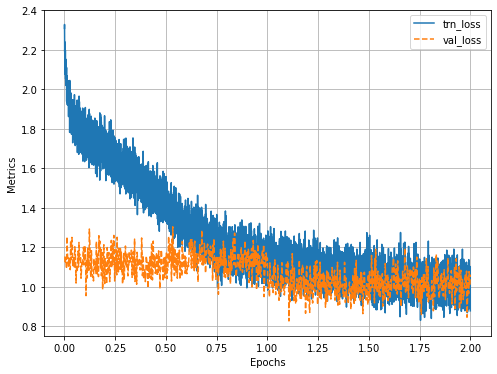

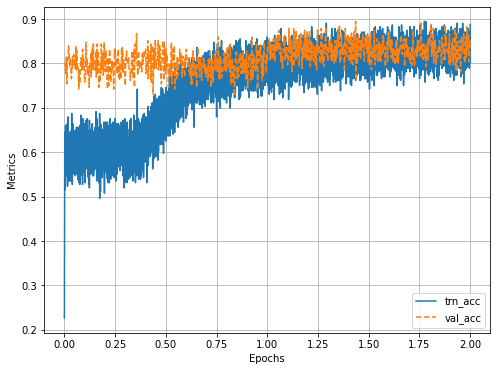

In [8]:
train_log.plot(["trn_loss", "val_loss"])
train_log.plot(["trn_acc", "val_acc"])

#### Test Evaluation

The vanilla R-CNN model achieved a mAP score of 0.6184 with an IoU threshold of 0.5 when tested against the test dataset. 

Inference time with the vanilla R-CNN is also very slow, taking 5.06 seconds without the 2 seconds needed for selective search.

The images showing predictions of the model can be found in `Demo: Predictions on Test Dataset`

##### Code: Inference and mAP Calculation

In [ ]:
from v_rcnn.test import vrcnn_predict_on_test_set

gts, preds = vrcnn_predict_on_test_set(vanilla_rcnn, restored_test_ds)

========== Predicting on test set with 710 images ==========

/content/v_rcnn/test.py:41: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at  ../torch/csrc/utils/tensor_new.cpp:201.)
  rois = torch.tensor(test_ds.rois[img_idx]).to(device)


1/710: Processed in 12.797538033000023

2/710: Processed in 4.954369455999995

3/710: Processed in 4.897943976000079

4/710: Processed in 5.913187482000012

5/710: Processed in 5.925980185999947

6/710: Processed in 3.8330344989999503

7/710: Processed in 4.995395969000015

8/710: Processed in 3.9422006360000523

9/710: Processed in 5.5655824130000155

10/710: Processed in 6.112751852000088

11/710: Processed in 4.408704602000057

12/710: Processed in 4.809487332999993

13/710: Processed in 5.993219082999985

14/710: Processed in 5.394279783000002

15/710: Processed in 5.632561127000031

16/710: Processed in 5.95143508000001

17/710: Processed in 6.056743944000004

18/710: Processed in 4.764136452999992

19/710: Processed in 6.717238006000002

20/710: Processed in 5.6575362510000105

21/710: Processed in 5.395142222000004

22/710: Processed in 6.096258755000008

23/710: Processed in 4.458563820999984

24/710: Processed in 5.3200415439999915

25/710: Processed in 5.150570463999998

26/710: Processed in 5.73396113199999

27/710: Processed in 5.798664465000002

28/710: Processed in 5.036745443999962

29/710: Processed in 4.574895080999909

30/710: Processed in 5.537623091

31/710: Processed in 2.816053049000061

32/710: Processed in 4.76635145299997

33/710: Processed in 3.706833571000061

34/710: Processed in 5.642927149000002

35/710: Processed in 4.52221322999992

36/710: Processed in 3.6642844610000793

37/710: Processed in 6.849177217000033

38/710: Processed in 6.089970645999983

39/710: Processed in 5.070478337000054

40/710: Processed in 4.936035023999921

41/710: Processed in 5.0000248960000135

42/710: Processed in 4.666015681999966

43/710: Processed in 4.868178368000031

44/710: Processed in 5.361340142000017

45/710: Processed in 5.841322904000094

46/710: Processed in 5.503065464999963

47/710: Processed in 4.173864019999996

48/710: Processed in 4.489907385000038

49/710: Processed in 6.076996946999998

50/710: Processed in 5.080965909999918

51/710: Processed in 3.2650120499999957

52/710: Processed in 4.104103332000022

53/710: Processed in 6.634036988000048

54/710: Processed in 5.427077580999935

55/710: Processed in 5.213695912000048

56/710: Processed in 4.482197564999979

57/710: Processed in 5.901738210999952

58/710: Processed in 4.077170894000005

59/710: Processed in 5.92729425899995

60/710: Processed in 4.932077781999965

61/710: Processed in 5.5134305150000955

62/710: Processed in 5.88759527000002

63/710: Processed in 4.857520399000009

64/710: Processed in 4.628772368

65/710: Processed in 4.688385710000034

66/710: Processed in 8.254975081999987

67/710: Processed in 5.1689343379999855

68/710: Processed in 5.6056971659999135

69/710: Processed in 4.716611116000081

70/710: Processed in 5.693175332999999

71/710: Processed in 5.468287475000011

72/710: Processed in 4.121564655000043

73/710: Processed in 5.96874405799997

74/710: Processed in 5.351751484999909

75/710: Processed in 6.0697930459999725

76/710: Processed in 5.953276686000095

77/710: Processed in 5.560093150999933

78/710: Processed in 5.814044511999896

79/710: Processed in 5.490680587000043

80/710: Processed in 5.643551957

81/710: Processed in 3.198990116999994

82/710: Processed in 4.494187184999987

83/710: Processed in 4.493819098000017

84/710: Processed in 4.937356839000017

85/710: Processed in 4.68171592300007

86/710: Processed in 5.175030774999982

87/710: Processed in 4.53657914900009

88/710: Processed in 3.881089596000038

89/710: Processed in 5.621611178999956

90/710: Processed in 5.395065154000008

91/710: Processed in 3.487766562999923

92/710: Processed in 5.1356074560000025

93/710: Processed in 4.677477819999922

94/710: Processed in 5.099702947999958

95/710: Processed in 4.81513553100001

96/710: Processed in 4.852642205999928

97/710: Processed in 5.716163220999988

98/710: Processed in 5.321901292000007

99/710: Processed in 5.200444495999932

100/710: Processed in 4.516720643000099

101/710: Processed in 4.651288225999906

102/710: Processed in 5.417504396999902

103/710: Processed in 6.970244821000051

104/710: Processed in 5.5590161370000715

105/710: Processed in 4.647324782999931

106/710: Processed in 4.684479208000084

107/710: Processed in 4.528067756999917

108/710: Processed in 6.027290854000057

109/710: Processed in 4.579407980000042

110/710: Processed in 6.056004246999919

111/710: Processed in 4.559176745000059

112/710: Processed in 3.9424977839998974

113/710: Processed in 6.162154740999995

114/710: Processed in 4.768793599999981

115/710: Processed in 5.36713524400011

116/710: Processed in 4.863758169999983

117/710: Processed in 4.093979535000017

118/710: Processed in 4.753999360999842

119/710: Processed in 4.575216619999992

120/710: Processed in 6.199795531000063

121/710: Processed in 5.554867297000101

122/710: Processed in 3.5127286169999934

123/710: Processed in 5.4864530570000625

124/710: Processed in 4.541145302999894

125/710: Processed in 5.53544929099985

126/710: Processed in 4.498485219000031

127/710: Processed in 4.847263491000149

128/710: Processed in 2.930171296000026

129/710: Processed in 5.361261818999992

130/710: Processed in 5.174319567000111

131/710: Processed in 4.316350517000046

132/710: Processed in 5.613104577000058

133/710: Processed in 2.975951600000144

134/710: Processed in 6.863668766000046

135/710: Processed in 5.647967373000029

136/710: Processed in 5.398655849000079

137/710: Processed in 5.3204688970001826

138/710: Processed in 5.872400079000045

139/710: Processed in 4.7942650469999535

140/710: Processed in 4.419713451000007

141/710: Processed in 5.066667456000005

142/710: Processed in 5.327510887000017

143/710: Processed in 4.28463134499998

144/710: Processed in 5.64899269600005

145/710: Processed in 4.789441805000024

146/710: Processed in 5.027033667000069

147/710: Processed in 6.059820796000167

148/710: Processed in 4.430118693000168

149/710: Processed in 7.041079581999838

150/710: Processed in 4.436005746999854

151/710: Processed in 4.854790208000168

152/710: Processed in 4.3274439940000775

153/710: Processed in 4.757211541000061

154/710: Processed in 6.078287004000003

155/710: Processed in 4.2632647800001

156/710: Processed in 2.9752449029999752

157/710: Processed in 5.067763778999961

158/710: Processed in 4.89029540599995

159/710: Processed in 4.514729822000163

160/710: Processed in 5.63515200400002

161/710: Processed in 4.53565110500017

162/710: Processed in 4.436030058000142

163/710: Processed in 4.81680323799992

164/710: Processed in 5.143071776999932

165/710: Processed in 3.8213723299998037

166/710: Processed in 5.811271469000076

167/710: Processed in 4.938511704999883

168/710: Processed in 6.189302705999808

169/710: Processed in 5.5621290179999505

170/710: Processed in 5.417838046000043

171/710: Processed in 5.724913303999983

172/710: Processed in 6.370291075000068

173/710: Processed in 5.475644886000055

174/710: Processed in 5.304880370000092

175/710: Processed in 3.948317481999993

176/710: Processed in 3.916951756999879

177/710: Processed in 5.868064827000126

178/710: Processed in 3.507672866000121

179/710: Processed in 4.570434336000062

180/710: Processed in 4.819125267000118

181/710: Processed in 4.55060483200009

182/710: Processed in 5.819713052999987

183/710: Processed in 3.945112848000008

184/710: Processed in 5.472593983000024

185/710: Processed in 3.0004578829998536

186/710: Processed in 3.3404903769999237

187/710: Processed in 5.4763357849999466

188/710: Processed in 2.7581527500001357

189/710: Processed in 4.7764339620000555

190/710: Processed in 6.0802947199999835

191/710: Processed in 5.544505710000067

192/710: Processed in 5.925924676000022

193/710: Processed in 4.746821000999944

194/710: Processed in 5.140672145000053

195/710: Processed in 5.181367388999888

196/710: Processed in 5.967529298000045

197/710: Processed in 5.70621909800002

198/710: Processed in 5.771015710000029

199/710: Processed in 3.0428681079999933

200/710: Processed in 6.424066977999928

201/710: Processed in 5.62637719899999

202/710: Processed in 6.458386845000177

203/710: Processed in 5.1544715120001

204/710: Processed in 5.321390428000086

205/710: Processed in 5.461190780999914

206/710: Processed in 4.68021260799992

207/710: Processed in 3.9907891160000872

208/710: Processed in 7.036294842999951

209/710: Processed in 4.99355873799982

210/710: Processed in 4.020099586000015

211/710: Processed in 6.139718258999892

212/710: Processed in 5.741958984000121

213/710: Processed in 3.6072482409999793

214/710: Processed in 5.496857515000102

215/710: Processed in 6.340291444999821

216/710: Processed in 3.1841645810000045

217/710: Processed in 4.767742426000041

218/710: Processed in 4.031852652999987

219/710: Processed in 5.708153347999996

220/710: Processed in 5.038384967999946

221/710: Processed in 5.509282081000038

222/710: Processed in 4.44000916899995

223/710: Processed in 5.521037826999873

224/710: Processed in 5.431079143000034

225/710: Processed in 4.647002452000152

226/710: Processed in 4.897976006999897

227/710: Processed in 4.674203440999918

228/710: Processed in 4.801351221999994

229/710: Processed in 4.779476971999884

230/710: Processed in 4.447049898999921

231/710: Processed in 4.06534734700017

232/710: Processed in 4.110004118999996

233/710: Processed in 2.880344728999944

234/710: Processed in 3.5173651640000116

235/710: Processed in 3.7633897319999505

236/710: Processed in 5.668517728000097

237/710: Processed in 6.043650611999965

238/710: Processed in 4.493774212999824

239/710: Processed in 4.269771323999976

240/710: Processed in 4.171124410000175

241/710: Processed in 5.295292621000044

242/710: Processed in 6.236830458999975

243/710: Processed in 4.75485334300015

244/710: Processed in 5.179756144000066

245/710: Processed in 6.124631948000115

246/710: Processed in 4.5294238000001315

247/710: Processed in 3.2642203630000495

248/710: Processed in 5.215842371000008

249/710: Processed in 4.002901146999875

250/710: Processed in 4.691066065000086

251/710: Processed in 4.972086948999959

252/710: Processed in 6.398535789999869

253/710: Processed in 3.7549376570000277

254/710: Processed in 5.7353649950000545

255/710: Processed in 5.2893335450000905

256/710: Processed in 6.026101078000011

257/710: Processed in 5.568902062999996

258/710: Processed in 5.73422508900012

259/710: Processed in 5.093466254000077

260/710: Processed in 3.98782820800011

261/710: Processed in 2.7169476229998963

262/710: Processed in 5.490398298999935

263/710: Processed in 5.955072115999883

264/710: Processed in 5.4154870509999

265/710: Processed in 4.054664473999992

266/710: Processed in 6.177177691999987

267/710: Processed in 4.4743817070000205

268/710: Processed in 3.87488297699997

269/710: Processed in 3.8493570769999224

270/710: Processed in 3.675184844999876

271/710: Processed in 6.697091075999879

272/710: Processed in 5.452308204000019

273/710: Processed in 4.054078661999938

274/710: Processed in 5.4346316259998275

275/710: Processed in 3.60028618299998

276/710: Processed in 5.081858583999974

277/710: Processed in 6.205621067000038

278/710: Processed in 5.992040120999945

279/710: Processed in 4.402998991000004

280/710: Processed in 1.5524931790000664

281/710: Processed in 6.334583947999818

282/710: Processed in 4.733840496000084

283/710: Processed in 4.659957157000008

284/710: Processed in 5.365798596000104

285/710: Processed in 4.099655786999847

286/710: Processed in 6.083172905000083

287/710: Processed in 5.423386789999995

288/710: Processed in 6.964511137000045

289/710: Processed in 6.1913598030000685

290/710: Processed in 4.13211629899979

291/710: Processed in 4.719263530000035

292/710: Processed in 4.843913421999787

293/710: Processed in 5.263337223999997

294/710: Processed in 3.413310539000122

295/710: Processed in 3.706114940999896

296/710: Processed in 4.341611664999846

297/710: Processed in 5.092894588999798

298/710: Processed in 5.875869061000003

299/710: Processed in 5.241974260000006

300/710: Processed in 4.097823917000142

301/710: Processed in 5.498527614000068

302/710: Processed in 4.900226029000123

303/710: Processed in 3.3274746560000494

304/710: Processed in 5.741468766000025

305/710: Processed in 4.595578384999953

306/710: Processed in 3.525224230000049

307/710: Processed in 4.770190602000184

308/710: Processed in 5.09017639800004

309/710: Processed in 4.233996962999754

310/710: Processed in 3.91763806400013

311/710: Processed in 5.110728382000161

312/710: Processed in 4.754743731999952

313/710: Processed in 4.719158376999985

314/710: Processed in 4.207929889000297

315/710: Processed in 5.787661632999971

316/710: Processed in 4.872852204000083

317/710: Processed in 4.999117565000233

318/710: Processed in 5.310265307000009

319/710: Processed in 4.475381153999933

320/710: Processed in 5.476995551000073

321/710: Processed in 6.188732965999861

322/710: Processed in 2.512486609000007

323/710: Processed in 5.000451867000265

324/710: Processed in 4.3755941609997535

325/710: Processed in 4.6750899339999705

326/710: Processed in 6.110438959000021

327/710: Processed in 5.438024053999925

328/710: Processed in 5.918922008000209

329/710: Processed in 5.037840528000288

330/710: Processed in 6.148064126000008

331/710: Processed in 4.368245822000063

332/710: Processed in 5.642242963000172

333/710: Processed in 4.741337725999983

334/710: Processed in 5.5848899900001925

335/710: Processed in 6.000270665999778

336/710: Processed in 3.524444067999866

337/710: Processed in 5.22943502399994

338/710: Processed in 5.71573546899981

339/710: Processed in 4.281651927999974

340/710: Processed in 2.5871483210003134

341/710: Processed in 4.037140381999961

342/710: Processed in 5.891630102999898

343/710: Processed in 3.4571620910001

344/710: Processed in 3.7102632890000677

345/710: Processed in 4.9353565119999985

346/710: Processed in 5.208323512999868

347/710: Processed in 4.208389497000098

348/710: Processed in 6.354072239000288

349/710: Processed in 5.291511016000186

350/710: Processed in 5.897548420000021

351/710: Processed in 6.269079306999629

352/710: Processed in 4.2290244890000395

353/710: Processed in 4.909527096000147

354/710: Processed in 4.896497594000266

355/710: Processed in 4.4252872809997825

356/710: Processed in 6.358612715999698

357/710: Processed in 5.611106355999709

358/710: Processed in 4.620310917000097

359/710: Processed in 5.751422012999683

360/710: Processed in 4.505822417000218

361/710: Processed in 5.339983534000112

362/710: Processed in 4.5092626119999295

363/710: Processed in 5.312683196999842

364/710: Processed in 4.6311412469999595

365/710: Processed in 5.0146334220003155

366/710: Processed in 5.579912615000012

367/710: Processed in 4.521828656999787

368/710: Processed in 5.442474586000117

369/710: Processed in 4.602401738000026

370/710: Processed in 3.7359965189998547

371/710: Processed in 2.5851834649997727

372/710: Processed in 5.84982580399992

373/710: Processed in 4.1819315650000135

374/710: Processed in 5.085439686999962

375/710: Processed in 5.811969007000243

376/710: Processed in 3.6520491330002187

377/710: Processed in 5.354110678000325

378/710: Processed in 4.183142911000232

379/710: Processed in 6.117159602999891

380/710: Processed in 5.628479782999875

381/710: Processed in 4.69653037199987

382/710: Processed in 4.8827634159997615

383/710: Processed in 3.947029278000173

384/710: Processed in 5.156946841000263

385/710: Processed in 5.448643297999752

386/710: Processed in 5.99336696599994

387/710: Processed in 5.939755722999962

388/710: Processed in 5.3561922109997795

389/710: Processed in 5.306309990000045

390/710: Processed in 5.728882812999927

391/710: Processed in 6.034615742999904

392/710: Processed in 5.015483445999962

393/710: Processed in 6.204171051999765

394/710: Processed in 4.54069052199975

395/710: Processed in 5.565901425999982

396/710: Processed in 5.03876843199987

397/710: Processed in 5.742865823000102

398/710: Processed in 3.9862306269997134

399/710: Processed in 5.251176091000161

400/710: Processed in 4.39187776000017

401/710: Processed in 4.851183251999828

402/710: Processed in 4.082914348000031

403/710: Processed in 5.16705805499987

404/710: Processed in 5.256089287000123

405/710: Processed in 5.436050248999891

406/710: Processed in 3.5472077310000714

407/710: Processed in 4.29175198799976

408/710: Processed in 3.4301141880000614

409/710: Processed in 6.059861166999781

410/710: Processed in 3.0852127540001675

411/710: Processed in 5.040142868000203

412/710: Processed in 5.646866521999982

413/710: Processed in 5.830912209999951

414/710: Processed in 6.149983712999983

415/710: Processed in 4.7669337869997435

416/710: Processed in 5.8153650880003624

417/710: Processed in 5.611374008999974

418/710: Processed in 6.327765062000253

419/710: Processed in 4.500036550000004

420/710: Processed in 5.650261700999636

421/710: Processed in 5.118144659999871

422/710: Processed in 5.822143783000229

423/710: Processed in 5.160699830999874

424/710: Processed in 5.760008584999923

425/710: Processed in 4.540377190000072

426/710: Processed in 5.179657464999764

427/710: Processed in 4.029843658000118

428/710: Processed in 4.734647858000244

429/710: Processed in 5.749332422999942

430/710: Processed in 4.455111858999771

431/710: Processed in 5.486830760999965

432/710: Processed in 3.0768931989996418

433/710: Processed in 6.205196960000194

434/710: Processed in 5.909097852999821

435/710: Processed in 3.652976471999864

436/710: Processed in 4.131751367999641

437/710: Processed in 5.990440861000025

438/710: Processed in 4.766015862000131

439/710: Processed in 6.050584534999871

440/710: Processed in 5.626733937000154

441/710: Processed in 4.856565104999845

442/710: Processed in 5.760630744999617

443/710: Processed in 5.6574930310002856

444/710: Processed in 4.119400245000179

445/710: Processed in 3.871657454999877

446/710: Processed in 5.939583632999984

447/710: Processed in 5.449986802999774

448/710: Processed in 2.2234575019997465

449/710: Processed in 3.8143073520000144

450/710: Processed in 5.10167224199995

451/710: Processed in 4.801905507999891

452/710: Processed in 5.842758437000157

453/710: Processed in 4.746891323

454/710: Processed in 5.413315734999742

455/710: Processed in 4.492411792999974

456/710: Processed in 5.546163292000074

457/710: Processed in 5.385824344999946

458/710: Processed in 3.7875742189999073

459/710: Processed in 5.828519590999804

460/710: Processed in 2.7683153739999398

461/710: Processed in 4.673566323000159

462/710: Processed in 5.83675772100014

463/710: Processed in 4.5976833790000455

464/710: Processed in 4.206165795999823

465/710: Processed in 5.288452091999716

466/710: Processed in 3.9255804909998915

467/710: Processed in 5.591785602000073

468/710: Processed in 4.8850814449997415

469/710: Processed in 5.029334676999952

470/710: Processed in 5.118921063000016

471/710: Processed in 2.540015899000082

472/710: Processed in 4.386392023000099

473/710: Processed in 6.306255247999616

474/710: Processed in 3.8501854959999946

475/710: Processed in 5.951613707999968

476/710: Processed in 5.30444704599995

477/710: Processed in 3.1205068700000993

478/710: Processed in 4.658032889999959

479/710: Processed in 5.803757146999942

480/710: Processed in 5.632206811999822

481/710: Processed in 5.320774509999865

482/710: Processed in 6.067319772999781

483/710: Processed in 4.1577117490001

484/710: Processed in 2.9864680820001013

485/710: Processed in 5.214649176000421

486/710: Processed in 5.702100405999772

487/710: Processed in 4.900180783999986

488/710: Processed in 4.4244776310001726

489/710: Processed in 4.194065422000222

490/710: Processed in 4.7459116619997985

491/710: Processed in 6.163200421000056

492/710: Processed in 3.729508628000076

493/710: Processed in 5.966861154999606

494/710: Processed in 6.350540106999688

495/710: Processed in 5.929338528999779

496/710: Processed in 5.440422352000041

497/710: Processed in 4.593450298999869

498/710: Processed in 5.325229219999983

499/710: Processed in 5.477682303000165

500/710: Processed in 4.361815277999995

501/710: Processed in 4.7808875929999886

502/710: Processed in 5.312206540000261

503/710: Processed in 5.85831093600018

504/710: Processed in 5.133995649000099

505/710: Processed in 6.041951272999995

506/710: Processed in 4.612830303999999

507/710: Processed in 4.64361932599968

508/710: Processed in 4.391509584000232

509/710: Processed in 4.548595710999962

510/710: Processed in 3.8461205690000497

511/710: Processed in 3.7086733619998995

512/710: Processed in 5.036132890000317

513/710: Processed in 2.6899220280001828

514/710: Processed in 3.09514983400004

515/710: Processed in 3.640808492999895

516/710: Processed in 3.873895055000048

517/710: Processed in 5.579561612999896

518/710: Processed in 5.124163669000154

519/710: Processed in 4.139478153999789

520/710: Processed in 4.186043154999879

521/710: Processed in 5.20476186399992

522/710: Processed in 5.528742597000019

523/710: Processed in 5.581651939000039

524/710: Processed in 5.3490082399998755

525/710: Processed in 4.802972538000176

526/710: Processed in 5.473326026999985

527/710: Processed in 5.273871597999914

528/710: Processed in 5.6359292759998425

529/710: Processed in 5.342582126999787

530/710: Processed in 4.413416570999743

531/710: Processed in 5.222736534999967

532/710: Processed in 3.5549768730002143

533/710: Processed in 6.06231620699964

534/710: Processed in 2.46958152399975

535/710: Processed in 4.792081082000095

536/710: Processed in 4.339329362999706

537/710: Processed in 3.8245977219999077

538/710: Processed in 4.273213047999889

539/710: Processed in 3.9131911570002558

540/710: Processed in 4.935044416999972

541/710: Processed in 5.345684492000146

542/710: Processed in 7.962060059000123

543/710: Processed in 6.282041831000242

544/710: Processed in 6.301894673000334

545/710: Processed in 4.0716252950001035

546/710: Processed in 5.18357357099967

547/710: Processed in 5.119842447999872

548/710: Processed in 3.7521813789999214

549/710: Processed in 3.02965457099981

550/710: Processed in 4.851378383000338

551/710: Processed in 5.040798623999763

552/710: Processed in 4.433113230999879

553/710: Processed in 3.9704460240000117

554/710: Processed in 4.282815244000176

555/710: Processed in 5.0386961019999035

556/710: Processed in 5.516985075999855

557/710: Processed in 4.5575685359999625

558/710: Processed in 6.0865166869998575

559/710: Processed in 4.102552362000097

560/710: Processed in 5.374734328000159

561/710: Processed in 5.5855897009996625

562/710: Processed in 3.8139189630001056

563/710: Processed in 6.32993240299993

564/710: Processed in 5.068254707000051

565/710: Processed in 5.164667093999924

566/710: Processed in 5.390274010000212

567/710: Processed in 4.072225313999752

568/710: Processed in 5.7974541110002065

569/710: Processed in 7.174053575000016

570/710: Processed in 6.888224577000074

571/710: Processed in 5.184718346999944

572/710: Processed in 6.2912091329999384

573/710: Processed in 6.150643464000041

574/710: Processed in 6.4291674450000755

575/710: Processed in 5.104188067999985

576/710: Processed in 6.040193858999828

577/710: Processed in 6.93245848100014

578/710: Processed in 6.187757256000168

579/710: Processed in 6.381428276999941

580/710: Processed in 5.676865369000097

581/710: Processed in 8.827524158000415

582/710: Processed in 7.750308039999709

583/710: Processed in 7.211458564000168

584/710: Processed in 6.719484802000352

585/710: Processed in 6.297084285999972

586/710: Processed in 5.516695257000265

587/710: Processed in 5.988215960999696

588/710: Processed in 4.895809879999888

589/710: Processed in 4.200555517999874

590/710: Processed in 5.900227519000055

591/710: Processed in 5.486312854000062

592/710: Processed in 6.09489094699984

593/710: Processed in 4.474826009000026

594/710: Processed in 5.598264088999713

595/710: Processed in 4.974756843999785

596/710: Processed in 5.47831824099967

597/710: Processed in 5.329731371999969

598/710: Processed in 5.614755179999975

599/710: Processed in 6.335130899999967

600/710: Processed in 6.157885536999856

601/710: Processed in 5.26568209800007

602/710: Processed in 4.439686192999943

603/710: Processed in 5.188636745000167

604/710: Processed in 5.815516500000285

605/710: Processed in 6.195175286999984

606/710: Processed in 4.115214715000093

607/710: Processed in 5.856462402999568

608/710: Processed in 5.579959004999637

609/710: Processed in 4.491238049000003

610/710: Processed in 4.954605113000071

611/710: Processed in 4.769125704000089

612/710: Processed in 2.777398013000038

613/710: Processed in 3.988791690999733

614/710: Processed in 5.570914602999892

615/710: Processed in 4.693526368000221

616/710: Processed in 5.3662335569997595

617/710: Processed in 3.4625176949998604

618/710: Processed in 5.415432597999825

619/710: Processed in 5.455233710999892

620/710: Processed in 4.603566634999879

621/710: Processed in 6.962465731000066

622/710: Processed in 4.038663372999963

623/710: Processed in 6.059704930000407

624/710: Processed in 4.92935662500031

625/710: Processed in 5.591201473000183

626/710: Processed in 5.299960900000315

627/710: Processed in 5.984875920999912

628/710: Processed in 5.763045084000169

629/710: Processed in 5.068057652999869

630/710: Processed in 5.670435025000188

631/710: Processed in 4.623979727999995

632/710: Processed in 5.282349970999803

633/710: Processed in 5.209557140000015

634/710: Processed in 6.361879321999822

635/710: Processed in 6.425139314999797

636/710: Processed in 5.404739782999968

637/710: Processed in 5.648274431000118

638/710: Processed in 7.159607842999776

639/710: Processed in 7.414720690000195

640/710: Processed in 6.614042521000101

641/710: Processed in 5.331878340999992

642/710: Processed in 5.1907091860002765

643/710: Processed in 5.588567882000007

644/710: Processed in 5.582509657000173

645/710: Processed in 4.683225736000168

646/710: Processed in 5.007536192999851

647/710: Processed in 3.8800668090002546

648/710: Processed in 4.824944624000182

649/710: Processed in 5.6807100080000055

650/710: Processed in 4.90087946299991

651/710: Processed in 5.825244010999995

652/710: Processed in 3.152618929000255

653/710: Processed in 4.287618815999849

654/710: Processed in 5.242214643000352

655/710: Processed in 4.791855774999931

656/710: Processed in 4.688079029999699

657/710: Processed in 4.979598072000044

658/710: Processed in 3.8974606950000634

659/710: Processed in 4.160898765999718

660/710: Processed in 5.840990533000422

661/710: Processed in 5.686072266999872

662/710: Processed in 4.785244189999958

663/710: Processed in 4.910398781999902

664/710: Processed in 4.994428638000045

665/710: Processed in 5.040224740999747

666/710: Processed in 5.041201803999684

667/710: Processed in 3.6732614709999325

668/710: Processed in 4.84839984700011

669/710: Processed in 4.476358039999923

670/710: Processed in 5.8296125639999445

671/710: Processed in 4.852175582999735

672/710: Processed in 4.068811908000043

673/710: Processed in 4.493334156999936

674/710: Processed in 4.542840063999847

675/710: Processed in 4.530288656999801

676/710: Processed in 5.594264493999617

677/710: Processed in 4.90691711799991

678/710: Processed in 4.680247637999855

679/710: Processed in 6.126658464999764

680/710: Processed in 5.524478168999849

681/710: Processed in 4.586197320999872

682/710: Processed in 4.578799311999774

683/710: Processed in 4.785769705000348

684/710: Processed in 4.384023595999679

685/710: Processed in 5.216204334999929

686/710: Processed in 5.866788929999984

687/710: Processed in 5.996793381999851

688/710: Processed in 5.259408228999746

689/710: Processed in 4.295591302000048

690/710: Processed in 6.5017204259997925

691/710: Processed in 5.9707446550000896

692/710: Processed in 5.4978118139997605

693/710: Processed in 4.338470149999921

694/710: Processed in 5.626156632999937

695/710: Processed in 6.0448706640004275

696/710: Processed in 5.149973368999781

697/710: Processed in 4.846397122999861

698/710: Processed in 5.20651227999997

699/710: Processed in 6.291521705999912

700/710: Processed in 5.828842480000276

701/710: Processed in 4.963239545999841

702/710: Processed in 4.765579572999741

703/710: Processed in 5.123459108000134

704/710: Processed in 4.626437588000044

705/710: Processed in 5.344986093999978

706/710: Processed in 3.844335319000038

707/710: Processed in 5.365898719000143

708/710: Processed in 5.183314242000051

709/710: Processed in 4.650796240000091

710/710: Processed in 6.279932578000171

========== Prediction finished. Time elapsed: 3593.5069774510002 ==========

In [ ]:
from torchmetrics.detection.mean_ap import MeanAveragePrecision
from utils import device

# Initialize metric
metric = MeanAveragePrecision(iou_type="bbox", iou_thresholds=[0.5])

# Update metric with predictions and respective ground truth
metric.update(preds, gts)

# Compute the results
result = metric.compute()
map50 = result['map'].item()
print(f"mAP with IoU threshold at 0.5: {map50}")

mAP with IoU threshold at 0.5: 0.6184152364730835


##### Demo: Predictions on Test Dataset

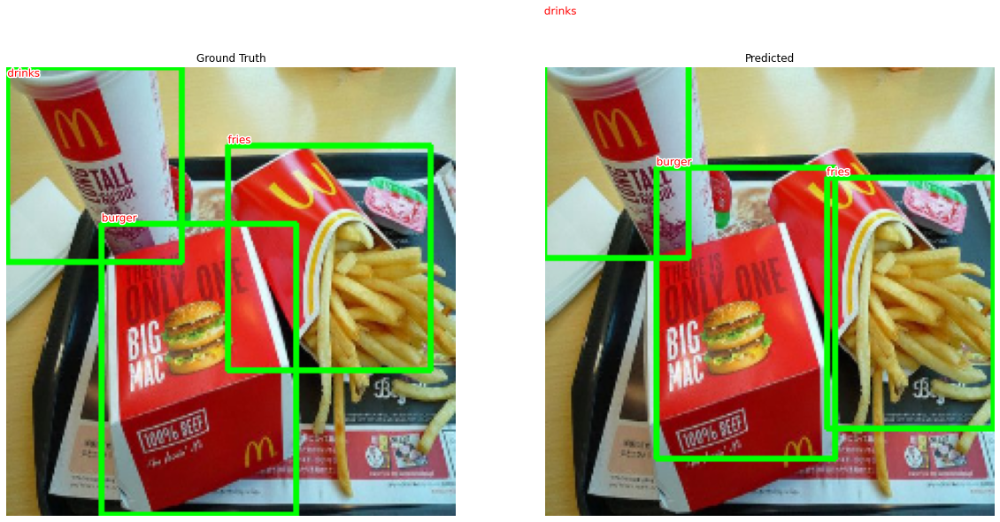

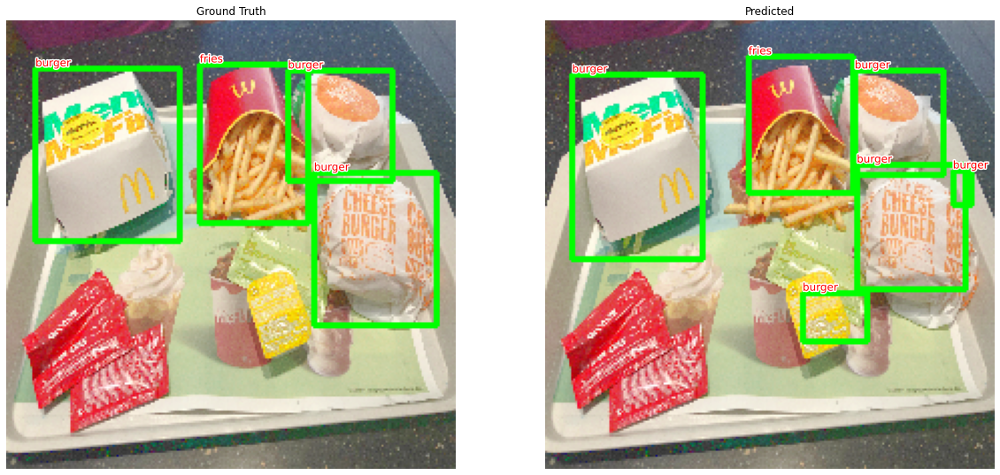

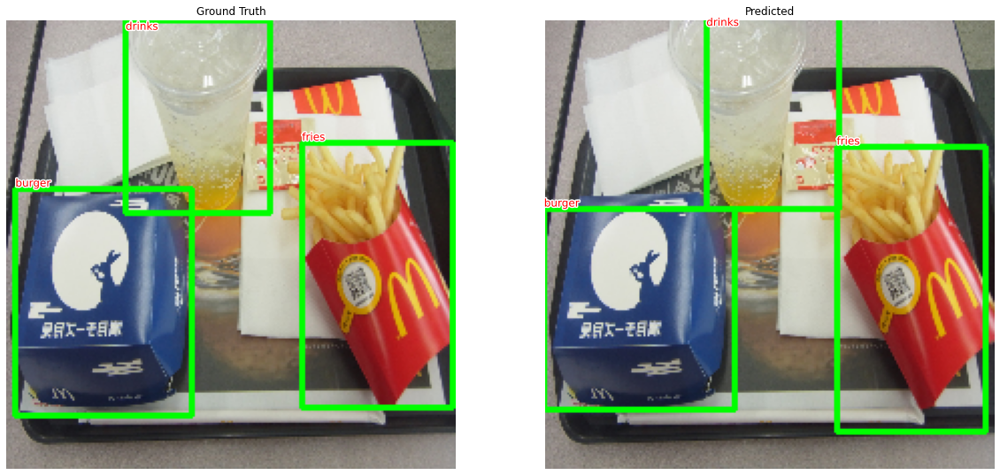

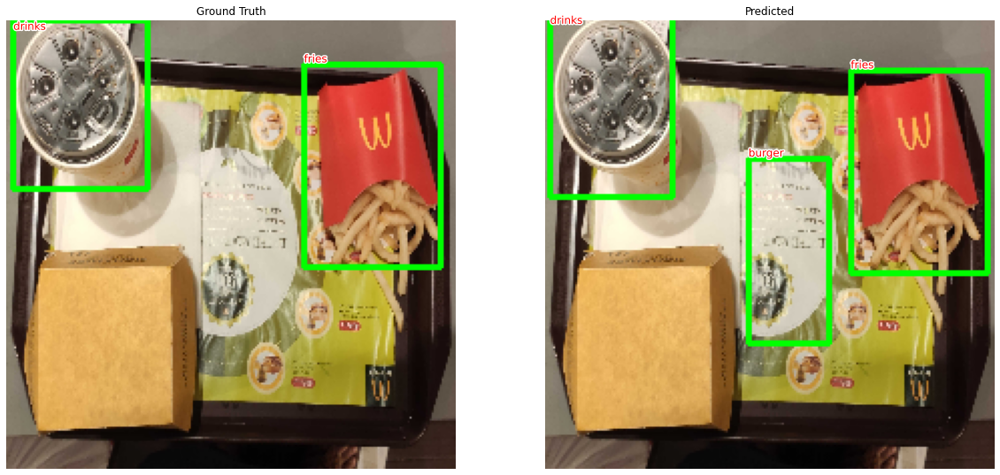

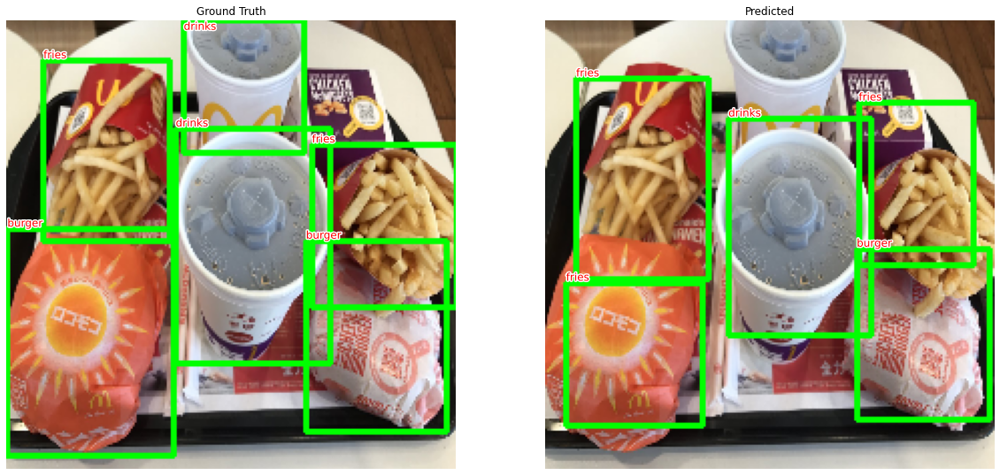

...

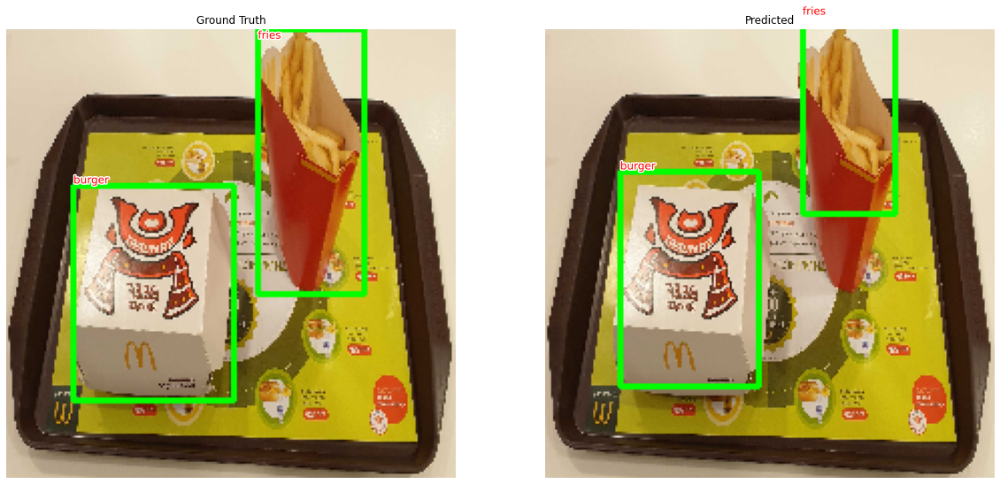

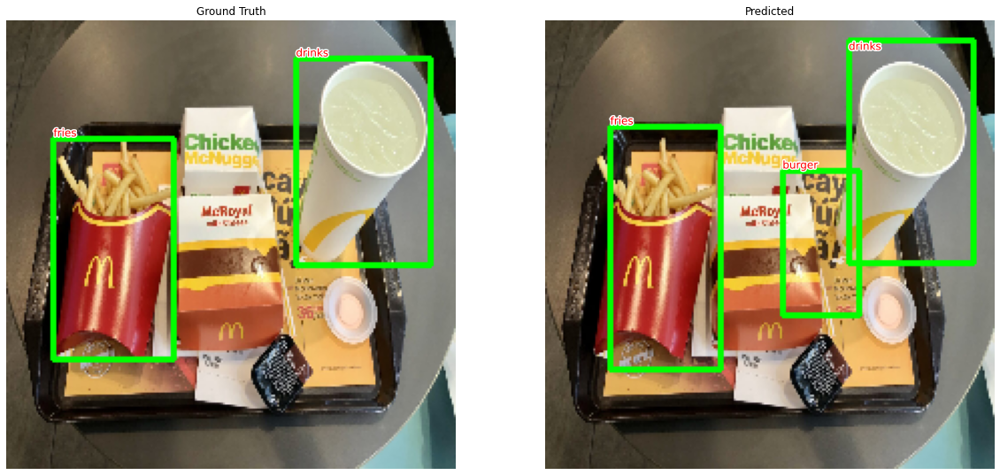

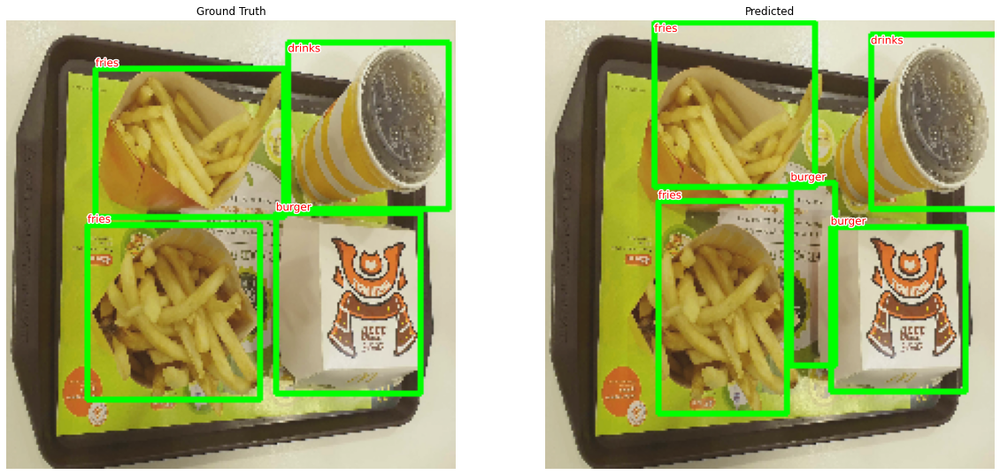

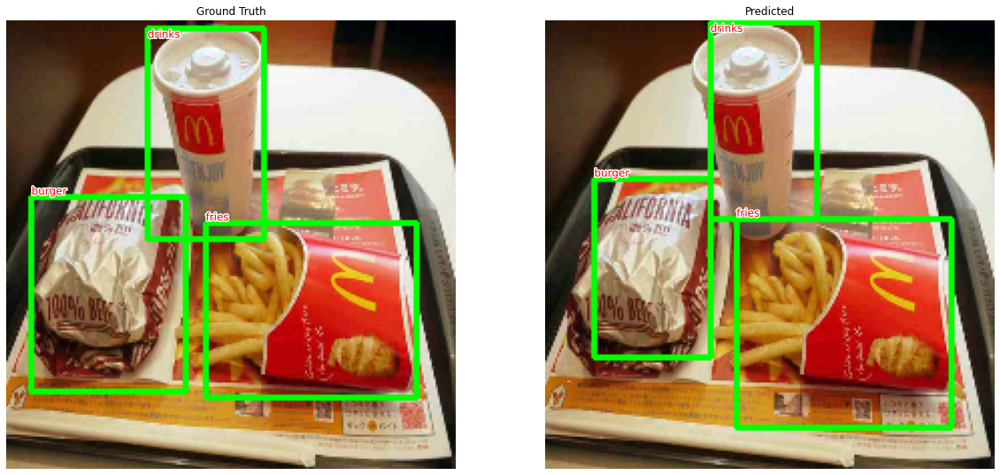

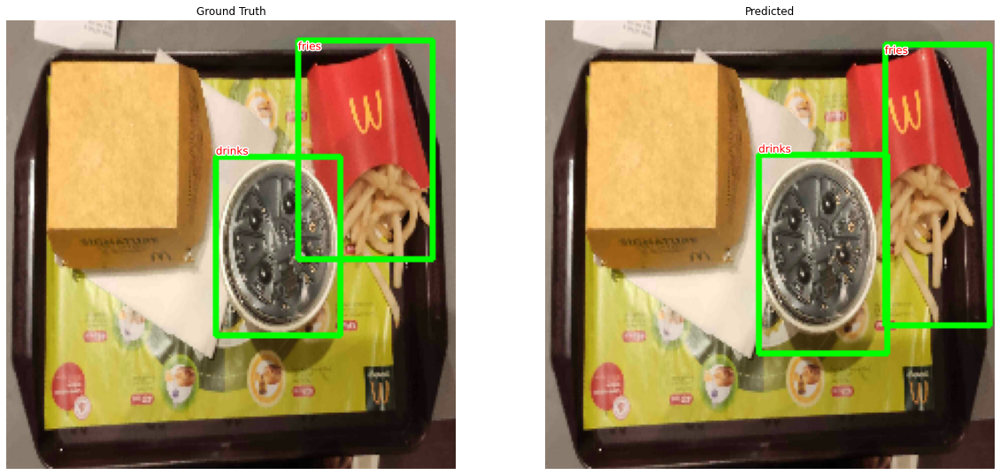

In [ ]:
import matplotlib.pyplot as plt
from data_augment import id_to_class
from utils import read_image_cv2
import cv2
from torch_snippets import show

def show_bbs_labels(img, info, ax):
    boxes = info['boxes'].int().tolist()
    labels = info['labels'].tolist()
    texts = [id_to_class[c] for c in labels]
    show(img, bbs=boxes, texts=texts, text_sz=12, ax=ax)

for img_idx in range(20):
  _, ax = plt.subplots(1, 2, figsize=(20,10))
  img = read_image_cv2(restored_test_ds.img_base_dir + restored_test_ds.filenames[img_idx])
  img = cv2.resize(img, (224, 224))

  ax[0].set_title("Ground Truth")
  show_bbs_labels(img, gts[img_idx], ax=ax[0])

  ax[1].set_title("Predicted")
  show_bbs_labels(img, preds[img_idx], ax=ax[1])
  plt.show()

## Fast R-CNN

The Fast R-CNN model improves upon the vanilla R-CNN model by eliminating the need to crop and feed each region proposal individually. Instead of passing each region proposal through the convolutional layer, this method extracts features from the entire image. The region proposals are then applied on the extracted featrues through a region-of-interest pooling layer before being fed to sibling classification and offset regression output layers [2]. In our implementation, we generally follow the model described in the paper.

### Code: Load the saved dataset with region proposals

In [ ]:
PICKLE_ZIP_FILEPATH = PRJ_ROOT_DIRPATH + 'processed_ds/pickle.zip'

# Download and extract pickled dataset
!cp $PICKLE_ZIP_FILEPATH .
!unzip 'pickle.zip'

Archive:  pickle.zip
   creating: processed_ds/
   creating: processed_ds/test/
  inflating: processed_ds/test/saved_ds_processing.pickle  
   creating: processed_ds/train/
  inflating: processed_ds/train/saved_ds_processing.pickle  


In [ ]:
from fast_rcnn.dataset import create_train_test_dataset_from_pickle

PICKLE_TRAIN_LOC = 'processed_ds/train/saved_ds_processing.pickle'
PICKLE_TEST_LOC = 'processed_ds/test/saved_ds_processing.pickle'

restored_train_ds, restored_test_ds = create_train_test_dataset_from_pickle(MCD_DATASET_IMAGES_DIRPATH, PICKLE_TRAIN_LOC, PICKLE_TEST_LOC)

### Model Architecture

The architecture of our fast R-CNN implementation is similar to the vanilla R-CNN implementation.

It also uses a pretrained ResNet50 network as its feature extractor. The extracted features are passed to an RoI pooling layer along with the region proposals. The result of the RoI pooling layer are again passed to 2 fully connected layers before being passed to sibling output layers that predict the classification score and the bounding box offsets.

In [ ]:
from fast_rcnn.model import FastRCNN
from utils import device

fast_rcnn_model = FastRCNN().to(device)
print(fast_rcnn_model)

Downloading: "https://download.pytorch.org/models/resnet50-11ad3fa6.pth" to /root/.cache/torch/hub/checkpoints/resnet50-11ad3fa6.pth


  0%|          | 0.00/97.8M [00:00<?, ?B/s]

FastRCNN(
  (backbone): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (4): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (downsample): Sequential(
          (0): Conv2d(64

### Training

We trained the model for 15 epochs for a total time of around 2.29 hours.

Without having to take crops of each region proposal, each epoch now only took around 9 minutes. This allowed us more freedom to experiment with different hyperparemeter values and for more epochs. In the end, we ended up with a better model than with the vanilla R-CNN.

#### Code: Training the Fast R-CNN Model

In [ ]:
from fast_rcnn.train import train_fastrcnn
import time

train_counter_start = time.perf_counter()
print(f"Train dataset size: {len(restored_train_ds)}")
print(f"========== Training Fast R-CNN Start ==========")

# Use batch_size=2, epochs=15, learning rate=3e-3. Values determined experimentally.
train_log = train_fastrcnn(fast_rcnn_model, restored_train_ds, num_epochs=15, batch_size=2, learning_rate=3e-3)

train_counter_elapsed_time = time.perf_counter() - train_counter_start
print(f"========== Training Fast R-CNN End. Time Elapsed: {train_counter_elapsed_time} ==========")

Train dataset size: 2840
========== Training Fast R-CNN Start ==========


/content/fast_rcnn/dataset.py:75: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at  ../torch/csrc/utils/tensor_new.cpp:201.)
  rois = torch.Tensor(rois).float().to(device)


EPOCH: 1.000  val_loss: 1.003  val_cls_loss: 0.425  val_regr_loss: 0.058  val_acc: 0.844  (554.26s - 7759.67s remaining)

Current ave.: trn_loss=1.0850872666529834 val_loss=0.8836603638991504 trn_acc=0.8074728297022257 
val_acc=0.8540324027344056

EPOCH: 2.000  val_loss: 0.870  val_cls_loss: 0.348  val_regr_loss: 0.052  val_acc: 0.858  (1105.18s - 7183.70s remaining)

Current ave.: trn_loss=0.9144685833550208 val_loss=0.8134882400783014 trn_acc=0.8396377662192586 
val_acc=0.8648526641529919

EPOCH: 3.000  val_loss: 0.785  val_cls_loss: 0.300  val_regr_loss: 0.048  val_acc: 0.877  (1656.43s - 6625.73s remaining)

Current ave.: trn_loss=0.8145957785344211 val_loss=0.7710064893737085 trn_acc=0.8587601614655412 
val_acc=0.8724536599423824

EPOCH: 4.000  val_loss: 0.740  val_cls_loss: 0.275  val_regr_loss: 0.047  val_acc: 0.872  (2207.15s - 6069.66s remaining)

Current ave.: trn_loss=0.7448629297152838 val_loss=0.7396854497492313 trn_acc=0.8726820946947543 
val_acc=0.8782844487516562

EPOCH: 5.000  val_loss: 0.702  val_cls_loss: 0.254  val_regr_loss: 0.045  val_acc: 0.882  (2749.16s - 5498.31s remaining)

Current ave.: trn_loss=0.6915603462262706 val_loss=0.7170128691364342 trn_acc=0.8836079861536359 
val_acc=0.8827194370757928

EPOCH: 6.000  val_loss: 0.692  val_cls_loss: 0.248  val_regr_loss: 0.044  val_acc: 0.883  (3284.77s - 4927.16s remaining)

Current ave.: trn_loss=0.6483658636839021 val_loss=0.6984387636534485 trn_acc=0.8925536402497528 
val_acc=0.8865397708600155

EPOCH: 7.000  val_loss: 0.666  val_cls_loss: 0.236  val_regr_loss: 0.043  val_acc: 0.886  (3835.93s - 4383.92s remaining)

Current ave.: trn_loss=0.6124990012504206 val_loss=0.6865547078116319 trn_acc=0.8999610539143751 
val_acc=0.8889829875401922

EPOCH: 8.000  val_loss: 0.673  val_cls_loss: 0.242  val_regr_loss: 0.043  val_acc: 0.889  (4389.31s - 3840.65s remaining)

Current ave.: trn_loss=0.5823587032562597 val_loss=0.6748232512774182 trn_acc=0.9061230028618518 
val_acc=0.8917493469831818

EPOCH: 9.000  val_loss: 0.654  val_cls_loss: 0.241  val_regr_loss: 0.041  val_acc: 0.886  (4942.09s - 3294.73s remaining)

Current ave.: trn_loss=0.5564435923478849 val_loss=0.6665001443714044 trn_acc=0.9113548084973601 
val_acc=0.8934620927687444

EPOCH: 10.000  val_loss: 0.673  val_cls_loss: 0.238  val_regr_loss: 0.043  val_acc: 0.889  (5492.24s - 2746.12s remaining)

Current ave.: trn_loss=0.5351336416923944 val_loss=0.6596312034507872 trn_acc=0.9157779250769486 
val_acc=0.8953034369261296

EPOCH: 11.000  val_loss: 0.653  val_cls_loss: 0.237  val_regr_loss: 0.042  val_acc: 0.892  (6043.55s - 2197.65s remaining)

Current ave.: trn_loss=0.5150420827822099 val_loss=0.6524324609627339 trn_acc=0.9198489087775906 
val_acc=0.8970937128977841

EPOCH: 12.000  val_loss: 0.657  val_cls_loss: 0.237  val_regr_loss: 0.042  val_acc: 0.896  (6594.12s - 1648.53s remaining)

Current ave.: trn_loss=0.4973686307709495 val_loss=0.646928553919837 trn_acc=0.9234057623703547 
val_acc=0.8986542830716481

EPOCH: 13.000  val_loss: 0.668  val_cls_loss: 0.244  val_regr_loss: 0.042  val_acc: 0.896  (7146.25s - 1099.42s remaining)

Current ave.: trn_loss=0.481109233314995 val_loss=0.643471572310023 trn_acc=0.9266520531933493 
val_acc=0.8999644013949799

EPOCH: 14.000  val_loss: 0.644  val_cls_loss: 0.231  val_regr_loss: 0.041  val_acc: 0.904  (7703.38s - 550.24s remaining)

Current ave.: trn_loss=0.4663683143393348 val_loss=0.6417054312989505 trn_acc=0.9295993079907676 
val_acc=0.9007116303969676

EPOCH: 15.000  val_loss: 0.644  val_cls_loss: 0.232  val_regr_loss: 0.041  val_acc: 0.896  (8262.70s - 0.00s remaining)

Current ave.: trn_loss=0.45269084709366597 val_loss=0.6375895549433892 trn_acc=0.932342143685632 
val_acc=0.9019505098431034

========== Training Fast R-CNN End. Time Elapsed: 8262.740112589001 ==========


In [ ]:
import pickle
import torch
import os

# Save the training log and the model weights
FASTRCNN_LOG_PICKLE_FP = PRJ_ROOT_DIRPATH + 'training_output/fast_rcnn/train_log.pickle'
FASTRCNN_WEIGHTS_PTH_FP = PRJ_ROOT_DIRPATH + 'training_output/fast_rcnn/fast_rcnn_weights.pth'

os.makedirs(os.path.dirname(FASTRCNN_LOG_PICKLE_FP), exist_ok=True)
with open(FASTRCNN_LOG_PICKLE_FP, 'wb') as fs:
    pickle.dump(train_log, fs)

torch.save(fast_rcnn_model.state_dict(), FASTRCNN_WEIGHTS_PTH_FP)

### Evaluation

#### Code: Load Saved Model and Logs

In [ ]:
import pickle
import torch
from fast_rcnn.model import FastRCNN
from utils import device

# Training log and the model weights save loc
FASTRCNN_LOG_PICKLE_FP = PRJ_ROOT_DIRPATH + 'training_output/fast_rcnn/train_log.pickle'
FASTRCNN_WEIGHTS_PTH_FP = PRJ_ROOT_DIRPATH + 'training_output/fast_rcnn/fast_rcnn_weights.pth'

# Restore
with open(FASTRCNN_LOG_PICKLE_FP, 'rb') as fs:
    train_log = pickle.load(fs)

fast_rcnn_model = FastRCNN().to(device)
fast_rcnn_model.load_state_dict(torch.load(FASTRCNN_WEIGHTS_PTH_FP))

<All keys matched successfully>

#### Training / Validation Loss and Accuracy

The model's loss is shown to decrease and its accuracy shown to increase in both the training and validation datasets. It performs very well on these metrics, reaching above 90% accuracy for both train and validation datasets.

100%|██████████| 116/116 [00:00<00:00, 175.93it/s]


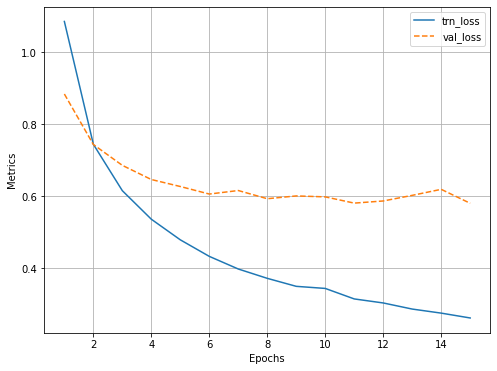

100%|██████████| 116/116 [00:00<00:00, 168.78it/s]


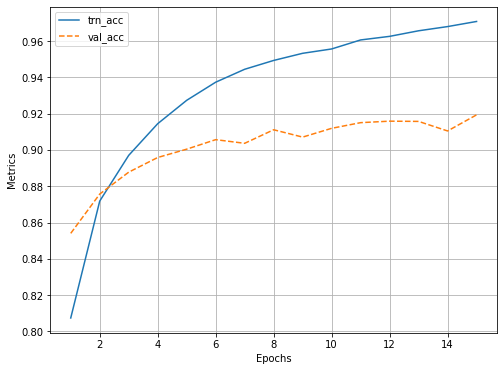

In [ ]:
train_log.plot_epochs(["trn_loss", "val_loss"])
train_log.plot_epochs(["trn_acc", "val_acc"])

#### Test Evaluation

The fast R-CNN model achieved a mAP score of 0.83 with an IoU threshold of 0.5 when tested against the test dataset. This is significantly better than the vanilla R-CNN's mAP score of 0.6184.

Inference time also takes only 0.13 seconds (without the 2 second selective search), which is a significant improvement over vanilla R-CNN's 5.06 seconds.

The images showing predictions of the model can be found in `Demo: Predictions on Test Dataset`

##### Code: Inference and mAP Calculation

In [ ]:
from fast_rcnn.test import frcnn_predict_on_test_set

gts, preds = frcnn_predict_on_test_set(fast_rcnn_model, restored_test_ds)

========== Predicting on test set with 710 images ==========

1/710: Processed in 0.17543676600053004

2/710: Processed in 0.09823129999949742

3/710: Processed in 0.10511913000027562

4/710: Processed in 0.1555972229998588

5/710: Processed in 0.09713913899940962

6/710: Processed in 0.15492279099998996

7/710: Processed in 0.18168755400074588

8/710: Processed in 0.09122231600031228

9/710: Processed in 0.17942284799937624

10/710: Processed in 0.10057987799973489

11/710: Processed in 0.1818267280004875

12/710: Processed in 0.19676904800053308

13/710: Processed in 0.07944194500032609

14/710: Processed in 0.06907048900029622

15/710: Processed in 0.17981133499961288

16/710: Processed in 0.19179888899998332

17/710: Processed in 0.11042851099955442

18/710: Processed in 0.19873948300028133

19/710: Processed in 0.08170818100006727

20/710: Processed in 0.1349709489995803

21/710: Processed in 0.07893468500060408

22/710: Processed in 0.09176460700018652

23/710: Processed in 0.07994645899998432

24/710: Processed in 0.07347693800056732

25/710: Processed in 0.07899672300027305

26/710: Processed in 0.07990230700033862

27/710: Processed in 0.10372126399943227

28/710: Processed in 0.07559628799936036

29/710: Processed in 0.2055931419999979

30/710: Processed in 0.0689679460001571

31/710: Processed in 0.23428991200034943

32/710: Processed in 0.13157498399959877

33/710: Processed in 0.2095880050001142

34/710: Processed in 0.0706769449998319

35/710: Processed in 0.1994948330002444

36/710: Processed in 0.19848912700035726

37/710: Processed in 0.07848414199997933

38/710: Processed in 0.0829898489992047

39/710: Processed in 0.08410655500028952

40/710: Processed in 0.19047802899967792

41/710: Processed in 0.06749085799947352

42/710: Processed in 0.2506644369996138

43/710: Processed in 0.07577441000012186

44/710: Processed in 0.12089944499984995

45/710: Processed in 0.18660067899963906

46/710: Processed in 0.2000726919995941

47/710: Processed in 0.05904112799998984

48/710: Processed in 0.0677734809996764

49/710: Processed in 0.08161304500026745

50/710: Processed in 0.08339248200081784

51/710: Processed in 0.07144417200015596

52/710: Processed in 0.05751666300056968

53/710: Processed in 0.2523038440003802

54/710: Processed in 0.06982718699964607

55/710: Processed in 0.20505982899976516

56/710: Processed in 0.2006151570003567

57/710: Processed in 0.0911174619996018

58/710: Processed in 0.07452341800035356

59/710: Processed in 0.07732250000026397

60/710: Processed in 0.24019109799974103

61/710: Processed in 0.06746172800012573

62/710: Processed in 0.17355593200045405

63/710: Processed in 0.19411051699989912

64/710: Processed in 0.07851830300023721

65/710: Processed in 0.33970052099994064

66/710: Processed in 0.08046331900004589

67/710: Processed in 0.190253037999355

68/710: Processed in 0.07511197100029676

69/710: Processed in 0.2081681010004104

70/710: Processed in 0.07997932099988248

71/710: Processed in 0.06666857399977744

72/710: Processed in 0.16881046900016372

73/710: Processed in 0.07927301500058093

74/710: Processed in 0.12230355700012296

75/710: Processed in 0.14890880399980233

76/710: Processed in 0.08273280600042199

77/710: Processed in 0.07677208600034646

78/710: Processed in 0.08224587099994096

79/710: Processed in 0.0884366210002554

80/710: Processed in 0.12165363999974943

81/710: Processed in 0.0683814430003622

82/710: Processed in 0.2154086520004057

83/710: Processed in 0.1813199389998772

84/710: Processed in 0.13396318099967175

85/710: Processed in 0.08014125099998637

86/710: Processed in 0.07396048600003269

87/710: Processed in 0.2041181040003721

88/710: Processed in 0.1633028629994442

89/710: Processed in 0.06502954100051284

90/710: Processed in 0.19178873199962254

91/710: Processed in 0.19278470399967773

92/710: Processed in 0.24382387900004687

93/710: Processed in 0.21258801800013316

94/710: Processed in 0.06999996099966665

95/710: Processed in 0.0805690789993605

96/710: Processed in 0.06870721999985108

97/710: Processed in 0.07963740499963023

98/710: Processed in 0.08301953200043499

99/710: Processed in 0.08080770300057338

100/710: Processed in 0.20720256799995695

101/710: Processed in 0.21607410600063304

102/710: Processed in 0.12940335599978425

103/710: Processed in 0.1880716890000258

104/710: Processed in 0.06794382400039467

105/710: Processed in 0.07358833300077094

106/710: Processed in 0.07117402099993342

107/710: Processed in 0.07685233400025027

108/710: Processed in 0.20551396500013652

109/710: Processed in 0.07867070599968429

110/710: Processed in 0.08569772999999259

111/710: Processed in 0.06940180899982806

112/710: Processed in 0.05593798300014896

113/710: Processed in 0.20284093600002961

114/710: Processed in 0.19915493600001355

115/710: Processed in 0.12801177300025302

116/710: Processed in 0.07785340800000995

117/710: Processed in 0.06406642199999624

118/710: Processed in 0.07295086599970091

119/710: Processed in 0.08877377299995715

120/710: Processed in 0.08011151000027894

121/710: Processed in 0.06922766800016689

122/710: Processed in 0.0833120860006602

123/710: Processed in 0.1714550840006268

124/710: Processed in 0.07189877199925832

125/710: Processed in 0.07734554400030902

126/710: Processed in 0.06822478300000512

127/710: Processed in 0.09089810800014675

128/710: Processed in 0.23057127200081595

129/710: Processed in 0.11465588499959267

130/710: Processed in 0.18609362400002283

131/710: Processed in 0.05944752600044012

132/710: Processed in 0.19142022300002282

133/710: Processed in 0.20690771999943536

134/710: Processed in 0.08240484100042522

135/710: Processed in 0.06559774600009405

136/710: Processed in 0.07483043400043243

137/710: Processed in 0.06574589299998479

138/710: Processed in 0.2650562240005456

139/710: Processed in 0.07049924100010685

140/710: Processed in 0.166032646999156

141/710: Processed in 0.2434056199999759

142/710: Processed in 0.0706674800003384

143/710: Processed in 0.19270495699947787

144/710: Processed in 0.20684969400008413

145/710: Processed in 0.10319037799945363

146/710: Processed in 0.0713204029998451

147/710: Processed in 0.07795461900059308

148/710: Processed in 0.14950451999993675

149/710: Processed in 0.16171532000043953

150/710: Processed in 0.07519786400007433

151/710: Processed in 0.2085159680000288

152/710: Processed in 0.15178404900052556

153/710: Processed in 0.0674297249997835

154/710: Processed in 0.11245344399958412

155/710: Processed in 0.07041340700016008

156/710: Processed in 0.26007933800065075

157/710: Processed in 0.1440335650004272

158/710: Processed in 0.07043363800039515

159/710: Processed in 0.2140802399999302

160/710: Processed in 0.12461318999976356

161/710: Processed in 0.1519213490000766

162/710: Processed in 0.24987142800000584

163/710: Processed in 0.10550426200006768

164/710: Processed in 0.1957212420002179

165/710: Processed in 0.09891095300008601

166/710: Processed in 0.2769384760003959

167/710: Processed in 0.219992696999725

168/710: Processed in 0.09066791699933674

169/710: Processed in 0.16949498000030871

170/710: Processed in 0.19428119200074434

171/710: Processed in 0.23730469000020094

172/710: Processed in 0.27077174400074

173/710: Processed in 0.17514959100026317

174/710: Processed in 0.06936719099940092

175/710: Processed in 0.06839686100011022

176/710: Processed in 0.07916788600050495

177/710: Processed in 0.2594778109996696

178/710: Processed in 0.27311965499939106

179/710: Processed in 0.06622723500004213

180/710: Processed in 0.18405766099931498

181/710: Processed in 0.0748417539998627

182/710: Processed in 0.08048757100004877

183/710: Processed in 0.060794811000050686

184/710: Processed in 0.20025538499976392

185/710: Processed in 0.0672905349993016

186/710: Processed in 0.20819311099967308

187/710: Processed in 0.0696332950001306

188/710: Processed in 0.05423606999920594

189/710: Processed in 0.0687532559995816

190/710: Processed in 0.08800317100030952

191/710: Processed in 0.06741002999933698

192/710: Processed in 0.09357582200027537

193/710: Processed in 0.15477653899961297

194/710: Processed in 0.14780207999956474

195/710: Processed in 0.06822530900080892

196/710: Processed in 0.08945928999946773

197/710: Processed in 0.08341120699969906

198/710: Processed in 0.06822367699987808

199/710: Processed in 0.07353244400019321

200/710: Processed in 0.18691891900016344

201/710: Processed in 0.1582338250000248

202/710: Processed in 0.08450178499970207

203/710: Processed in 0.1985511549992225

204/710: Processed in 0.17490983199968468

205/710: Processed in 0.19019163899974956

206/710: Processed in 0.0814789229998496

207/710: Processed in 0.058734137999636005

208/710: Processed in 0.16481834099977277

209/710: Processed in 0.20811548299934657

210/710: Processed in 0.06032403399967734

211/710: Processed in 0.08255049500075984

212/710: Processed in 0.0826523099995029

213/710: Processed in 0.08061161200021161

214/710: Processed in 0.12434163800025999

215/710: Processed in 0.14759891999983665

216/710: Processed in 0.0743050740002218

217/710: Processed in 0.2097269759997289

218/710: Processed in 0.07471060399984708

219/710: Processed in 0.08111501700022927

220/710: Processed in 0.13169266400018387

221/710: Processed in 0.07175391999953717

222/710: Processed in 0.07212916600019526

223/710: Processed in 0.19417293800051993

224/710: Processed in 0.10510871199949179

225/710: Processed in 0.07735753099950671

226/710: Processed in 0.20017159700000775

227/710: Processed in 0.19947898700047517

228/710: Processed in 0.1306572960002086

229/710: Processed in 0.06865214200024639

230/710: Processed in 0.1389080949993513

231/710: Processed in 0.06332553199990798

232/710: Processed in 0.05892176399993332

233/710: Processed in 0.0660034930006077

234/710: Processed in 0.08330568699966534

235/710: Processed in 0.20405119299994112

236/710: Processed in 0.17847342699951696

237/710: Processed in 0.18605979299991304

238/710: Processed in 0.07181927199962956

239/710: Processed in 0.07069419599974935

240/710: Processed in 0.05969403599920042

241/710: Processed in 0.24094667499957723

242/710: Processed in 0.17247340199992323

243/710: Processed in 0.20257598199987115

244/710: Processed in 0.2348636919996352

245/710: Processed in 0.08087096300005214

246/710: Processed in 0.06989914199948544

247/710: Processed in 0.1854570129999047

248/710: Processed in 0.13458157100012613

249/710: Processed in 0.07649015300012252

250/710: Processed in 0.20564123399981327

251/710: Processed in 0.13046920499982662

252/710: Processed in 0.08891679499993188

253/710: Processed in 0.05733775600037916

254/710: Processed in 0.08072726799946395

255/710: Processed in 0.06789246799962712

256/710: Processed in 0.19801881300008972

257/710: Processed in 0.19007964899992658

258/710: Processed in 0.18784505499934312

259/710: Processed in 0.0844413529994199

260/710: Processed in 0.0695949519995338

261/710: Processed in 0.06249057500008348

262/710: Processed in 0.13291193399982149

263/710: Processed in 0.09332571399954759

264/710: Processed in 0.19480130100055248

265/710: Processed in 0.07779400100025669

266/710: Processed in 0.1215449390001595

267/710: Processed in 0.14243956400059687

268/710: Processed in 0.06035620799957542

269/710: Processed in 0.19051577899972472

270/710: Processed in 0.24374665899995307

271/710: Processed in 0.09409281100033695

272/710: Processed in 0.156140336000135

273/710: Processed in 0.06634479900003498

274/710: Processed in 0.06814867800039792

275/710: Processed in 0.11745267700007389

276/710: Processed in 0.06539571200028149

277/710: Processed in 0.09039874799964309

278/710: Processed in 0.09060139399934997

279/710: Processed in 0.20000501699996676

280/710: Processed in 0.057292208000035316

281/710: Processed in 0.07634575200063409

282/710: Processed in 0.07453299099961441

283/710: Processed in 0.07267370899990055

284/710: Processed in 0.07122008800070034

285/710: Processed in 0.1887012010001854

286/710: Processed in 0.219879707000473

287/710: Processed in 0.0700865539993174

288/710: Processed in 0.19139519199961796

289/710: Processed in 0.09301537899955292

290/710: Processed in 0.18626302400025452

291/710: Processed in 0.07200298199950339

292/710: Processed in 0.07505849000062881

293/710: Processed in 0.0743806170003154

294/710: Processed in 0.0861634969996885

295/710: Processed in 0.24626204800006235

296/710: Processed in 0.16340908100028173

297/710: Processed in 0.19702681400030997

298/710: Processed in 0.08370367899988196

299/710: Processed in 0.06725200599976233

300/710: Processed in 0.057682124999701045

301/710: Processed in 0.19354449700040277

302/710: Processed in 0.07203769599982479

303/710: Processed in 0.25413060800019593

304/710: Processed in 0.18836249099967972

305/710: Processed in 0.08156230399981723

306/710: Processed in 0.06354697500046314

307/710: Processed in 0.06855656900006579

308/710: Processed in 0.2678180599996267

309/710: Processed in 0.07532021000042732

310/710: Processed in 0.12221358199985843

311/710: Processed in 0.1923929330005194

312/710: Processed in 0.17230101000041032

313/710: Processed in 0.12651163500049734

314/710: Processed in 0.07233897300011449

315/710: Processed in 0.18105119699976058

316/710: Processed in 0.18831764799961093

317/710: Processed in 0.06922742499955348

318/710: Processed in 0.0786784150004678

319/710: Processed in 0.07371930400040583

320/710: Processed in 0.07061777199942298

321/710: Processed in 0.08059461300035764

322/710: Processed in 0.18454562399983843

323/710: Processed in 0.10687270700054796

324/710: Processed in 0.08296885900017514

325/710: Processed in 0.1955940380003085

326/710: Processed in 0.08132262399976753

327/710: Processed in 0.07478507499945408

328/710: Processed in 0.07842943699961324

329/710: Processed in 0.18937986099990667

330/710: Processed in 0.11468324500037852

331/710: Processed in 0.111921650000113

332/710: Processed in 0.07903154599989648

333/710: Processed in 0.07076309100011713

334/710: Processed in 0.08222831500006578

335/710: Processed in 0.11125919299956877

336/710: Processed in 0.15701761899981648

337/710: Processed in 0.0707472729991423

338/710: Processed in 0.18523340100000496

339/710: Processed in 0.3747518439995474

340/710: Processed in 0.07298261300002196

341/710: Processed in 0.1433402530001331

342/710: Processed in 0.20905652700002975

343/710: Processed in 0.07409967099920323

344/710: Processed in 0.24251264099984837

345/710: Processed in 0.07046899700071663

346/710: Processed in 0.06940809200023068

347/710: Processed in 0.07284257899937074

348/710: Processed in 0.08087558099941816

349/710: Processed in 0.19031888300014543

350/710: Processed in 0.08787508900059038

351/710: Processed in 0.20387027600008878

352/710: Processed in 0.07431559399992693

353/710: Processed in 0.1866954879997138

354/710: Processed in 0.08455876000061835

355/710: Processed in 0.22003051999945455

356/710: Processed in 0.08287126899995201

357/710: Processed in 0.10706760899938672

358/710: Processed in 0.07066193100035889

359/710: Processed in 0.08120004400007019

360/710: Processed in 0.08250202699946385

361/710: Processed in 0.14440398399983678

362/710: Processed in 0.14684347300044465

363/710: Processed in 0.2112433960000999

364/710: Processed in 0.07414239600075234

365/710: Processed in 0.08004324100056692

366/710: Processed in 0.08208057999945595

367/710: Processed in 0.07369632500012813

368/710: Processed in 0.18801313399944775

369/710: Processed in 0.0721778520000953

370/710: Processed in 0.21211312400009774

371/710: Processed in 0.07496879900008935

372/710: Processed in 0.08520019699972181

373/710: Processed in 0.18909636899934412

374/710: Processed in 0.07081087500046124

375/710: Processed in 0.08753391399932298

376/710: Processed in 0.06492300299942144

377/710: Processed in 0.14415981599995575

378/710: Processed in 0.06353129899980559

379/710: Processed in 0.08307206100016629

380/710: Processed in 0.06974914800048282

381/710: Processed in 0.17962318999980198

382/710: Processed in 0.07514189799985616

383/710: Processed in 0.16661332200055767

384/710: Processed in 0.2223720100000719

385/710: Processed in 0.13000538799951755

386/710: Processed in 0.09293502299988177

387/710: Processed in 0.08364053100012825

388/710: Processed in 0.0720900320002329

389/710: Processed in 0.14687257099922135

390/710: Processed in 0.18635885999992752

391/710: Processed in 0.1905227580000428

392/710: Processed in 0.1137506619998021

393/710: Processed in 0.08211975999984134

394/710: Processed in 0.10906433400032256

395/710: Processed in 0.1029473529997631

396/710: Processed in 0.2396620459994665

397/710: Processed in 0.1493858249996265

398/710: Processed in 0.06756675799988443

399/710: Processed in 0.1679379709994464

400/710: Processed in 0.253828472999885

401/710: Processed in 0.07336598000074446

402/710: Processed in 0.2190416310004366

403/710: Processed in 0.07330167899999651

404/710: Processed in 0.07007213999986561

405/710: Processed in 0.19631522099916765

406/710: Processed in 0.2106513119997544

407/710: Processed in 0.20272914500037587

408/710: Processed in 0.07702612800039788

409/710: Processed in 0.2169090410006902

410/710: Processed in 0.20572801500020432

411/710: Processed in 0.06800175099942862

412/710: Processed in 0.08571701499931805

413/710: Processed in 0.08465503099978378

414/710: Processed in 0.10259848800069449

415/710: Processed in 0.10019268399992143

416/710: Processed in 0.09574554499977239

417/710: Processed in 0.20762292000017624

418/710: Processed in 0.08348154700070154

419/710: Processed in 0.15335685099944385

420/710: Processed in 0.1310322389999783

421/710: Processed in 0.07183173799967335

422/710: Processed in 0.19408822099921963

423/710: Processed in 0.13513180300014938

424/710: Processed in 0.08315845700053615

425/710: Processed in 0.0706085379997603

426/710: Processed in 0.07342272799996863

427/710: Processed in 0.1852481779997106

428/710: Processed in 0.1130847790000189

429/710: Processed in 0.08596023799964314

430/710: Processed in 0.08527028000025894

431/710: Processed in 0.07505272200069157

432/710: Processed in 0.22284283899989532

433/710: Processed in 0.2706000930002119

434/710: Processed in 0.08161431600001379

435/710: Processed in 0.21082425299937313

436/710: Processed in 0.06264265699974203

437/710: Processed in 0.09344361200055573

438/710: Processed in 0.07233215199994447

439/710: Processed in 0.16145064499960426

440/710: Processed in 0.14907860400035133

441/710: Processed in 0.19472686799963412

442/710: Processed in 0.09951815599924885

443/710: Processed in 0.08723714200004906

444/710: Processed in 0.18435800899987953

445/710: Processed in 0.0603217340003539

446/710: Processed in 0.19944491100068262

447/710: Processed in 0.07505275700077618

448/710: Processed in 0.1769403329999477

449/710: Processed in 0.30104579299950274

450/710: Processed in 0.07446333600000798

451/710: Processed in 0.20416474899957393

452/710: Processed in 0.18419607900068513

453/710: Processed in 0.08012886200049252

454/710: Processed in 0.17907214099977864

455/710: Processed in 0.08503097399989201

456/710: Processed in 0.0721753779998835

457/710: Processed in 0.07441680899955827

458/710: Processed in 0.18456908500047575

459/710: Processed in 0.08530075199996645

460/710: Processed in 0.06669474400041508

461/710: Processed in 0.08717808500023239

462/710: Processed in 0.120051513999897

463/710: Processed in 0.1393146379996324

464/710: Processed in 0.18542912100019748

465/710: Processed in 0.0801925450005001

466/710: Processed in 0.06512595000003785

467/710: Processed in 0.17003734500030987

468/710: Processed in 0.07845258900033514

469/710: Processed in 0.08621497199965233

470/710: Processed in 0.16375172900006874

471/710: Processed in 0.07125592100055655

472/710: Processed in 0.069689586000095

473/710: Processed in 0.10066826000002038

474/710: Processed in 0.1927186270004313

475/710: Processed in 0.0994790410004498

476/710: Processed in 0.18171921300017857

477/710: Processed in 0.08700197600046522

478/710: Processed in 0.07042317000014009

479/710: Processed in 0.1400084839997362

480/710: Processed in 0.18103299499944114

481/710: Processed in 0.1863699750001615

482/710: Processed in 0.15399691999937204

483/710: Processed in 0.12569501500001934

484/710: Processed in 0.24100412699954177

485/710: Processed in 0.19503636100034782

486/710: Processed in 0.19504375999986223

487/710: Processed in 0.075255436999214

488/710: Processed in 0.0792336519998571

489/710: Processed in 0.06139015900043887

490/710: Processed in 0.20800611800041224

491/710: Processed in 0.08553784499963513

492/710: Processed in 0.1999814159999005

493/710: Processed in 0.08739321400025801

494/710: Processed in 0.08300026600045385

495/710: Processed in 0.08689261200015608

496/710: Processed in 0.09924854800010507

497/710: Processed in 0.21085909300018102

498/710: Processed in 0.0974695029999566

499/710: Processed in 0.11087263199988229

500/710: Processed in 0.07944887899975583

501/710: Processed in 0.0728985890000331

502/710: Processed in 0.07031701699997939

503/710: Processed in 0.0917653419992348

504/710: Processed in 0.19908280600066064

505/710: Processed in 0.11983099799999763

506/710: Processed in 0.07926792999933241

507/710: Processed in 0.13465360700047313

508/710: Processed in 0.08193399500032683

509/710: Processed in 0.07543904799968004

510/710: Processed in 0.1425501499998063

511/710: Processed in 0.061327215999881446

512/710: Processed in 0.18113273700055288

513/710: Processed in 0.07372822700017423

514/710: Processed in 0.08896357899993745

515/710: Processed in 0.06236944499960373

516/710: Processed in 0.1923021759994299

517/710: Processed in 0.07743082199976925

518/710: Processed in 0.09397282999998424

519/710: Processed in 0.06127238699991722

520/710: Processed in 0.06438178699954733

521/710: Processed in 0.18658329200025037

522/710: Processed in 0.07380581899997196

523/710: Processed in 0.19447063799998432

524/710: Processed in 0.0740100059992983

525/710: Processed in 0.15587460200003989

526/710: Processed in 0.2031203850001475

527/710: Processed in 0.07742096800029685

528/710: Processed in 0.08329138999943098

529/710: Processed in 0.17876673499995377

530/710: Processed in 0.07657183500032261

531/710: Processed in 0.1250216239996007

532/710: Processed in 0.2516803049993541

533/710: Processed in 0.10200219900070806

534/710: Processed in 0.07638552499975049

535/710: Processed in 0.17810514399934618

536/710: Processed in 0.07680601399988518

537/710: Processed in 0.13365584100029082

538/710: Processed in 0.07992058500076382

539/710: Processed in 0.23134512400065432

540/710: Processed in 0.21792281699981686

541/710: Processed in 0.08722296900032234

542/710: Processed in 0.18950608500017552

543/710: Processed in 0.18822019999970507

544/710: Processed in 0.085082639000575

545/710: Processed in 0.06961658099953638

546/710: Processed in 0.13855953300026158

547/710: Processed in 0.07137197000065498

548/710: Processed in 0.190841076999277

549/710: Processed in 0.07682122999995045

550/710: Processed in 0.0850833619997502

551/710: Processed in 0.18793230099981884

552/710: Processed in 0.07849253499989572

553/710: Processed in 0.21580608599924744

554/710: Processed in 0.16777074399942649

555/710: Processed in 0.07173496099949261

556/710: Processed in 0.19679361999988032

557/710: Processed in 0.22248370600027556

558/710: Processed in 0.09580832099982217

559/710: Processed in 0.06866089399954944

560/710: Processed in 0.1944459040005313

561/710: Processed in 0.07222896100029175

562/710: Processed in 0.06305009900006553

563/710: Processed in 0.16425925699968502

564/710: Processed in 0.10308515100041404

565/710: Processed in 0.06166960499922425

566/710: Processed in 0.07062141400001565

567/710: Processed in 0.2593244119998417

568/710: Processed in 0.08445082700018247

569/710: Processed in 0.08680724800069584

570/710: Processed in 0.13827729200056638

571/710: Processed in 0.20738199900006293

572/710: Processed in 0.08106647500062536

573/710: Processed in 0.07507051700031298

574/710: Processed in 0.14888841300034983

575/710: Processed in 0.07147165900005348

576/710: Processed in 0.07765836999988096

577/710: Processed in 0.07314359999963926

578/710: Processed in 0.06987849399956758

579/710: Processed in 0.19014832499942713

580/710: Processed in 0.2056259789997057

581/710: Processed in 0.08317686299960769

582/710: Processed in 0.2287859859998207

583/710: Processed in 0.1601256080002713

584/710: Processed in 0.20146094400024595

585/710: Processed in 0.2085181709999233

586/710: Processed in 0.0762781889998223

587/710: Processed in 0.1774020279999604

588/710: Processed in 0.20629741799984913

589/710: Processed in 0.07013933200050815

590/710: Processed in 0.07145203499931085

591/710: Processed in 0.13159969700063812

592/710: Processed in 0.1932844089997161

593/710: Processed in 0.16037048299949674

594/710: Processed in 0.0745271670002694

595/710: Processed in 0.07906038900000567

596/710: Processed in 0.18536016200050653

597/710: Processed in 0.07267345399941405

598/710: Processed in 0.0708767230007652

599/710: Processed in 0.06526279100035026

600/710: Processed in 0.20620912699996552

601/710: Processed in 0.07481056600045122

602/710: Processed in 0.09582584100007807

603/710: Processed in 0.07247694000034244

604/710: Processed in 0.07791145800001686

605/710: Processed in 0.08430127400060883

606/710: Processed in 0.06000669800050673

607/710: Processed in 0.09137556499990751

608/710: Processed in 0.07236852799996996

609/710: Processed in 0.20844543000021076

610/710: Processed in 0.07305459400049585

611/710: Processed in 0.20819091599969397

612/710: Processed in 0.09532441299961647

613/710: Processed in 0.18381340299947624

614/710: Processed in 0.21423667399994883

615/710: Processed in 0.15941073799967853

616/710: Processed in 0.07475802699991618

617/710: Processed in 0.06790406399977655

618/710: Processed in 0.15267178200065246

619/710: Processed in 0.19973228799972276

620/710: Processed in 0.0754349059998276

621/710: Processed in 0.08603917100026592

622/710: Processed in 0.1258008830000108

623/710: Processed in 0.0883786060003331

624/710: Processed in 0.07290147399999114

625/710: Processed in 0.19169215300007636

626/710: Processed in 0.07351589300014894

627/710: Processed in 0.1399296730005517

628/710: Processed in 0.08580799799983652

629/710: Processed in 0.07242157200016663

630/710: Processed in 0.08575729499989393

631/710: Processed in 0.07847694600059185

632/710: Processed in 0.08414828900004068

633/710: Processed in 0.0724324089997026

634/710: Processed in 0.08282570200026385

635/710: Processed in 0.22433002500019938

636/710: Processed in 0.077658502000304

637/710: Processed in 0.19970617499984655

638/710: Processed in 0.22176538399980927

639/710: Processed in 0.18631157000072562

640/710: Processed in 0.1450173140001425

641/710: Processed in 0.08771069900012662

642/710: Processed in 0.12268479299928003

643/710: Processed in 0.08694341800037364

644/710: Processed in 0.1871643430004042

645/710: Processed in 0.0760242370006381

646/710: Processed in 0.19654858499961847

647/710: Processed in 0.06098080400079198

648/710: Processed in 0.0724717299999611

649/710: Processed in 0.1832068839994463

650/710: Processed in 0.073222633000114

651/710: Processed in 0.18204191600034392

652/710: Processed in 0.274426437999864

653/710: Processed in 0.06092235800042545

654/710: Processed in 0.2251592630000232

655/710: Processed in 0.16790513700016163

656/710: Processed in 0.07638730800044868

657/710: Processed in 0.07253700399996887

658/710: Processed in 0.06240389800041157

659/710: Processed in 0.19187160399997083

660/710: Processed in 0.24845832400023937

661/710: Processed in 0.07200577999992674

662/710: Processed in 0.07694210299996485

663/710: Processed in 0.19205720700028905

664/710: Processed in 0.20678983599918865

665/710: Processed in 0.19843042100001185

666/710: Processed in 0.2687630509999508

667/710: Processed in 0.08032215599996562

668/710: Processed in 0.2003393490003873

669/710: Processed in 0.08099846799996158

670/710: Processed in 0.07136397999965993

671/710: Processed in 0.1942332990001887

672/710: Processed in 0.06932105899977614

673/710: Processed in 0.17551083699981973

674/710: Processed in 0.07579866100059007

675/710: Processed in 0.20563584599949536

676/710: Processed in 0.07252205500026321

677/710: Processed in 0.07517982799981837

678/710: Processed in 0.1550200000001496

679/710: Processed in 0.08517267900060688

680/710: Processed in 0.1999562179998975

681/710: Processed in 0.07252376199994615

682/710: Processed in 0.0867640050000773

683/710: Processed in 0.21333647200026462

684/710: Processed in 0.1949721529999806

685/710: Processed in 0.19463078400076483

686/710: Processed in 0.10056722399986029

687/710: Processed in 0.21339272300065204

688/710: Processed in 0.23290909700062912

689/710: Processed in 0.06779616699986946

690/710: Processed in 0.2846032440002091

691/710: Processed in 0.09688334899965412

692/710: Processed in 0.20814177699958236

693/710: Processed in 0.07125583499964705

694/710: Processed in 0.14697473300020647

695/710: Processed in 0.11685686900000292

696/710: Processed in 0.17909818799944333

697/710: Processed in 0.14244666200011125

698/710: Processed in 0.17834813500030577

699/710: Processed in 0.34937147599976015

700/710: Processed in 0.08586922199992841

701/710: Processed in 0.11685618799947406

702/710: Processed in 0.0754908869994324

703/710: Processed in 0.06775085800018132

704/710: Processed in 0.14921147399945767

705/710: Processed in 0.19167386400022224

706/710: Processed in 0.0622226719997343

707/710: Processed in 0.18379547899985482

708/710: Processed in 0.07399511400035408

709/710: Processed in 0.20959975700043287

710/710: Processed in 0.08728539699950488

========== Prediction finished. Time elapsed: 92.50950998600001 ==========

In [ ]:
from torchmetrics.detection.mean_ap import MeanAveragePrecision
from utils import device

# Initialize metric
metric = MeanAveragePrecision(iou_type="bbox", iou_thresholds=[0.5])

# Update metric with predictions and respective ground truth
metric.update(preds, gts)

# Compute the results
result = metric.compute()
map50 = result['map'].item()
print(f"mAP with IoU threshold at 0.5: {map50}")

mAP with IoU threshold at 0.5: 0.8313335180282593


##### Demo: Predictions on Test Dataset

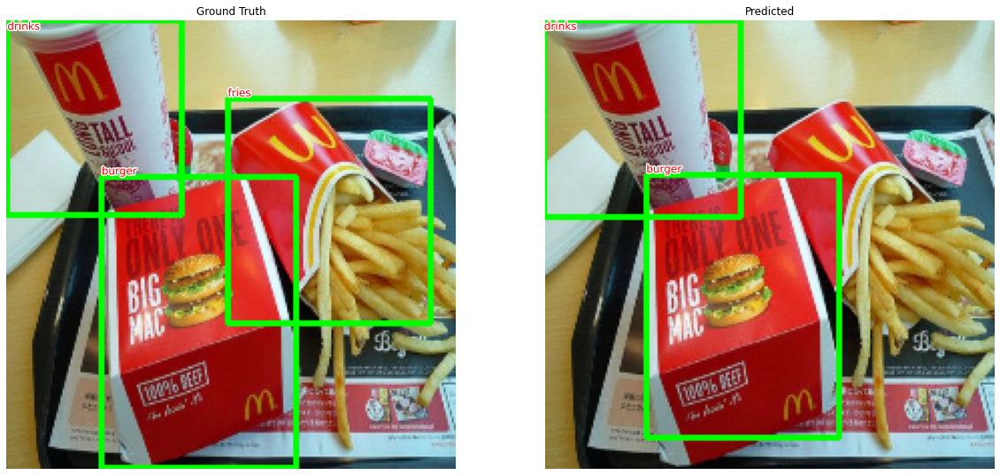

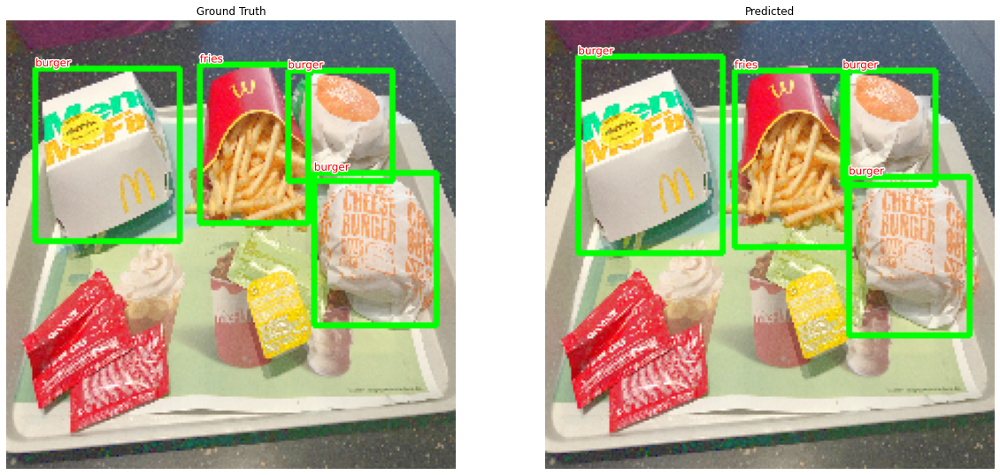

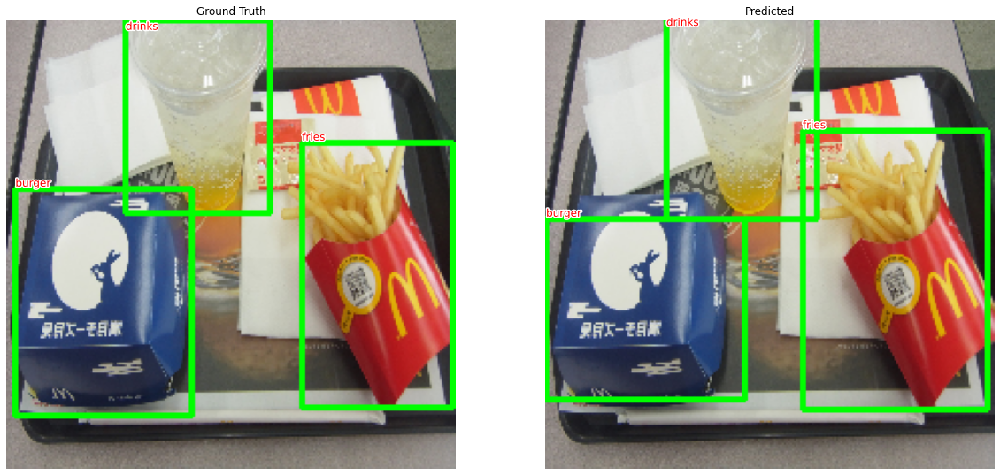

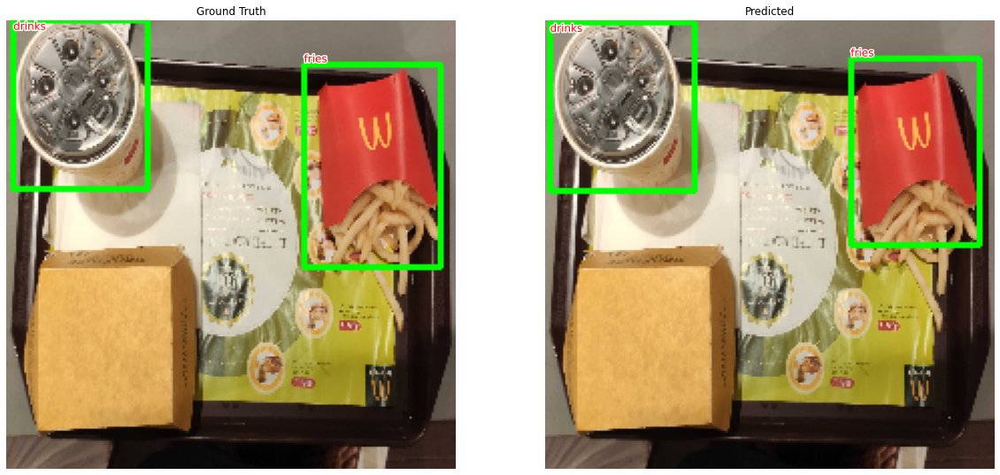

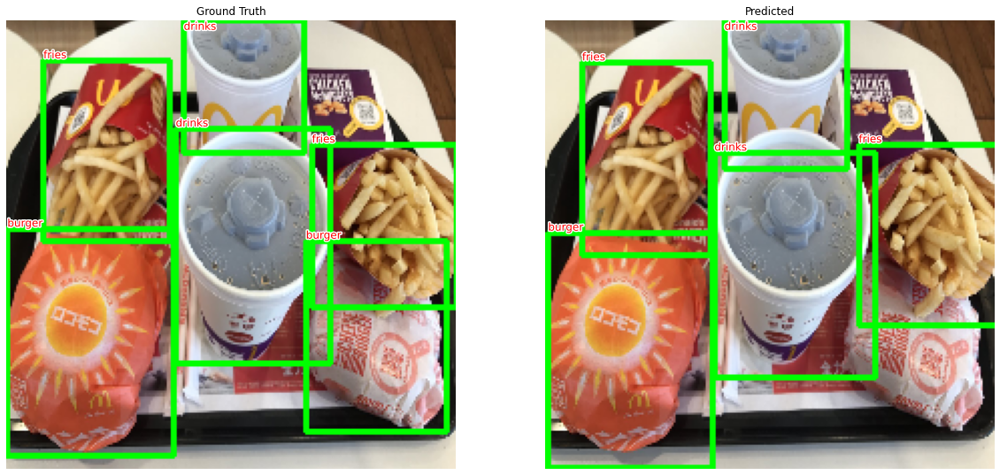

...

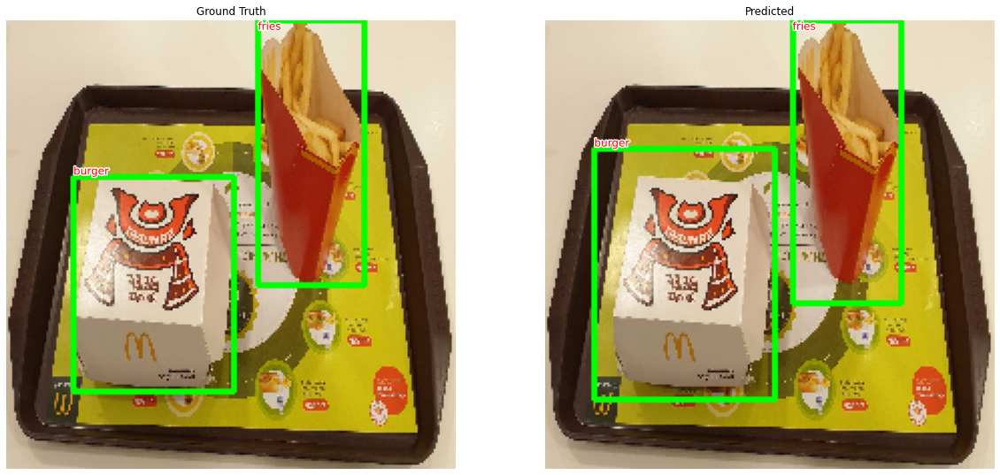

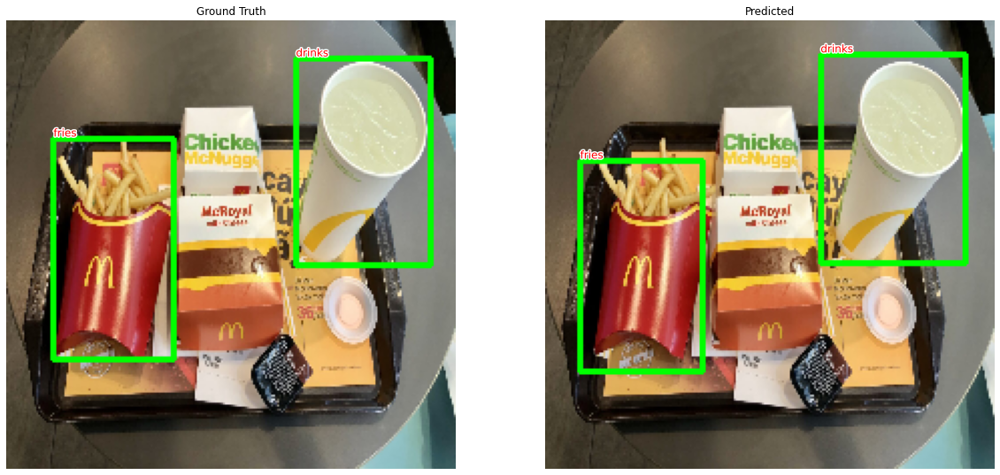

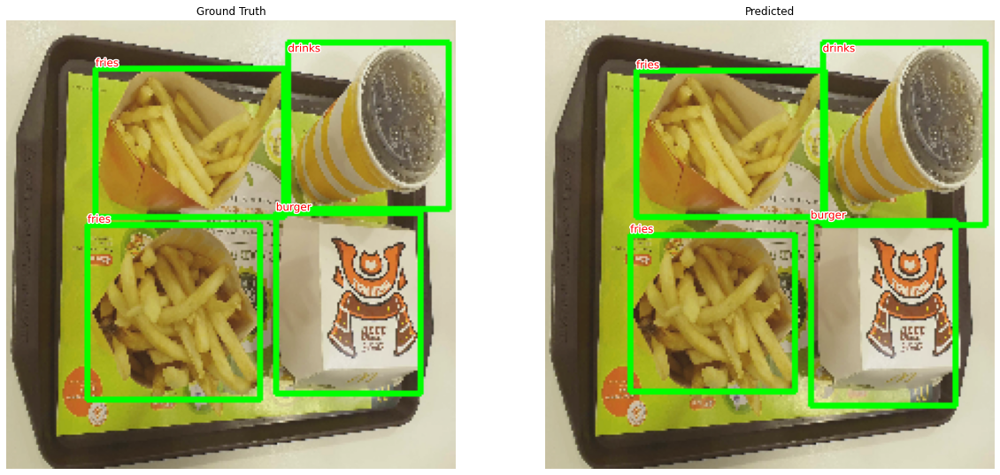

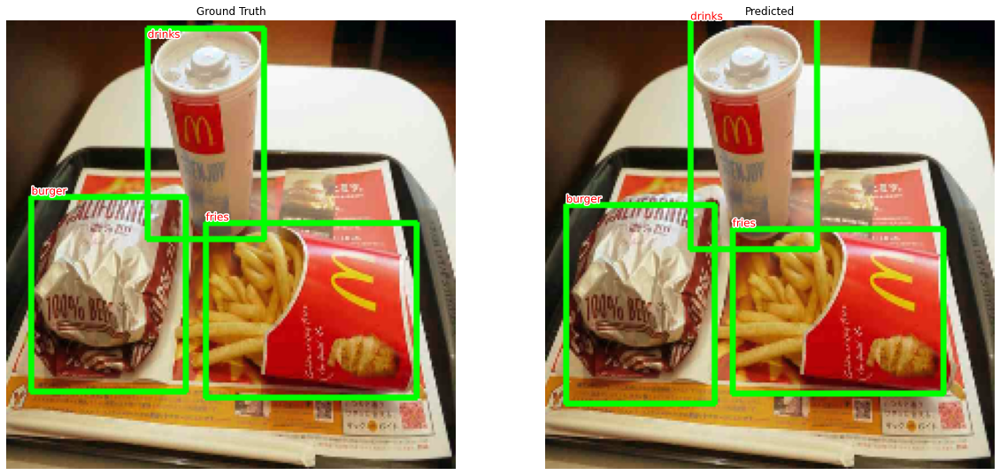

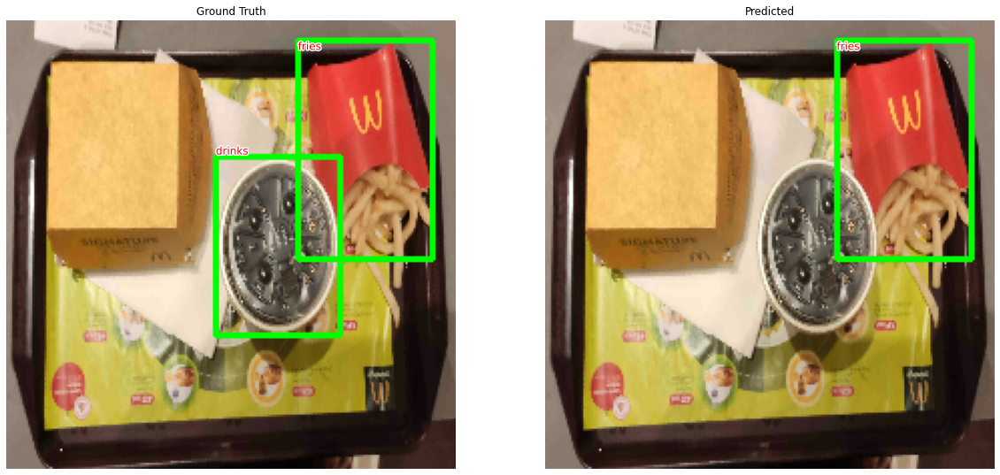

In [ ]:
import matplotlib.pyplot as plt

def show_bbs_labels(img, info, ax):
    boxes = info['boxes'].int().tolist()
    labels = info['labels'].tolist()
    texts = [id_to_class[c] for c in labels]
    show(img, bbs=boxes, texts=texts, text_sz=12, ax=ax)

for img_idx in range(20):
  _, ax = plt.subplots(1, 2, figsize=(20,10))
  img = read_image_cv2(restored_test_ds.img_base_dir + restored_test_ds.filenames[img_idx])
  img = cv2.resize(img, (224, 224))

  ax[0].set_title("Ground Truth")
  show_bbs_labels(img, gts[img_idx], ax=ax[0])

  ax[1].set_title("Predicted")
  show_bbs_labels(img, preds[img_idx], ax=ax[1])
  plt.show()


## References
- [1] Girshick, Ross et al. "Rich feature hierarchies for accurate object detection and semantic segmentation." (2013).
- [2] Girshick, Ross. "Fast R-CNN." (2015).